# import

In [5]:
import numpy as np
import pandas as pd
import statistics
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
from matplotlib import rcParams
from operator import itemgetter
from typing import Callable, Dict, List, Set, Tuple
from scipy.optimize import curve_fit
import csv
import json
from collections import defaultdict

import numpy as np
import pandas as pd
import statistics
import matplotlib.pyplot as plt
from matplotlib import rcParams
from operator import itemgetter
from typing import Callable, Dict, List, Set, Tuple
from scipy.signal import savgol_filter
import math 

In [6]:
from util import calculate_derivative,pointInterval_to_pressure,point_dt_to_pressure
from baseline import detect_breakpoints_startPoint, detect_breakpoints, detect_breakpoints_2, detect_breakpoints_3,detect_breakpoints_4,detect_breakpoints_startPoint2
from plot import PlotNSave
from data_load_N_preprocess import LoadNPreprocessData
from pattern_recognition3 import polyval_func_wrapper,linear_func_wrapper,PatternRecognition
# from pattern_recognition import polyval_func_wrapper,linear_func_wrapper,PatternRecognition

In [3]:
#!pip install astropy

In [4]:
file_path=pressure_filePath="../data_input/pattern_left.txt"
pattern_left = pd.read_csv(file_path, delimiter=" ",skiprows=1, names=["X", "Y"],skipinitialspace = True)
pattern_left["X"]= pattern_left["X"]-pattern_left["X"][0]
pattern_left["Y"]= pattern_left["Y"]-pattern_left["Y"][0]
print(pattern_left.describe())


pattern_left_top=pattern_left.loc[pattern_left["Y"]>0]
pattern_left_bottom=pattern_left.loc[pattern_left["Y"]<0]

                X           Y
count  106.000000  106.000000
mean    -6.447343    1.100501
std      3.845383    2.987507
min    -14.049790   -2.763160
25%     -9.565758   -2.051525
50%     -6.371515    1.160395
75%     -3.177262    4.181658
max      0.000000    5.118920


In [5]:
file_path=pressure_filePath="../data_input/pattern_right_top.txt"
pattern_right_top = pd.read_csv(file_path, delimiter=" ",skiprows=1, names=["X", "Y"],skipinitialspace = True)
pattern_right_top["X"]= pattern_right_top["X"]-pattern_right_top["X"][0]
pattern_right_top["Y"]= pattern_right_top["Y"]-pattern_right_top["Y"][0]
pattern_right_top= pattern_right_top.clip(lower=0)
print(pattern_right_top.describe())
# pd.set_option('display.max_rows', pattern_right_top.shape[0]+1)
# pattern_right_top 


               X          Y
count  69.000000  69.000000
mean    1.339242   8.207413
std     1.180701   5.028328
min     0.000000   0.000000
25%     0.371150   3.726520
50%     0.962310   8.391060
75%     2.050570  12.649460
max     4.186780  16.254090


In [6]:
file_path=pressure_filePath="../data_input/pattern_right_bottom.txt"
pattern_right_bottom = pd.read_csv(file_path, delimiter=" ",skiprows=1, names=["X", "Y"],skipinitialspace = True)
pattern_right_bottom["X"]= pattern_right_bottom["X"]-pattern_right_bottom["X"][0]
pattern_right_bottom["Y"]= pattern_right_bottom["Y"]-pattern_right_bottom["Y"][0]

pattern_right_bottom= pattern_right_bottom.clip(lower=0)

print(pattern_right_bottom.describe())


               X          Y
count  77.000000  77.000000
mean    5.628174   6.761963
std     3.985883   3.379727
min     0.000000   0.000000
25%     1.995140   4.067440
50%     5.219620   7.767010
75%     9.048680   9.699000
max    12.877740  10.923490


In [7]:
def test_func_1(x, a,b,c,d):
    y = a+b*x-c*np.exp(d*x)
    return y
def test_func_2(x, a,b,c,d):
    y = a+b*x-c*np.exp(-d*x)
    return y

In [8]:
def fit_curve(xdata,ydata,test_func):
    x = np.asarray(xdata)
    y = np.asarray(ydata)
    parameters, covariance = curve_fit(test_func, x, y)
#     parameters, covariance = curve_fit(test_func, xdata, ydata)

    fit_a = parameters[0]
    fit_b = parameters[1]
    fit_c = parameters[2]
    fit_d = parameters[3]

    print(F'The parameters is {parameters}.')


    y_fit = test_func(x, fit_a, fit_b,fit_c,fit_d)

    plt.plot(x, y, 'o', label='data')
    plt.plot(x, y_fit, '-', label='LJ fit')
    return fit_a,fit_b,fit_c,fit_d

The parameters is [ 4.12959938 -0.07459858  4.31571225  0.27952833].
The parameters is [-3.00297354e+00 -3.35921627e-04 -2.99822437e+00  2.29392013e-01].
The parameters is [13.14227315  0.78460405 13.4545323   0.90468973].
The parameters is [8.77210719 0.17952762 8.95294473 0.28833003].


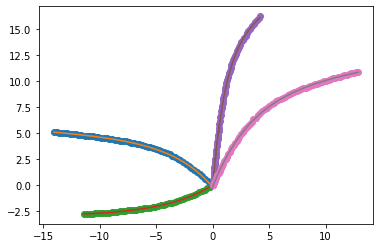

In [9]:
fit_parameters={}
curves=[pattern_left_top,pattern_left_bottom,pattern_right_top,pattern_right_bottom]
test_func=[test_func_1,test_func_1,test_func_2,test_func_2]
names=["pattern_left_top","pattern_left_bottom","pattern_right_top","pattern_right_bottom"]
for curve, func,name in zip(curves,test_func,names):
    xdata=curve["X"]
    ydata=curve["Y"]
    fit_parameters[name]=fit_curve(xdata,ydata,func)


In [10]:
def polyval_func_wrapper(x, *parameters):
    y = np.polyval(parameters,x)
    return y
def linear_func_wrapper(x, a,b):
    y = a*x+b
    return y
xdata=[1,2,3]
ydata=[4,5,6]
x = np.asarray(xdata)
y = np.asarray(ydata)
fitting_func=polyval_func_wrapper
parameters=np.polyfit(x,y,3)
# fitting_func=linear_func_wrapper
# parameters, covariance = curve_fit(fitting_func, x, y)
print(parameters)
y_fit=fitting_func(x, *parameters)
y_fit

[-0.0163292   0.09797518  0.82037884  3.09797518]


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\interactiveshell.py:3441: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


array([4., 5., 6.])

# Synthetic_1

In [5]:
#experiment setup
ground_truth=[107, 164, 243, 328, 375, 446, 644, 713, 771, 820, 887, 953, 1036, 1101, 1179, 1254, 1319, 1396, 1456, 1513, 1598, 1648, 1719, 1784, 1875, 1938, 2017, 2073, 2185, 2247, 2315, 2369, 2433, 2487, 2552, 2610, 2835, 2916, 2965, 3044, 3101, 3240, 3284, 3368, 3411]
print(len(ground_truth))
# colum_names ={"pressure":{"Date","Pressure (psia)","first_order_derivative","second_order_derivative"},
#                     "rate":{"Time@end","Liquid rate (STB/D)"}}

colum_names={"pressure":{"time":"Date",
                        "measure":"Pressure (psia)",
                        "first_order_derivative":"first_order_derivative",
                        "second_order_derivative":"second_order_derivative"},
             "rate":{"time":"Time@end",
                     "measure":"Liquid rate (STB/D)"}}
data_inOneRow=400
pressure_filePath="../data_input/Synthetic_Data.xlsx"
rate_filePath="../data_input/Synthetic_Data.xlsx"

processed_data=LoadNPreprocessData(pressure_filePath=pressure_filePath, 
                 rate_filePath=rate_filePath, 
                 colum_names=colum_names, 
                 use_SG_smoothing=False)
pressure_df=processed_data.pressure_df
rate_df=processed_data.rate_df

display(pressure_df)
display(rate_df)

pressure_measure=list(pressure_df[colum_names["pressure"]["measure"]])
pressure_time=list(pressure_df[colum_names["pressure"]["time"]])

45
---load data from 'txt' or 'xlsx' files...
---The first & second order derivative has been calculated and appended to pressure dataframe


,Date,Pressure (psia),first_order_derivative,second_order_derivative
0,0.000000,2000.000000,15175.401994,-1.593896e+06
1,0.006111,2092.738568,5434.926885,-2.211251e+05
2,0.012222,2125.952010,4083.606969,-1.648675e+05
3,0.018056,2149.773050,3121.879672,-7.945161e+04
4,0.024167,2168.851204,2636.342081,-5.537004e+04
...,...,...,...,...
3514,5938.051389,2327.338989,-0.150989,1.763948e-04
3515,5968.345556,2322.764893,-0.145646,1.653610e-04
3516,5998.640000,2318.352641,-0.140636,1.544522e-04
3517,6028.934444,2314.092149,-0.135957,0.000000e+00


,Time@end,Liquid rate (STB/D)
0,0.000000,-6742.395145
1,253.216667,-8513.514104
2,264.358333,0.000000
3,274.191667,-5548.484464
4,296.716667,-8951.244013
...,...,...
90,4465.793056,0.107707
91,4465.834722,0.105123
92,4465.909722,-1909.311284
93,5058.868056,-5453.279913


In [12]:
ground_truth_buildUp=[point for index, point in enumerate(ground_truth) if index%2!=0]
ground_truth_buildUp
len(ground_truth_buildUp)

22

In [13]:
ground_truth_buildDrawdown=[point for index, point in enumerate(ground_truth) if index%2==0]
ground_truth_buildDrawdown
len(ground_truth_buildDrawdown)

23

detect_breakpoint.....
---------------calculate_Parameters_allCurve linear
------In the input ground truth: 22 points are detected as buildup, 23 points are detected as drawDown
start to learn 'buildUp' pattern...
---------------calculate_Parameters_allCurve polynomial


C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:279: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:279: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:279: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:279: RankWarning: Polyfit may be poor

start to learn 'drawDown' pattern...
---------------calculate_Parameters_allCurve polynomial


C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:279: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:279: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:279: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:279: RankWarning: Polyfit may be poor

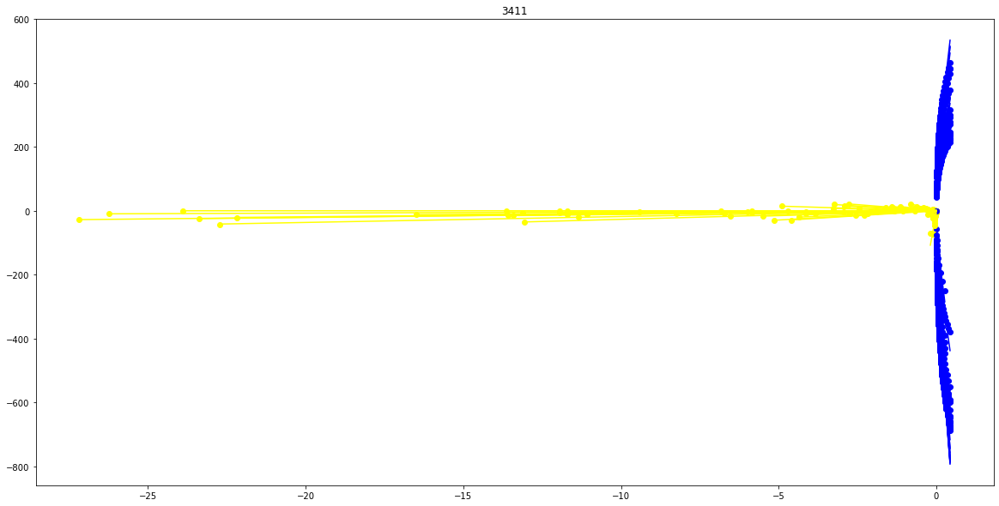

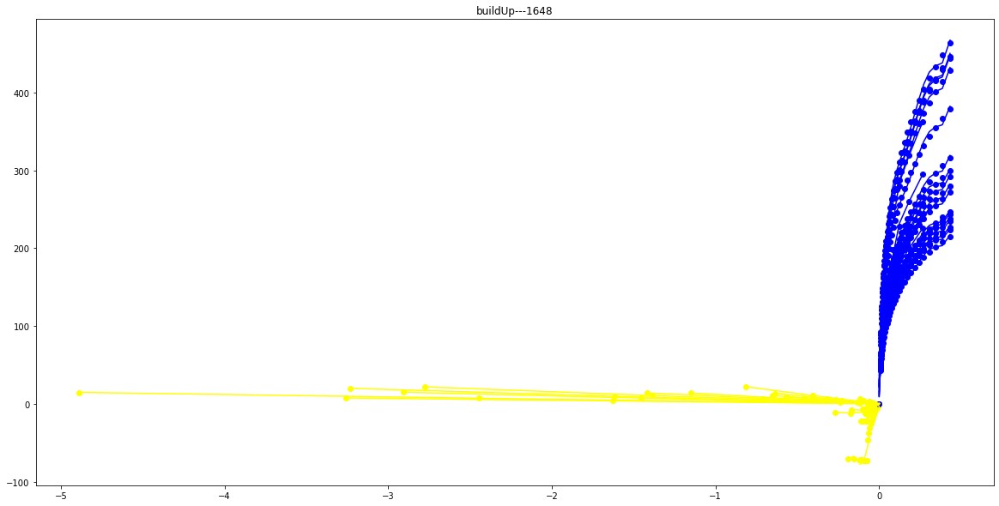

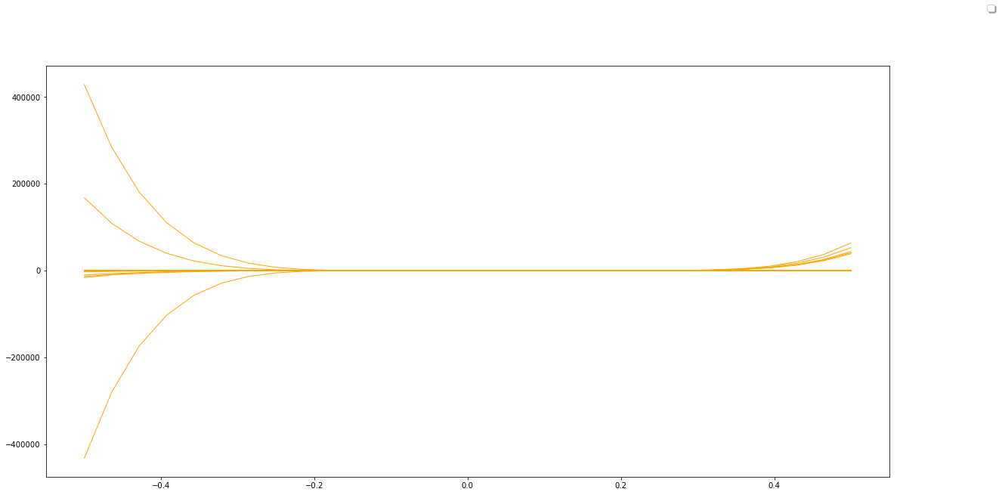

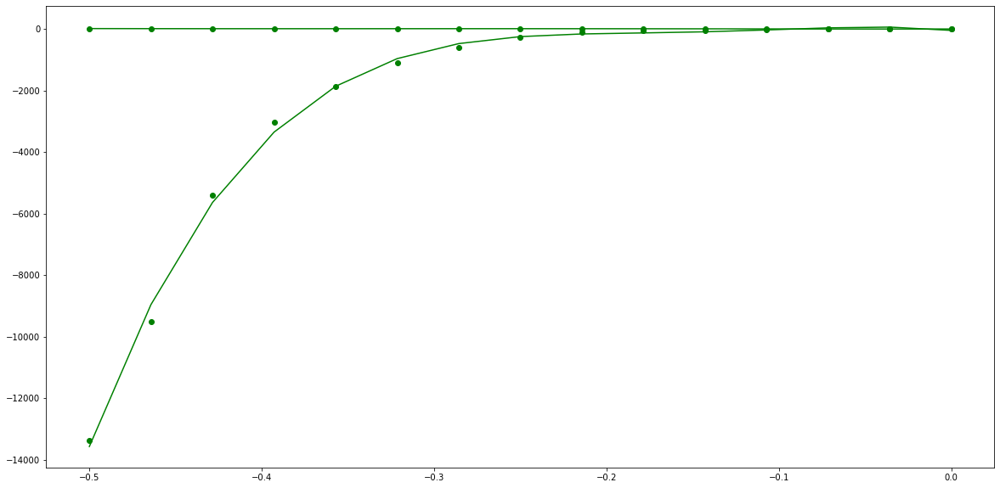

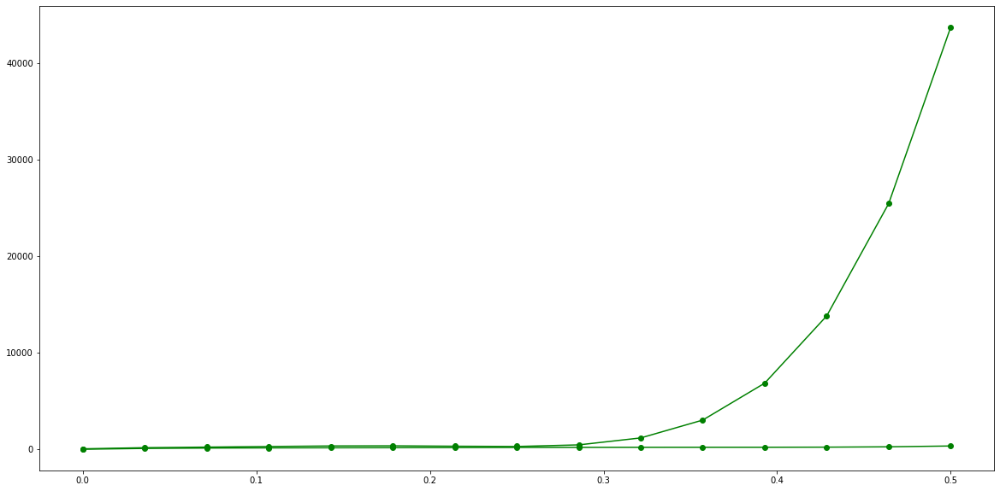

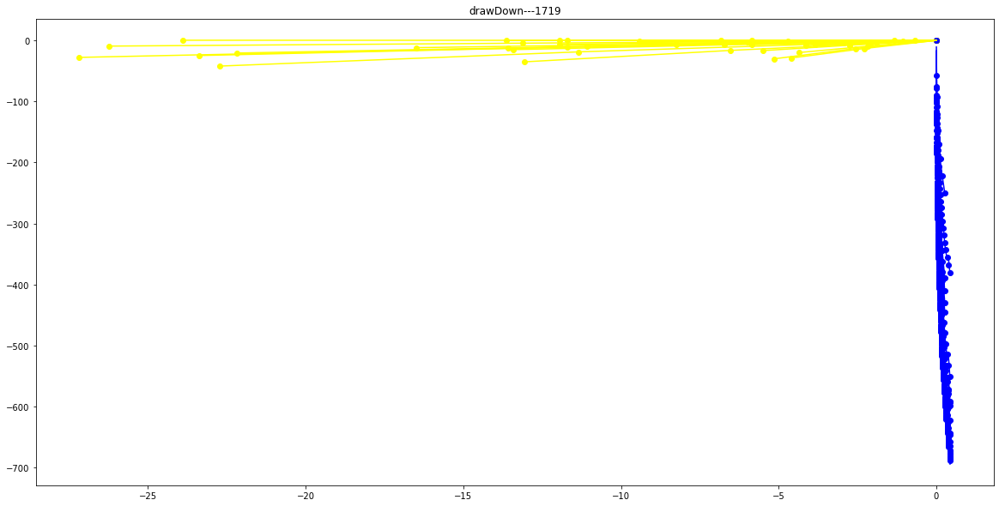

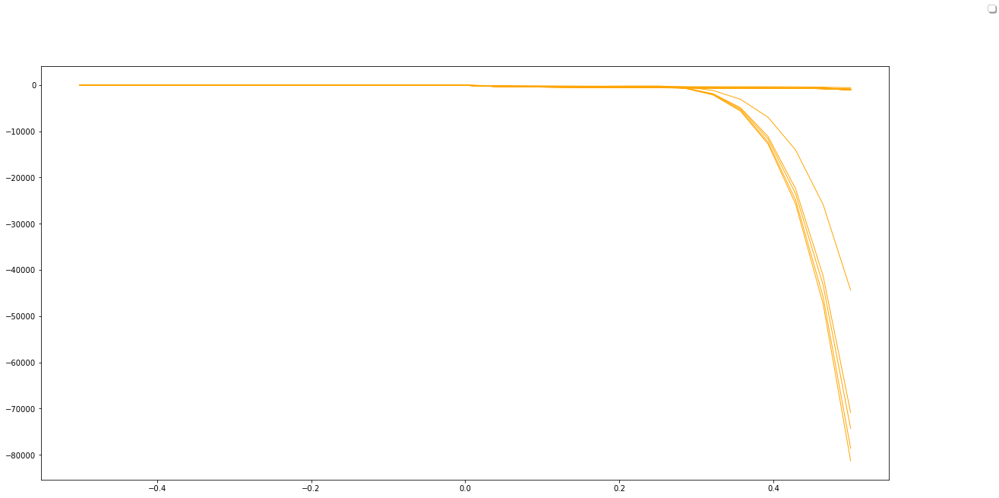

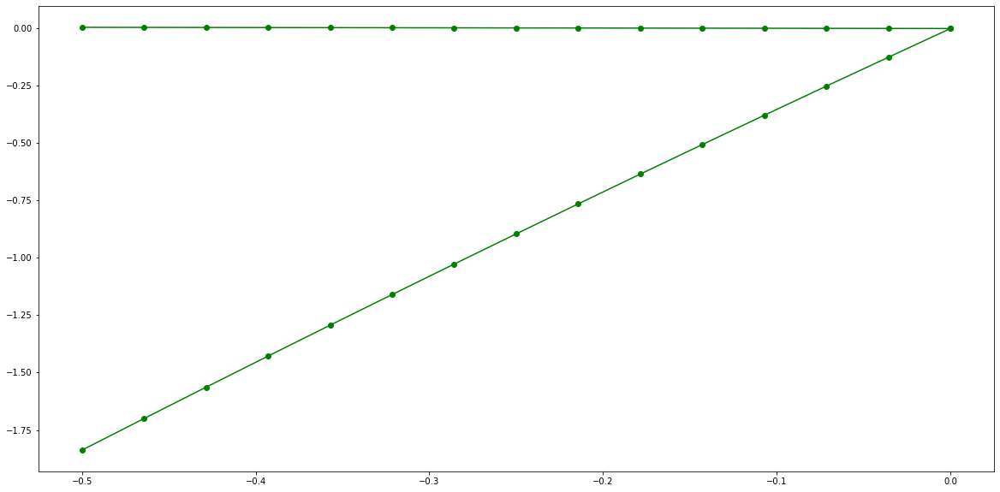

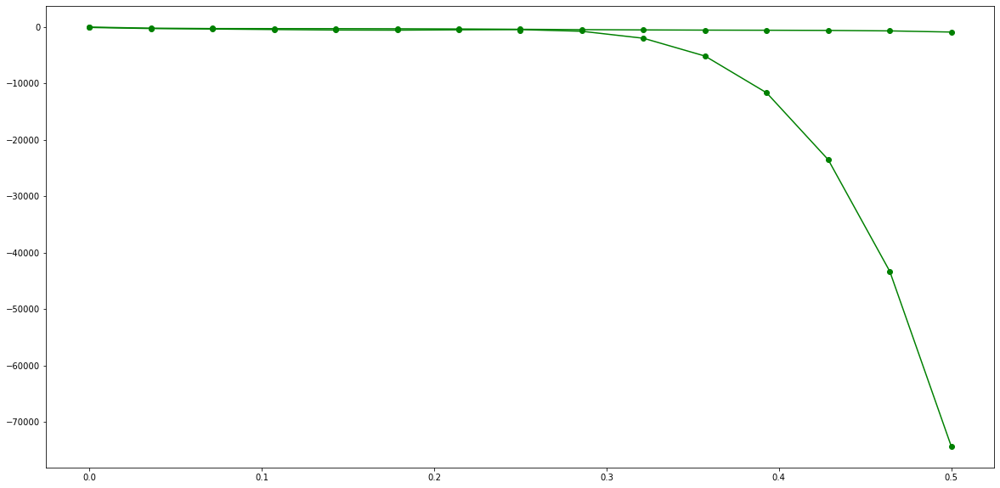

In [6]:
identfication_UsePattern=PatternRecognition(time_halfWindow=0.2,time_halfWindow_forLearn=0.5)
identfication_UsePattern.learn(pressure_measure,pressure_time,ground_truth,fitting_type="polynomial")

In [7]:
buildup,drawdown=identfication_UsePattern.predict(pressure_measure,pressure_time)

len(buildup),len(drawdown)

(1, 1)

## single curve fitting plot for drawdown

In [16]:
# pressure_measure=list(pressure_df[colum_names["pressure"]["measure"]])
# pressure_time=list(pressure_df[colum_names["pressure"]["time"]])
# identfication_UsePattern=PatternRecognition()
# identfication_UsePattern.learn(pressure_measure,pressure_time,ground_truth_buildDrawdown)
# # identfication_UsePattern.parameters_twoPatterns

In [17]:
# number=30
# timeInterval=0.05
# y_left_allCurve = np.empty((0, number), float)
# y_right_allCurve = np.empty((0, number), float)
# x_left=np.linspace(start = -0.01, stop = 0, num = number)
# x_right=np.linspace(start = 0, stop = 0.01, num = number)

# fig=plt.figure(figsize = (20, 10))
# curve_number=len(identfication_UsePattern.parameters_allCurves)
# for i in range(curve_number):
#     y_left=identfication_UsePattern.fitting_func(x_left, identfication_UsePattern.parameters_allCurves["left_curves_parameters"][i])
#     y_right=identfication_UsePattern.fitting_func(x_right, identfication_UsePattern.parameters_allCurves["right_curves_parameters"][i])

#     y_left_allCurve=np.append(y_left_allCurve,np.array([y_left]), axis=0)
#     y_right_allCurve=np.append(y_right_allCurve,np.array([y_right]), axis=0)



#     plt.plot(x_right, y_right, '-', label='New_fit',
#          color="yellow",linewidth=1)
#     plt.plot(x_left, y_left, '-', label='New_fit',
#              color="yellow",linewidth=1)   

In [19]:
identfication_UsePattern.parameters_allCurves

,left_curves_parameters,right_curves_parameters
0,"[5.825779166210675e-05, -0.003076299270022085,...","[-15885.190436529861, 13091.139751022758, -387..."
1,"[0.010006757581135272, -0.02149463803860218, 4...","[-16701.873287872895, 13764.103690197773, -406..."
2,"[0.0009725907473001219, -0.002274200260008804,...","[-17621.593698805016, 14522.11612560941, -4293..."
3,"[2.0207824148681746e-06, -0.000673602867109790...","[-18435.51440441268, 15194.562885017398, -4495..."
4,"[0.0005751894468209895, 0.00870273204304437, 1...","[-18250.181469002702, 15057.797793622496, -445..."
5,"[6.355748010284458e-05, -0.0003764472009621092...","[-17977.246385228555, 14832.616763218244, -439..."
6,"[0.019425115218814754, -0.025719835370105238, ...","[-17241.058520820457, 14225.044589611938, -420..."
7,"[6.328727846283953e-05, -0.001007753848157923,...","[-18102.054383711675, 14935.591591342265, -442..."
8,"[8.455185304909013e-05, -0.0026623327808248548...","[-33857.93574282984, 17052.562160790723, -2969..."
9,"[0.03908740105953, 0.10461514424572044, 5.3057...","[-14755.26890648021, 12174.041558840348, -3601..."


In [20]:
# x_left=np.linspace(start = -0.05, stop = 0, num = 30)
# parameters=identfication_UsePattern.parameters_twoPatterns['buildUp']['left_top']
# y1=polyval_func_wrapper(x_left, *parameters)
# parameters=identfication_UsePattern.parameters_twoPatterns['buildUp']['left_bottom']
# y2=polyval_func_wrapper(x_left, *parameters)
# plt.plot(x_left, y1,color="red",  marker='o')
# plt.plot(x_left, y2, color="blue",linestyle='-')

In [21]:
# x_left=np.linspace(start = -0.05, stop = 0, num = 30)
# parameters=identfication_UsePattern.parameters_twoPatterns['drawDown']['left_top']
# y1=polyval_func_wrapper(x_left, *parameters)
# parameters=identfication_UsePattern.parameters_twoPatterns['drawDown']['left_bottom']
# y2=polyval_func_wrapper(x_left, *parameters)
# plt.plot(x_left, y1,color="red",  marker='o')
# plt.plot(x_left, y2, color="blue",linestyle='-')

In [22]:
identfication_UsePattern.parameters_twoPatterns

{'buildUp': {'left_top': array([-6.87775518e+04, -1.19444071e+04, -3.26115256e+02,  7.80507668e+00]),
  'left_bottom': array([ 3.93794960e+03,  3.74759560e+03,  9.00278607e+02, -2.92923177e+00]),
  'right_top': array([ 5.08604847e+04, -2.69841021e+04,  4.88962415e+03,  4.47553276e+01]),
  'right_bottom': array([ 6177.37828848, -5105.68512855,  1489.71267395,    33.34535086])},
 'drawDown': {'left_top': array([5.59859578, 5.22066834, 1.42547151, 0.12254036]),
  'left_bottom': array([-1.01643168, -0.92890532,  5.48286522,  0.02161668]),
  'right_top': array([-4637.47724987,  3286.35244871, -1319.90148343,   -66.18297383]),
  'right_bottom': array([-7.05918939e+04,  3.99470921e+04, -7.48345106e+03, -5.57934557e+01])}}

In [23]:
identfication_UsePattern.parameters_allCurves

,left_curves_parameters,right_curves_parameters
0,"[5.825779166210675e-05, -0.003076299270022085,...","[-15885.190436529861, 13091.139751022758, -387..."
1,"[0.010006757581135272, -0.02149463803860218, 4...","[-16701.873287872895, 13764.103690197773, -406..."
2,"[0.0009725907473001219, -0.002274200260008804,...","[-17621.593698805016, 14522.11612560941, -4293..."
3,"[2.0207824148681746e-06, -0.000673602867109790...","[-18435.51440441268, 15194.562885017398, -4495..."
4,"[0.0005751894468209895, 0.00870273204304437, 1...","[-18250.181469002702, 15057.797793622496, -445..."
5,"[6.355748010284458e-05, -0.0003764472009621092...","[-17977.246385228555, 14832.616763218244, -439..."
6,"[0.019425115218814754, -0.025719835370105238, ...","[-17241.058520820457, 14225.044589611938, -420..."
7,"[6.328727846283953e-05, -0.001007753848157923,...","[-18102.054383711675, 14935.591591342265, -442..."
8,"[8.455185304909013e-05, -0.0026623327808248548...","[-33857.93574282984, 17052.562160790723, -2969..."
9,"[0.03908740105953, 0.10461514424572044, 5.3057...","[-14755.26890648021, 12174.041558840348, -3601..."


In [24]:
# buildup,drawdown=identfication_UsePattern.predict(pressure_measure,pressure_time)

# len(buildup),len(drawdown)

In [25]:
# display(identfication_UsePattern.data_forPredict.iloc[0]["buildUp"])
# identfication_UsePattern.data_forPredict.iloc[0]["drawDown"]

In [26]:
# identfication_UsePattern.data_forPredict

---initializing...
---plotting...


findfont: Font family ['Arial Black'] not found. Falling back to DejaVu Sans.


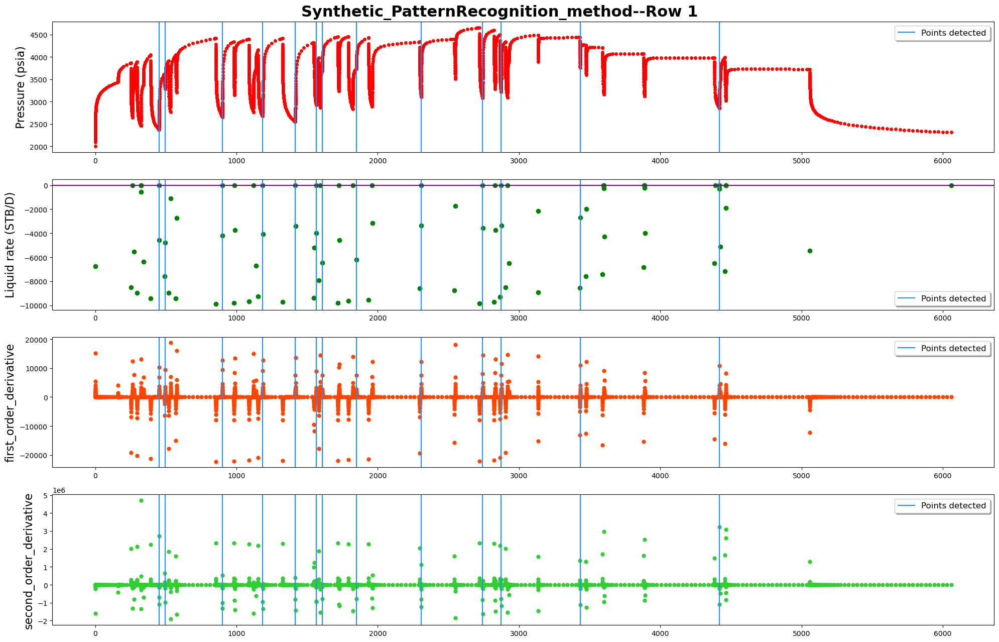

detected 13 points as breakpoints
The plot is devided into 9 rows
------row 1-----detected points:[]


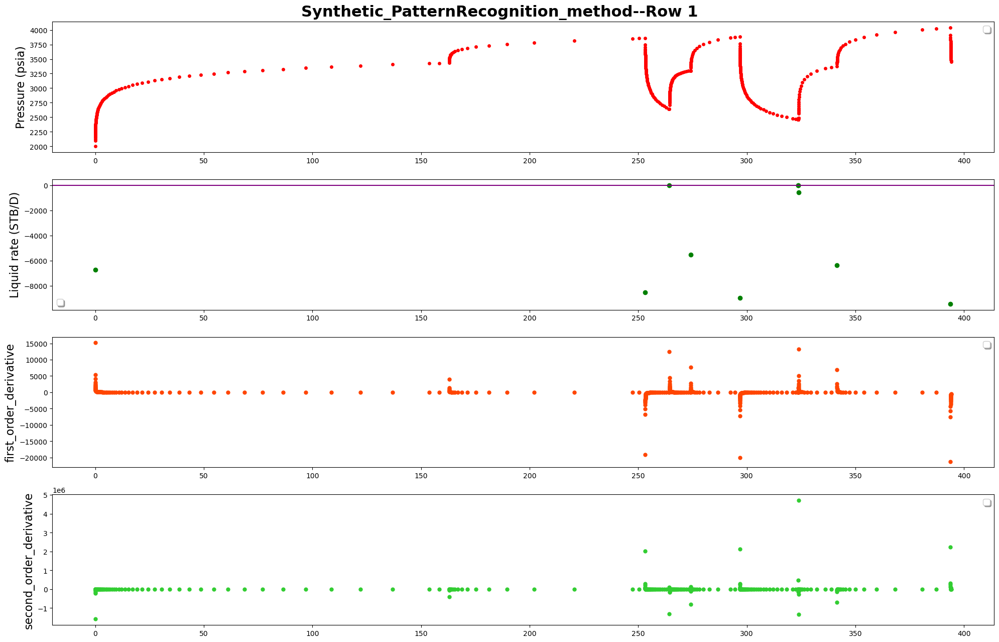

------row 2-----detected points:[446, 523, 713]


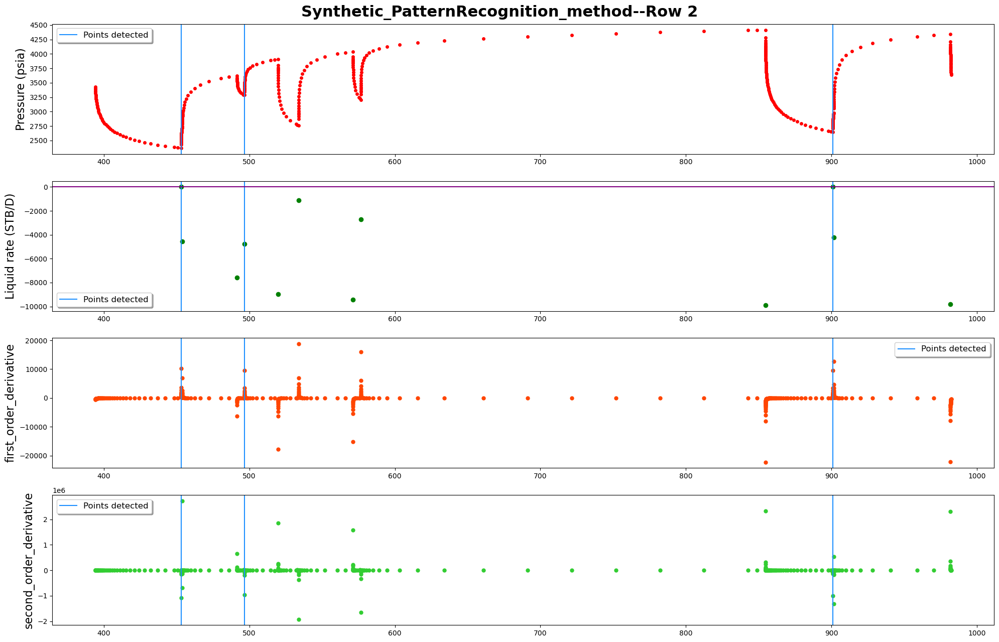

------row 3-----detected points:[1101]


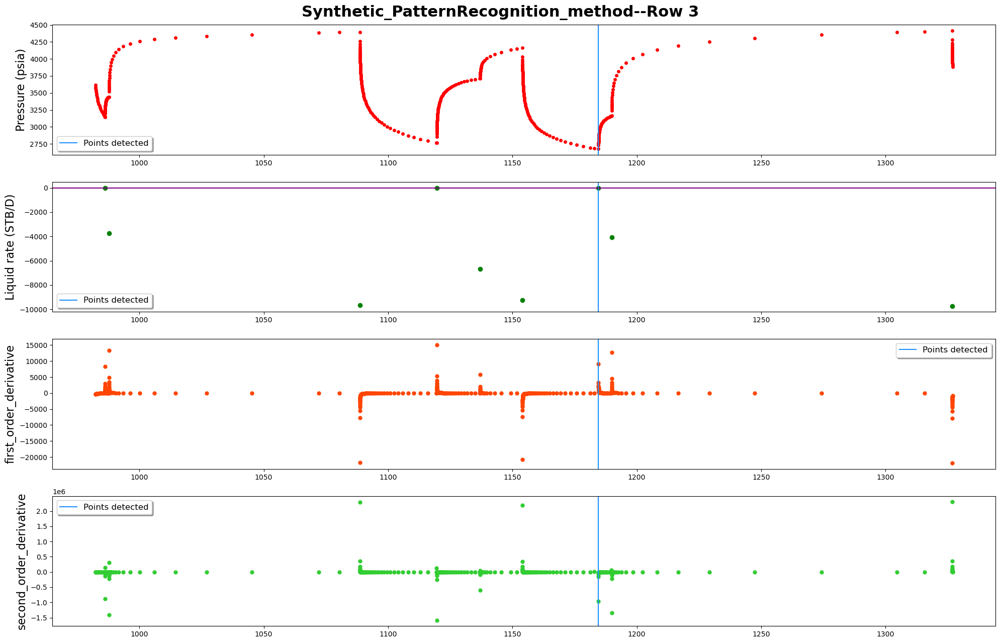

------row 4-----detected points:[1254, 1396, 1571]


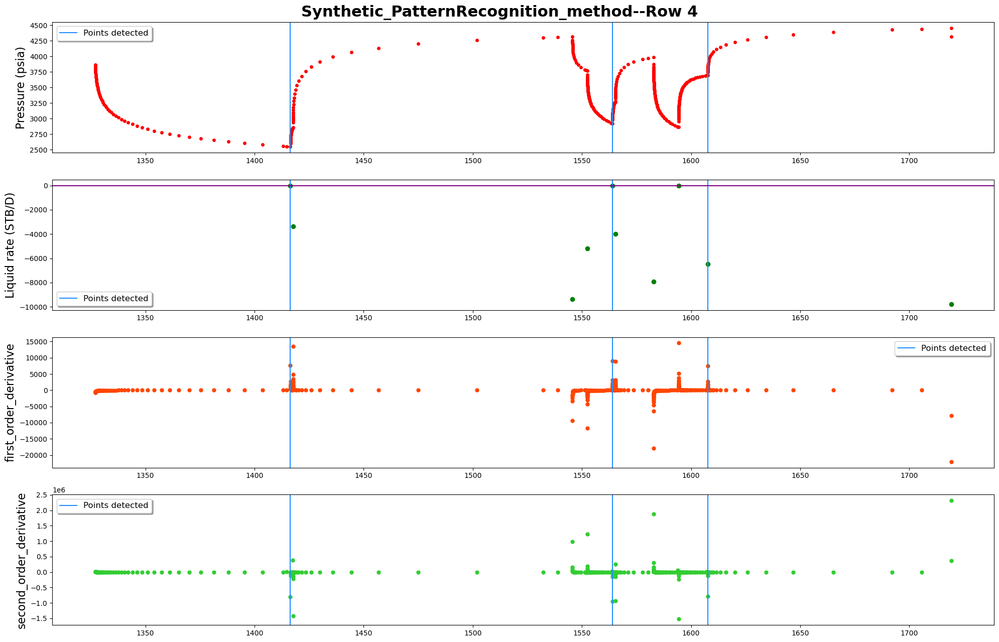

------row 5-----detected points:[1848]


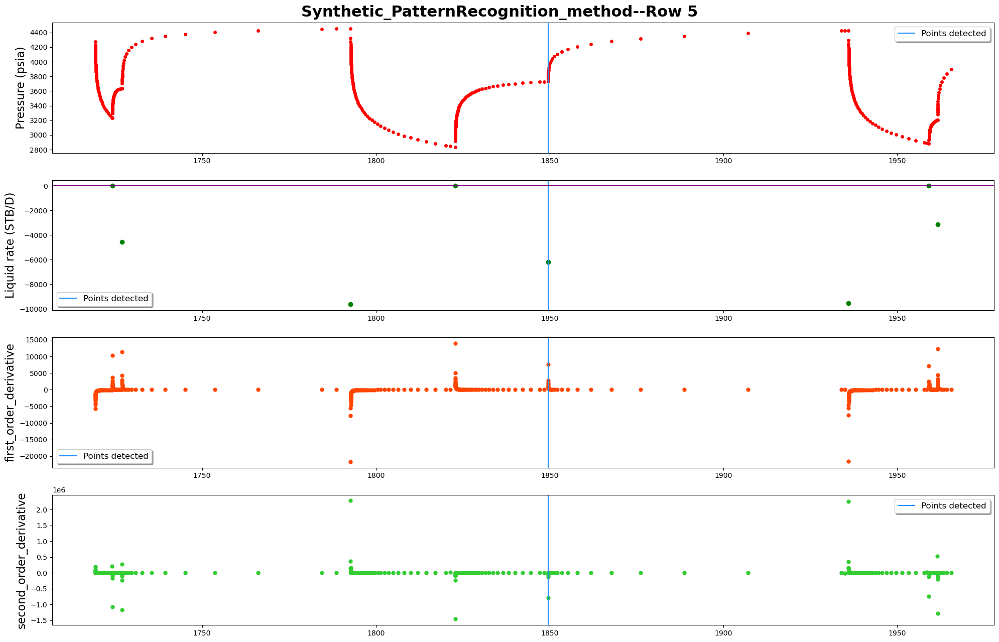

------row 6-----detected points:[2073, 2247]


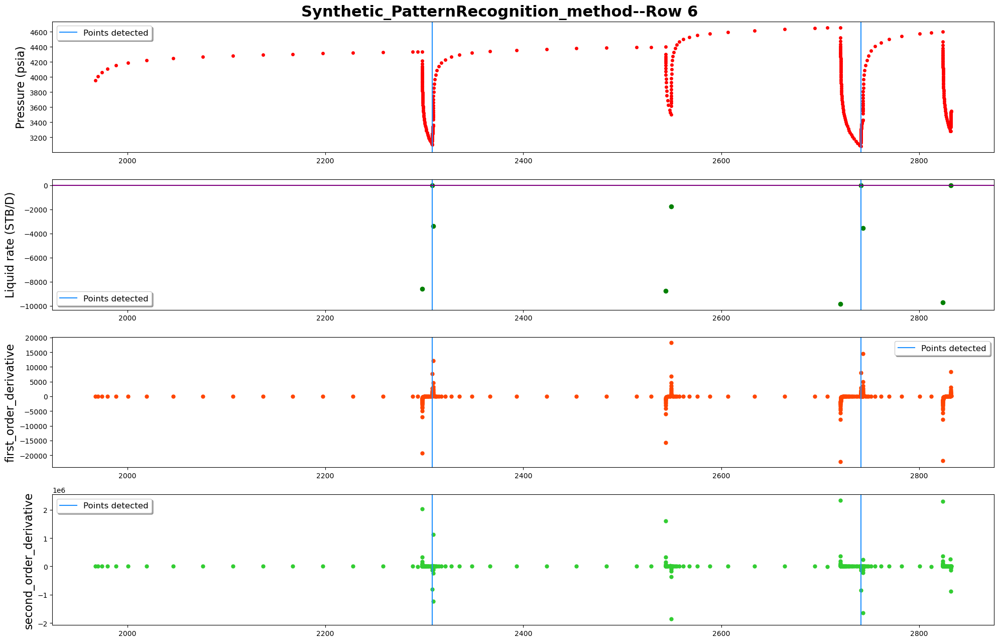

------row 7-----detected points:[2487, 2764]


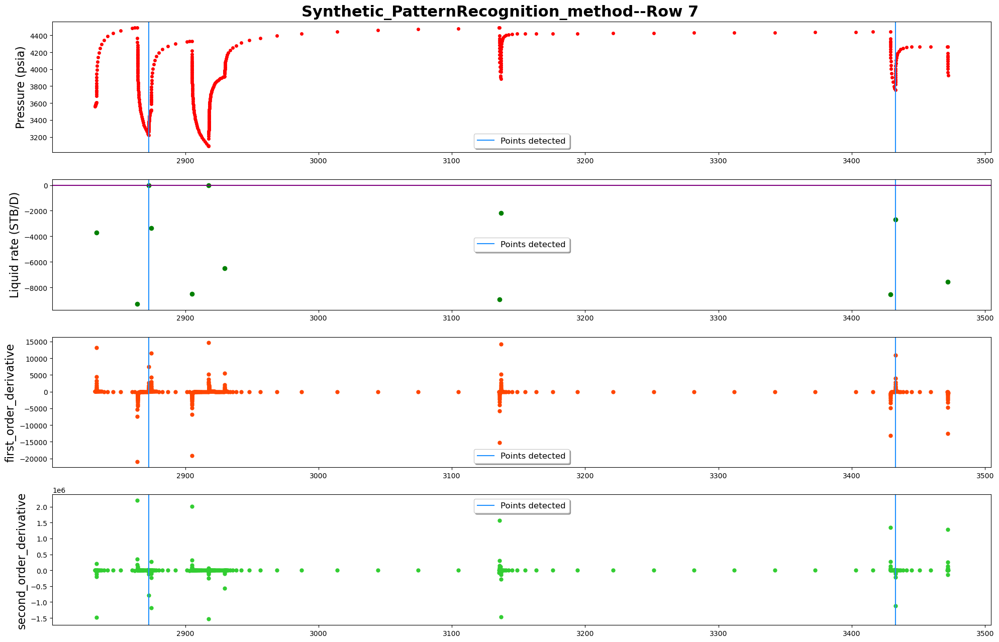

------row 8-----detected points:[]


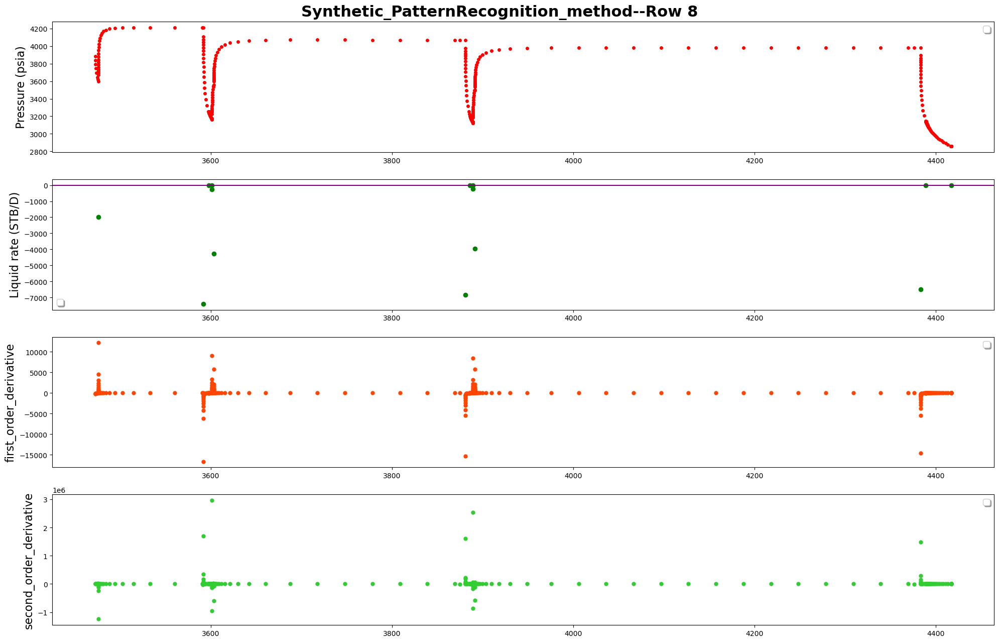

------row 9-----detected points:[3240]


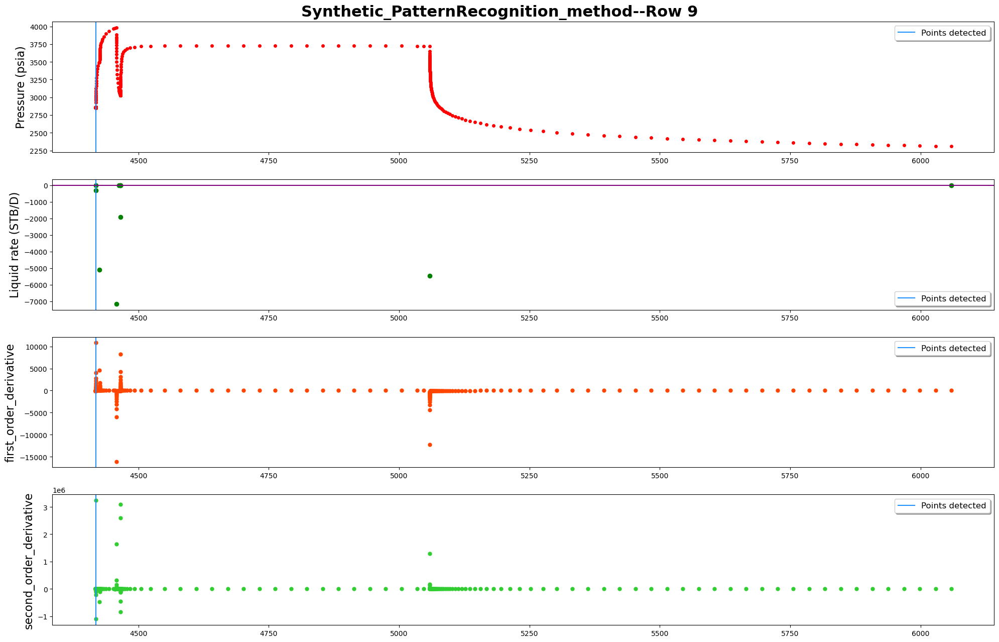

In [27]:
filename_toSave=""
plot_name="Synthetic_PatternRecognition_method"
plot_whole=True
plot_details=True
plot_statistics=False
PlotNSave(pressure_df,
          rate_df,
          buildup,
          [],
          data_inOneRow,
          plot_name,
          filename_toSave,
          plot_statistics,
          plot_whole,
          plot_details,
          colum_names)

In [28]:
# pressure_measure=list(pressure_df[colum_names["pressure"]["measure"]])
# pressure_time=list(pressure_df[colum_names["pressure"]["time"]])
# identfication_UsePattern=PatternRecognition(point_halfWindow=5,time_halfWindow=0.005,)
# identfication_UsePattern.learn(pressure_measure,pressure_time,ground_truth)
# identfication_UsePattern.parameters_twoPatterns

# todo

*todo:fine tuning*</br>
(could combine different experiment result together)</br>
1 </br>
**use exponential or log curve for predicting</br>
fitting curve for predicting</br>
percentile</br>
function type when fitting the border</br>
the number of points when calculate the pattern parameters</br>
window for learning</br>
window for predicting</br>**
2 </br>
use the difference of slope </br>
or</br>
statistics of slope</br>


# real case data

## raw data

### system setup

In [3]:
#experiment setup
ground_truth_temp=[2249,  2467,  2805,[2875, 2876],3100,3561,3994,[4228, 4232],4753,4895, 5297,5436,5985,[6543, 6547], 7249,[7544, 7545],7946,[8362, 8364],9025,[9607, 9608],10149,10216, 10528,[10801, 10804],11340,  11479,12363,[13039, 13040],13868, 14086,14774,15341,16098,16619,[17589, 17590],18435,19643,19764,20021,20349,20701,21030,21974,22186,22710,23220,24215,24685,25717,26006,26656, 26759,27023,[27316,27327],27773,[27966,27970],28322,28497,28832,29115]
# ground_truth=[]

colum_names   ={"pressure":{"time":"Elapsed time",
                             "measure":"Data",
                             "first_order_derivative":"first_order_derivative",
                             "second_order_derivative":"second_order_derivative"},
                "rate":{"time":"Elapsed time",
                        "measure":"Liquid rate"}}
data_inOneRow=1000
pressure_filePath="../data_input/EAGE_Shchipanov_2017/Pressure.txt"
rate_filePath="../data_input/EAGE_Shchipanov_2017/Rate.txt"

ground_truth=[]
for point in ground_truth_temp: 
    if "list" in str(type(point)):
        ground_truth.append(math.ceil(sum(point)/len(point)))
    else:
        ground_truth.append(point)
                     
print("len(ground_truth):",len(ground_truth))
processed_data=LoadNPreprocessData(pressure_filePath=pressure_filePath, 
                 rate_filePath=rate_filePath, 
                 colum_names=colum_names, 
                 use_SG_smoothing=False)
pressure_df=processed_data.pressure_df
rate_df=processed_data.rate_df

display(pressure_df)
display(rate_df)
# display(processed_data.pressureNrate_df)

first_order_derivative=pressure_df["first_order_derivative"]
second_order_derivative=pressure_df["second_order_derivative"]

len(ground_truth): 60
---load data from 'txt' or 'xlsx' files...
check the time type
---The first & second order derivative has been calculated and appended to pressure dataframe


,Elapsed time,Data,first_order_derivative,second_order_derivative
0,0.000000,2988.99,4.618487,284.977831
1,0.495833,2991.28,145.919995,-3087.359588
2,0.516667,2994.32,81.600002,1184.914121
3,0.545833,2996.70,116.159996,-1817.279726
4,0.566667,2999.12,78.300001,-168.428622
...,...,...,...,...
29808,4063.495571,7938.65,0.439085,0.126970
29809,4065.499737,7939.53,0.693555,-0.271368
29810,4067.503904,7940.92,0.149688,-0.123142
29811,4069.508071,7941.22,-0.097110,0.000000


,Elapsed time,Liquid rate
0,0.433384,-3916.602731
1,2.516718,-3913.489043
2,4.600051,-3911.804387
3,6.641718,-3910.573563
4,7.683384,-3907.017652
...,...,...
10186,4074.862089,-18459.075655
10187,4075.028756,-18423.899451
10188,4075.237089,-18412.745895
10189,4075.362089,-18413.519153


In [30]:
pressure_measure=list(pressure_df[colum_names["pressure"]["measure"]])
pressure_time=list(pressure_df[colum_names["pressure"]["time"]])
identfication_UsePattern=PatternRecognition(delta_pointNumber =5)
identfication_UsePattern.learn(pressure_measure,pressure_time,ground_truth)
identfication_UsePattern.parameters_twoPatterns

TypeError: __init__() got an unexpected keyword argument 'delta_pointNumber'

In [ ]:
buildup,drawdown=identfication_UsePattern.predict(pressure_measure,pressure_time)
print(len(buildup),len(drawdown))
buildup,drawdown

In [ ]:
print(len(breakpoints))
breakpoints

In [ ]:
buildup,drawdown=identfication_UsePattern.detect_breakpoint_type(pressure_measure,pressure_time,ground_truth)
# identfication_UsePattern.parameters_allCurves
print(len(buildup),buildup)
# print(len(ground_truth_buildUp),ground_truth_buildUp)
print(len(drawdown),drawdown)

In [ ]:
breakpoint_buildUp=[]
breakpoint_drawDown=[]
for index,parameter in identfication_UsePattern.parameters_allCurves.iterrows():
    #compare slope and convert index in the parameters_allCurves to in pressure_df
    if parameter["left_curves_parameters"][0]<parameter["right_curves_parameters"][0]:
        breakpoint_buildUp.append(ground_truth_buildUp[index])
    else:
        breakpoint_drawDown.append(ground_truth_buildUp[index])


In [ ]:
# data={"left_curve_parameters":identfication_UsePattern.curveLeft_parameters,
#      "right_curve_parameters":identfication_UsePattern.curveRight_parameters}
# df=pd.DataFrame(data)
# display(df)
# for index,row in df.iterrows():
#     print(row["left_curve_parameters"], row["left_curve_parameters"][-1])

In [ ]:
identfication_UsePattern.sav_pattern()

In [ ]:
identfication_UsePattern.load_pattern()
identfication_UsePattern.parameters_PatternField 

In [ ]:
filePath_learnedPattern="../data_output/Learned_Pattern.csv"
border_names=["left_top","left_bottom","right_top","right_bottom"]
paras_df = pd.read_csv(filePath_learnedPattern, delimiter=" ",skiprows=1, names=border_names,skipinitialspace = True) 
paras_df

In [ ]:
# #spline interpolation
# x_i=np.linspace(0,10,100)
# f_spline=interpld(xdata,ydata,kind="cubic")
# y_is=f_spline(x_i)

In [ ]:
a={"pressure_time_right":[1,2,3],
"pressure_measure_right":[4,5,6]}
b={key:[value] for key,value in a.items()}
pd.DataFrame(a)
pd.DataFrame(b)

In [ ]:
curveData= pd.DataFrame({'Odd':[[1,3,15,6,7,9]], 'Even':[[0,12,4,6,8,10]]})
data = pd.DataFrame({'Odd':[[1,3,5,6,7,9]], 'Even':[[0,2,4,6,8,10]]})
curveData=curveData.append(data,ignore_index=True)
# data=data.iloc[::-1]
display(curveData)
for index,row in curveData.iterrows():
#     print(row)
#     row['Odd'].reverse()
    print(row.index)
display(curveData)

## denoised data

### system setup

In [3]:
#experiment setup
ground_truth_temp=[2249,  2467,  2805,[2875, 2876],3100,3561,3994,[4228, 4232],4753,4895, 5297,5436,5985,[6543, 6547], 7249,[7544, 7545],7946,[8362, 8364],9025,[9607, 9608],10149,10216, 10528,[10801, 10804],11340,  11479,12363,[13039, 13040],13868, 14086,14774,15341,16098,16619,[17589, 17590],18435,19643,19764,20021,20349,20701,21030,21974,22186,22710,23220,24215,24685,25717,26006,26656, 26759,27023,[27316,27327],27773,[27966,27970],28322,28497,28832,29115]
# ground_truth=[]

colum_names   ={"pressure":{"time":"Elapsed time",
                             "measure":"Data",
                             "first_order_derivative":"first_order_derivative",
                             "second_order_derivative":"second_order_derivative"},
                "rate":{"time":"Elapsed time",
                        "measure":"Liquid rate"}}
data_inOneRow=1000
pressure_filePath="../data_input/EAGE_Shchipanov_2017/Pressure.txt"
rate_filePath="../data_input/EAGE_Shchipanov_2017/Rate.txt"
ground_truth=[]
for point in ground_truth_temp: 
    if "list" in str(type(point)):
        ground_truth.append(math.ceil(sum(point)/len(point)))
    else:
        ground_truth.append(point)
                     
print("len(ground_truth):",len(ground_truth))
print(ground_truth)

processed_data_denoised=LoadNPreprocessData(pressure_filePath=pressure_filePath, 
                 rate_filePath=rate_filePath, 
                 colum_names=colum_names, 
                 use_SG_smoothing=True)
pressure_df_denoised=processed_data_denoised.pressure_df
pressure_df=pressure_df_denoised
pressure_measure=list(pressure_df[colum_names["pressure"]["measure"]])
print("len(pressure_measure)",len(pressure_measure))
pressure_time=list(pressure_df[colum_names["pressure"]["time"]])
# ground truth adapted for denoise data
denoised_ground_truth=[2248, 2467, 2804, 2884, 3095, 3560, 3987, 4246, 4750, 4899, 5297, 5436, 5983, 6543, 7249, 7545, 7946, 8361, 9024, 9619, 10149, 10224, 10527, 10800, 11340,11490, 12362, 13040, 13867, 14089, 14766, 15348, 16097, 16619, 17589, 18434, 19642, 19777, 20014, 20358, 20700, 21025, 21974, 22183, 22709, 23219, 24215, 24683, 25698, 26011, 26656, 26753, 27022, 27315, 27760, 27969, 28322, 28494, 28831, 29115]
print("len(denoised_ground_truth)",len(denoised_ground_truth))
denoised_ground_truth.remove(9024)
denoised_ground_truth.remove(10800)
denoised_ground_truth.remove(2467)
denoised_ground_truth.remove(10224)
denoised_ground_truth.remove(21025)
denoised_ground_truth.remove(26753)
print("len(denoised_ground_truth)",len(denoised_ground_truth))

len(ground_truth): 60
[2249, 2467, 2805, 2876, 3100, 3561, 3994, 4230, 4753, 4895, 5297, 5436, 5985, 6545, 7249, 7545, 7946, 8363, 9025, 9608, 10149, 10216, 10528, 10803, 11340, 11479, 12363, 13040, 13868, 14086, 14774, 15341, 16098, 16619, 17590, 18435, 19643, 19764, 20021, 20349, 20701, 21030, 21974, 22186, 22710, 23220, 24215, 24685, 25717, 26006, 26656, 26759, 27023, 27322, 27773, 27968, 28322, 28497, 28832, 29115]
---load data from 'txt' or 'xlsx' files...
check the time type
---denoising data using S-G smoothing...
---The first & second order derivative has been calculated and appended to pressure dataframe
len(pressure_measure) 29813
len(denoised_ground_truth) 60
len(denoised_ground_truth) 54


### plot ground truth of denoised data

---initializing...
---plotting...
detected 60 points as breakpoints
The plot is devided into 25 rows
------row 1-----detected points:[]


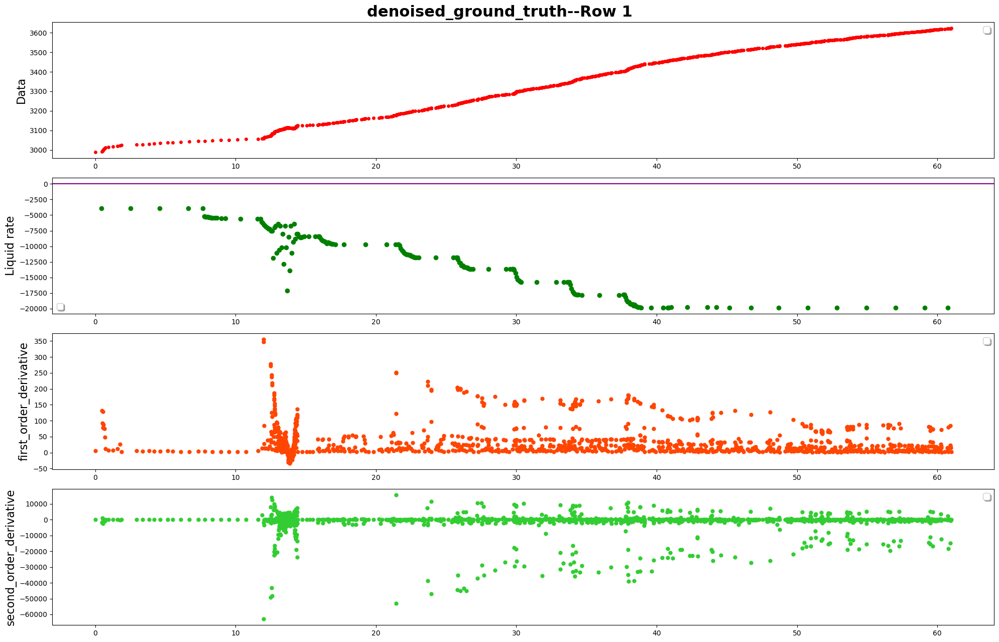

------row 2-----detected points:[2248]


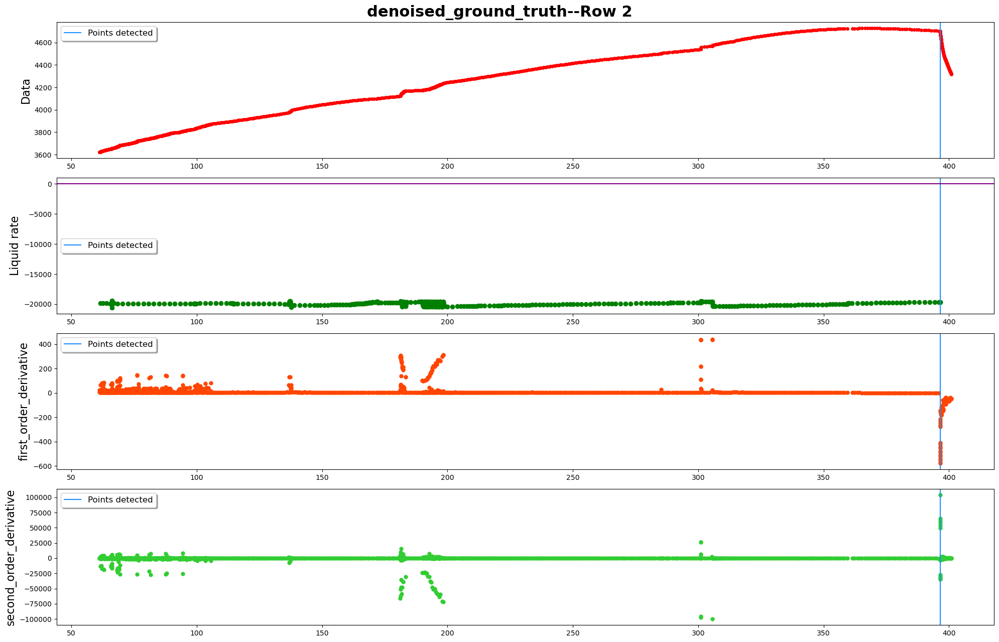

------row 3-----detected points:[2467, 2804, 2884, 3095, 3560]


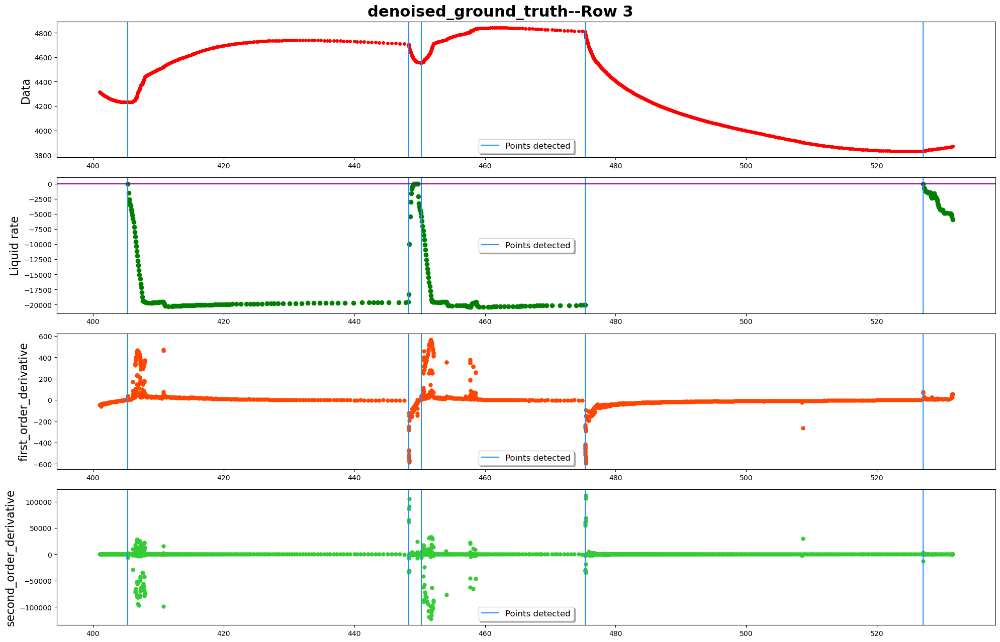

------row 4-----detected points:[3987, 4246, 4750]


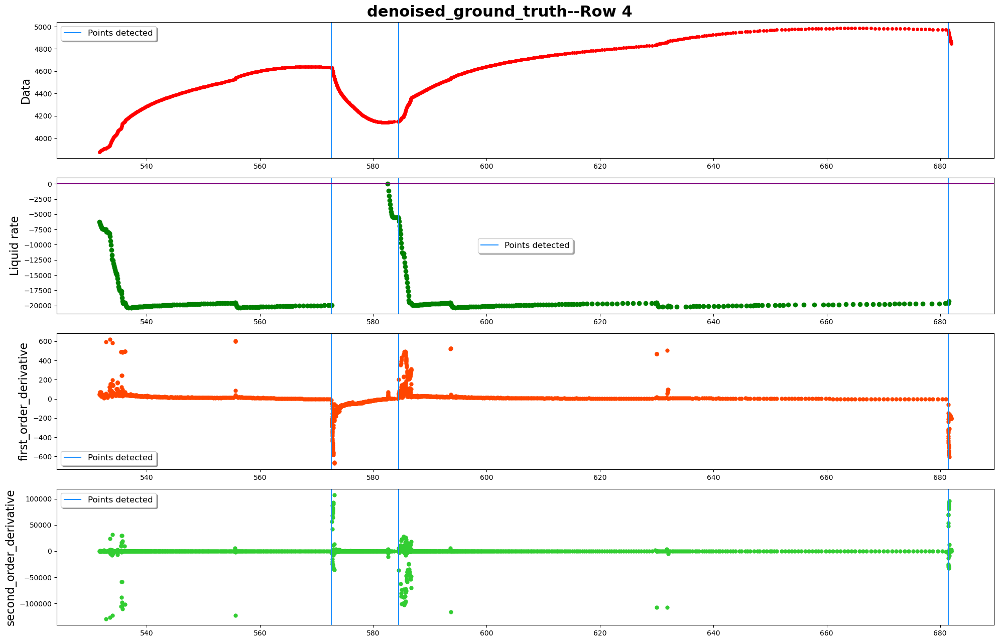

------row 5-----detected points:[4899, 5297, 5436, 5983]


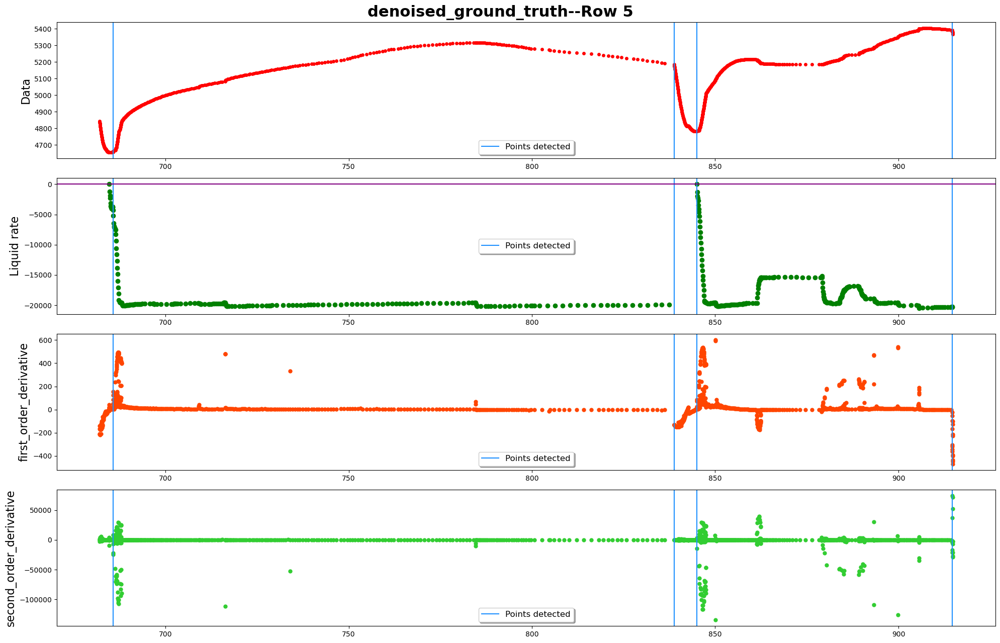

------row 6-----detected points:[6543]


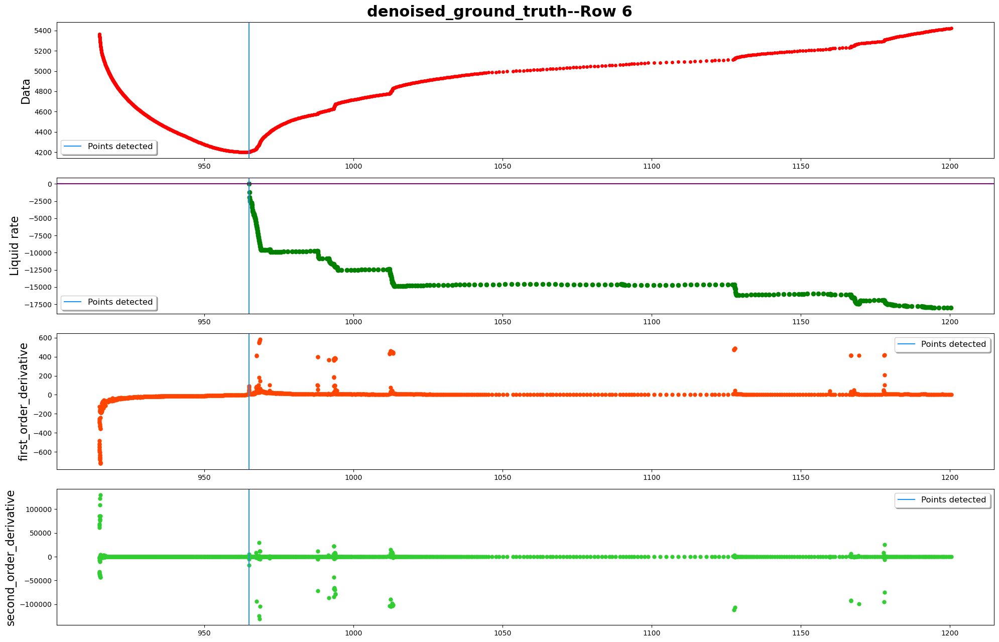

------row 7-----detected points:[7249, 7545, 7946, 8361]


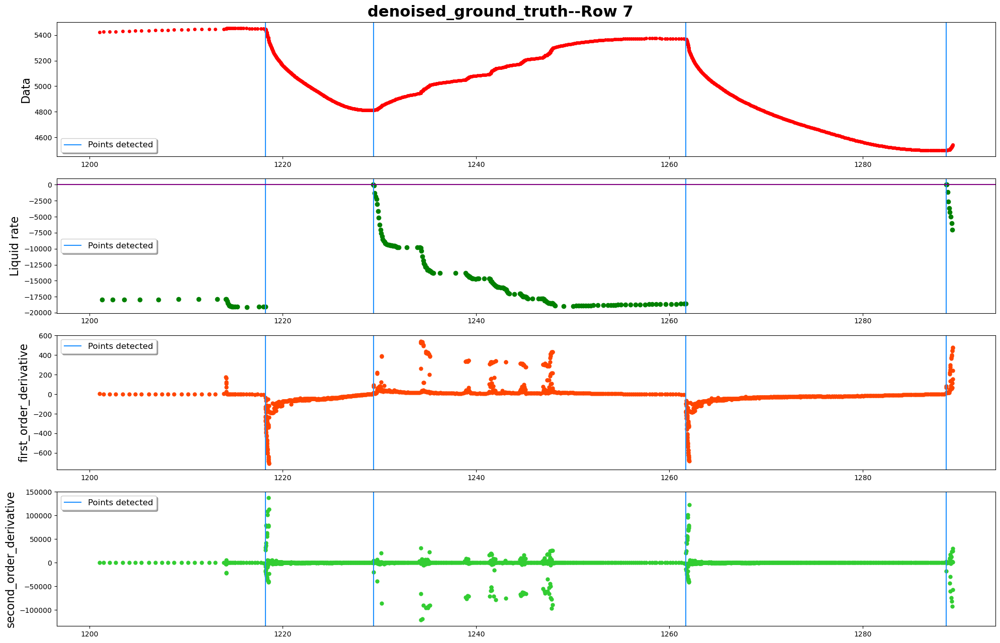

------row 8-----detected points:[9024]


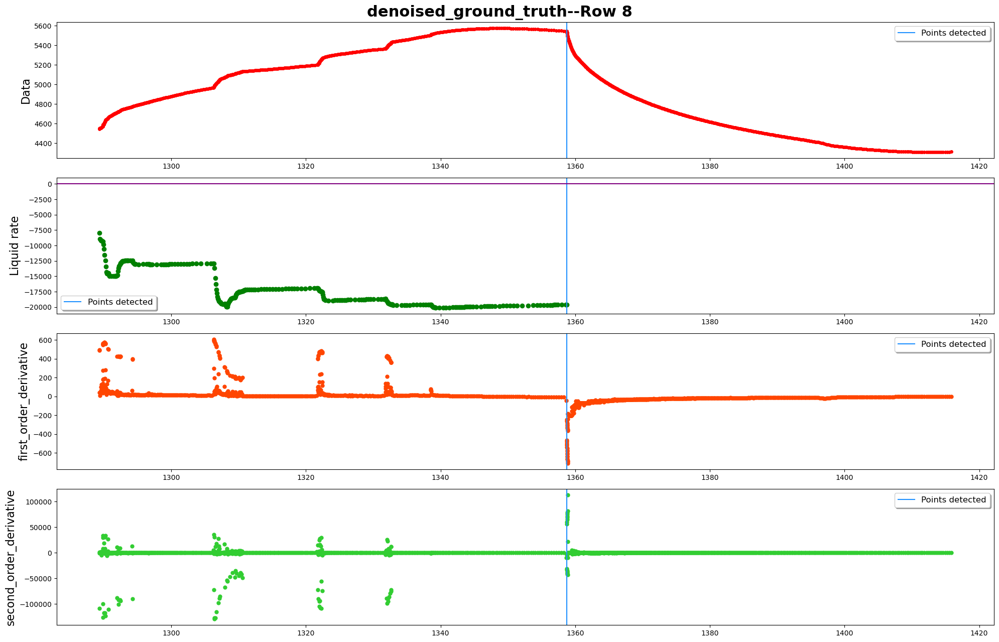

------row 9-----detected points:[9619, 10149, 10224, 10527]


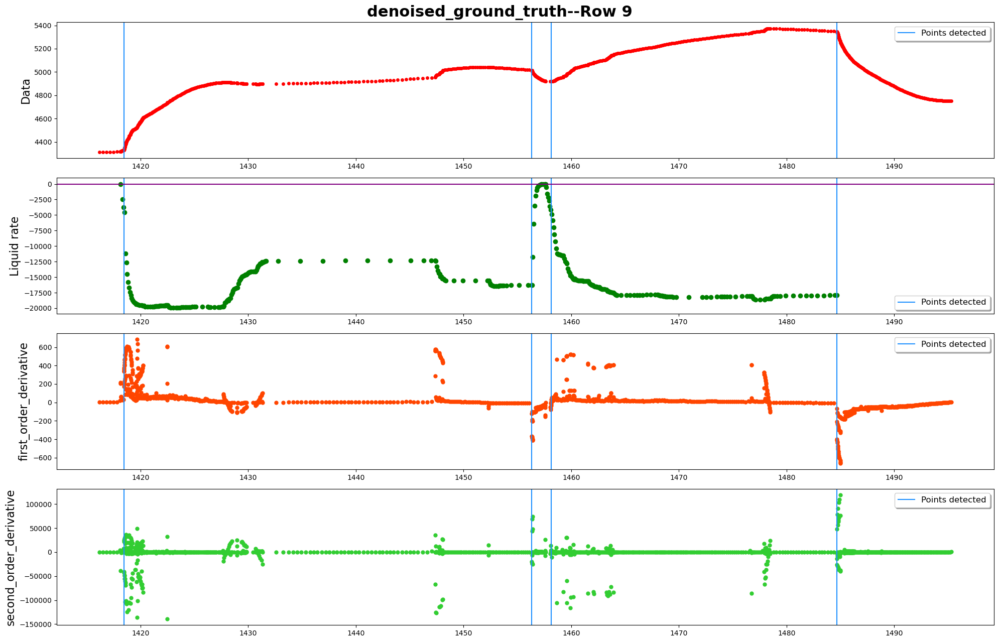

------row 10-----detected points:[11340, 11490]


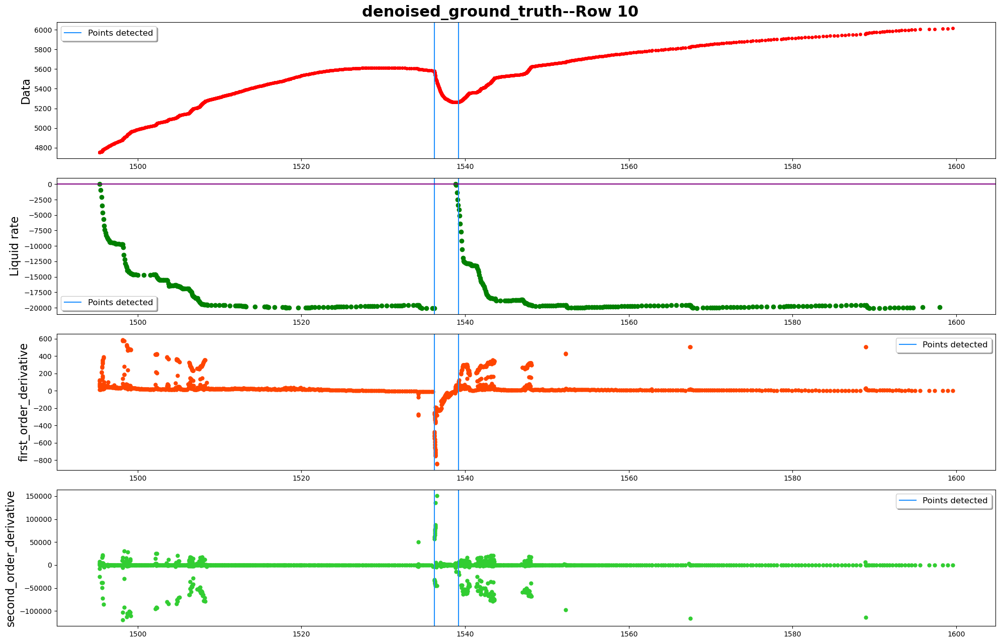

------row 11-----detected points:[12362, 13040]


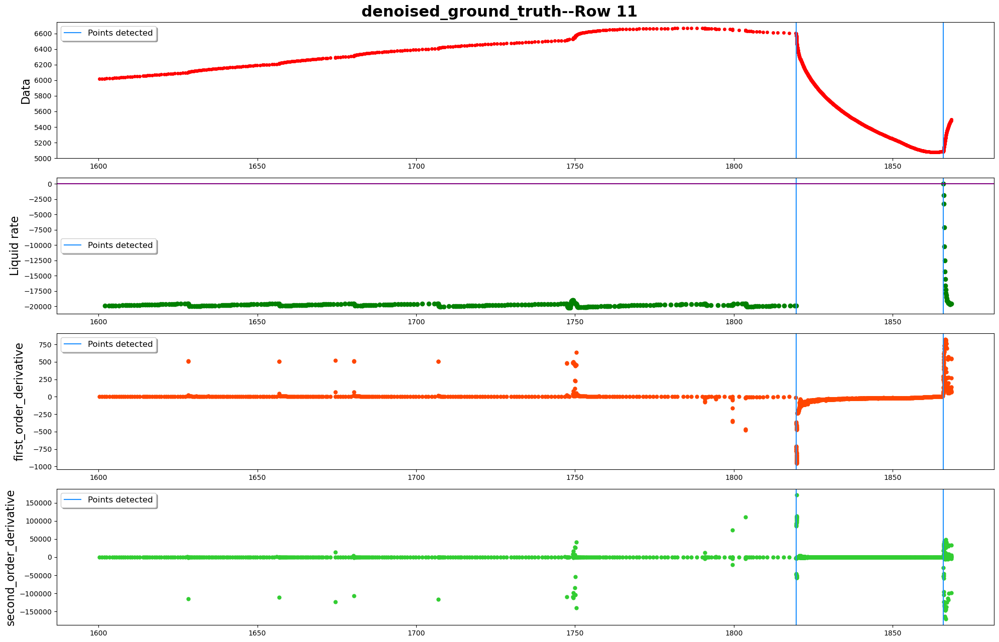

------row 12-----detected points:[13867, 14089]


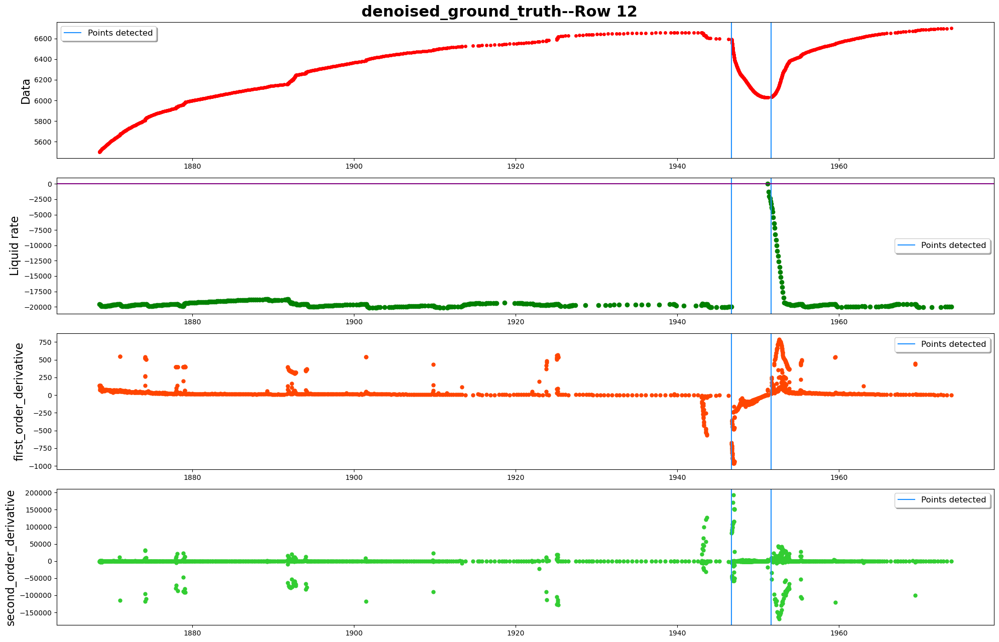

------row 13-----detected points:[14766, 15348]


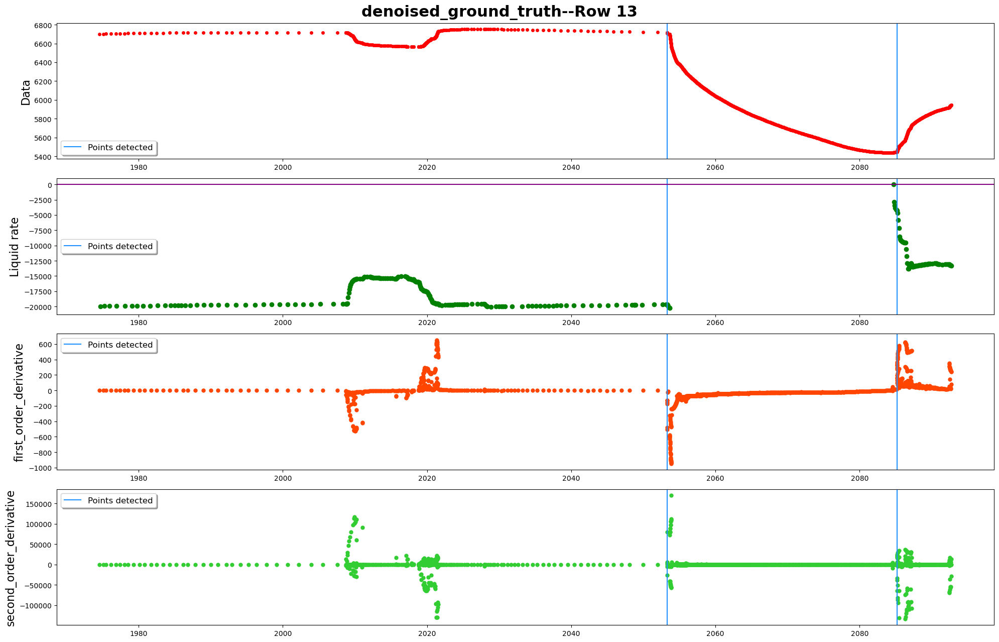

------row 14-----detected points:[16097, 16619]


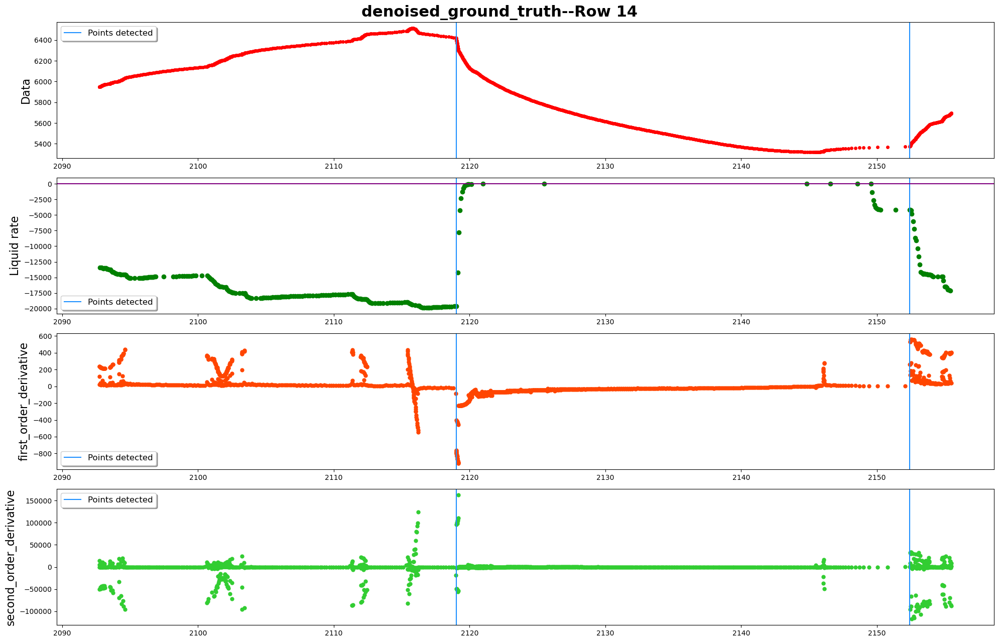

------row 15-----detected points:[17589]


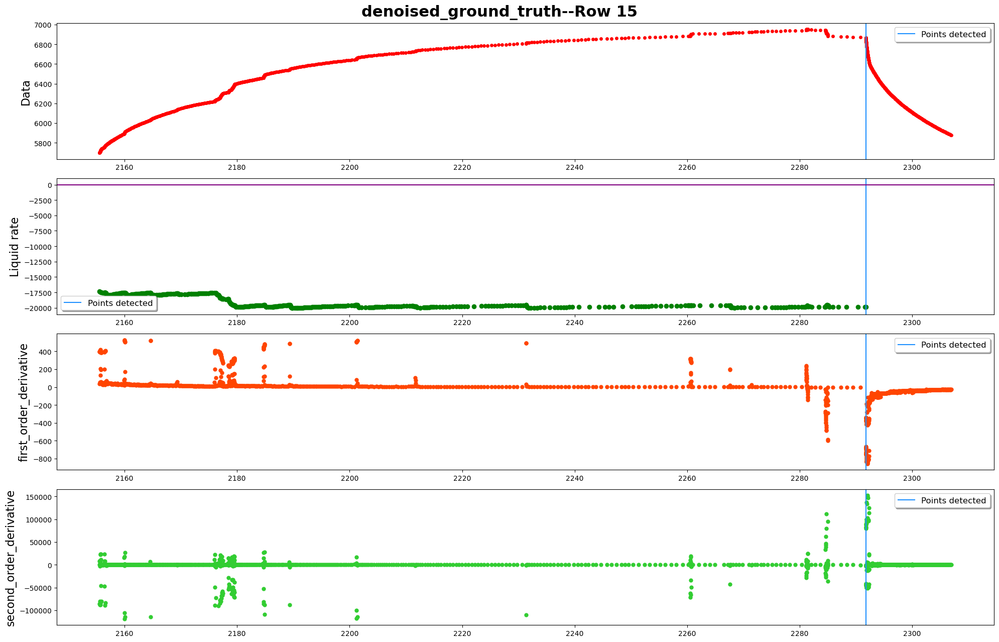

------row 16-----detected points:[18434]


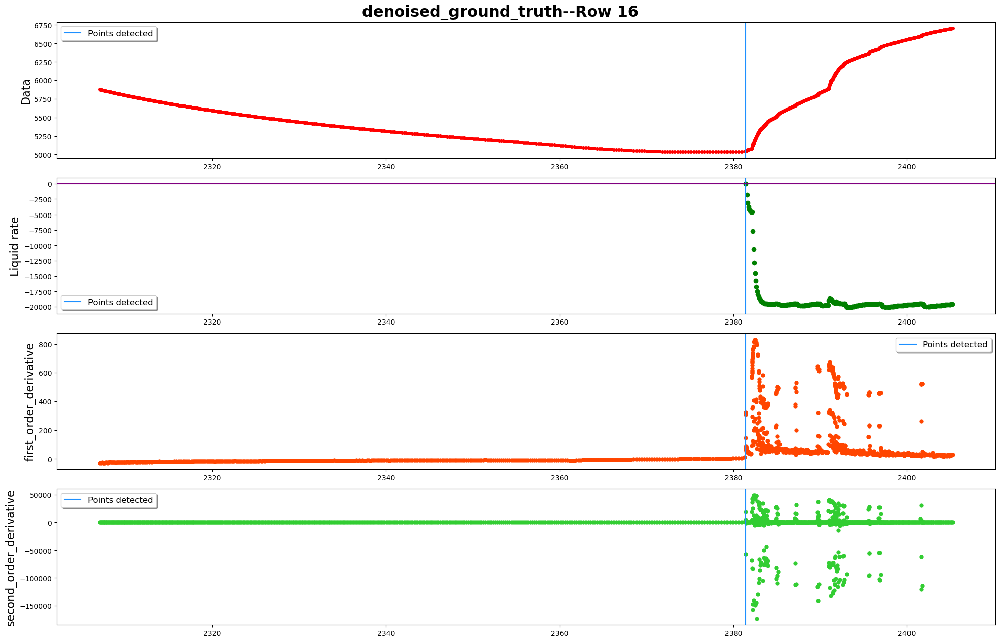

------row 17-----detected points:[19642, 19777, 20014, 20358]


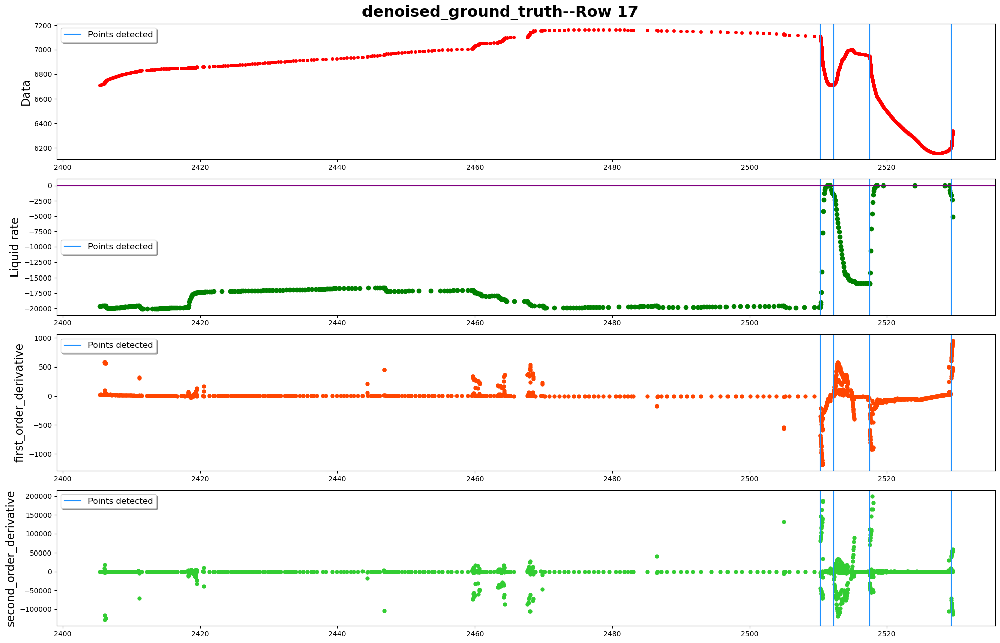

------row 18-----detected points:[20700, 21025]


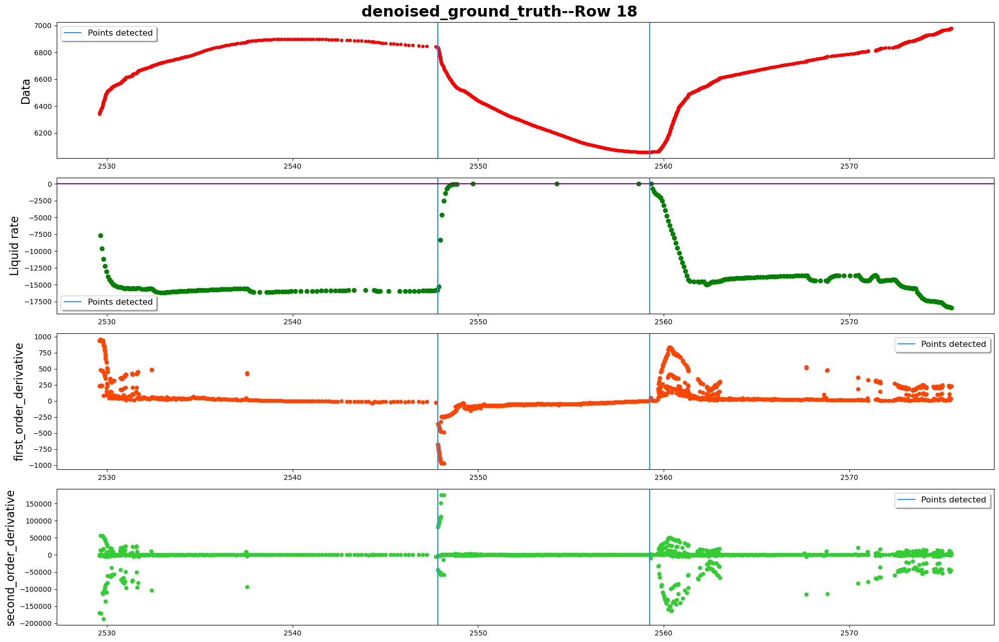

------row 19-----detected points:[21974, 22183, 22709]


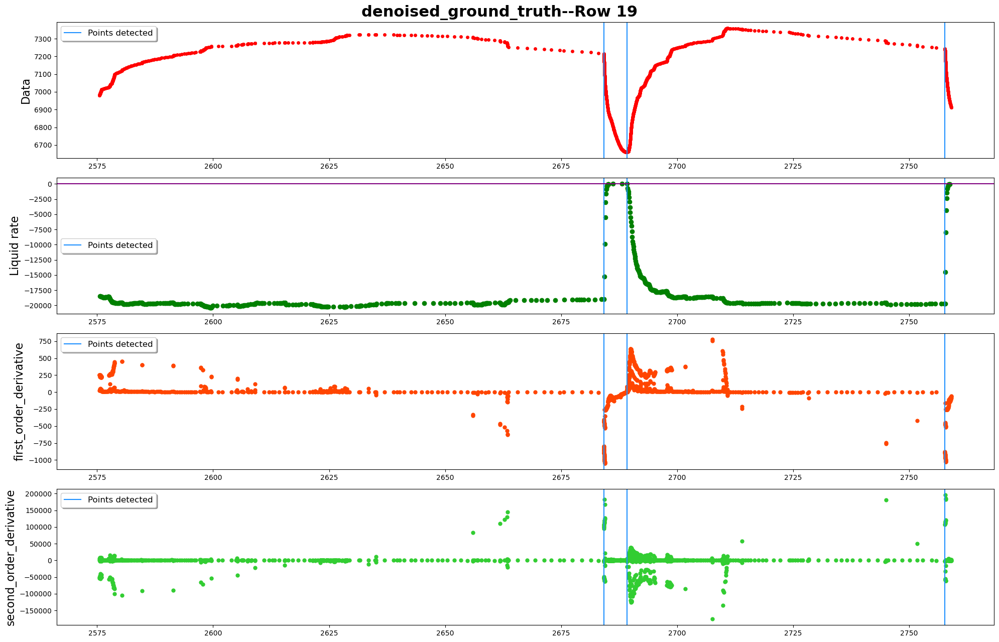

------row 20-----detected points:[23219]


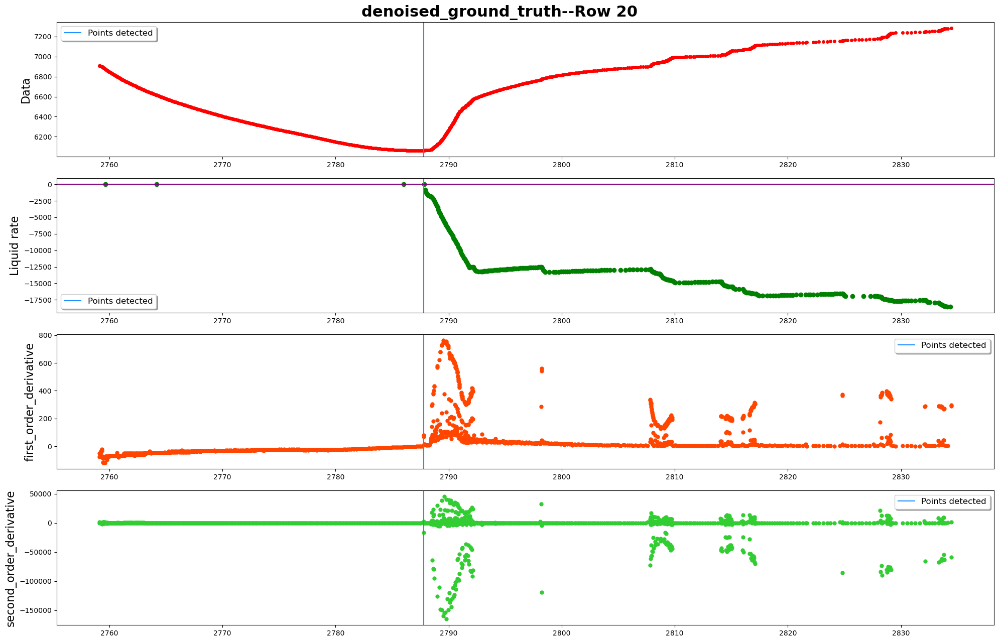

------row 21-----detected points:[24215, 24683]


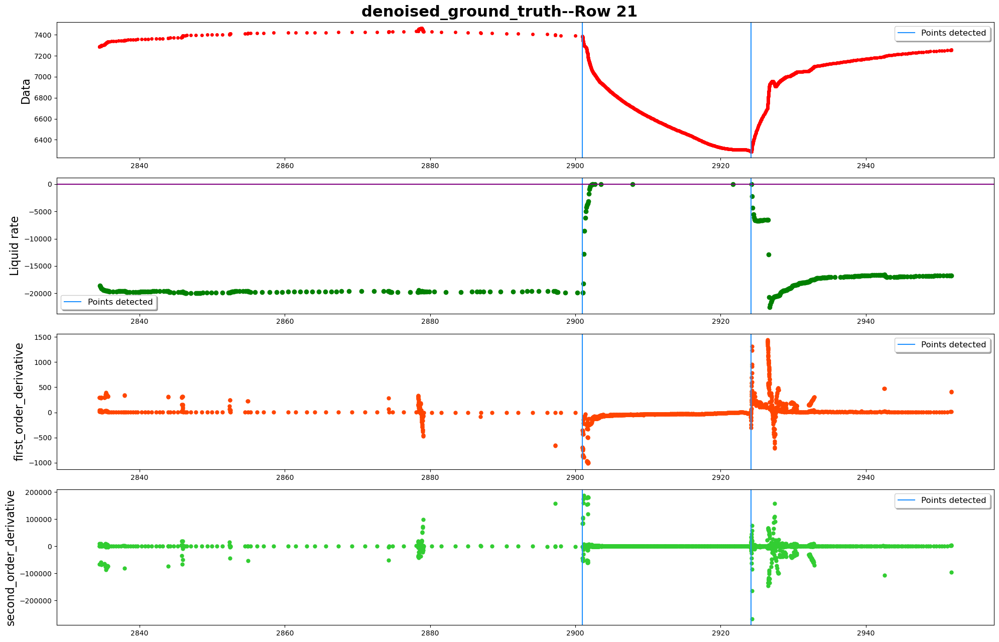

------row 22-----detected points:[25698, 26011]


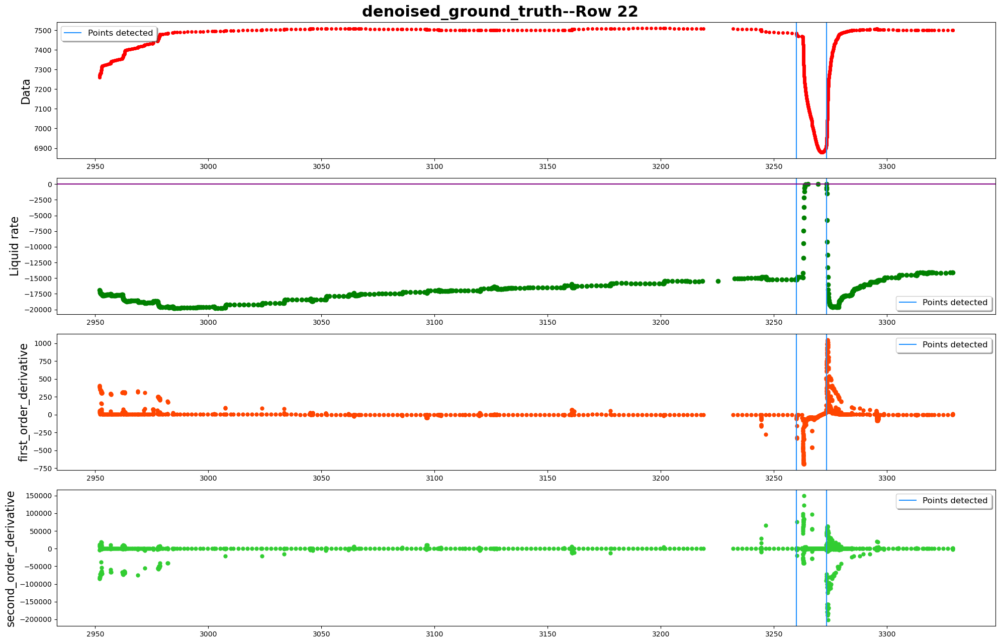

------row 23-----detected points:[26656, 26753, 27022, 27315]


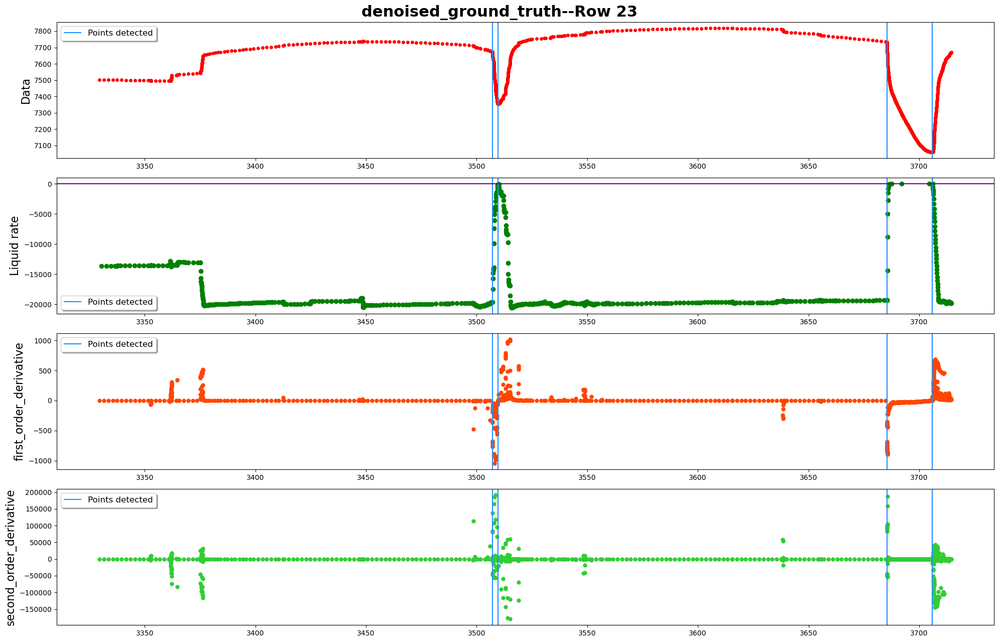

------row 24-----detected points:[27760, 27969, 28322, 28494]


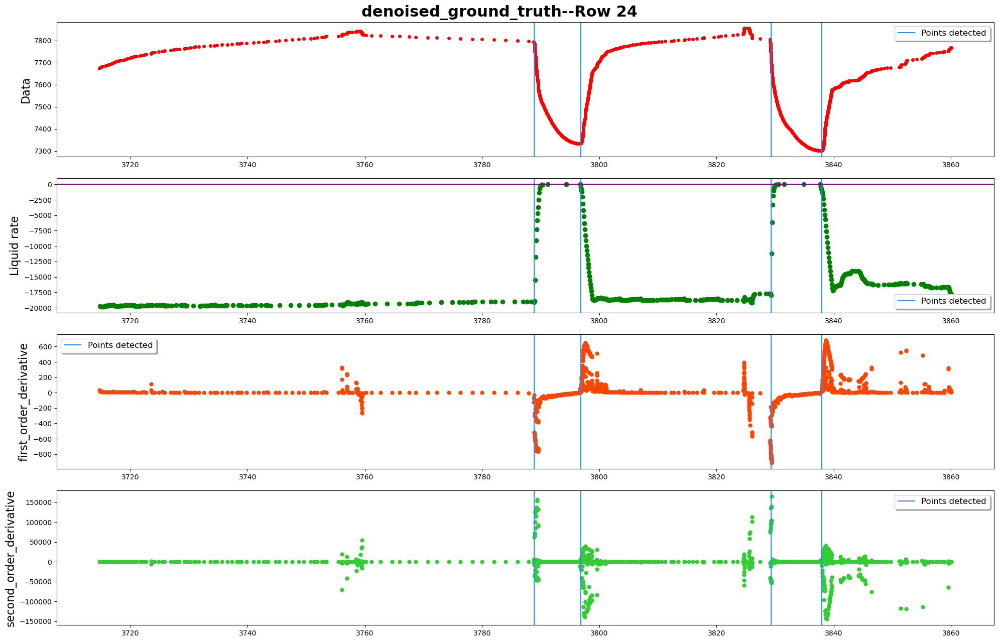

------row 25-----detected points:[28831, 29115]


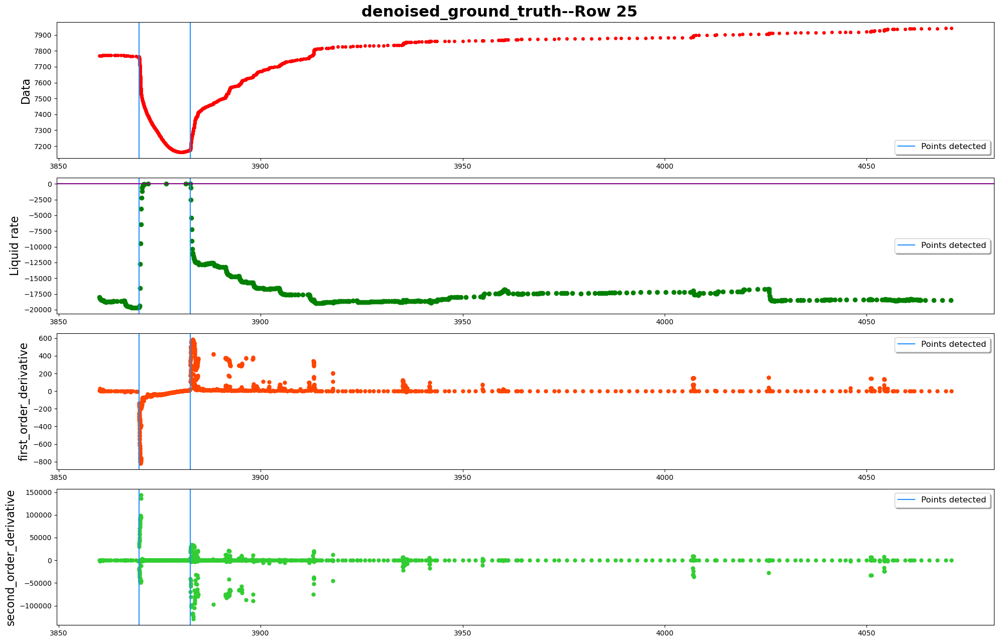

In [51]:
pressure_df=processed_data_denoised.pressure_df
rate_df=processed_data_denoised.rate_df
data_inOneRow=1200
filename_toSave=""
plot_name="denoised_ground_truth"
plot_whole=False
plot_details=True
plot_statistics=False
PlotNSave(pressure_df,
          rate_df,
          denoised_ground_truth,
          [],
          data_inOneRow,
          plot_name,
          filename_toSave,
          plot_statistics,
          plot_whole,
          plot_details,
          colum_names)

In [32]:
# import bisect
# point_index=1000
# time_halfWindow_forLearn=1
# time_leftStart=pressure_time[point_index]-time_halfWindow_forLearn
# halfWinow_left=point_index-bisect.bisect_left(pressure_time, time_leftStart)
# time_rightEnd=pressure_time[point_index]+time_halfWindow_forLearn
# halfWinow_right=bisect.bisect_left(pressure_time, time_rightEnd)-1-point_index
# halfWinow_left,halfWinow_right

**to do: </br>
use normal distribution ptile to remove outliers
experiment with smaller time window</br>
experiment with higher order polynomial fitting function**

### time_halfWindow=0.2, </br>time_halfWindow_forLearn=0.5

detect_breakpoint.....
---------------calculate_Parameters_allCurve linear
point '28322' is going to be classified as buildup,
however the ground truth should be drawdown,
there must be a bump in window thus should not be included into breakpoints for learning
------In the input ground truth: 29 points are detected as buildup, 28 points are detected as drawDown
start to learn 'buildUp' pattern...
---------------calculate_Parameters_allCurve polynomial


C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:279: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:279: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:279: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:279: RankWarning: Polyfit may be poor

start to learn 'drawDown' pattern...
---------------calculate_Parameters_allCurve polynomial


C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:279: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:279: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:279: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:279: RankWarning: Polyfit may be poor

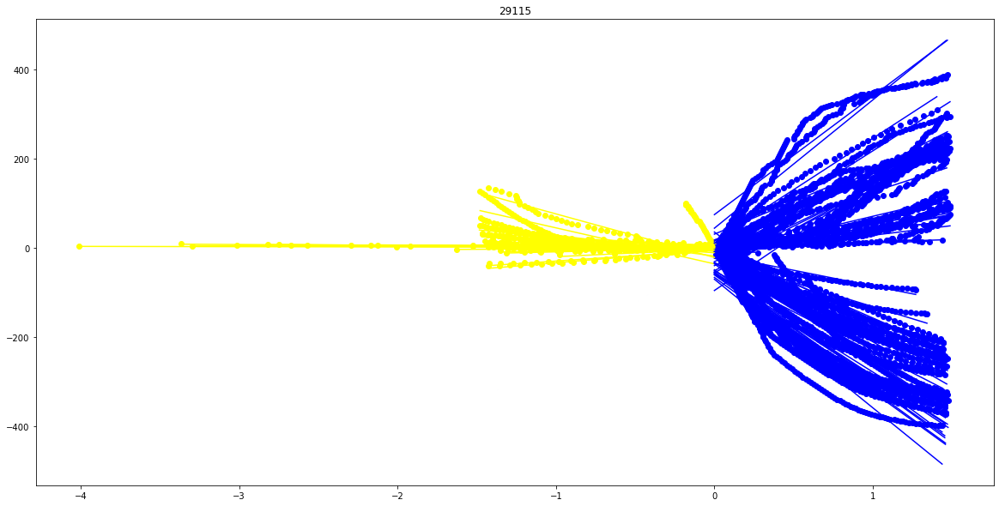

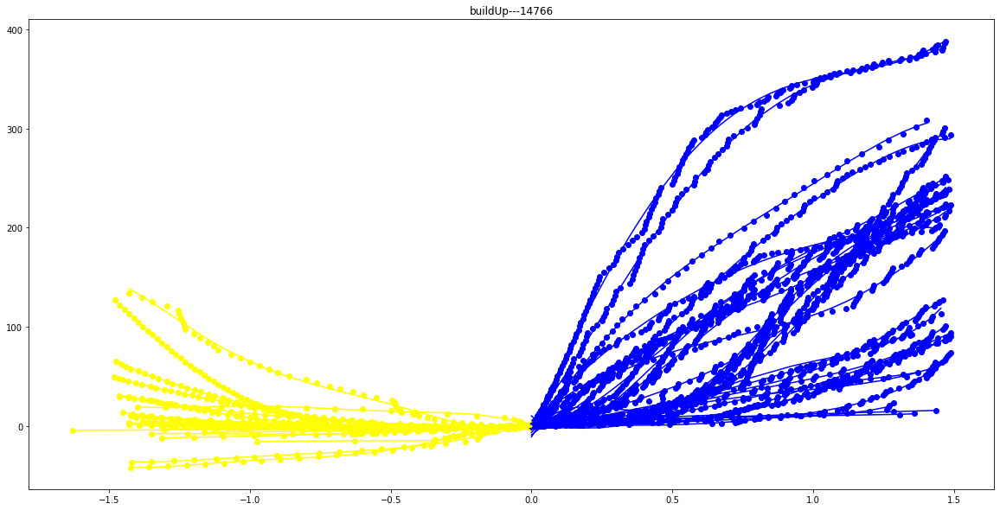

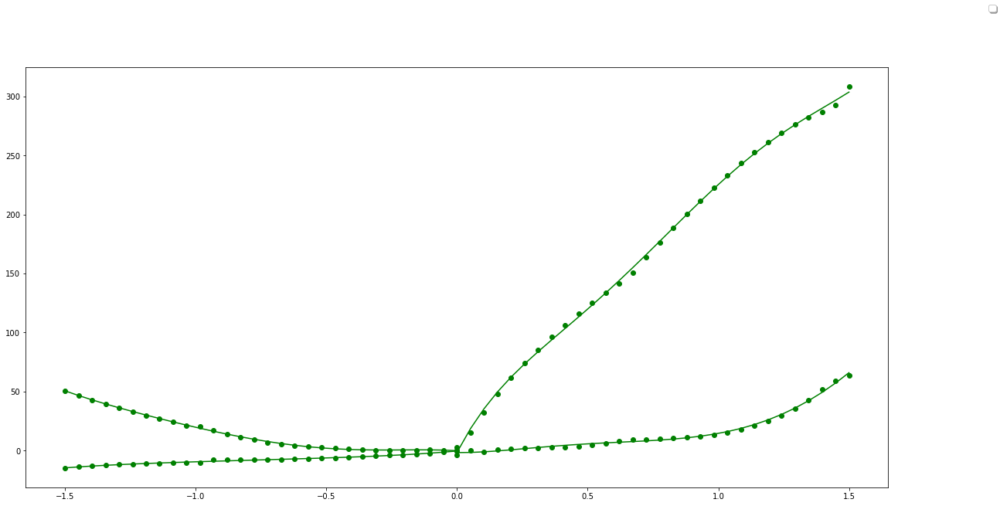

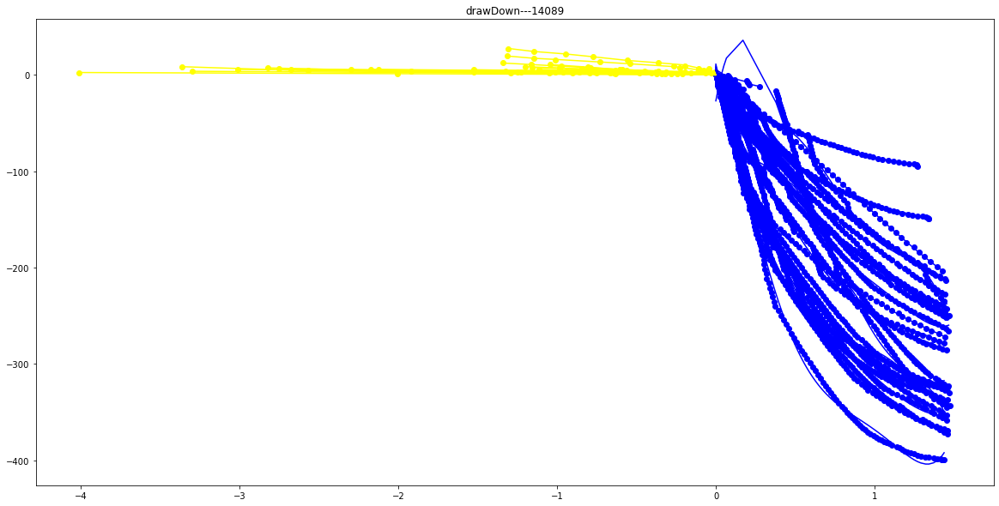

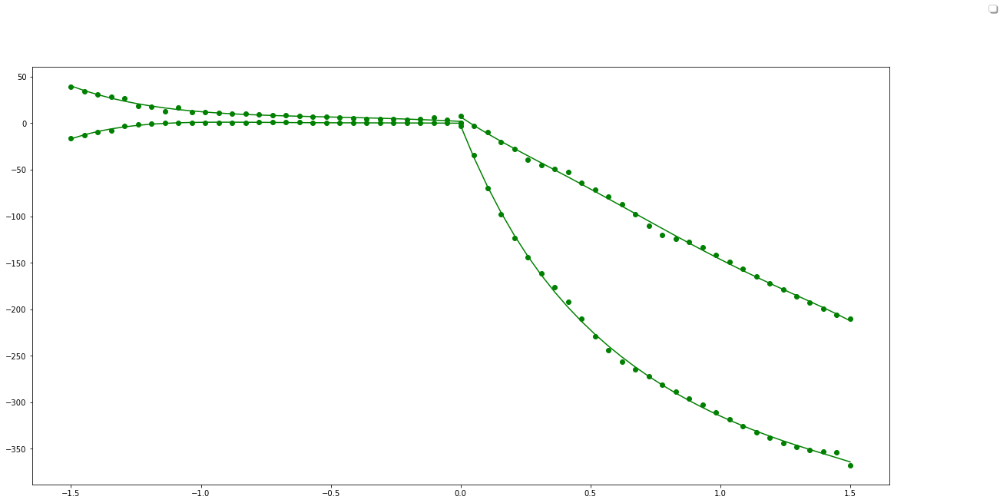

In [4]:

pressure_df=pressure_df_denoised
pressure_measure=list(pressure_df[colum_names["pressure"]["measure"]])
pressure_time=list(pressure_df[colum_names["pressure"]["time"]])
identfication_UsePattern=PatternRecognition(time_halfWindow=0.2,time_halfWindow_forLearn=1.5)
identfication_UsePattern.learn(pressure_measure,pressure_time,denoised_ground_truth,fitting_type="polynomial")

In [6]:
buildup,drawdown=identfication_UsePattern.predict(pressure_measure,pressure_time)
print(len(buildup),len(drawdown))

206 43


In [5]:
ground_truth_classfied=identfication_UsePattern.breakpoints_forLearn
ground_truth_classfied
ground_truth_buildup,ground_truth_drawdown=ground_truth_classfied.values()
len(ground_truth_buildup),len(ground_truth_drawdown)

(31, 29)

---initializing...
---plotting...


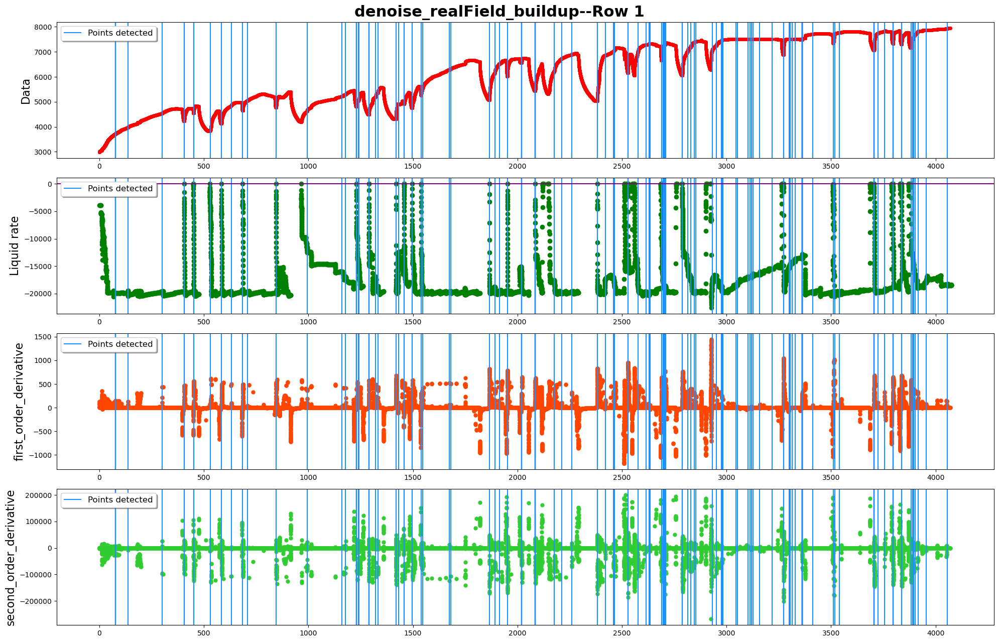

detected 206 points as breakpoints
The plot is devided into 25 rows
------row 1-----detected points:[]


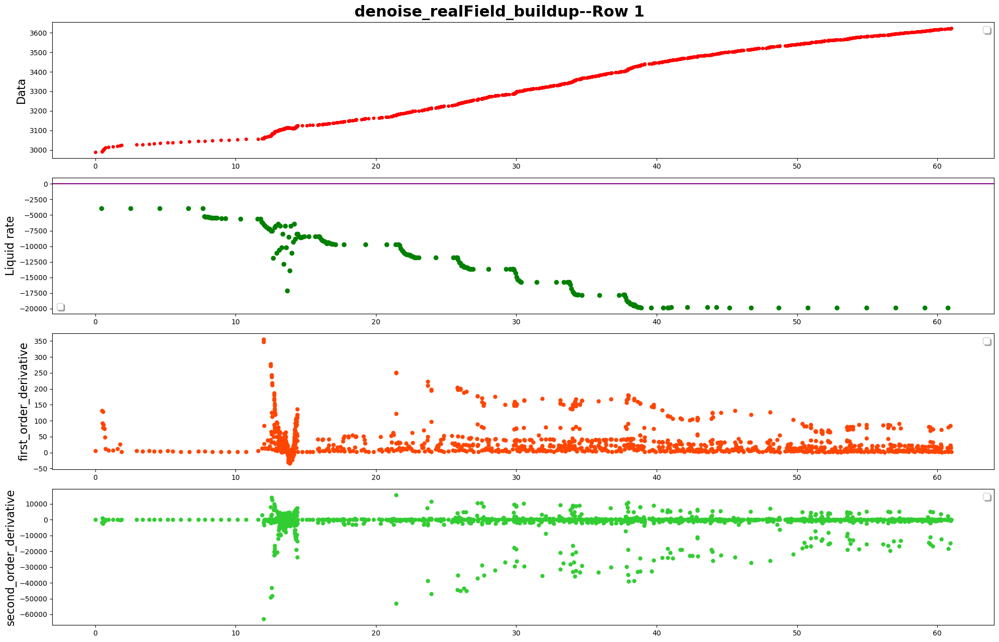

------row 2-----detected points:[1434, 1435, 1437, 1438, 1439, 1440, 1730, 2111]


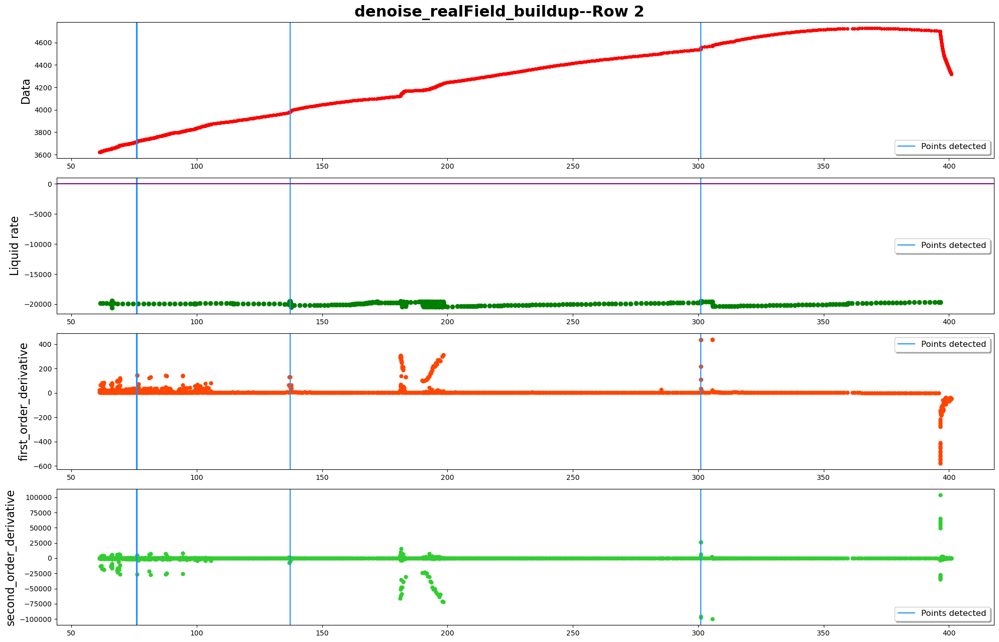

------row 3-----detected points:[2476, 2477, 2478, 2479, 2891, 2892, 2893, 3594]


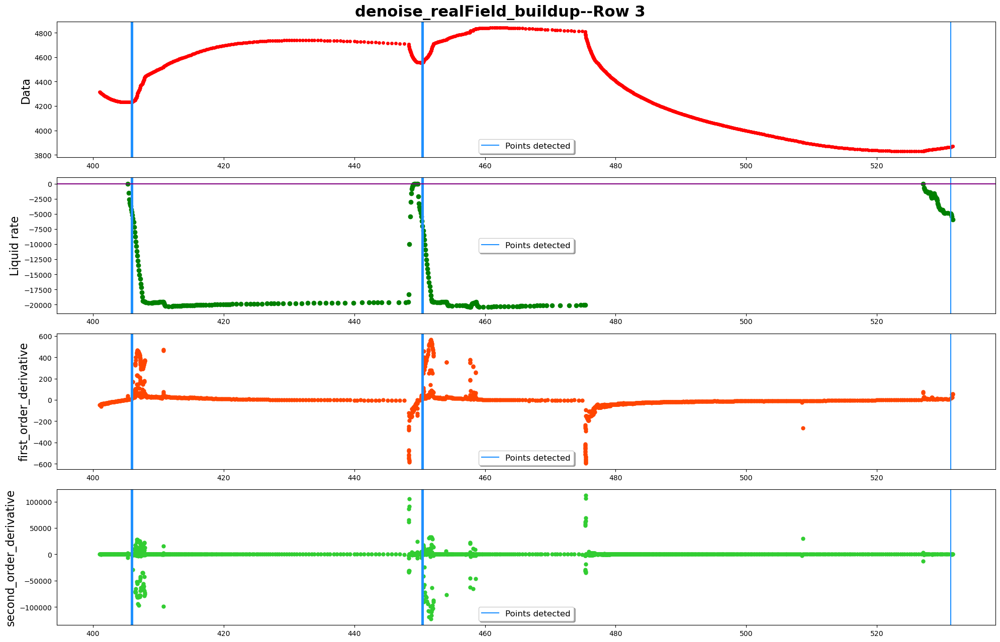

------row 4-----detected points:[4245, 4246, 4654]


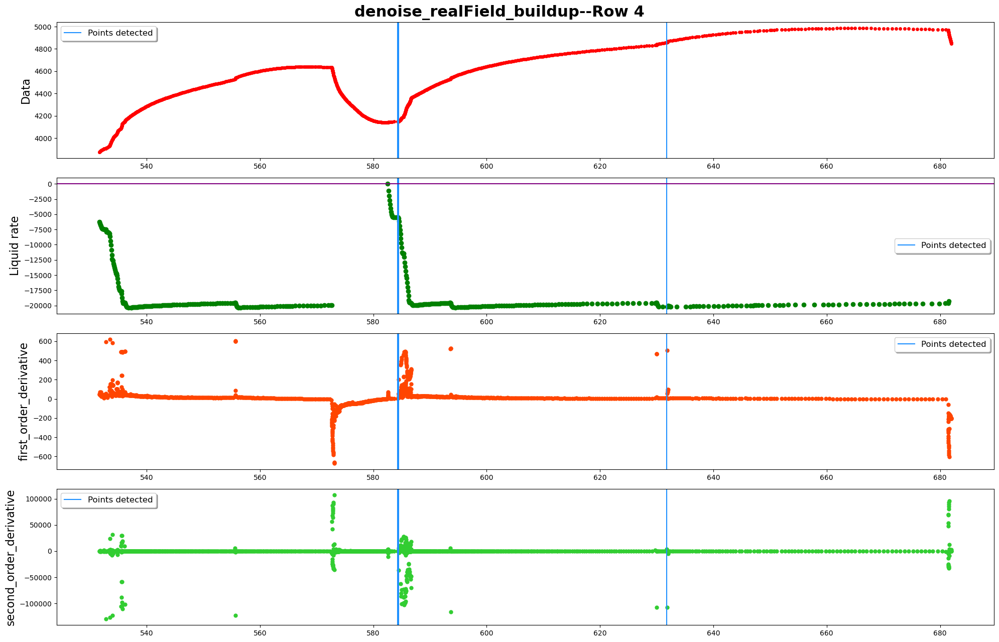

------row 5-----detected points:[4898, 5117, 5444]


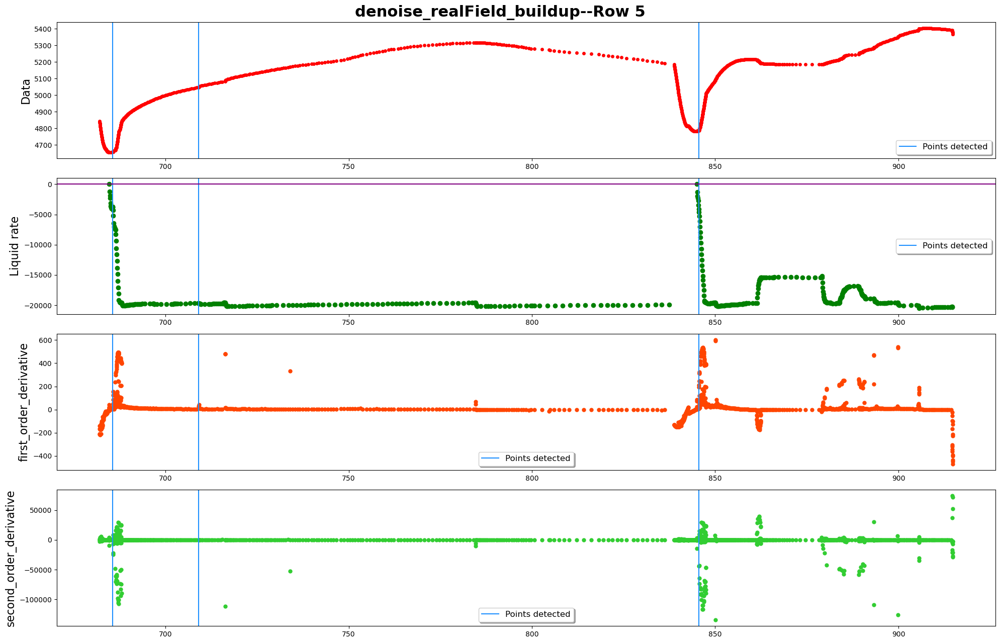

------row 6-----detected points:[6771, 7093, 7137]


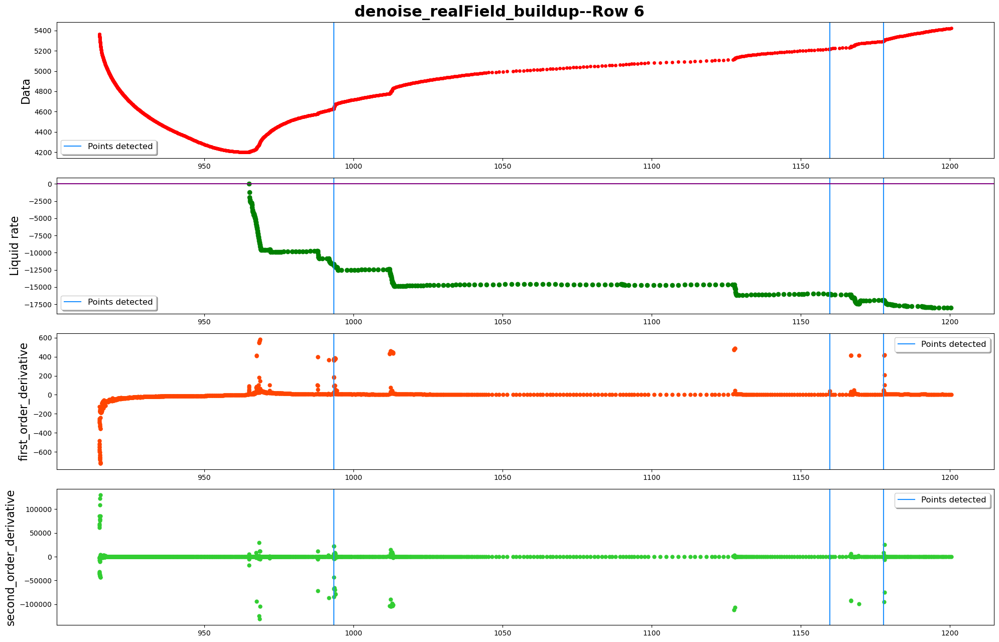

------row 7-----detected points:[7543, 7548, 7549, 7550, 7551, 7552, 7553, 7682, 7683, 7713, 7714, 8361, 8364, 8365, 8366, 8367, 8368]


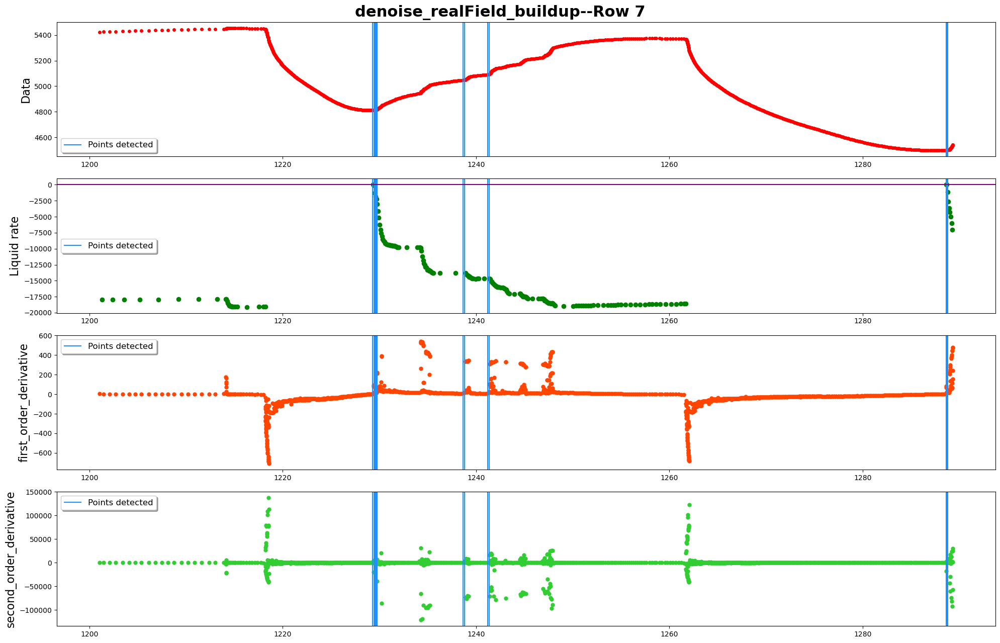

------row 8-----detected points:[8774, 8867, 8868]


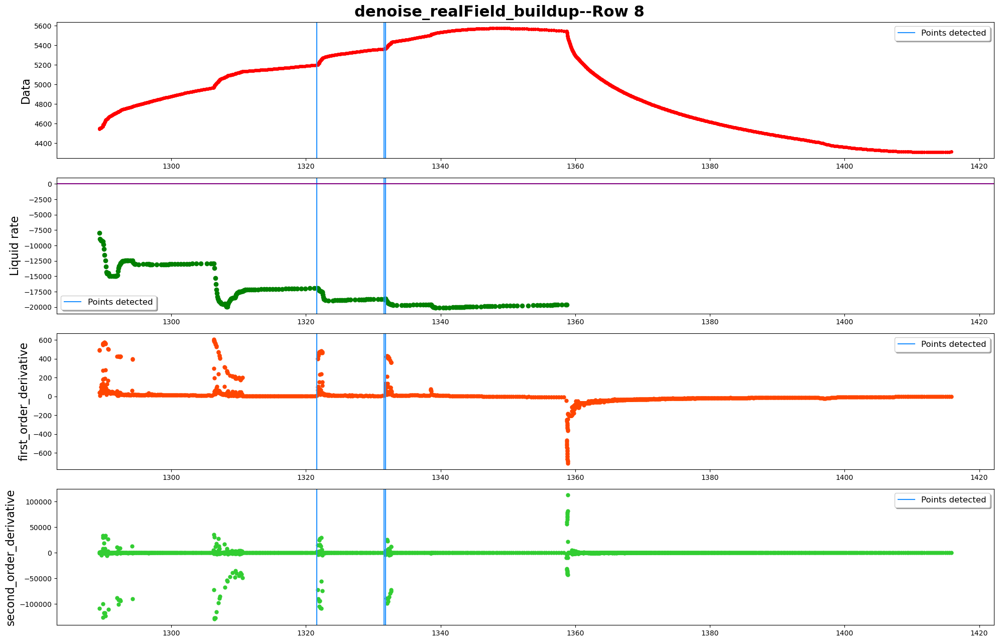

------row 9-----detected points:[9606, 10017, 10018, 10228, 10229, 10230, 10231, 10798, 10799]


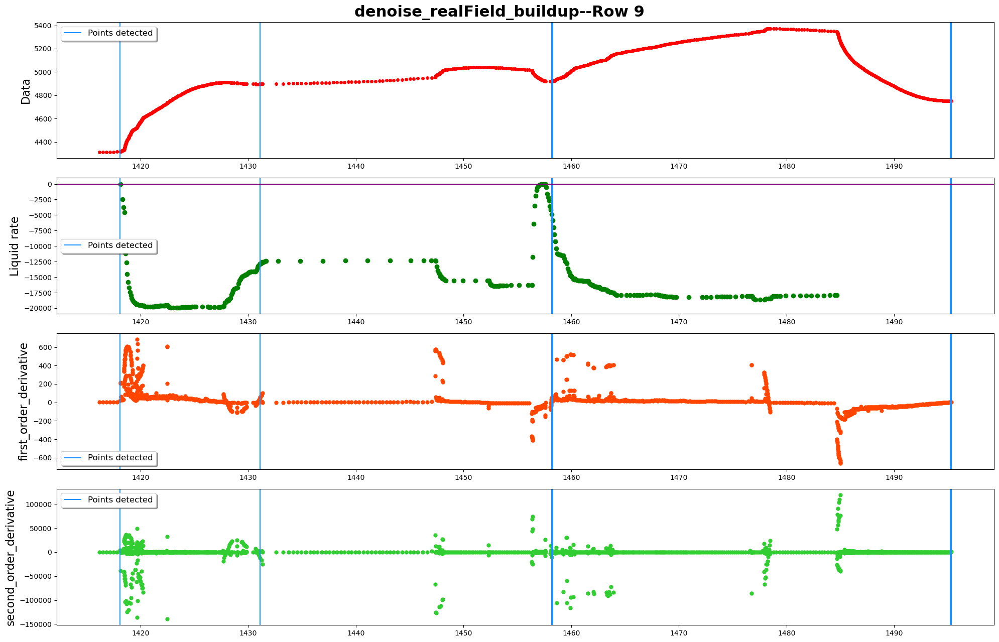

------row 10-----detected points:[11490, 11740, 11741]


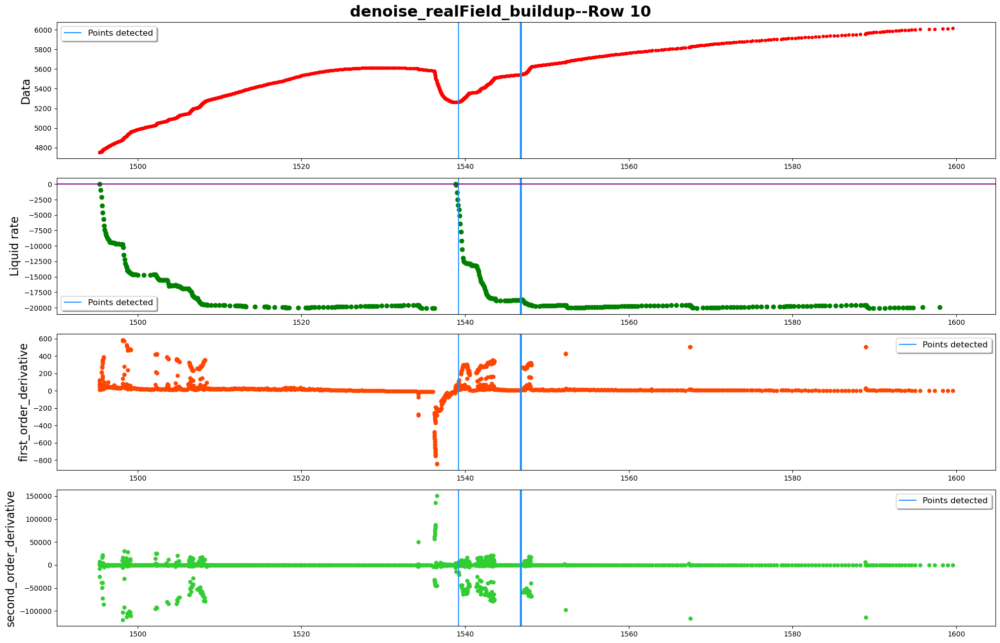

------row 11-----detected points:[12128, 12137, 13038]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 12-----detected points:[13526, 13527, 13736, 14089]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 13-----detected points:[14569, 14570, 14571, 14572, 14573, 14574, 14578, 15337, 15338, 15339, 15340, 15341, 15342, 15343, 15344, 15345, 15346, 15347]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 14-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 15-----detected points:[17063, 17064, 17380, 17462]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 16-----detected points:[18433, 18434]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 17-----detected points:[19364, 19457, 19502, 20335, 20336, 20337]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 18-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 19-----detected points:[21647, 21833, 21834, 21900, 21905, 21916, 22188, 22189, 22190, 22526, 22527, 22589, 22611, 22620]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 20-----detected points:[23227, 23228, 23229, 23230, 23771, 23923]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 21-----detected points:[24068, 24092, 25056, 25057, 25196]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 22-----detected points:[25333, 25334, 25342, 25343, 25384, 25447, 25448, 25453, 25454, 25455, 25522, 25523, 25532, 25549, 25550, 25563, 25564, 25582, 25669, 25990, 25991, 25992, 25993, 25994, 26368, 26375, 26382, 26397]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 23-----detected points:[26431, 26432, 26433, 26434, 26435, 26436, 26437, 26438, 26439, 26440, 26441, 26442, 26443, 26444, 26445, 26446, 26447, 26448, 26449, 26450, 26584, 26764, 26870, 26905, 26906, 27315, 27316, 27317, 27318, 27319, 27321, 27322, 27323, 27324, 27325]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 24-----detected points:[27632, 27689, 27962, 27963, 27964, 27965, 27966, 27967, 27968, 28492, 28493, 28494, 28495]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 25-----detected points:[29112, 29113, 29299, 29355, 29425, 29515, 29669, 29796, 29797, 29798]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

In [12]:
pressure_df=processed_data_denoised.pressure_df
rate_df=processed_data_denoised.rate_df
data_inOneRow=1200
filename_toSave=""
plot_name="denoise_realField_buildup"
plot_whole=True
plot_details=True
plot_statistics=False
PlotNSave(pressure_df,
          rate_df,
          buildup,
          [],
          data_inOneRow,
          plot_name,
          filename_toSave,
          plot_statistics,
          plot_whole,
          plot_details,
          colum_names)

---initializing...
---plotting...
detected 206 points as breakpoints
The plot is devided into 25 rows
------row 1-----detected points:[]


findfont: Font family ['Arial Black'] not found. Falling back to DejaVu Sans.


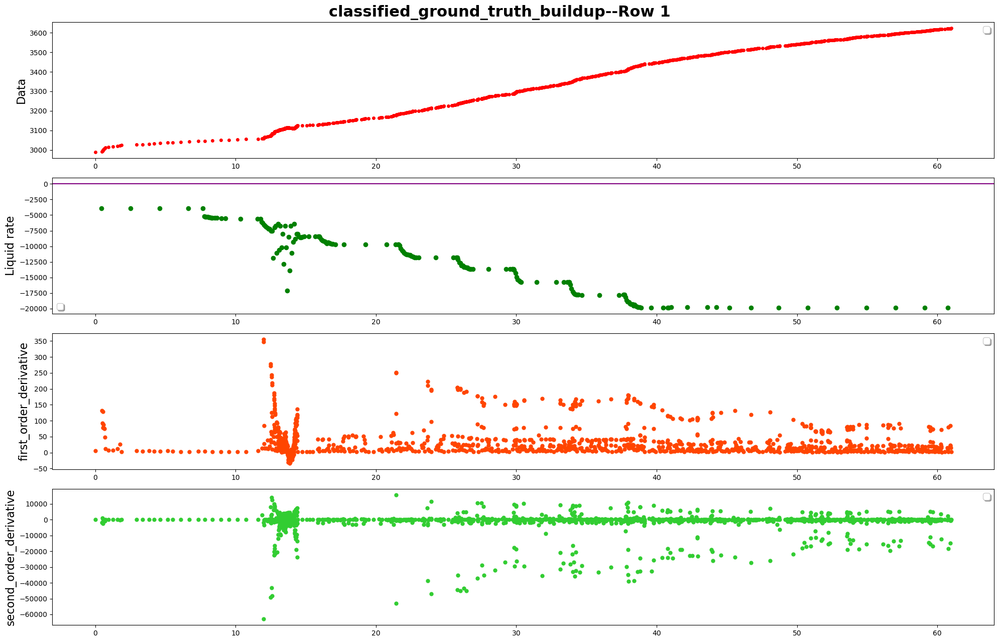

------row 2-----detected points:[1434, 1435, 1437, 1438, 1439, 1440, 1730, 2111]


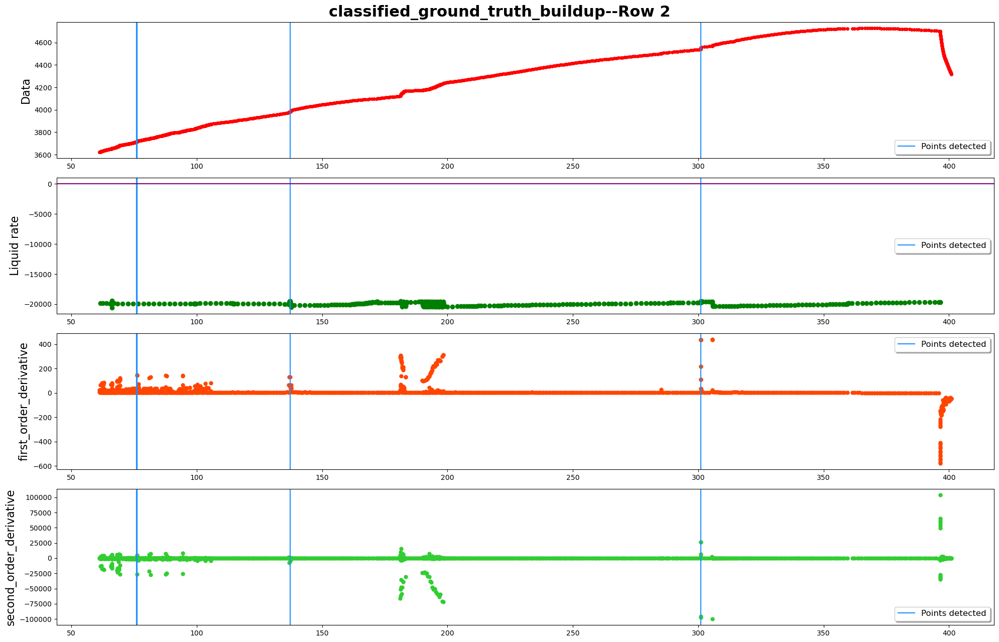

------row 3-----detected points:[2476, 2477, 2478, 2479, 2891, 2892, 2893, 3594]


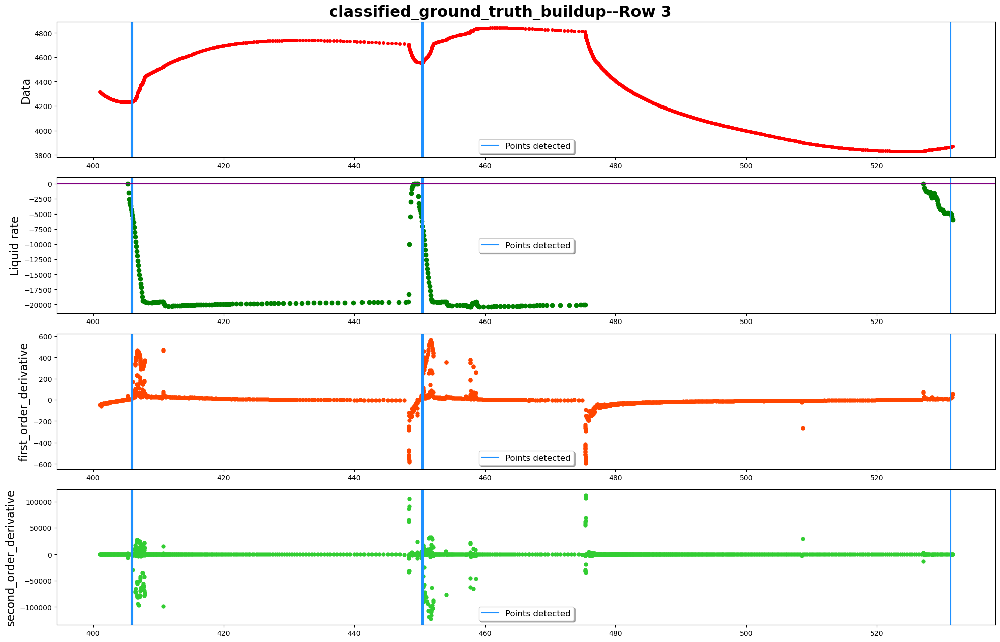

------row 4-----detected points:[4245, 4246, 4654]


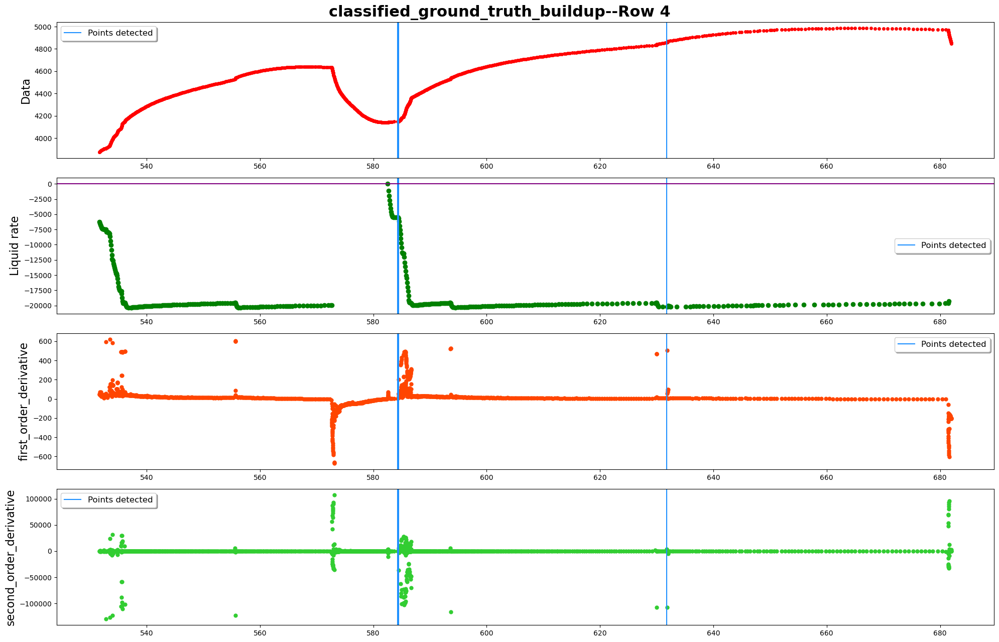

------row 5-----detected points:[4898, 5117, 5444]


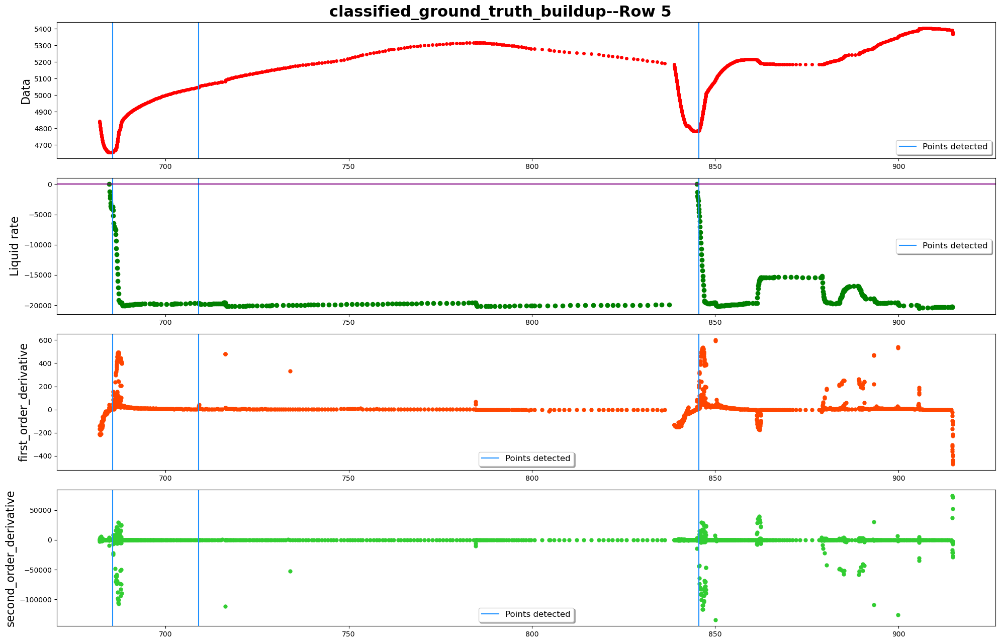

------row 6-----detected points:[6771, 7093, 7137]


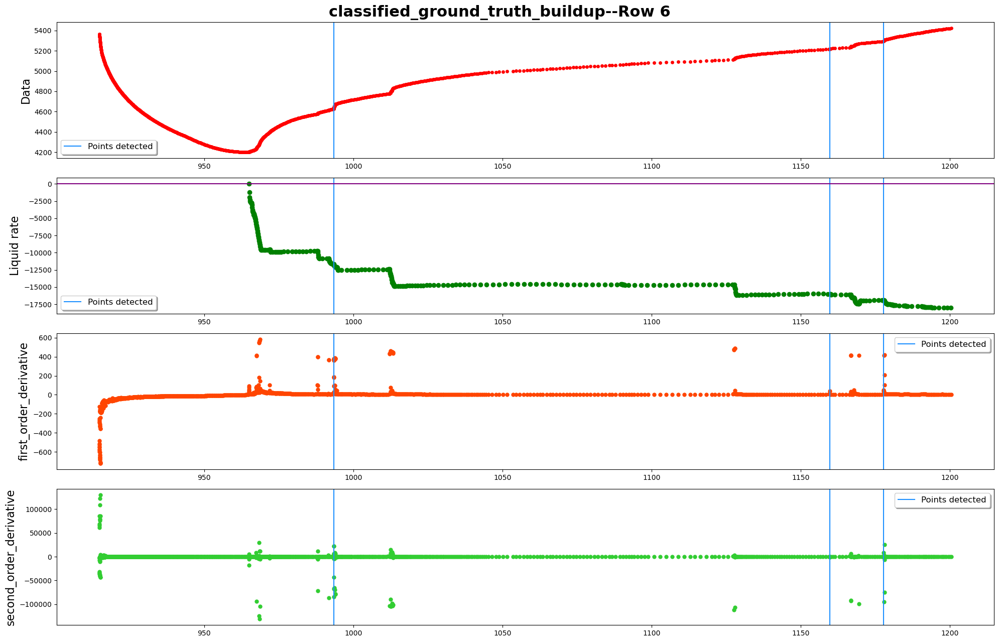

------row 7-----detected points:[7543, 7548, 7549, 7550, 7551, 7552, 7553, 7682, 7683, 7713, 7714, 8361, 8364, 8365, 8366, 8367, 8368]


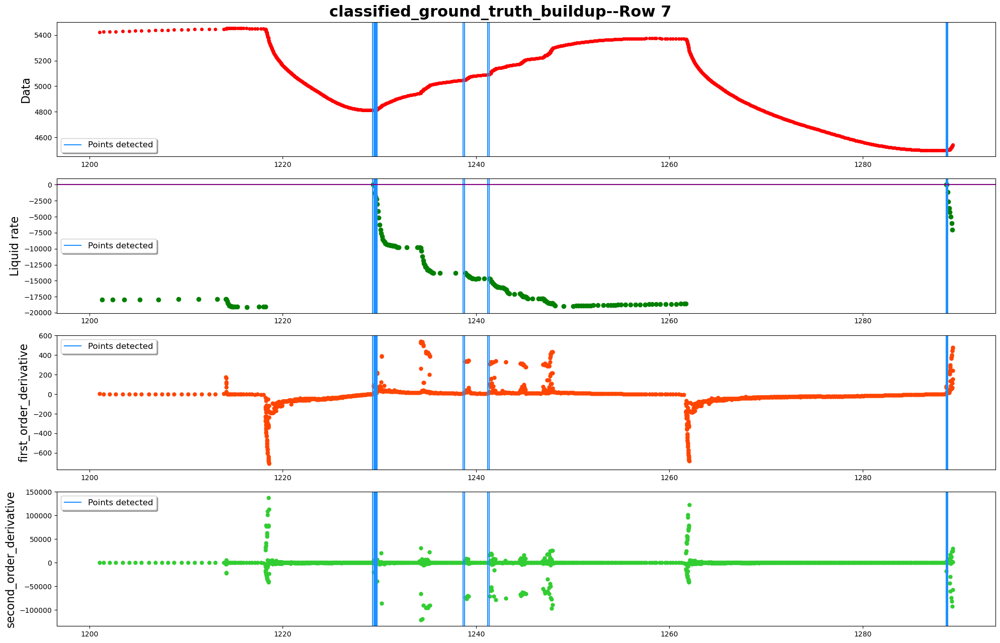

------row 8-----detected points:[8774, 8867, 8868]


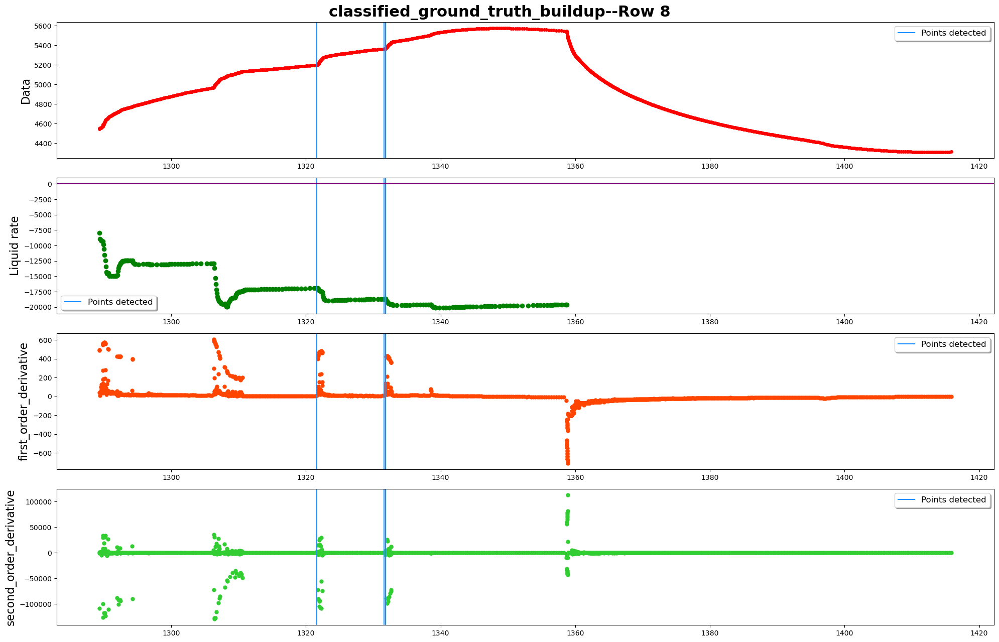

------row 9-----detected points:[9606, 10017, 10018, 10228, 10229, 10230, 10231, 10798, 10799]


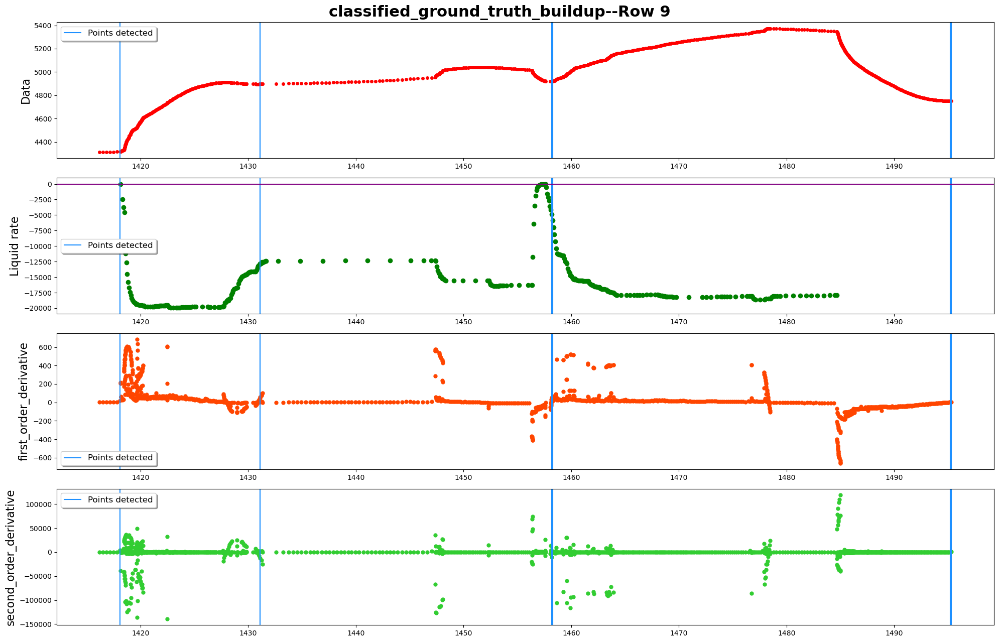

------row 10-----detected points:[11490, 11740, 11741]


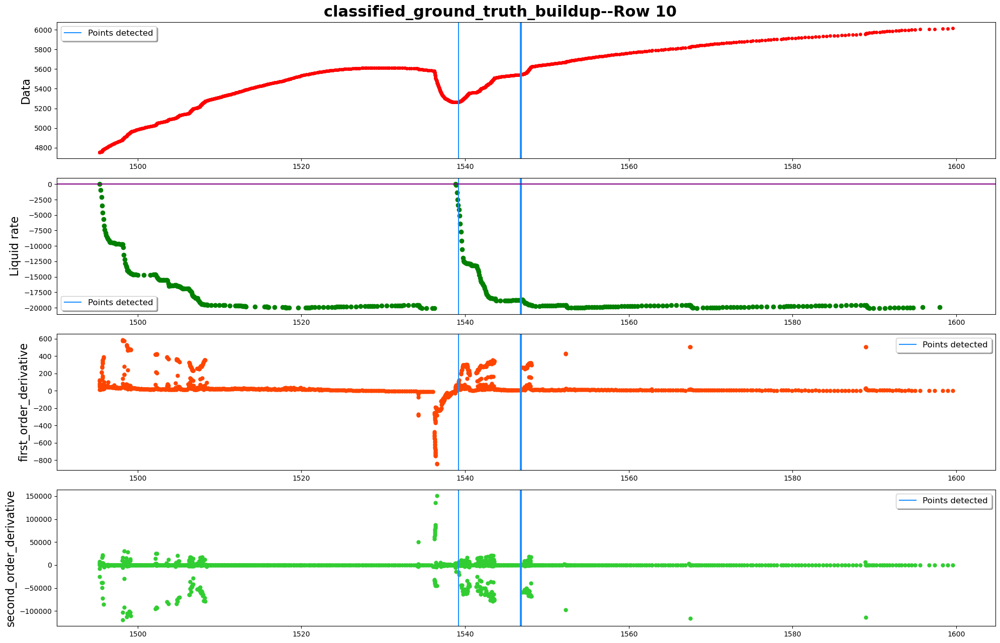

------row 11-----detected points:[12128, 12137, 13038]


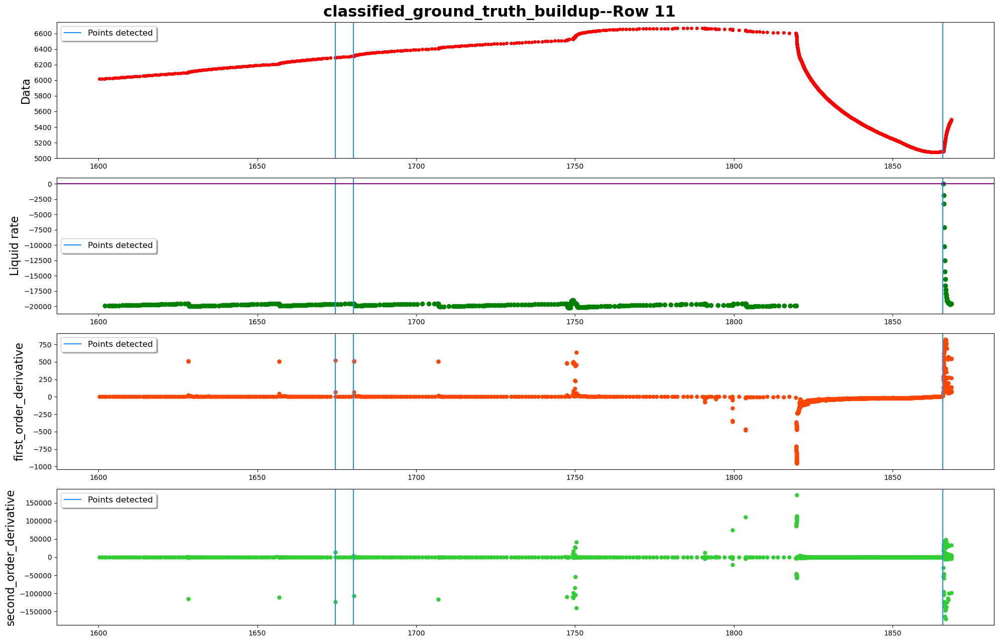

------row 12-----detected points:[13526, 13527, 13736, 14089]


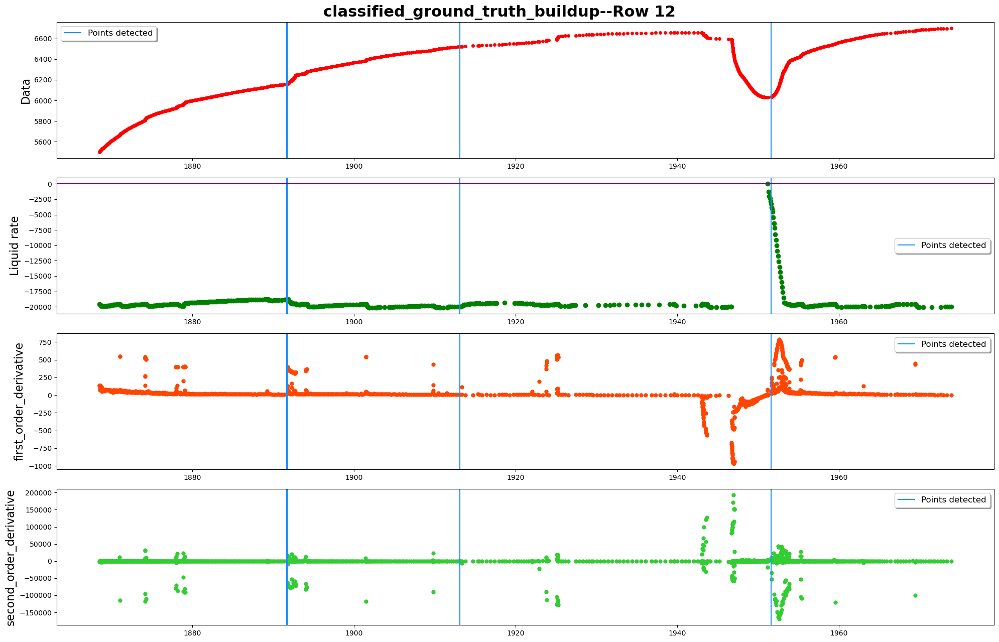

------row 13-----detected points:[14569, 14570, 14571, 14572, 14573, 14574, 14578, 15337, 15338, 15339, 15340, 15341, 15342, 15343, 15344, 15345, 15346, 15347]


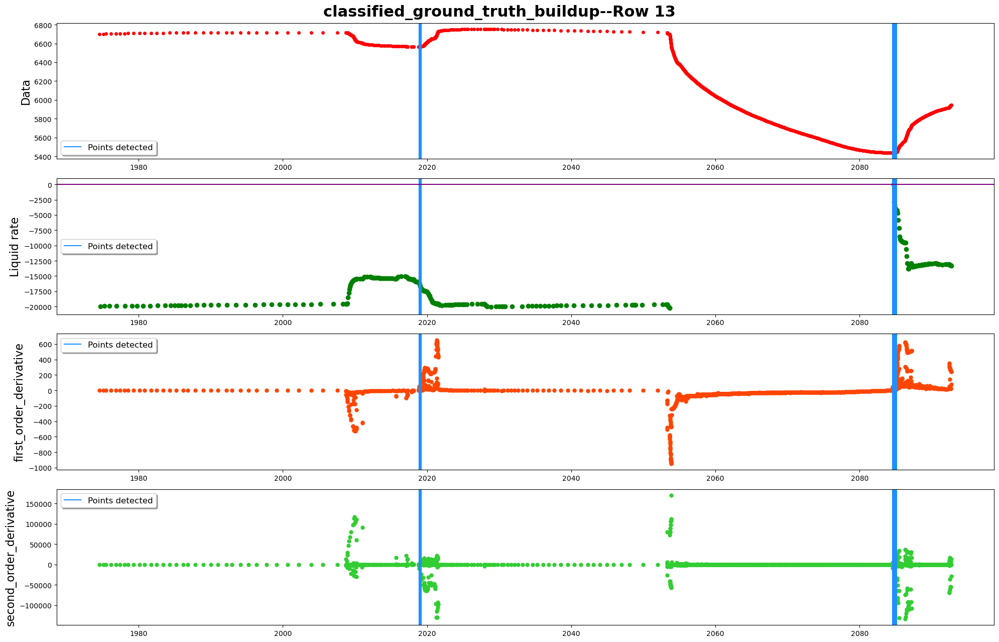

------row 14-----detected points:[]


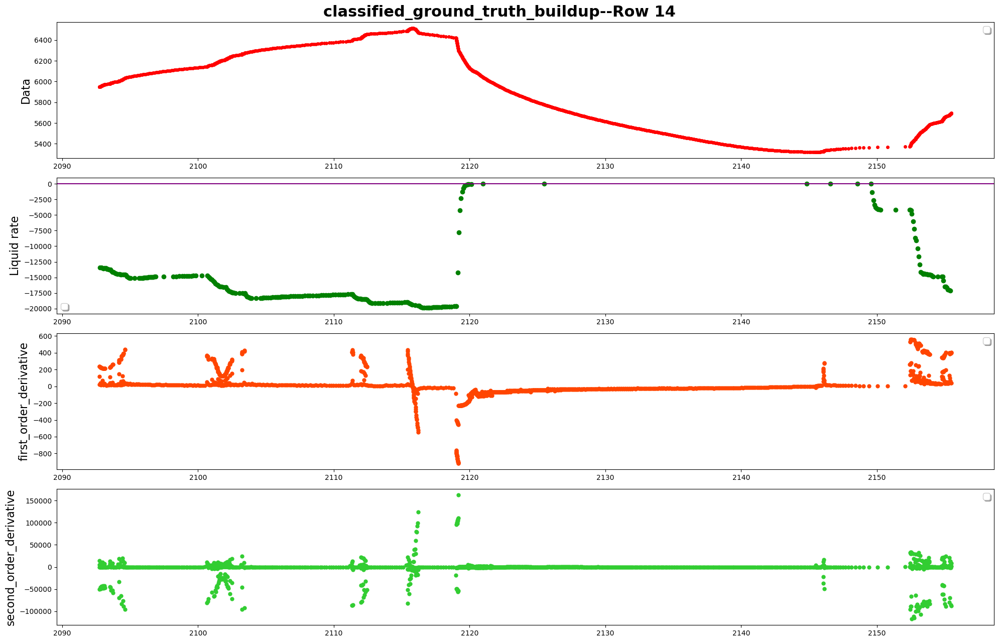

------row 15-----detected points:[17063, 17064, 17380, 17462]


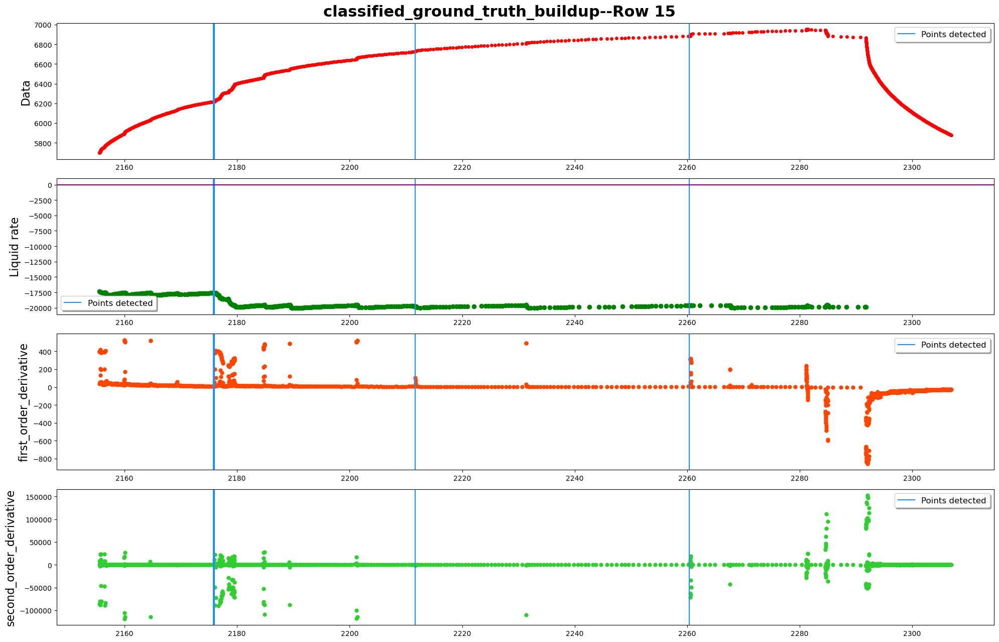

------row 16-----detected points:[18433, 18434]


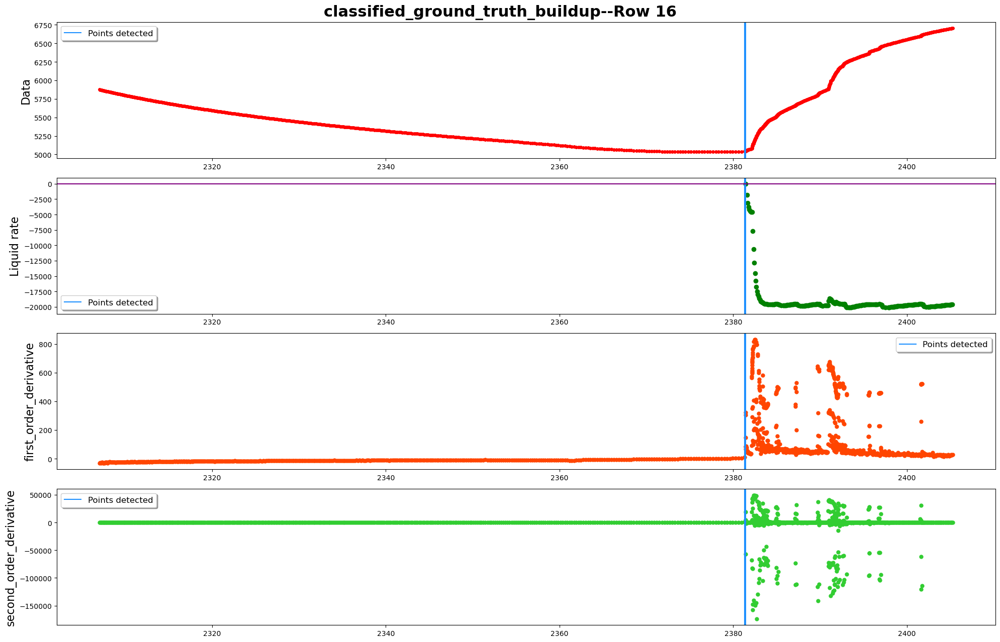

------row 17-----detected points:[19364, 19457, 19502, 20335, 20336, 20337]


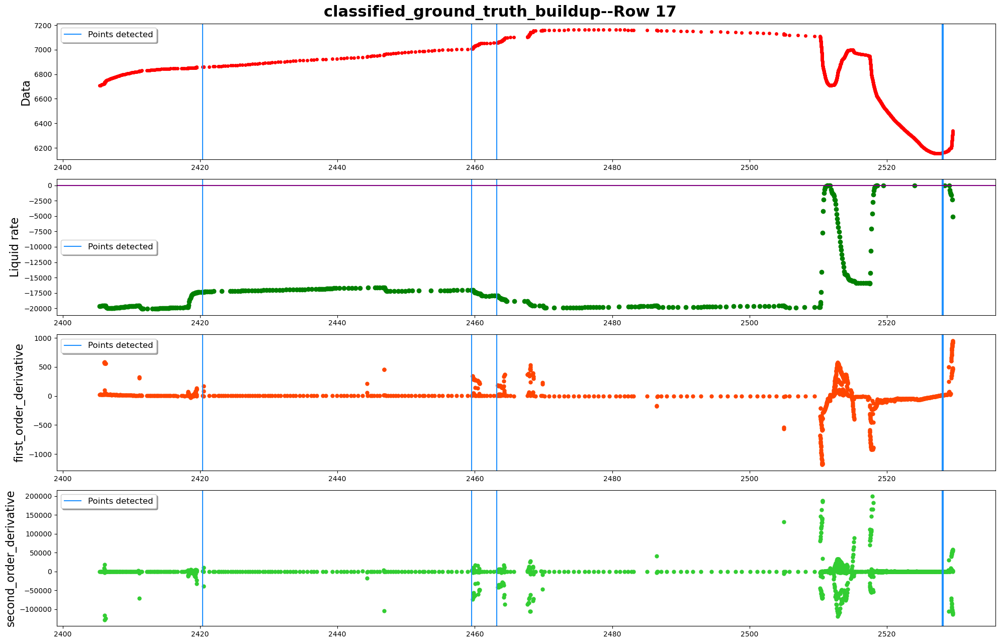

------row 18-----detected points:[]


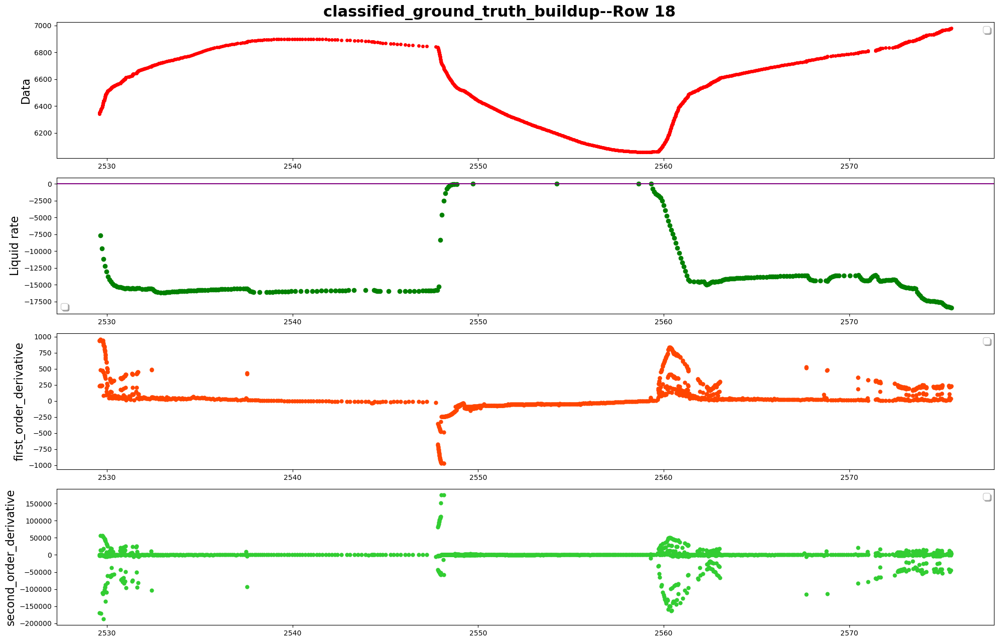

------row 19-----detected points:[21647, 21833, 21834, 21900, 21905, 21916, 22188, 22189, 22190, 22526, 22527, 22589, 22611, 22620]


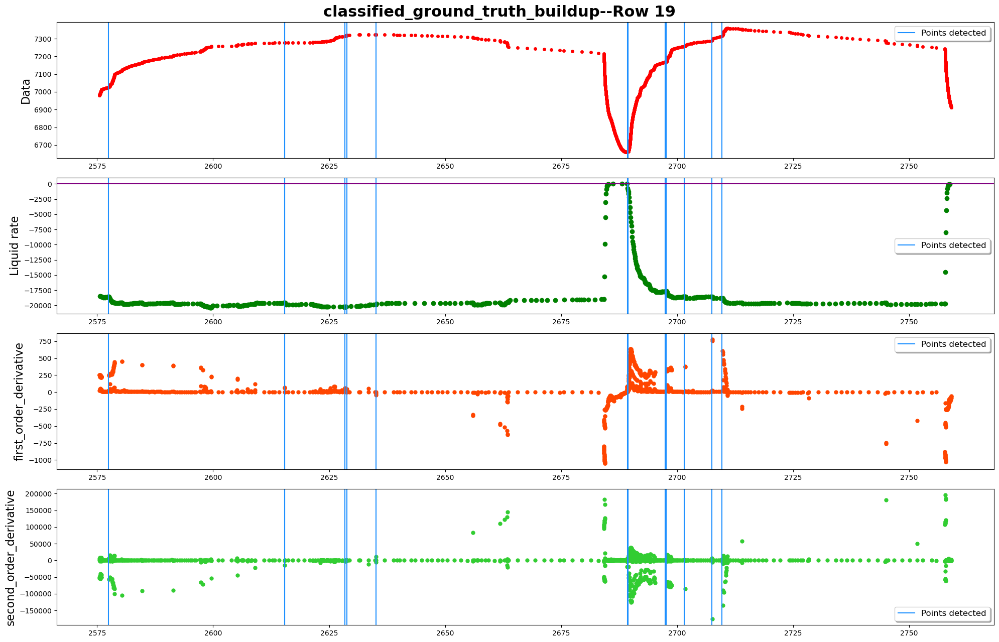

------row 20-----detected points:[23227, 23228, 23229, 23230, 23771, 23923]


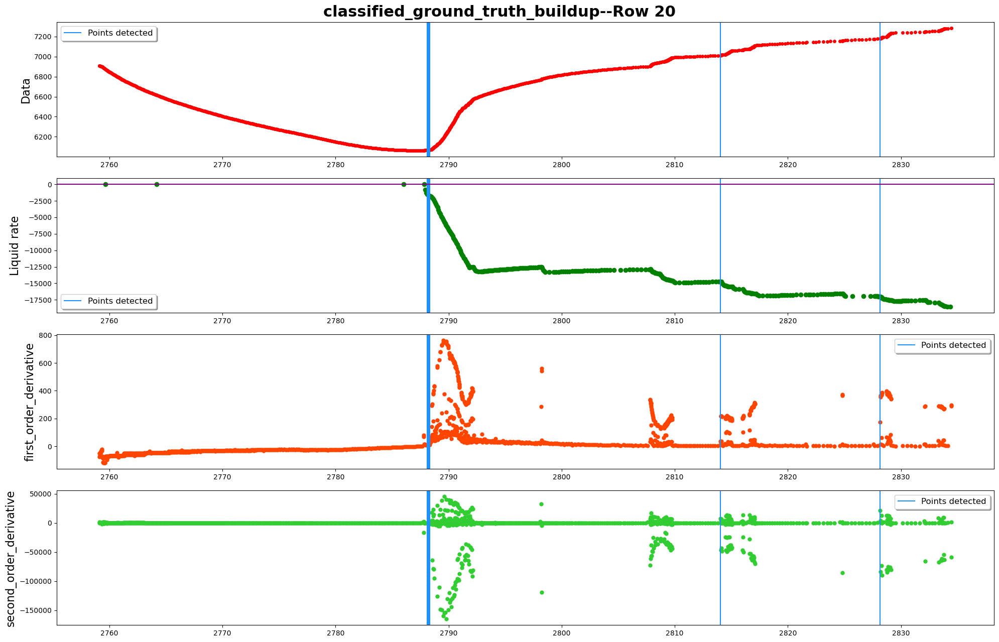

------row 21-----detected points:[24068, 24092, 25056, 25057, 25196]


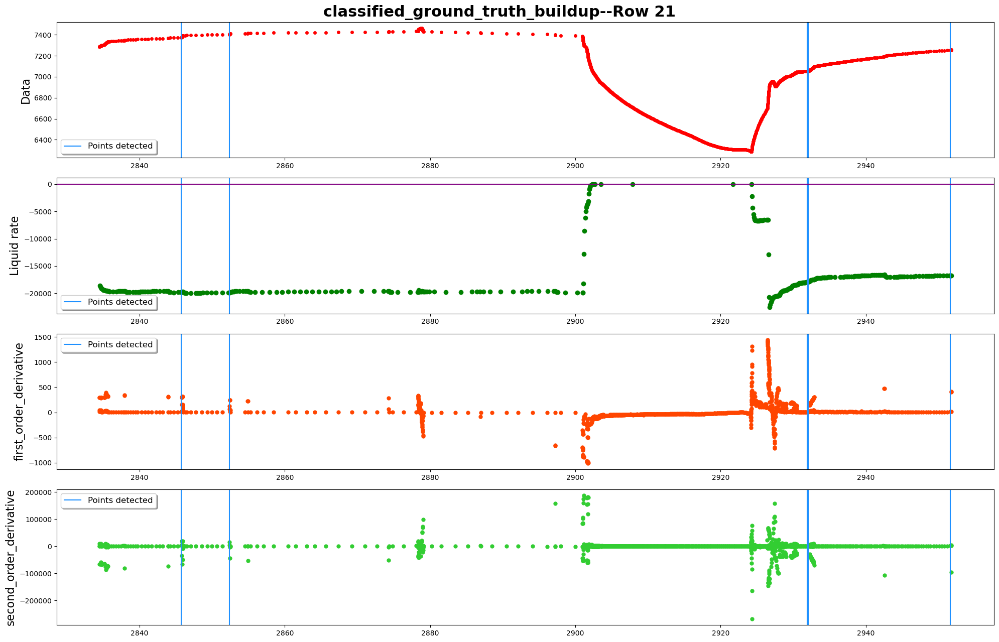

------row 22-----detected points:[25333, 25334, 25342, 25343, 25384, 25447, 25448, 25453, 25454, 25455, 25522, 25523, 25532, 25549, 25550, 25563, 25564, 25582, 25669, 25990, 25991, 25992, 25993, 25994, 26368, 26375, 26382, 26397]


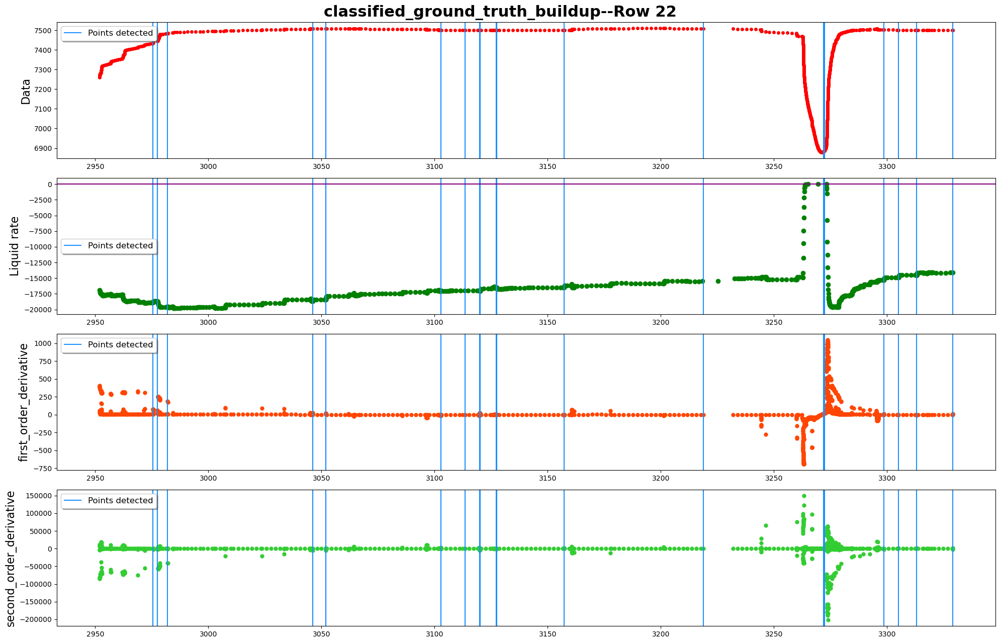

------row 23-----detected points:[26431, 26432, 26433, 26434, 26435, 26436, 26437, 26438, 26439, 26440, 26441, 26442, 26443, 26444, 26445, 26446, 26447, 26448, 26449, 26450, 26584, 26764, 26870, 26905, 26906, 27315, 27316, 27317, 27318, 27319, 27321, 27322, 27323, 27324, 27325]


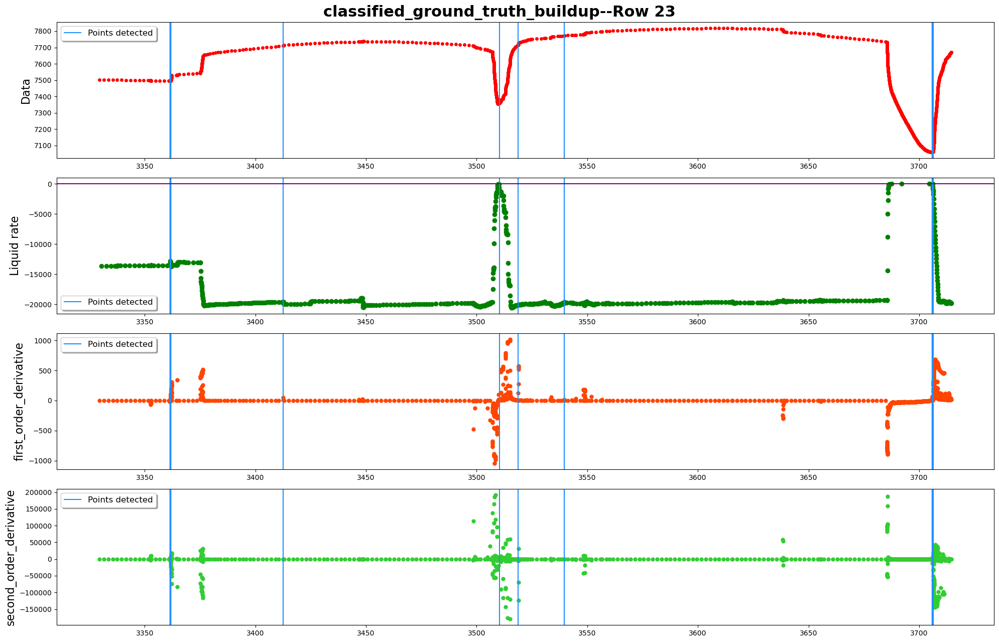

------row 24-----detected points:[27632, 27689, 27962, 27963, 27964, 27965, 27966, 27967, 27968, 28492, 28493, 28494, 28495]


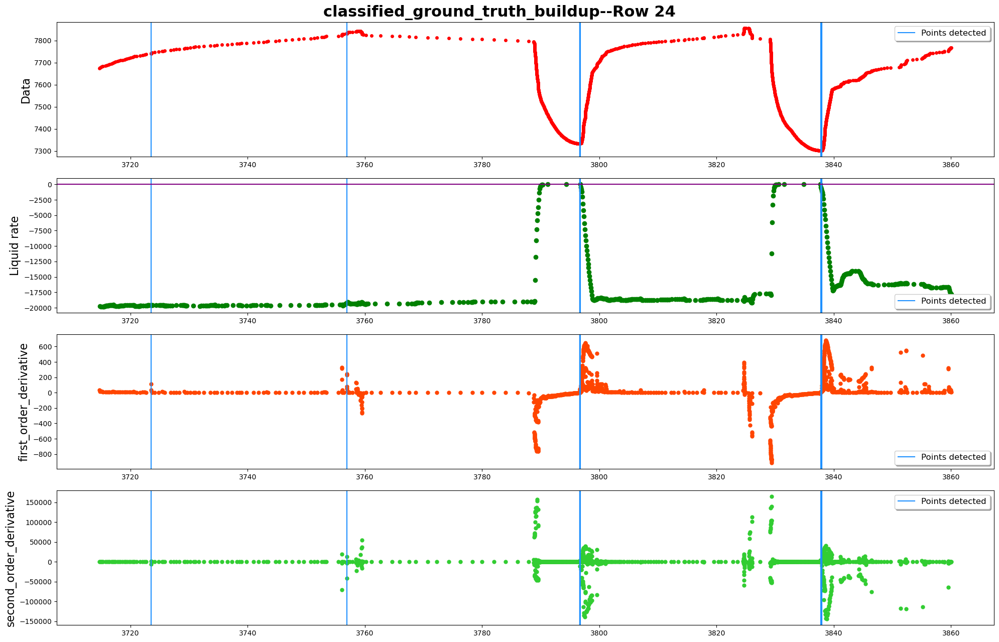

------row 25-----detected points:[29112, 29113, 29299, 29355, 29425, 29515, 29669, 29796, 29797, 29798]


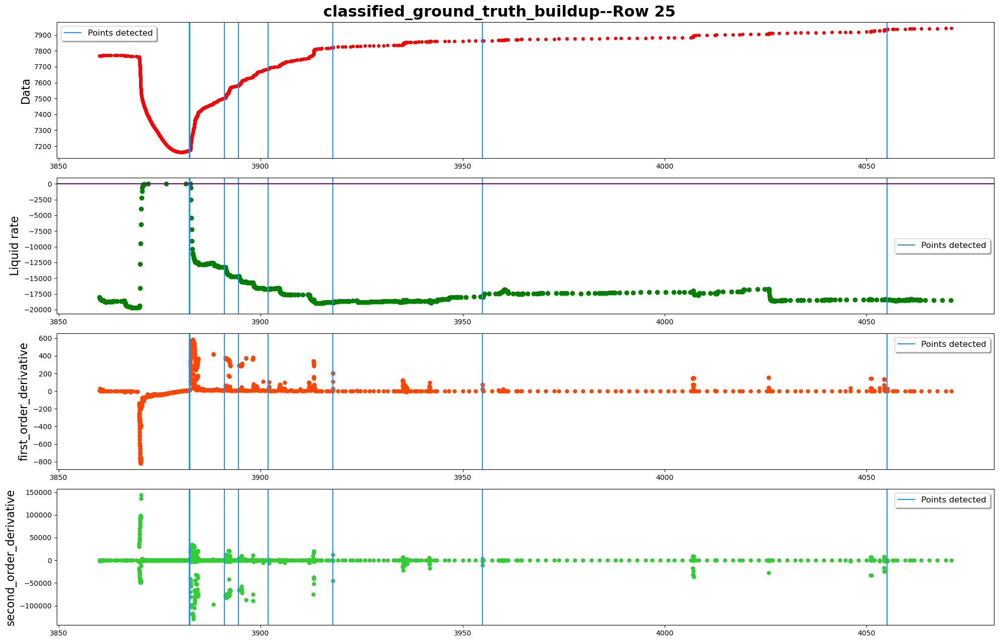

In [10]:
pressure_df=processed_data_denoised.pressure_df
rate_df=processed_data_denoised.rate_df
data_inOneRow=1200
filename_toSave=""
plot_name="classified_ground_truth_buildup"
plot_whole=False
plot_details=True
plot_statistics=False
PlotNSave(pressure_df,
          rate_df,
          buildup+drawdown,
          [],
          data_inOneRow,
          plot_name,
          filename_toSave,
          plot_statistics,
          plot_whole,
          plot_details,
          colum_names)

---initializing...
---plotting...


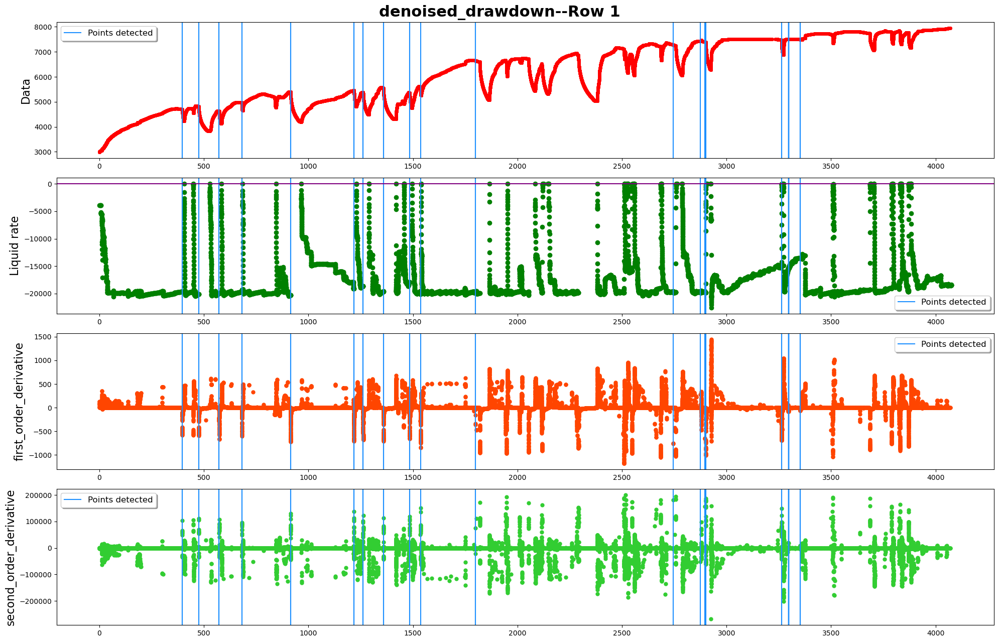

detected 43 points as breakpoints
The plot is devided into 25 rows
------row 1-----detected points:[]


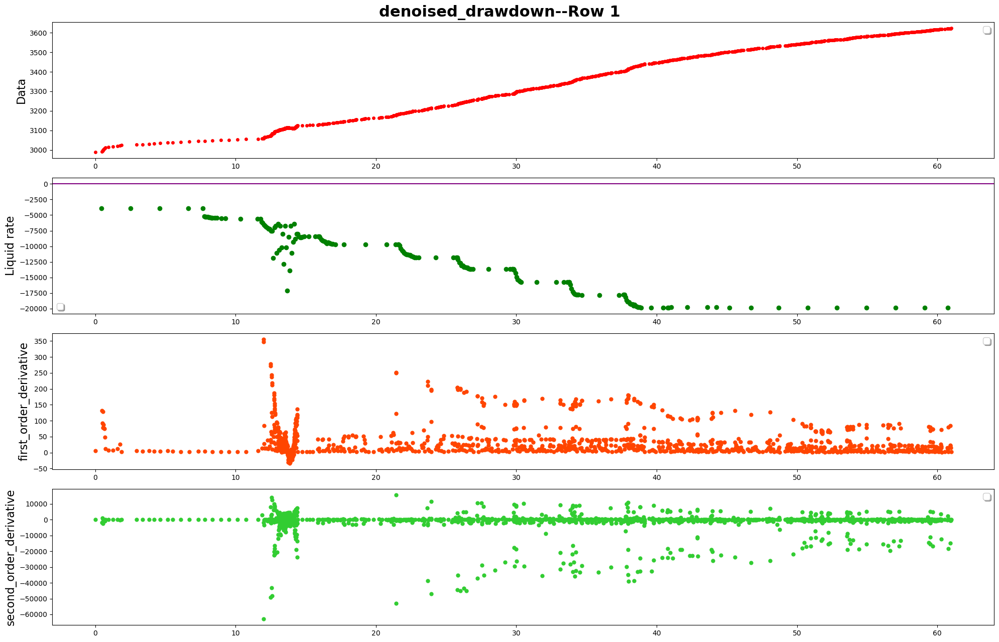

------row 2-----detected points:[2248, 2249]


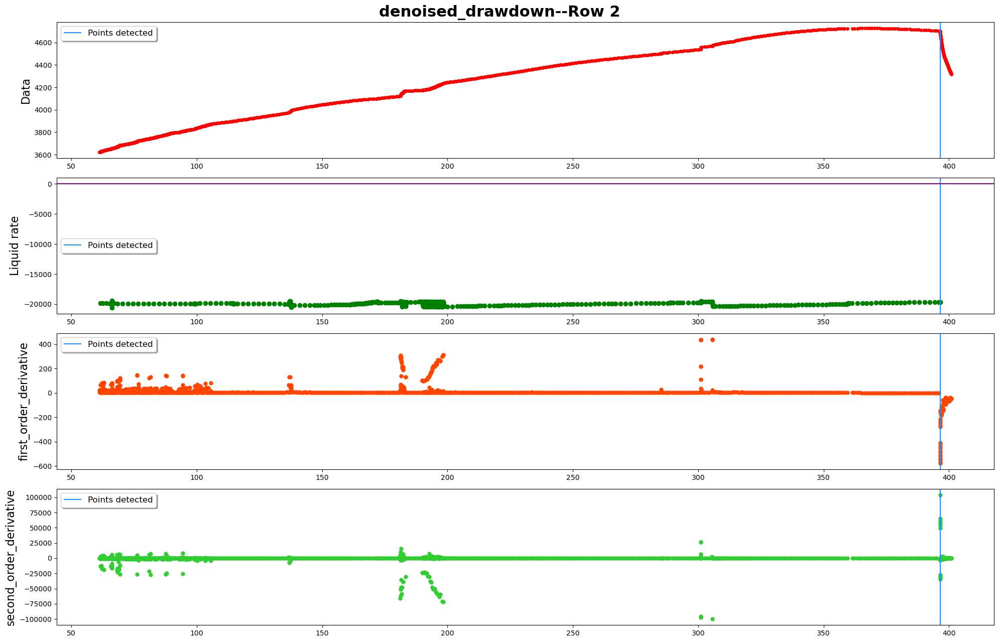

------row 3-----detected points:[3095, 3096]


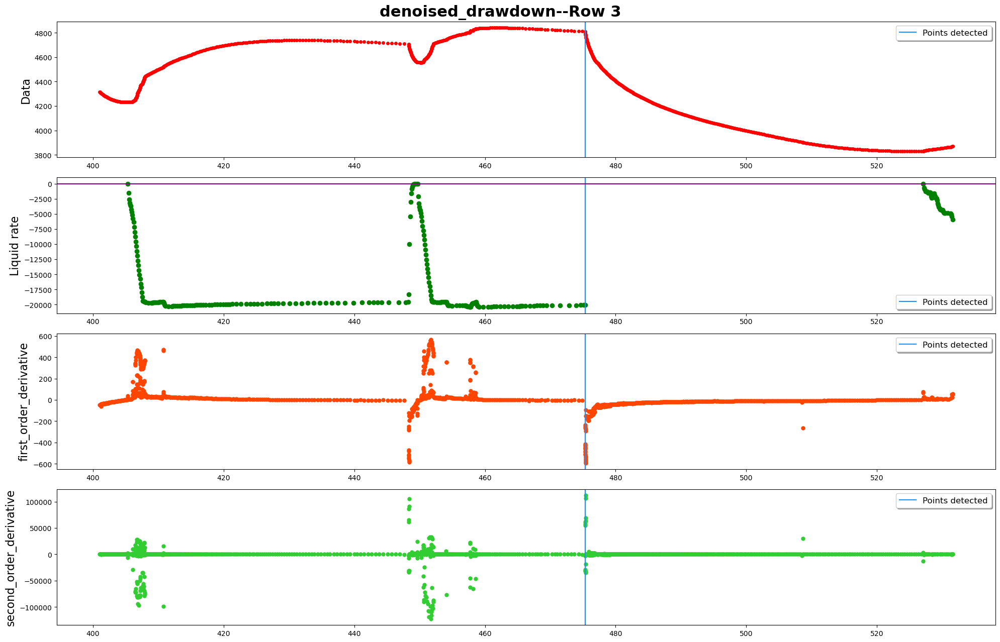

------row 4-----detected points:[3988, 3989, 3990, 4750, 4751]


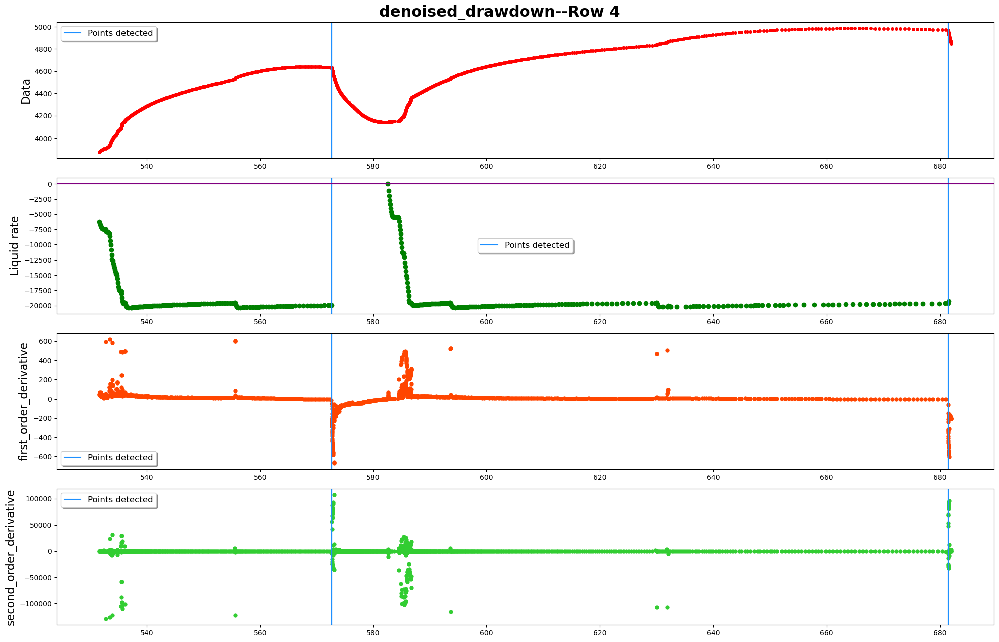

------row 5-----detected points:[5984, 5985]


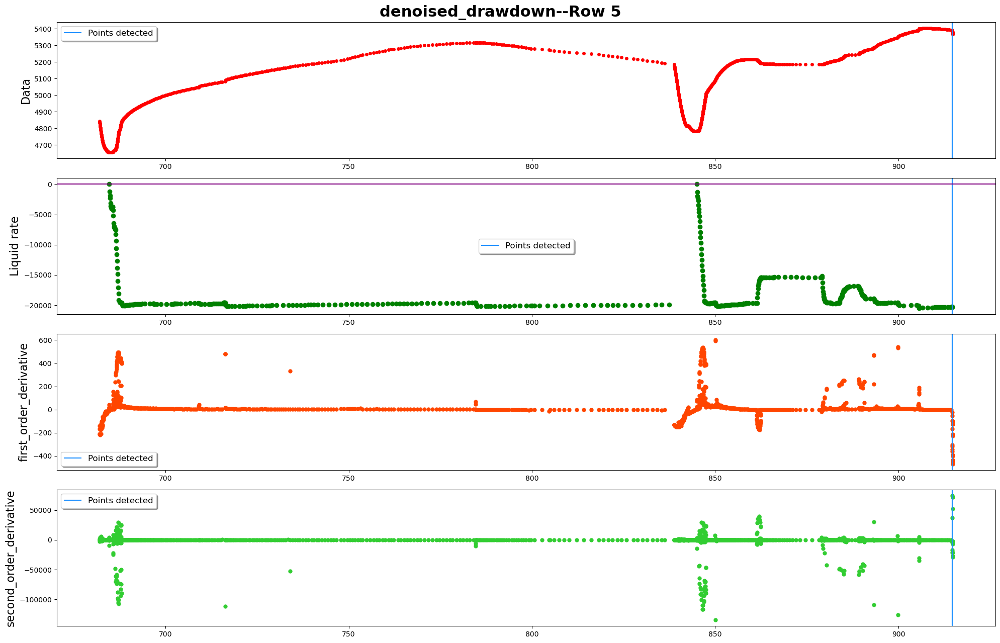

------row 6-----detected points:[]


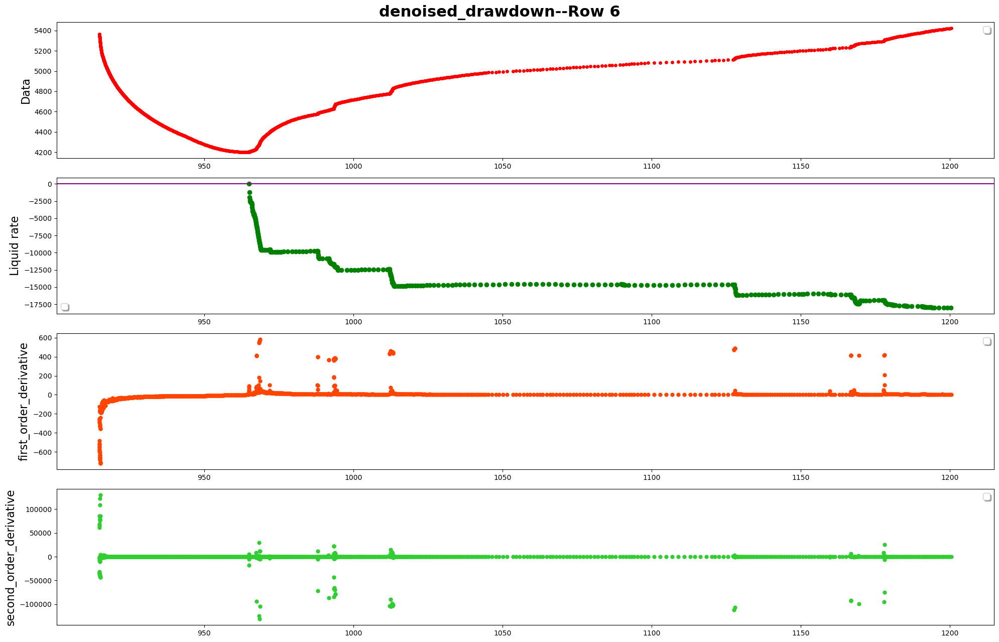

------row 7-----detected points:[7247, 7248, 7249, 7945, 7946, 7947]


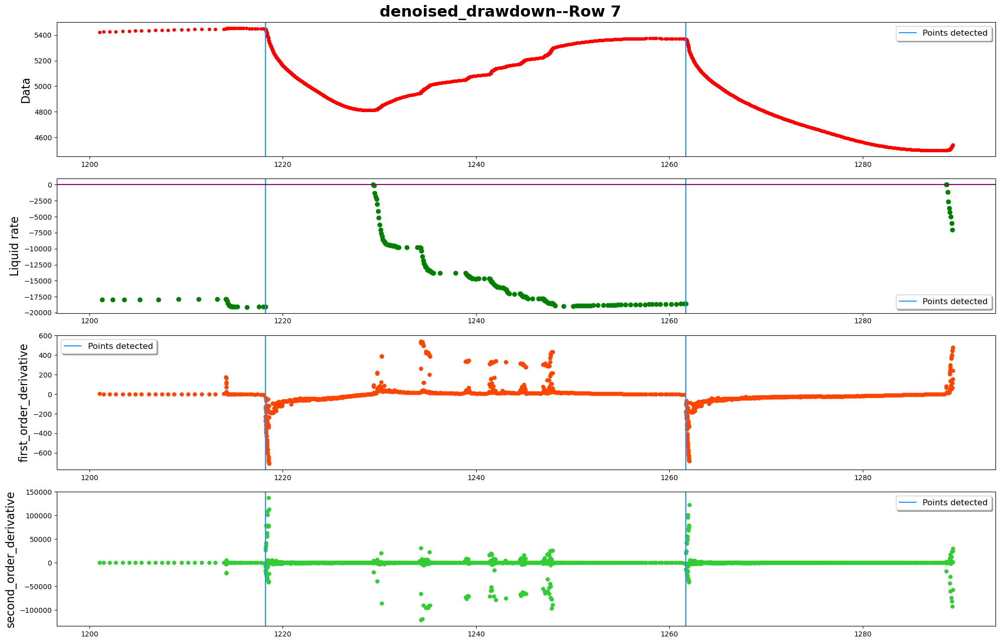

------row 8-----detected points:[9023, 9024]


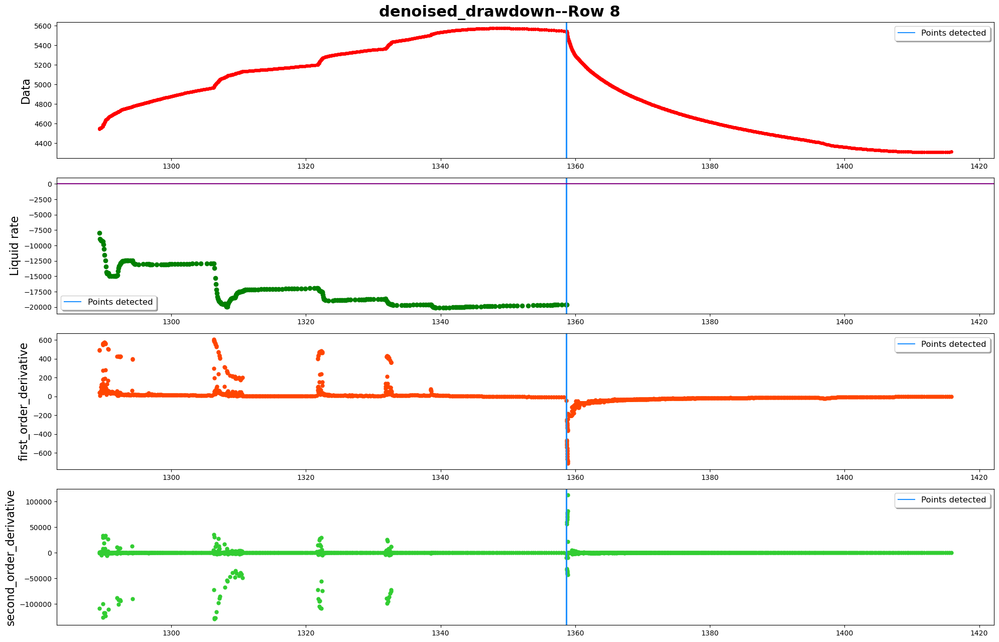

------row 9-----detected points:[10526, 10527]


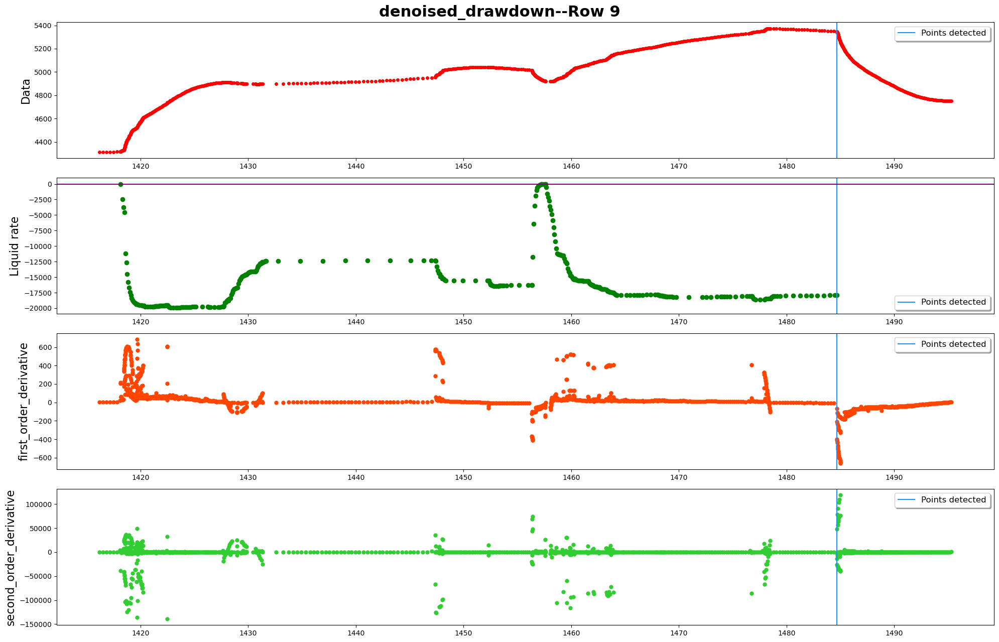

------row 10-----detected points:[11340]


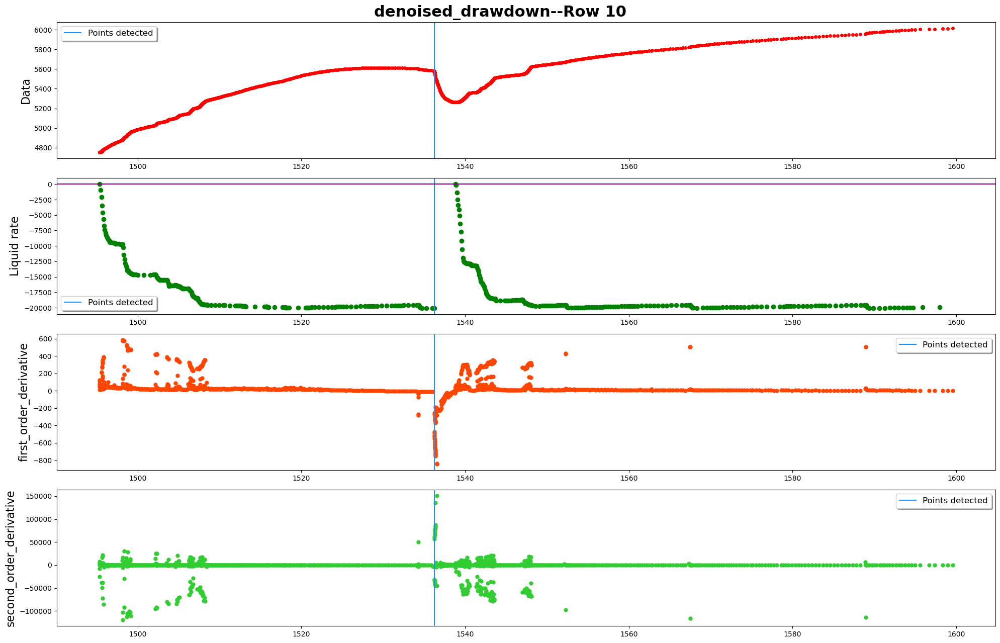

------row 11-----detected points:[12337, 12338]


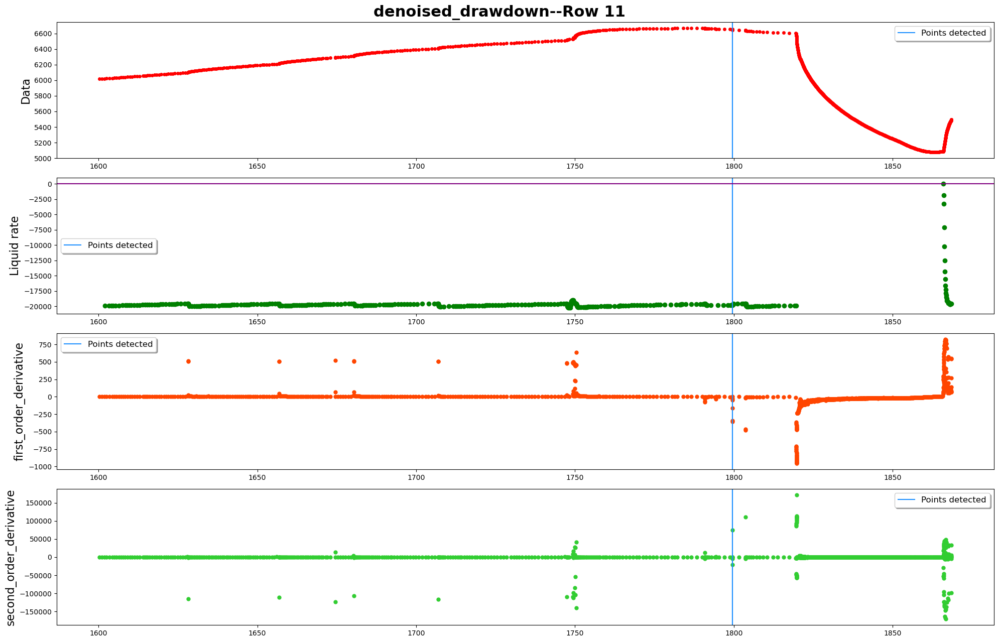

------row 12-----detected points:[]


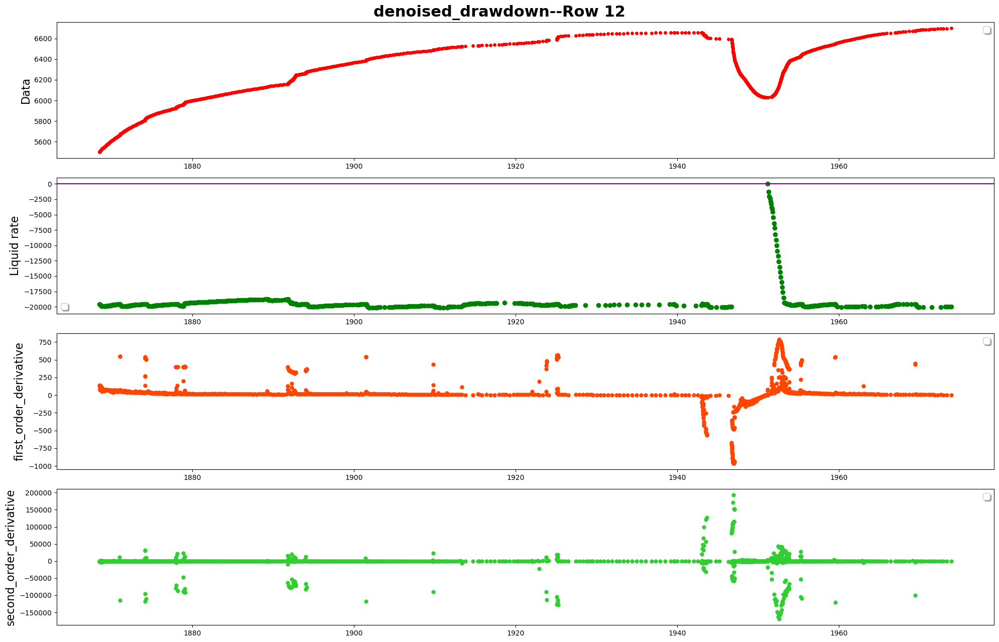

------row 13-----detected points:[]


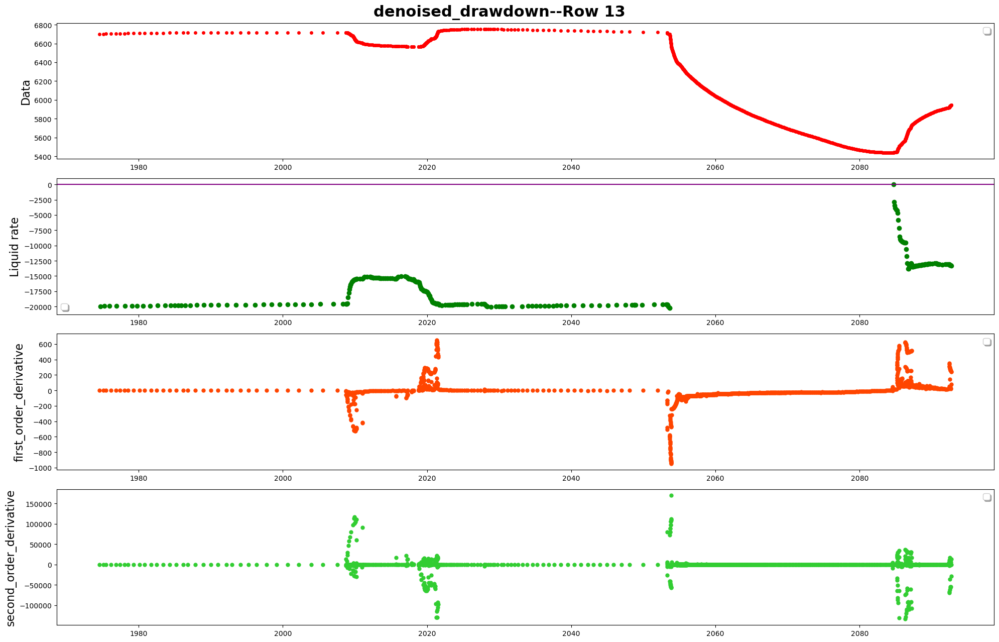

------row 14-----detected points:[]


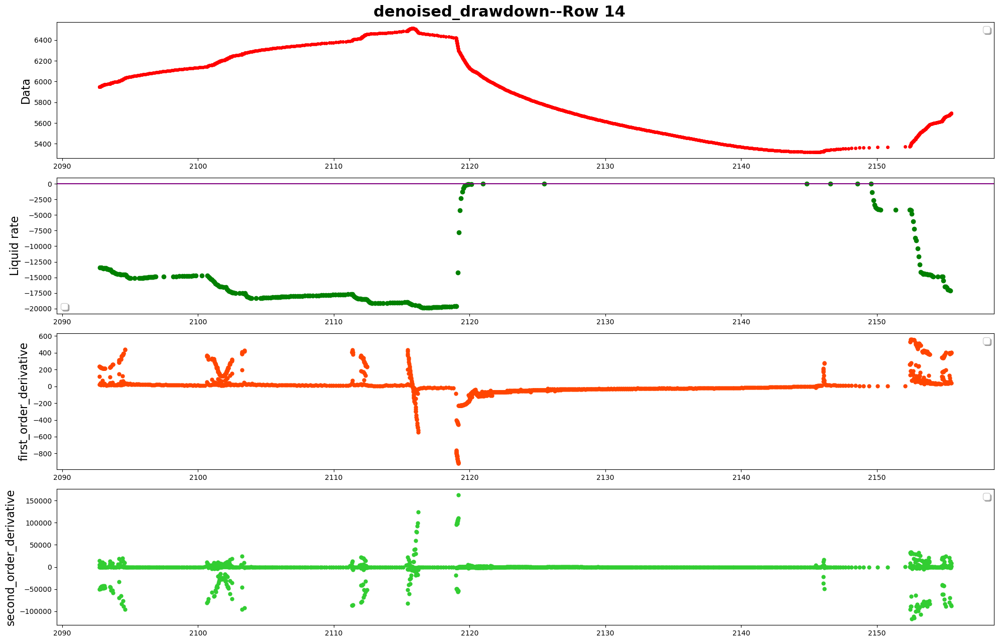

------row 15-----detected points:[]


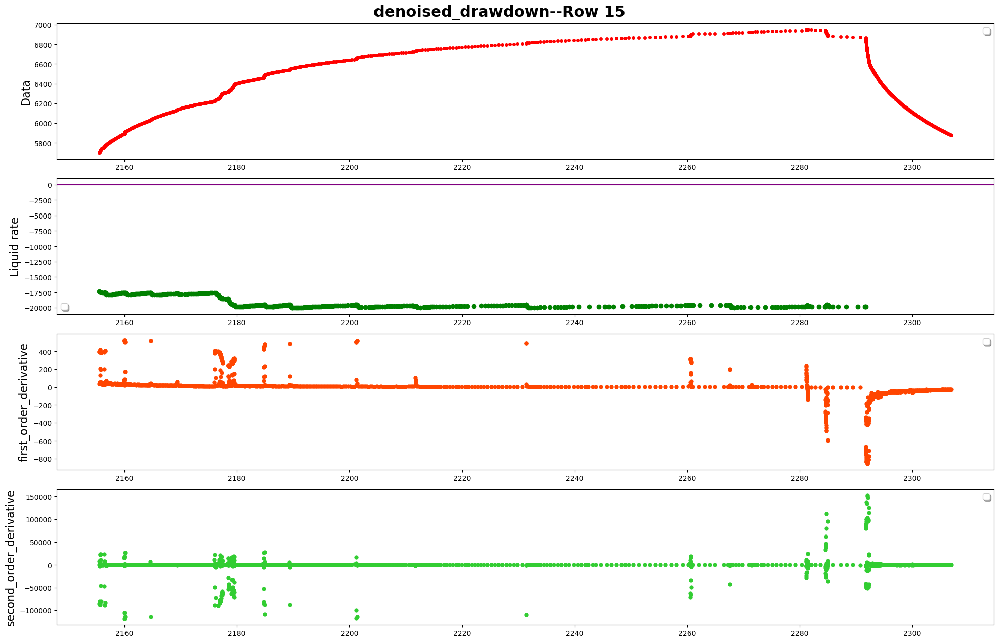

------row 16-----detected points:[]


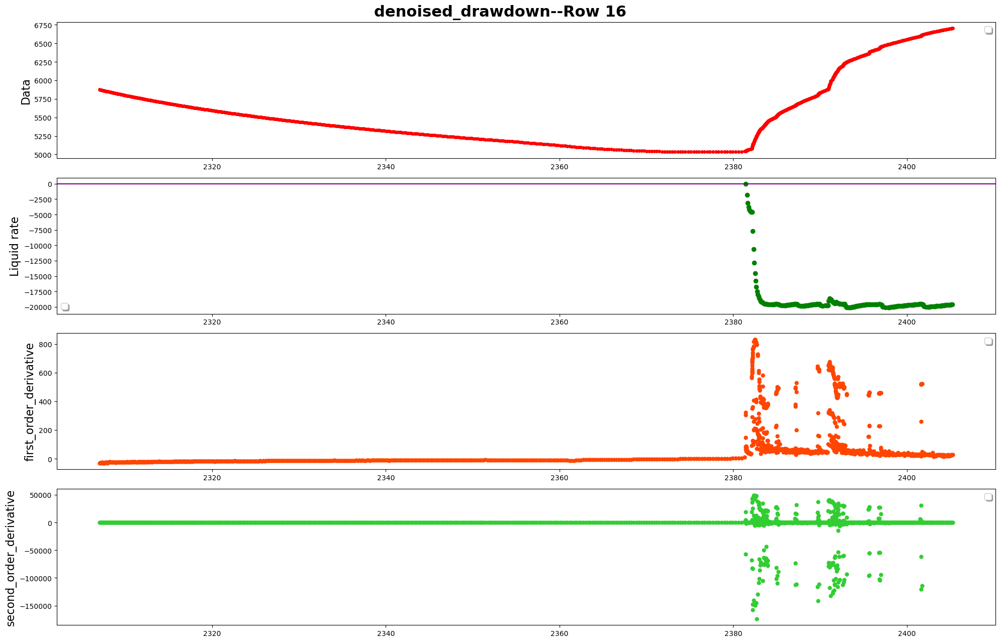

------row 17-----detected points:[]


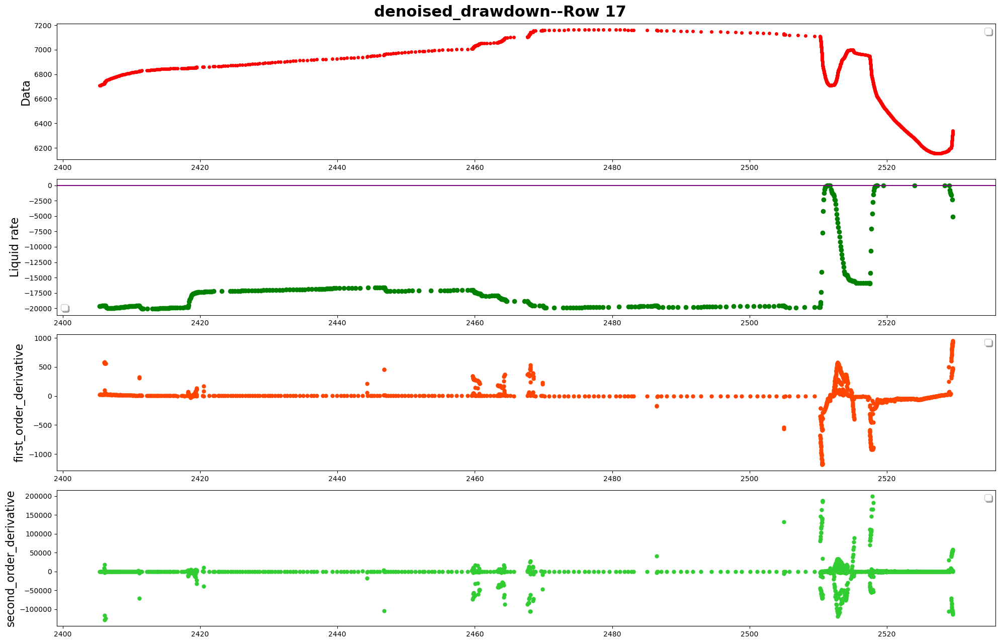

------row 18-----detected points:[]


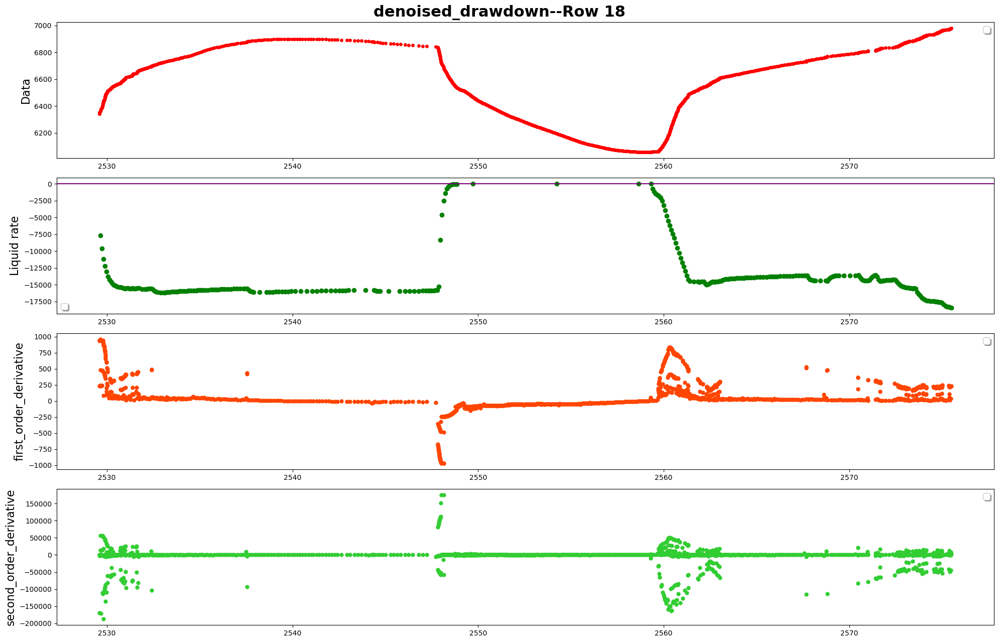

------row 19-----detected points:[22697]


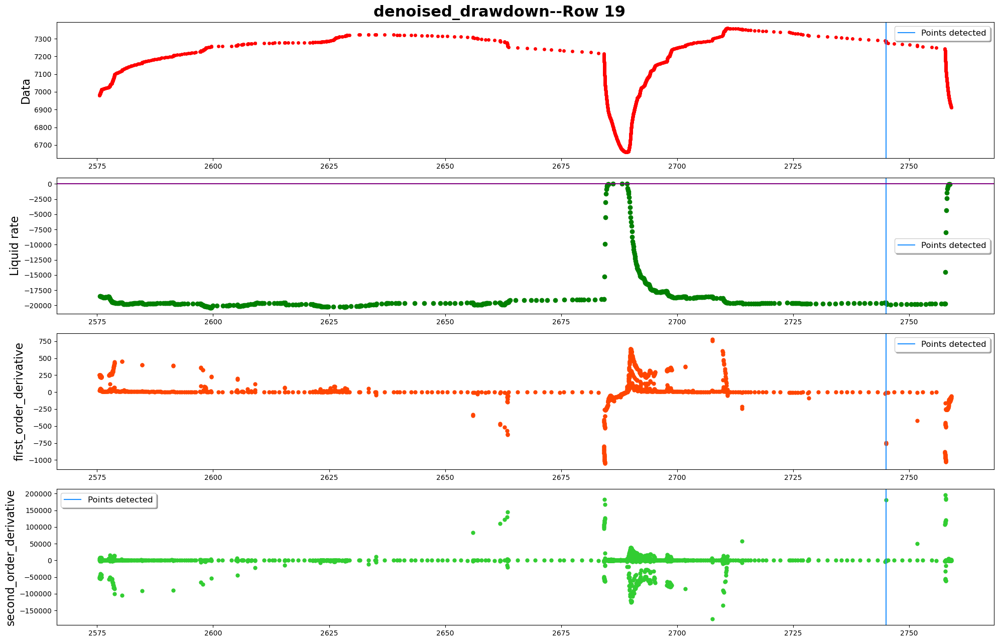

------row 20-----detected points:[]


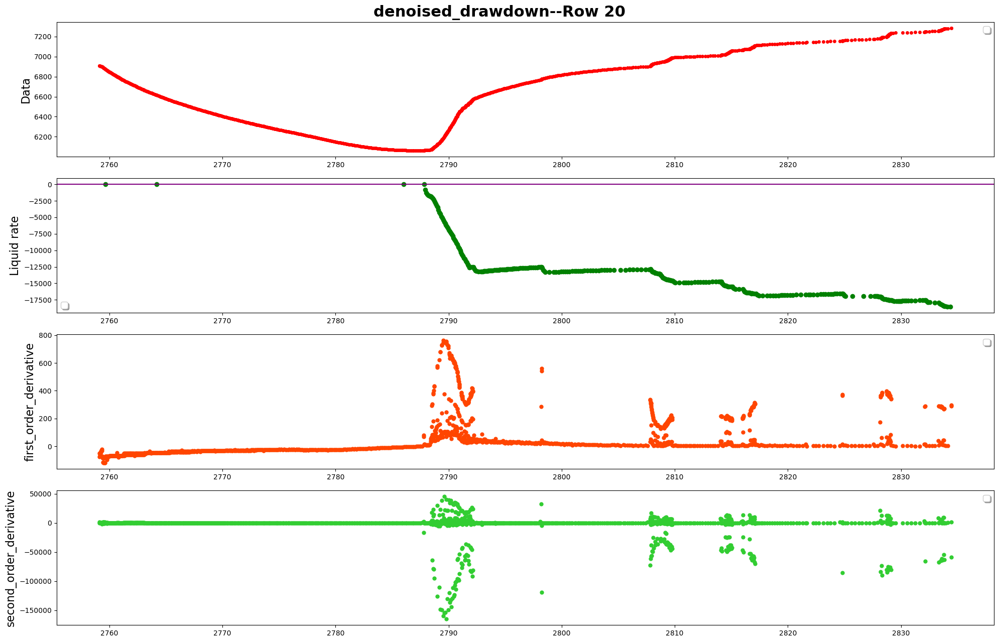

------row 21-----detected points:[24117, 24210, 24215]


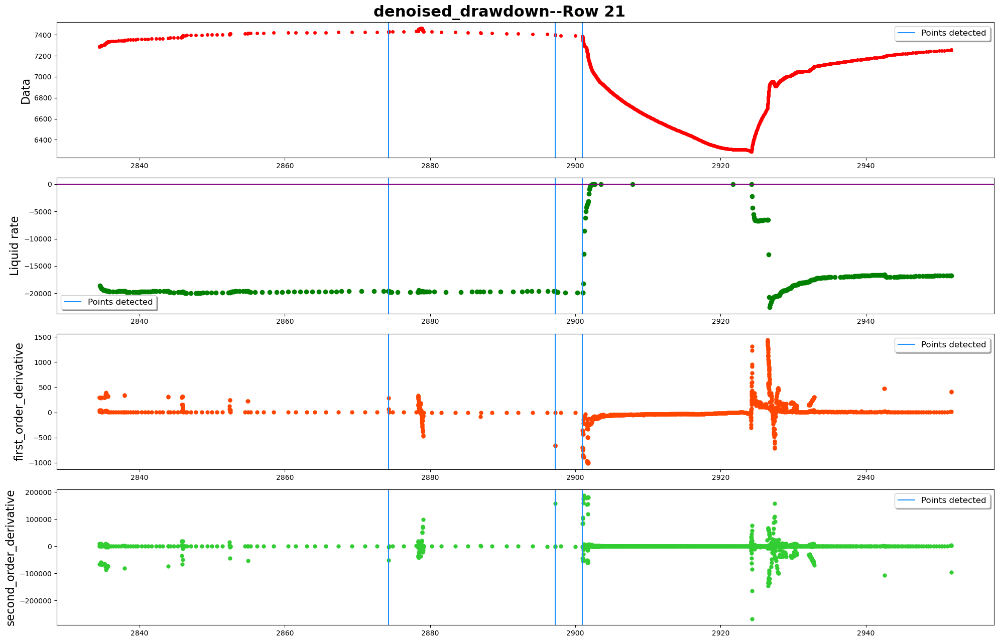

------row 22-----detected points:[25711, 25712, 26354, 26355, 26356, 26357, 26358, 26359, 26360, 26361, 26362, 26363]


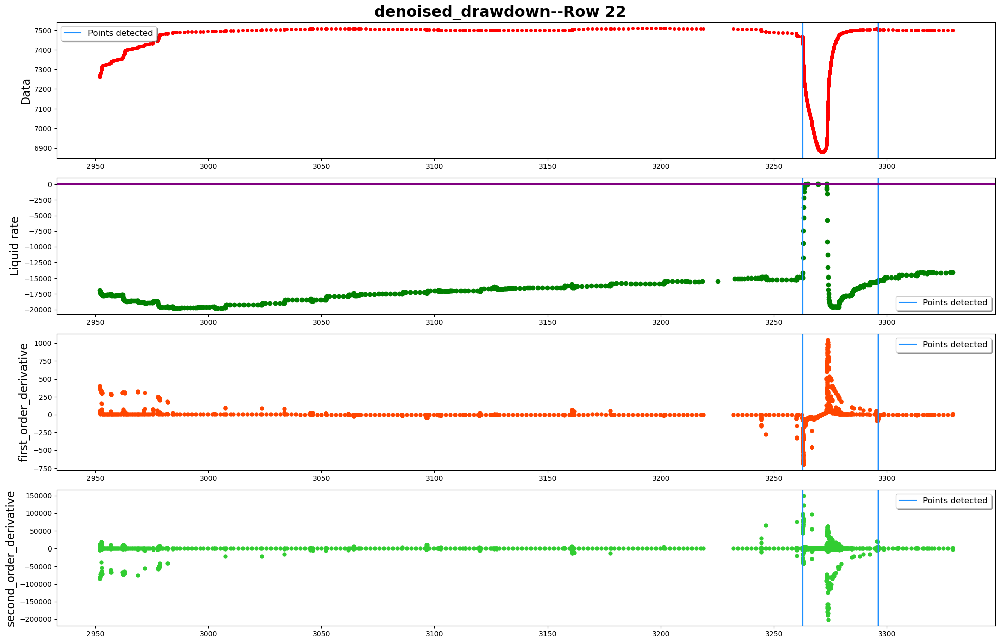

------row 23-----detected points:[26418, 26419, 26420]


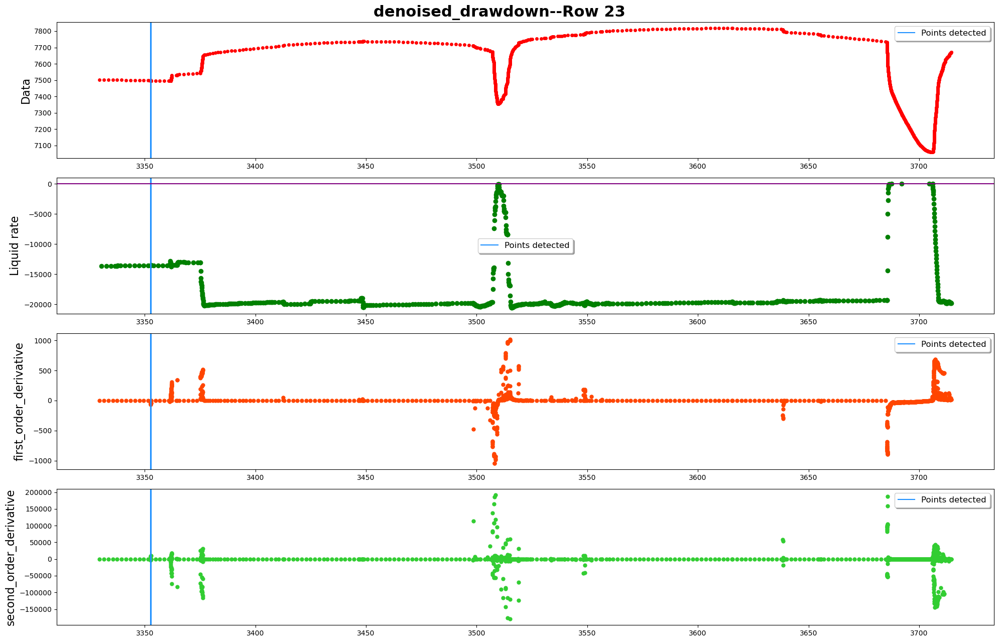

------row 24-----detected points:[]


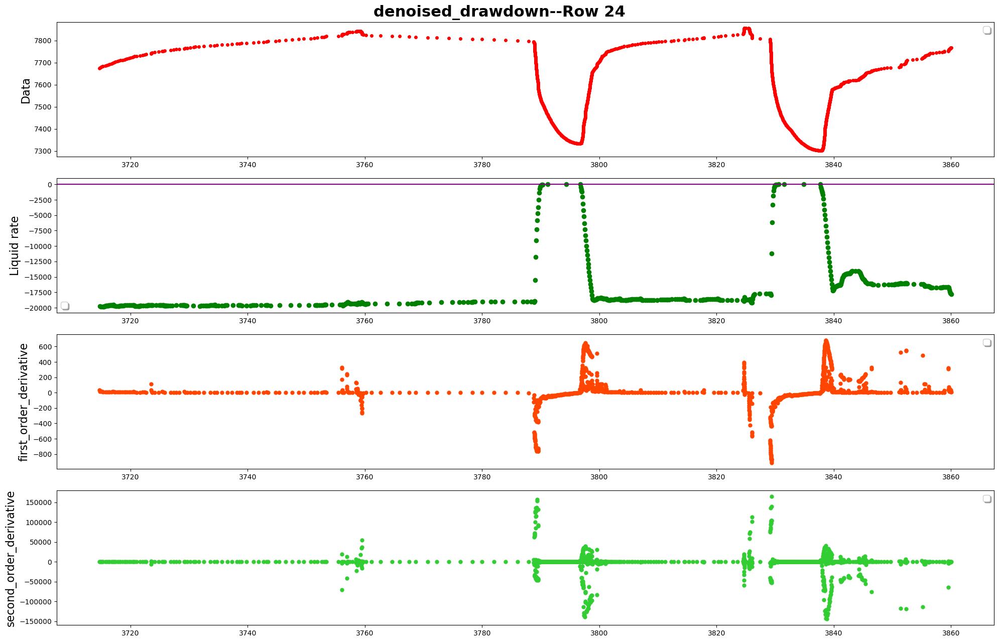

------row 25-----detected points:[]


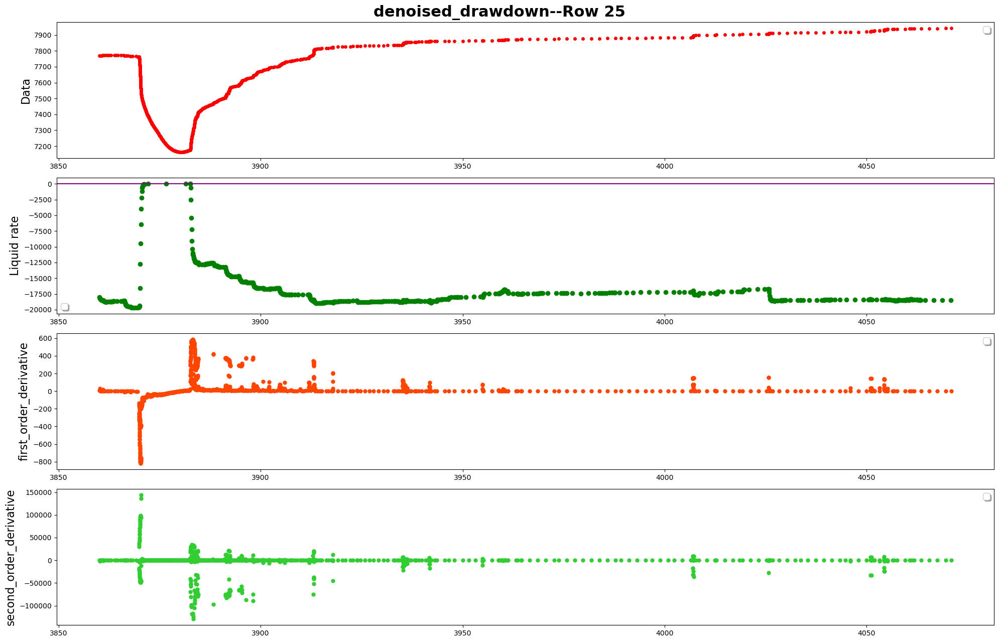

In [10]:
pressure_df=processed_data_denoised.pressure_df
rate_df=processed_data_denoised.rate_df
data_inOneRow=1200
filename_toSave=""
plot_name="denoised_drawdown"
plot_whole=True
plot_details=True
plot_statistics=False
PlotNSave(pressure_df,
          rate_df,
          drawdown,
          [],
          data_inOneRow,
          plot_name,
          filename_toSave,
          plot_statistics,
          plot_whole,
          plot_details,
          colum_names)

### </br>time_halfWindow=0.1,</br>time_halfWindow_forLearn=0.5

detect_breakpoint.....
---------------calculate_Parameters_allCurve linear
point '28322' is going to be classified as buildup,
however the ground truth should be drawdown,
there must be a bump in window thus should not be included into breakpoints for learning
------In the input ground truth: 29 points are detected as buildup, 28 points are detected as drawDown
start to learn 'buildUp' pattern...
---------------calculate_Parameters_allCurve polynomial


C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:288: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:288: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:288: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:288: RankWarning: Polyfit may be poor

start to learn 'drawDown' pattern...
---------------calculate_Parameters_allCurve polynomial


C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:288: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:288: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:288: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:288: RankWarning: Polyfit may be poor

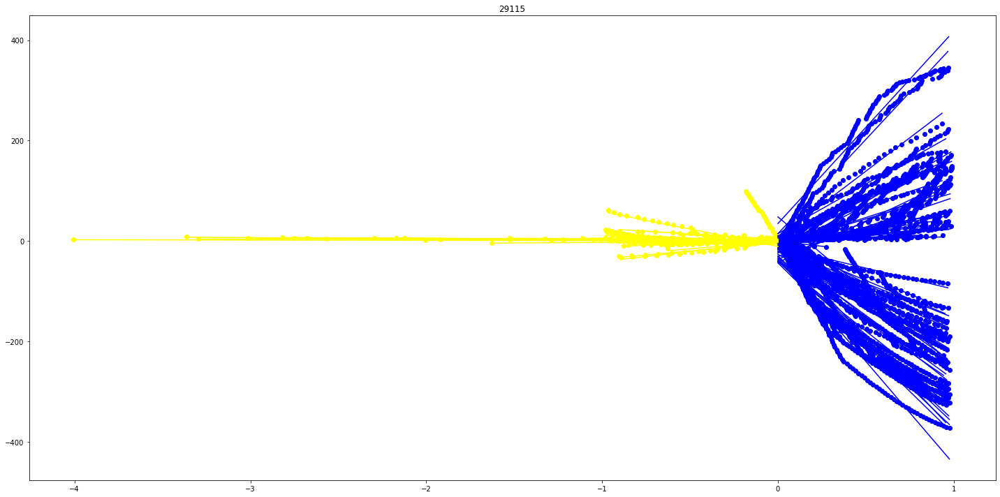

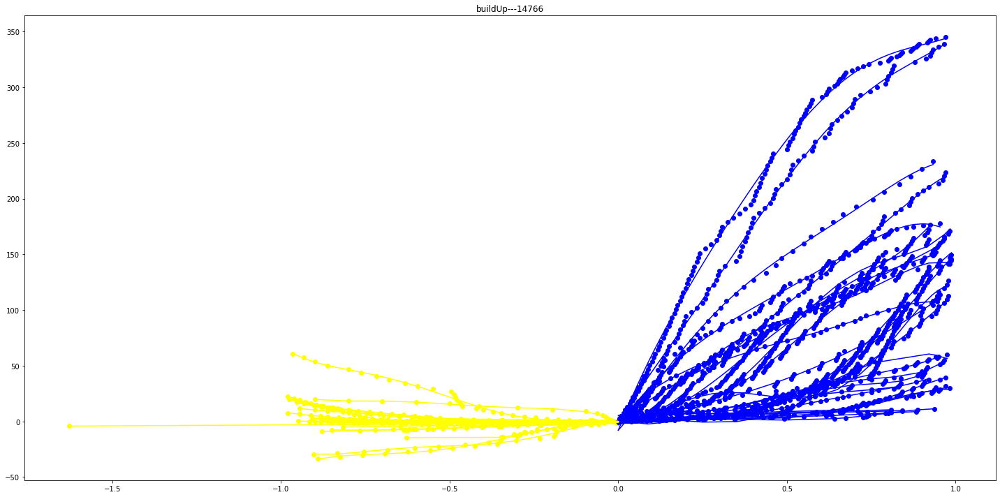

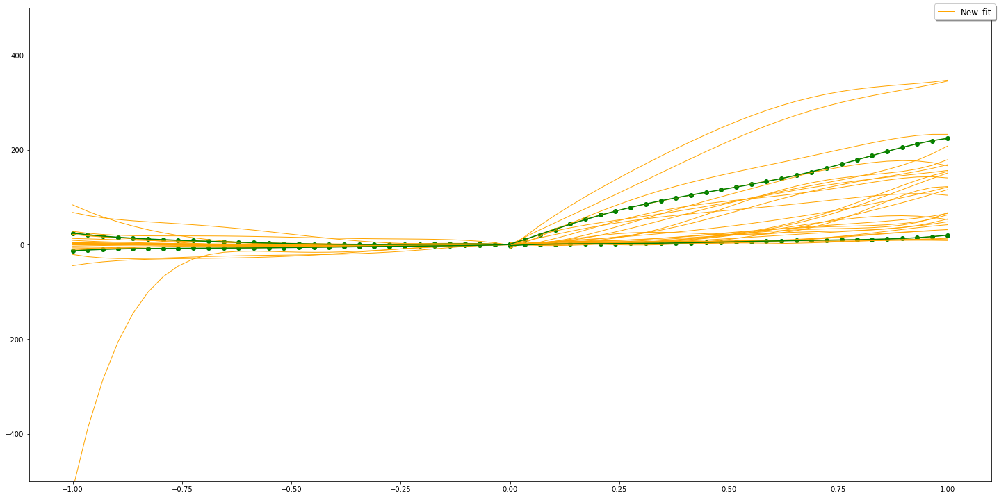

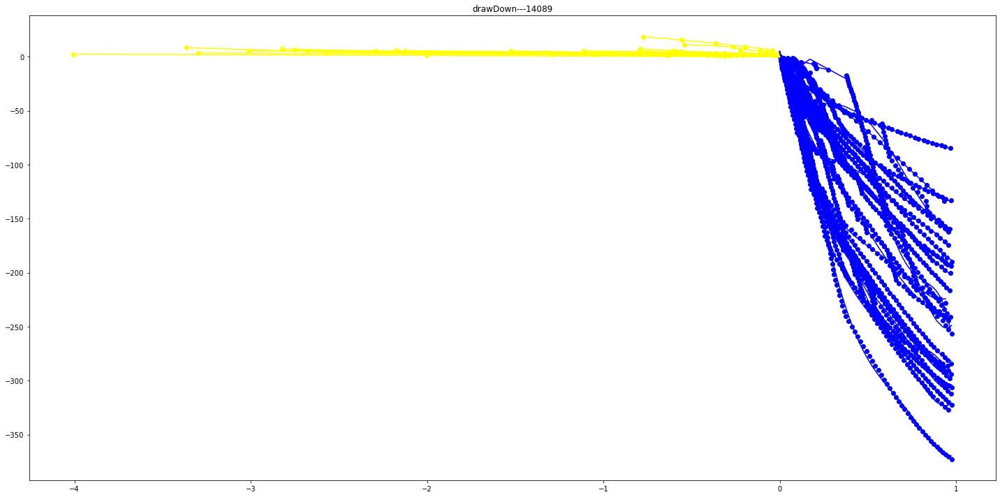

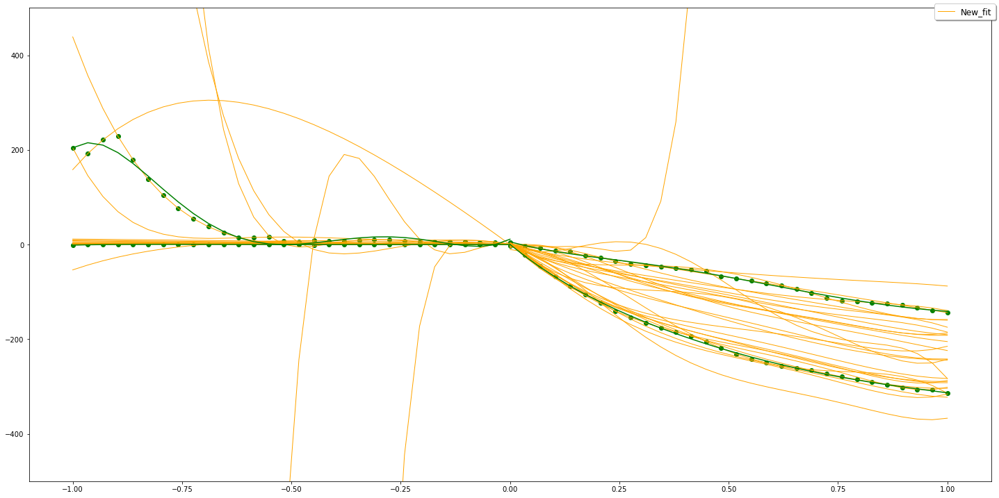

In [11]:
pressure_df=pressure_df_denoised
pressure_measure=list(pressure_df[colum_names["pressure"]["measure"]])
pressure_time=list(pressure_df[colum_names["pressure"]["time"]])
identfication_UsePattern=PatternRecognition(time_halfWindow=0.1,time_halfWindow_forLearn=1)
identfication_UsePattern.learn(pressure_measure,pressure_time,denoised_ground_truth,fitting_type="polynomial")

In [12]:
buildup,drawdown=identfication_UsePattern.predict(pressure_measure,pressure_time)
print(len(buildup),len(drawdown))
# buildup,drawdown

313 21


---initializing...
---plotting...


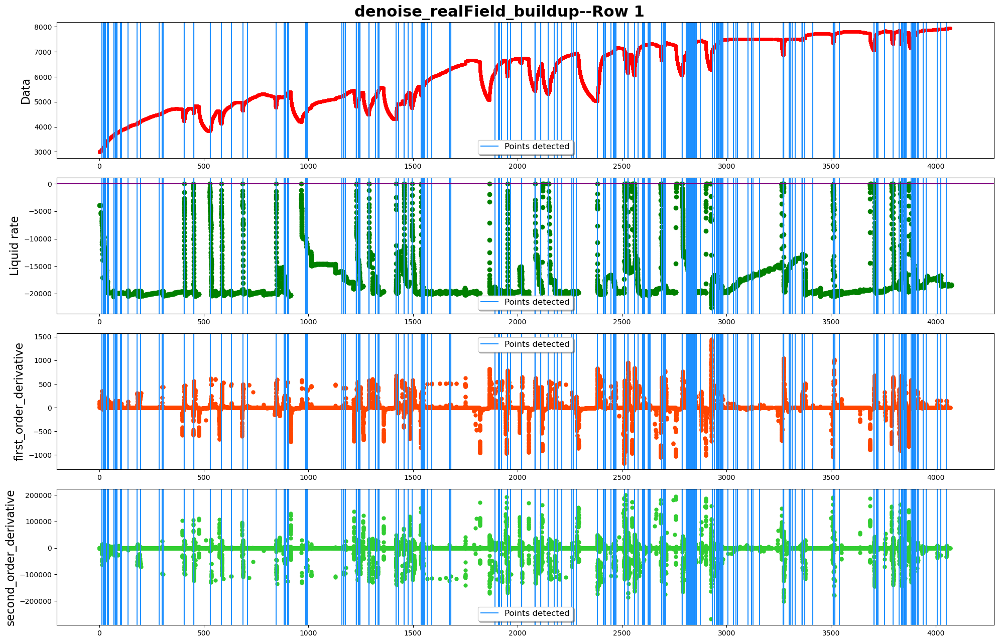

detected 313 points as breakpoints
The plot is devided into 25 rows
------row 1-----detected points:[32, 33, 341, 353, 355, 367, 399, 400, 428, 431, 508, 509, 510, 683, 687, 690, 840, 841]


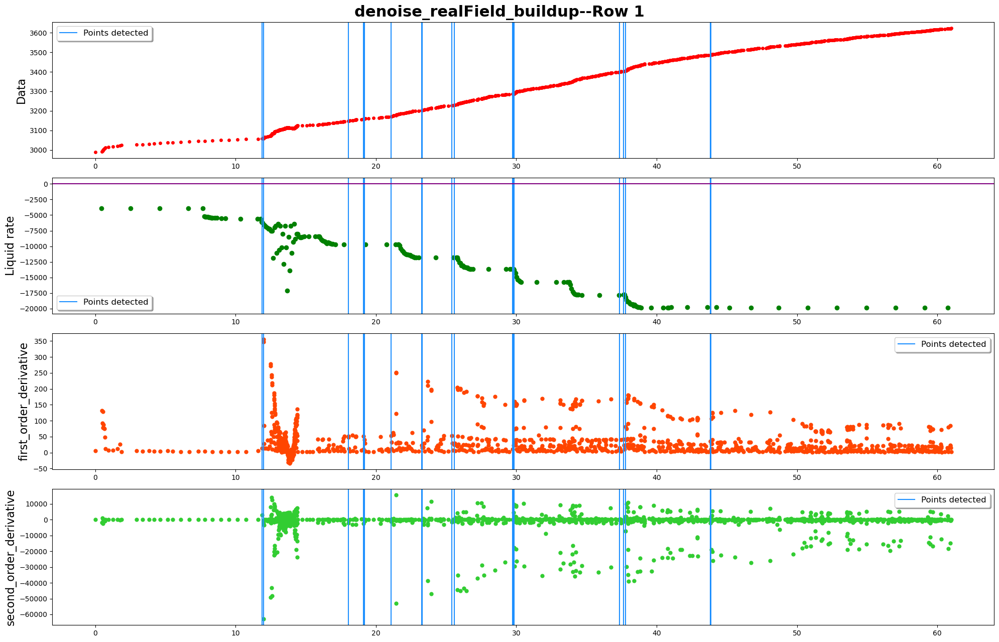

------row 2-----detected points:[1354, 1356, 1357, 1358, 1359, 1360, 1437, 1438, 1488, 1490, 1514, 1515, 1646, 1656, 1657, 1663, 1667, 1730, 1811, 1936, 1946, 2090, 2111, 2126]


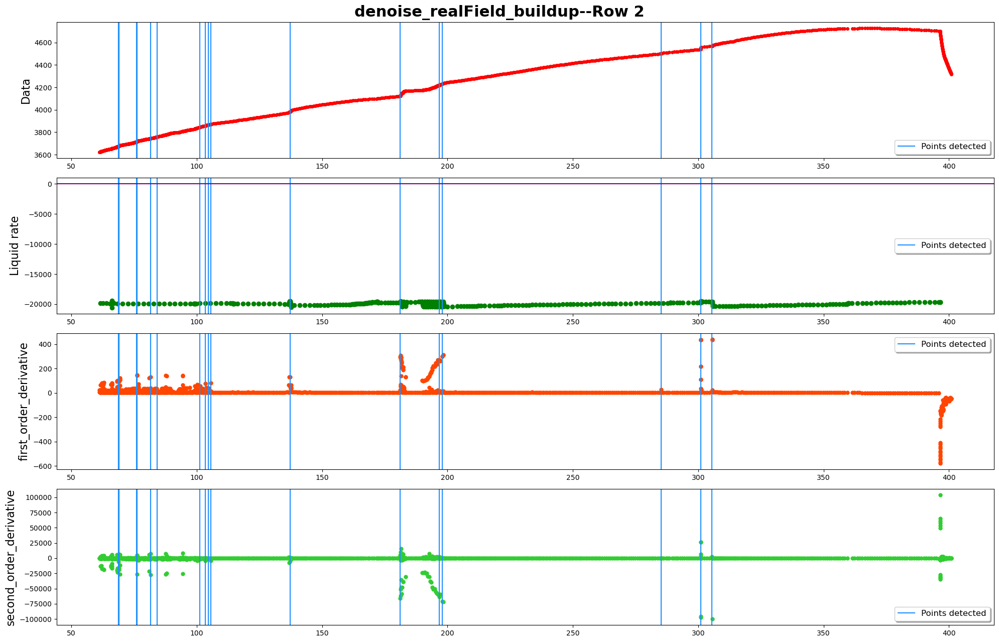

------row 3-----detected points:[2477, 2478, 2479, 2888, 2889, 2893, 3594, 3595]


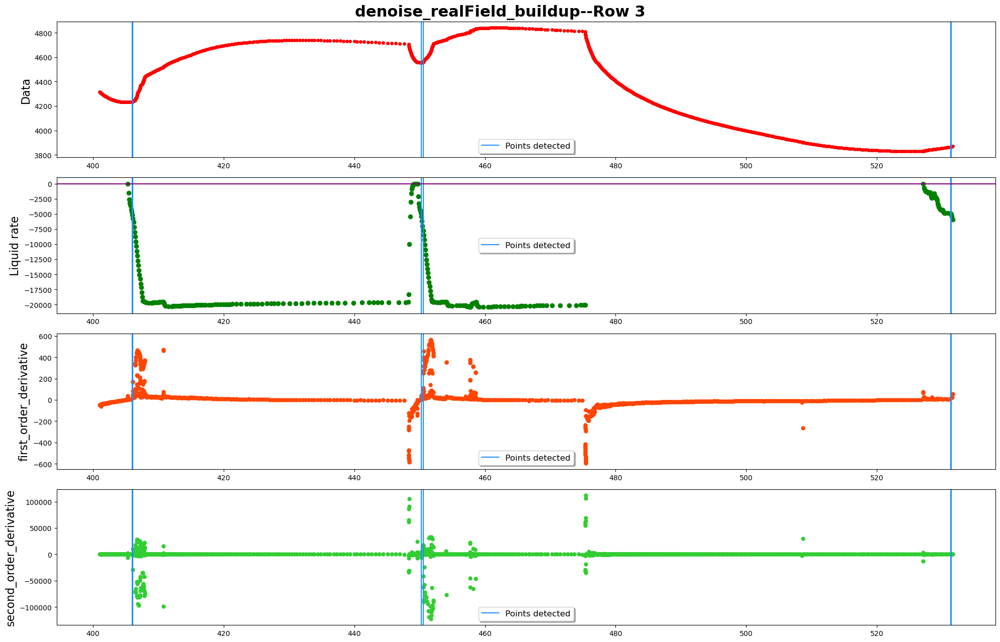

------row 4-----detected points:[4246, 4247, 4653, 4654]


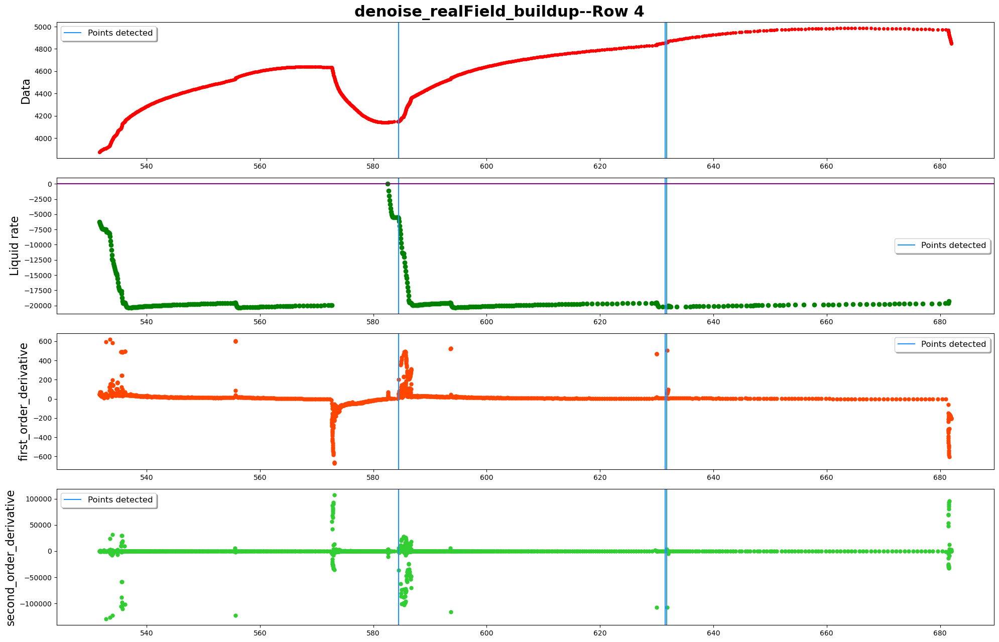

------row 5-----detected points:[4899, 5117, 5445, 5827, 5853, 5867, 5868, 5919, 5943, 5944]


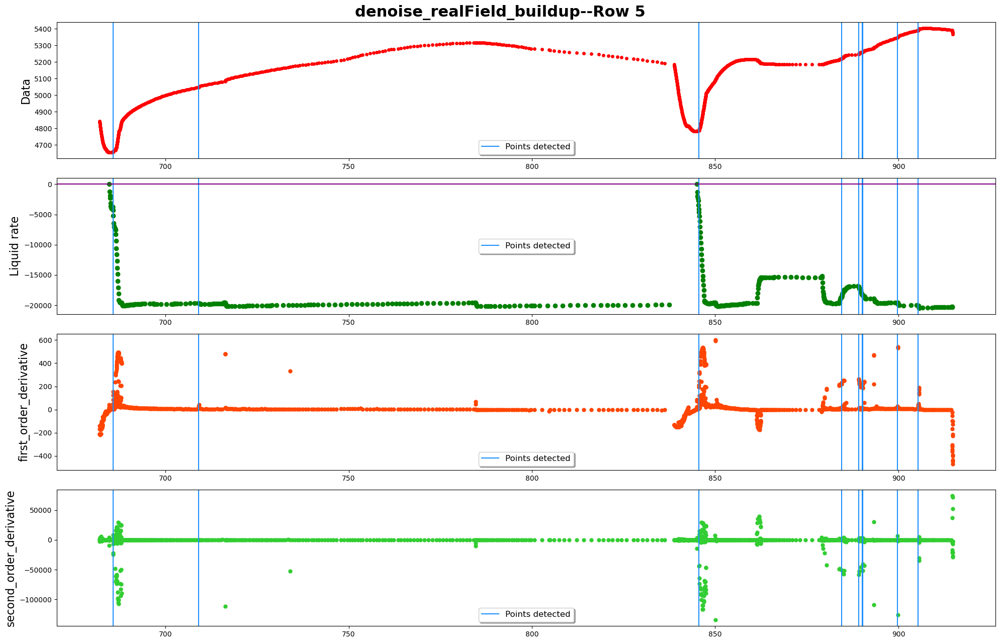

------row 6-----detected points:[6739, 6760, 6761, 6762, 6771, 7093, 7111, 7122, 7137]


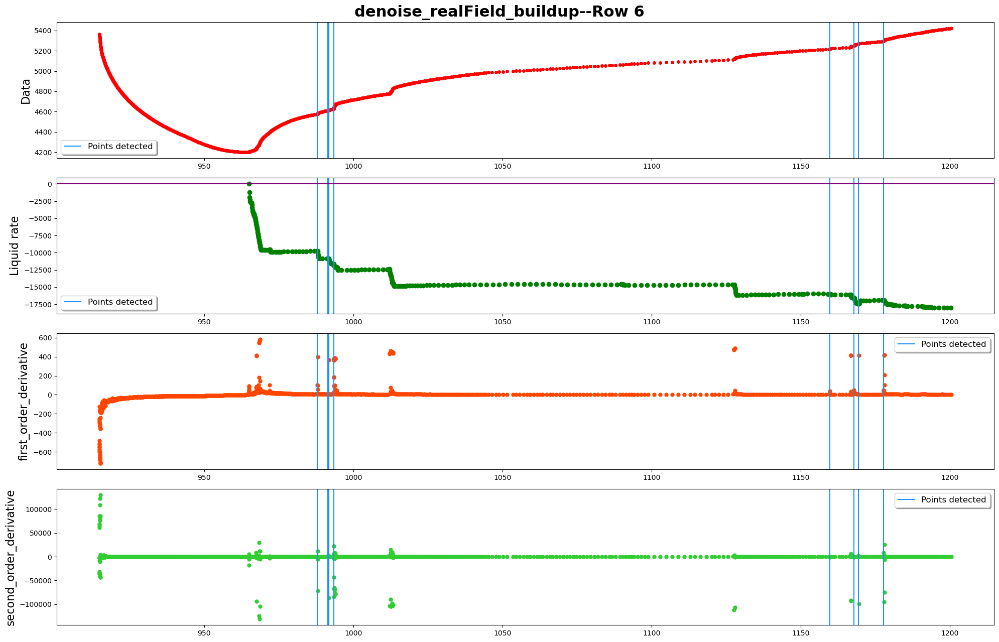

------row 7-----detected points:[7543, 7544, 7547, 7548, 7551, 7552, 7553, 7683, 7684, 7714, 7812, 7814, 7815, 8361, 8364, 8365, 8366, 8367]


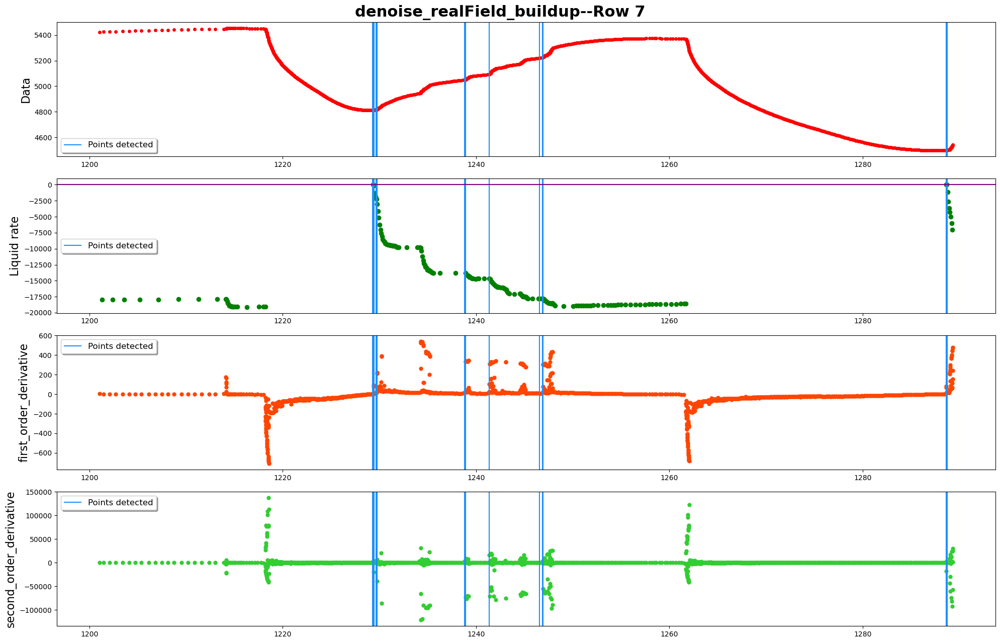

------row 8-----detected points:[8774, 8868, 8924, 8925, 8926, 8940]


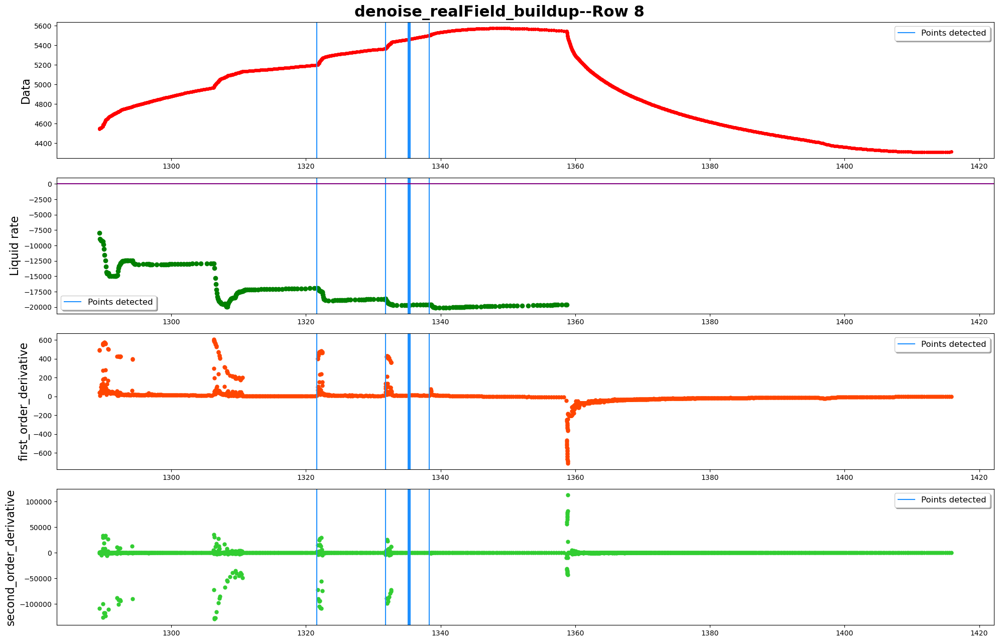

------row 9-----detected points:[9606, 9607, 10020, 10023, 10228, 10229, 10230, 10231, 10451, 10452, 10799]


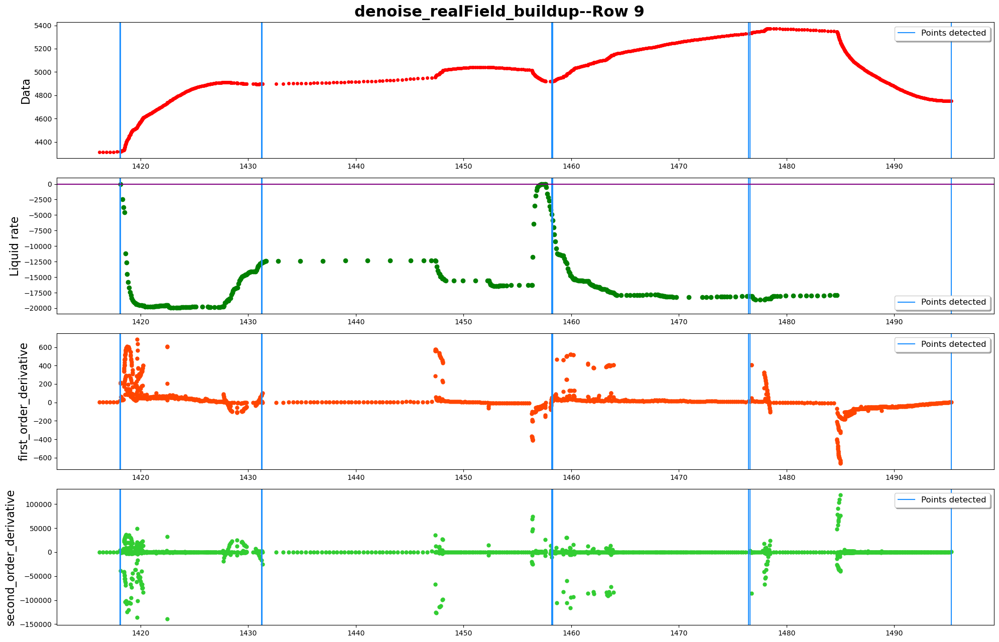

------row 10-----detected points:[11490, 11491, 11592, 11742, 11835, 11836, 11868, 11906, 11971]


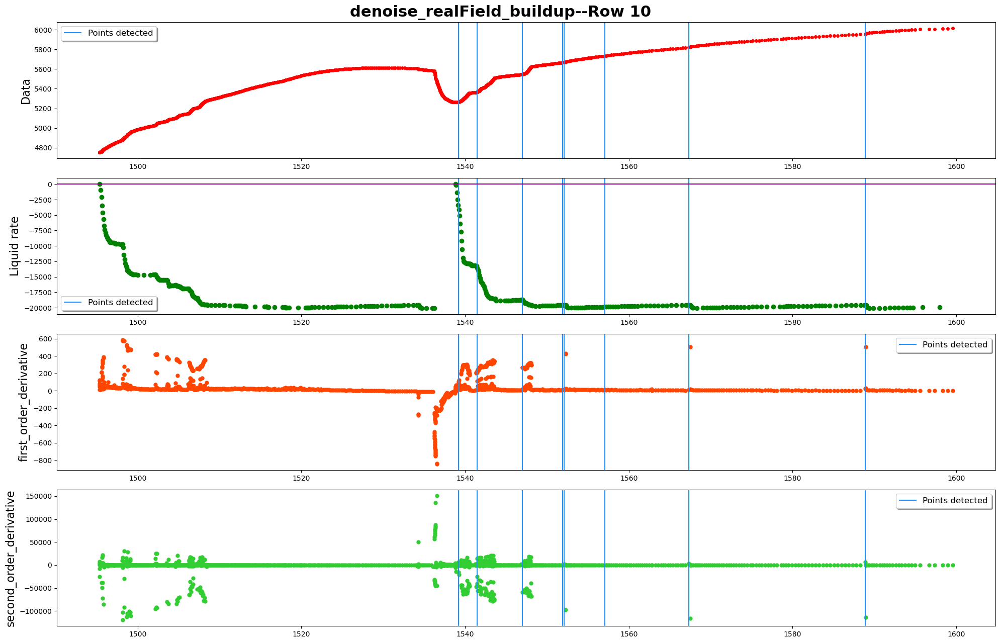

------row 11-----detected points:[12128, 12137]


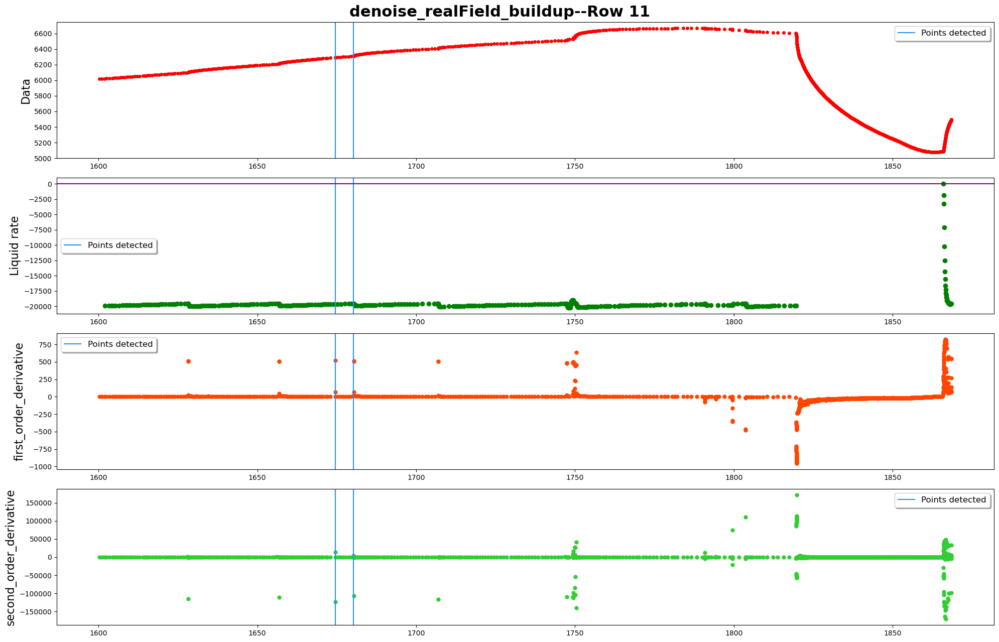

------row 12-----detected points:[13526, 13527, 13716, 13736, 13763, 14089, 14375]


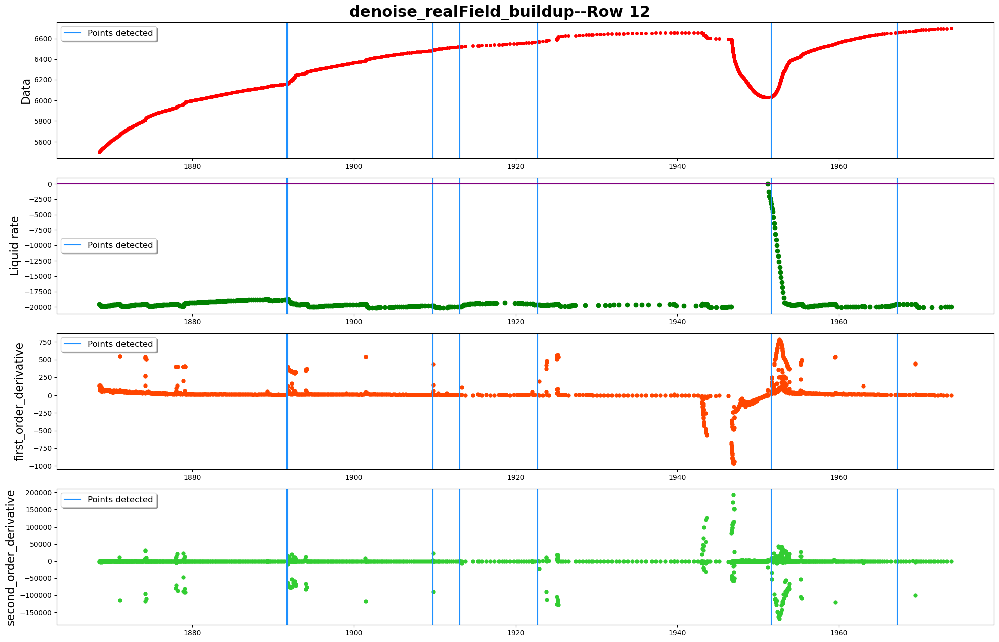

------row 13-----detected points:[14574, 14575, 14578, 15338, 15339, 15340, 15341, 15342, 15343, 15344, 15345, 15346, 15347]


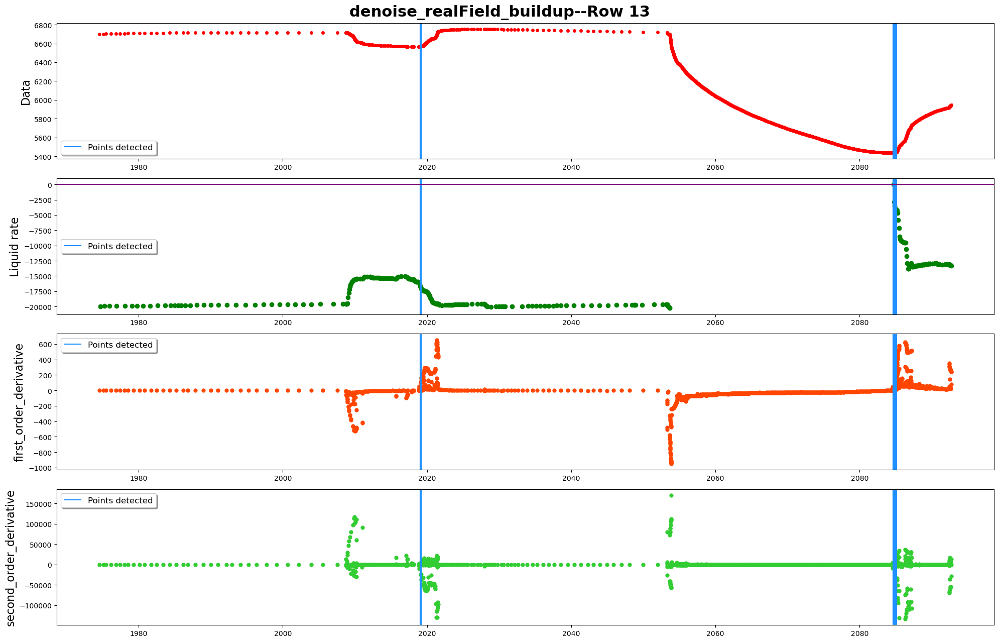

------row 14-----detected points:[15937, 15938, 15939, 16581, 16585]


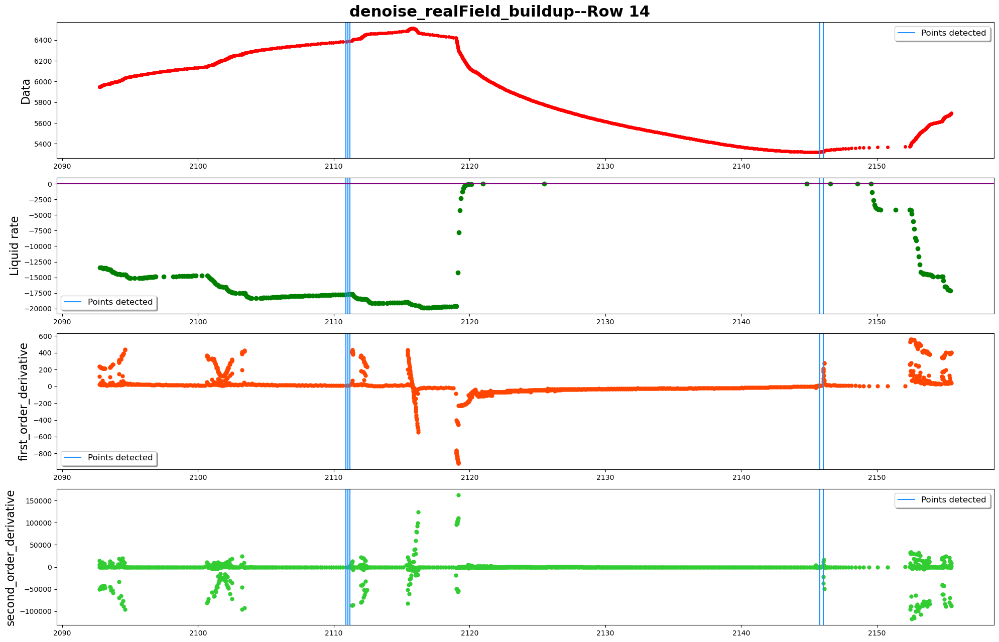

------row 15-----detected points:[17064, 17286, 17287, 17380, 17462, 17463, 17487, 17511]


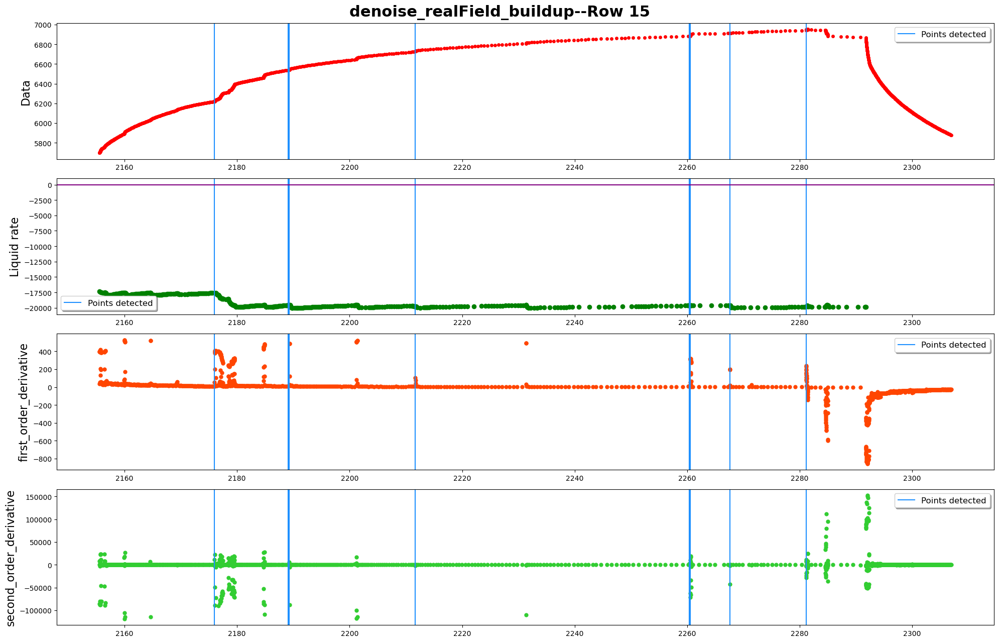

------row 16-----detected points:[18433, 18434]


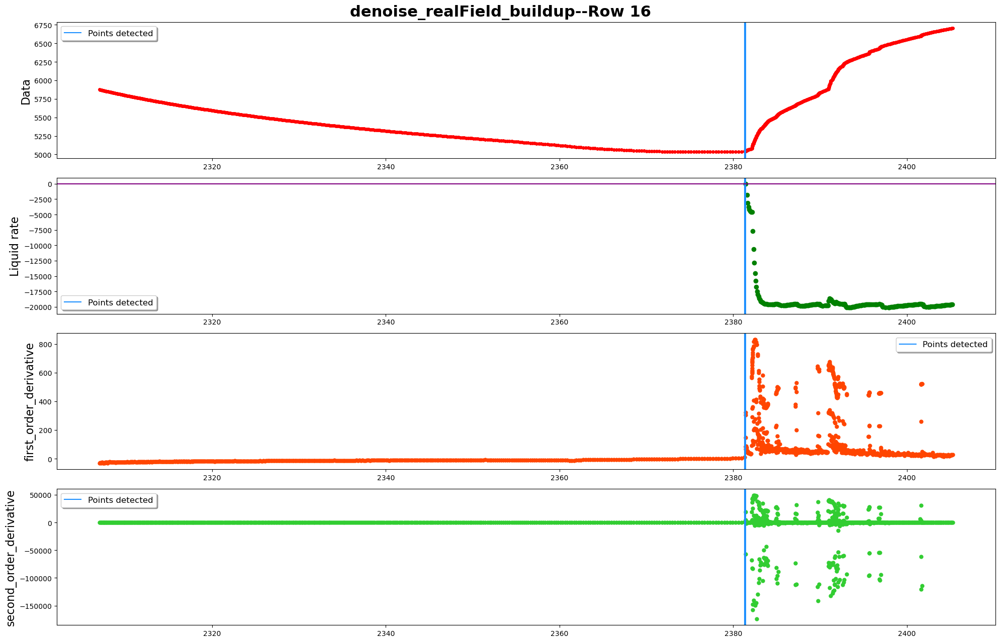

------row 17-----detected points:[19258, 19351, 19365, 19428, 19458, 19503, 19556, 19589, 19778, 19779, 20330, 20331, 20332, 20333, 20334, 20335, 20336]


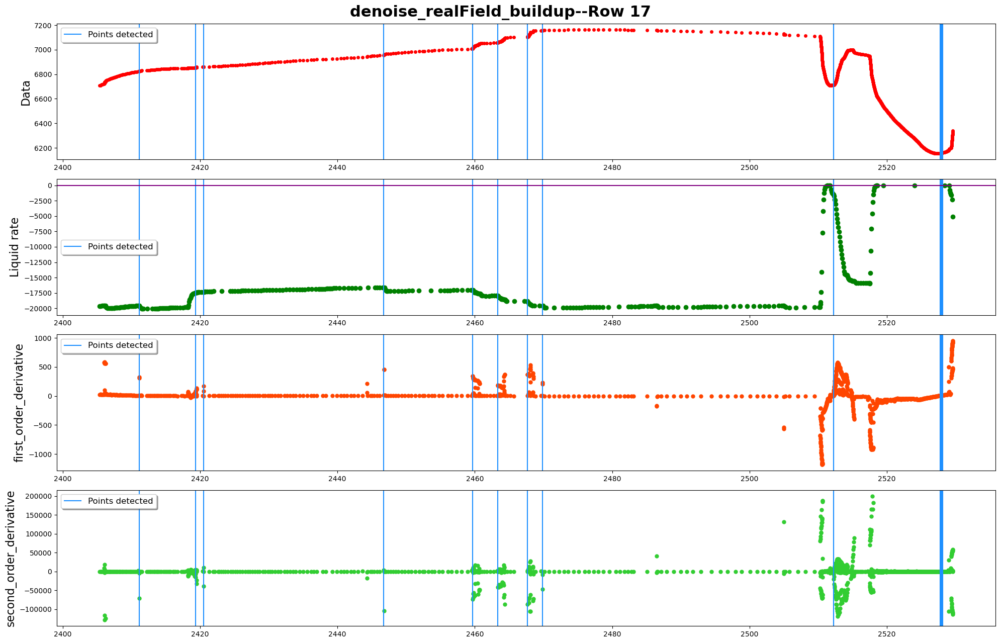

------row 18-----detected points:[21026, 21027]


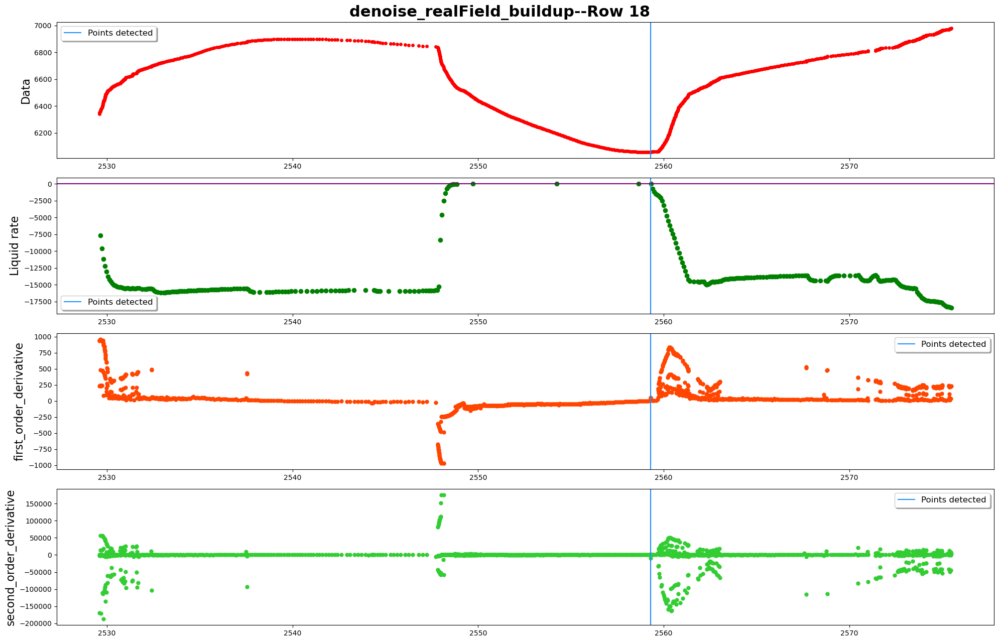

------row 19-----detected points:[21647, 21648, 21782, 21799, 21800, 21808, 21825, 21883, 21884, 21900, 21905, 21916, 22189, 22190, 22527, 22528, 22589, 22590, 22600, 22611, 22620]


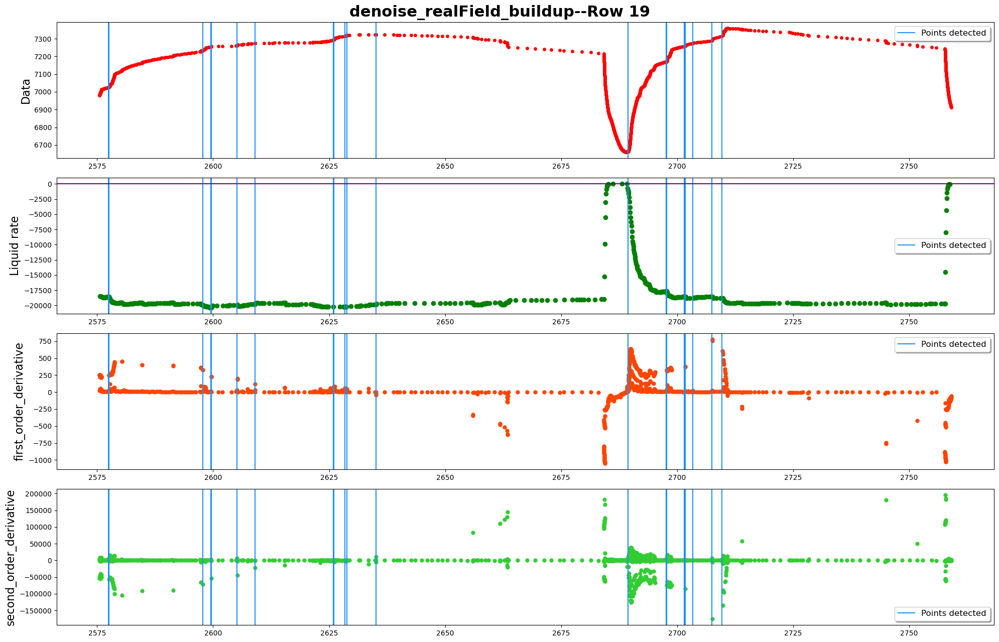

------row 20-----detected points:[23225, 23227, 23230, 23231, 23638, 23771, 23833, 23908, 23923, 23975]


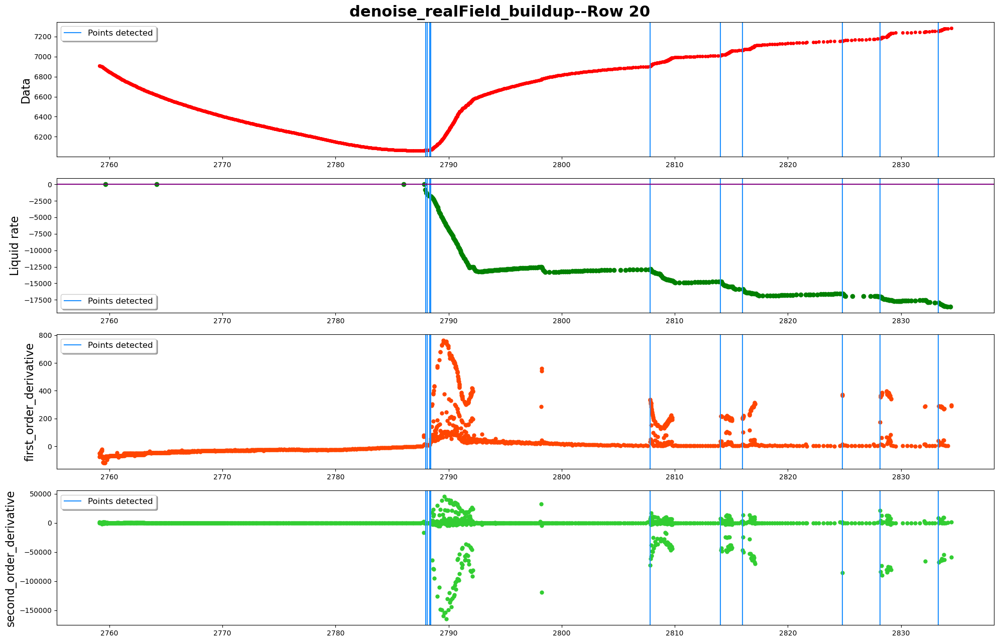

------row 21-----detected points:[24046, 24062, 24068, 24069, 24092, 24101, 24117, 25057, 25058, 25161, 25196]


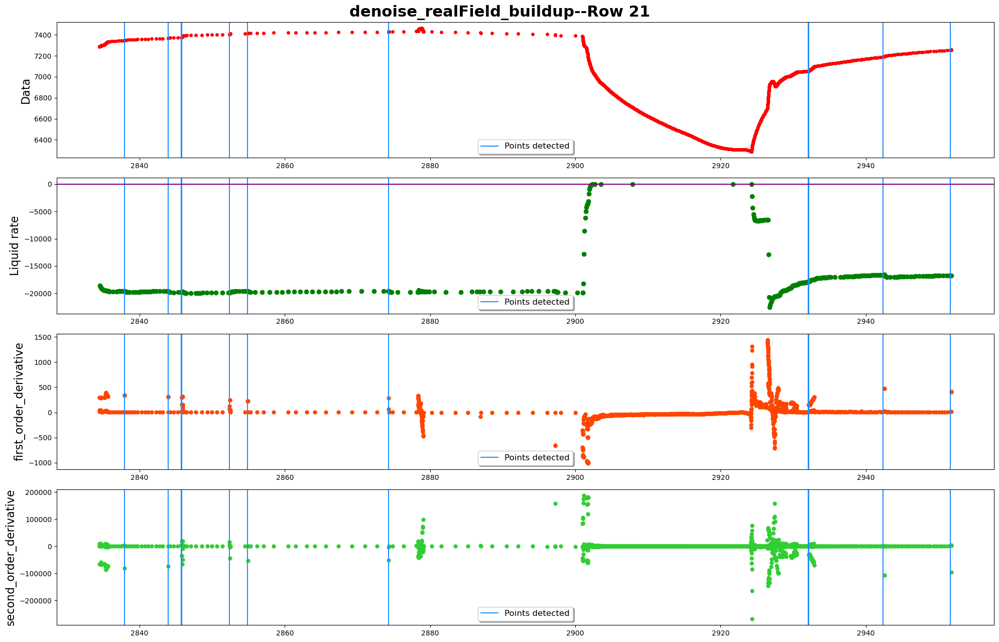

------row 22-----detected points:[25252, 25272, 25316, 25326, 25333, 25334, 25342, 25343, 25345, 25382, 25384, 25385, 25407, 25425, 25448, 25455, 25522, 25523, 25550, 25564, 25582, 25988, 25989, 25990, 25991, 25992, 25993, 25994, 26368, 26375, 26382, 26397]


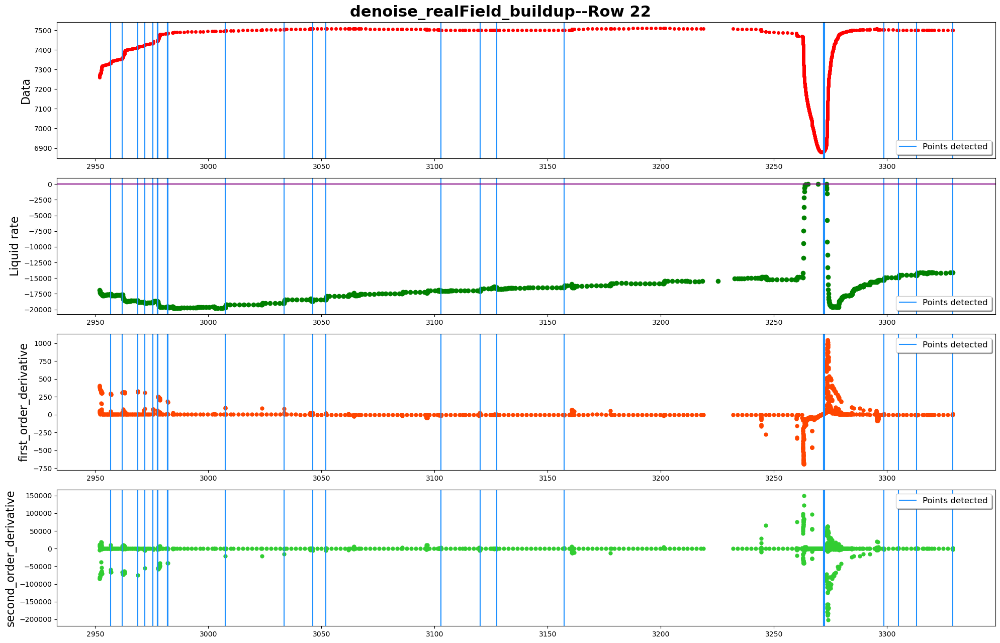

------row 23-----detected points:[26440, 26441, 26442, 26443, 26444, 26445, 26446, 26447, 26448, 26449, 26452, 26453, 26495, 26503, 26584, 26763, 26764, 26765, 26766, 26870, 26905, 27315, 27317, 27318, 27324, 27325]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 24-----detected points:[27610, 27611, 27624, 27632, 27689, 27969, 28227, 28493, 28495, 28496, 28654, 28655, 28678, 28689, 28690, 28693, 28747, 28764, 28784]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 25-----detected points:[29113, 29114, 29300, 29355, 29356, 29394, 29395, 29420, 29426, 29435, 29436, 29466, 29515, 29646, 29647, 29669, 29670, 29715, 29749, 29772]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

In [14]:
pressure_df=processed_data_denoised.pressure_df
rate_df=processed_data_denoised.rate_df
data_inOneRow=1200
filename_toSave=""
plot_name="denoise_realField_buildup"
plot_whole=True
plot_details=True
plot_statistics=False
PlotNSave(pressure_df,
          rate_df,
          buildup,
          [],
          data_inOneRow,
          plot_name,
          filename_toSave,
          plot_statistics,
          plot_whole,
          plot_details,
          colum_names)

---initializing...
---plotting...


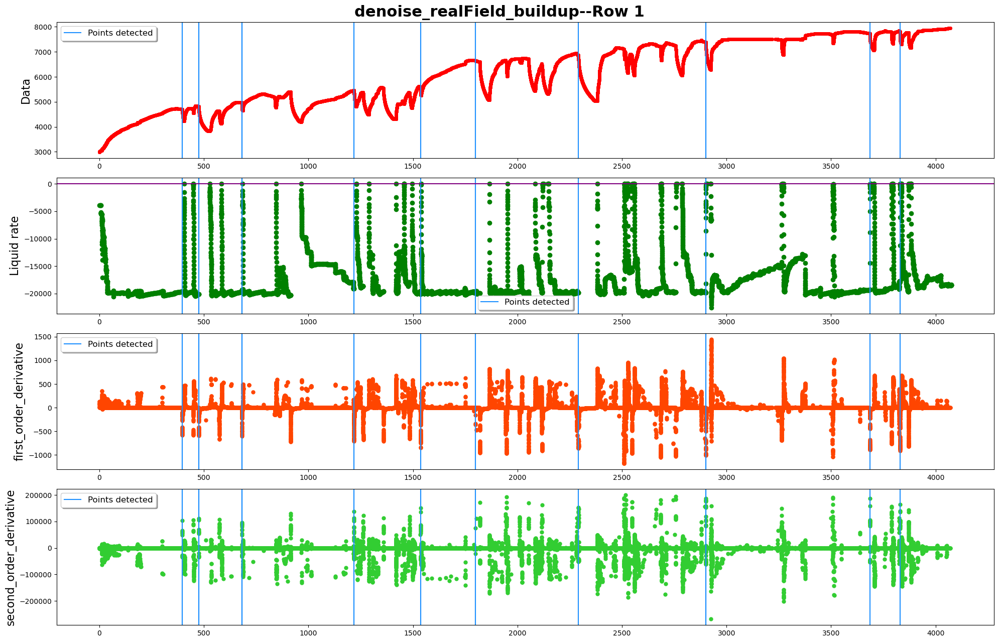

detected 21 points as breakpoints
The plot is devided into 25 rows
------row 1-----detected points:[]


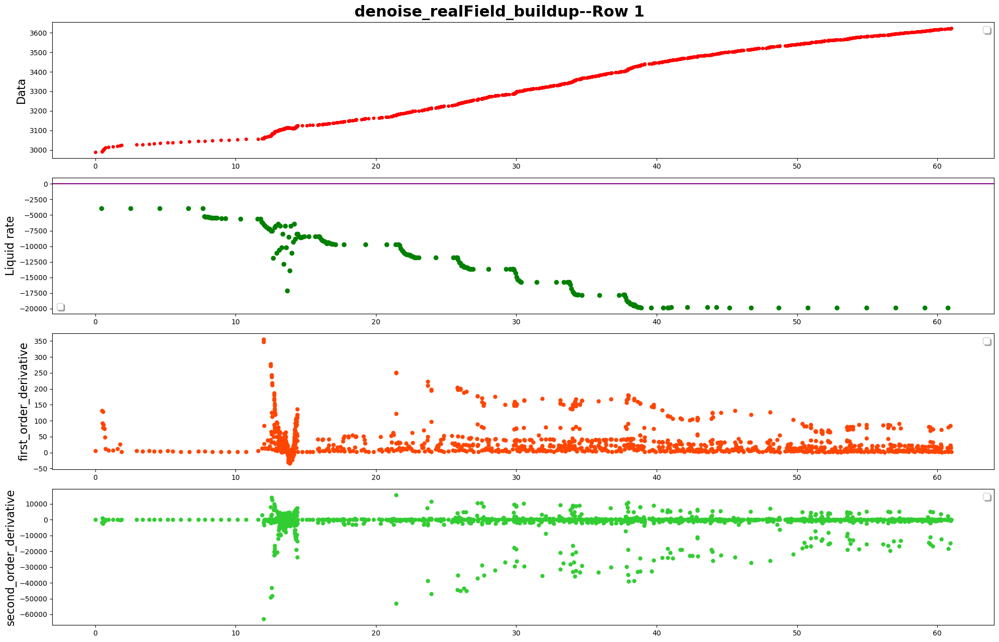

------row 2-----detected points:[2249, 2250]


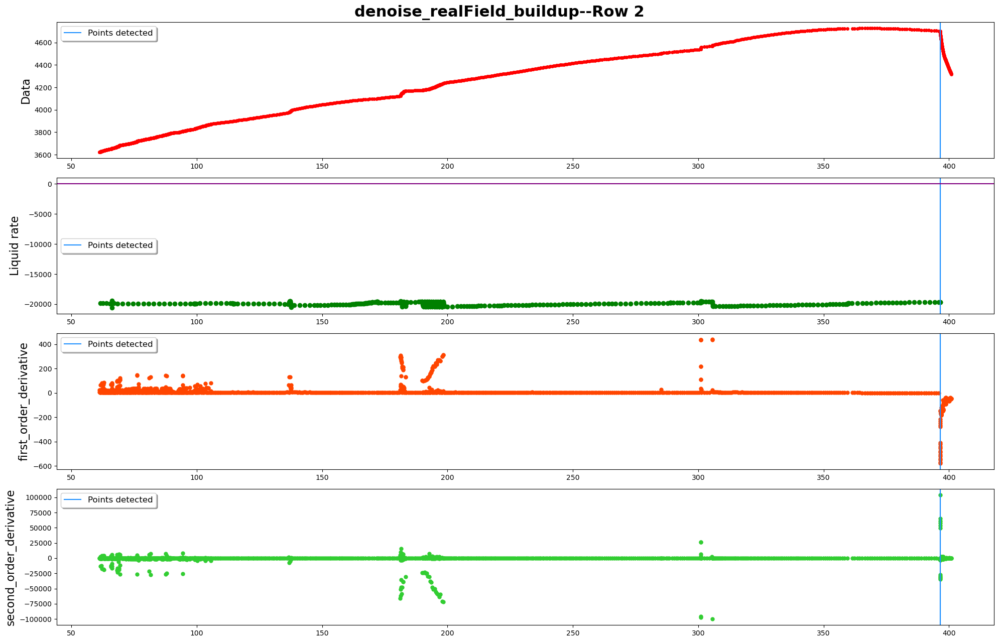

------row 3-----detected points:[3095, 3096, 3097]


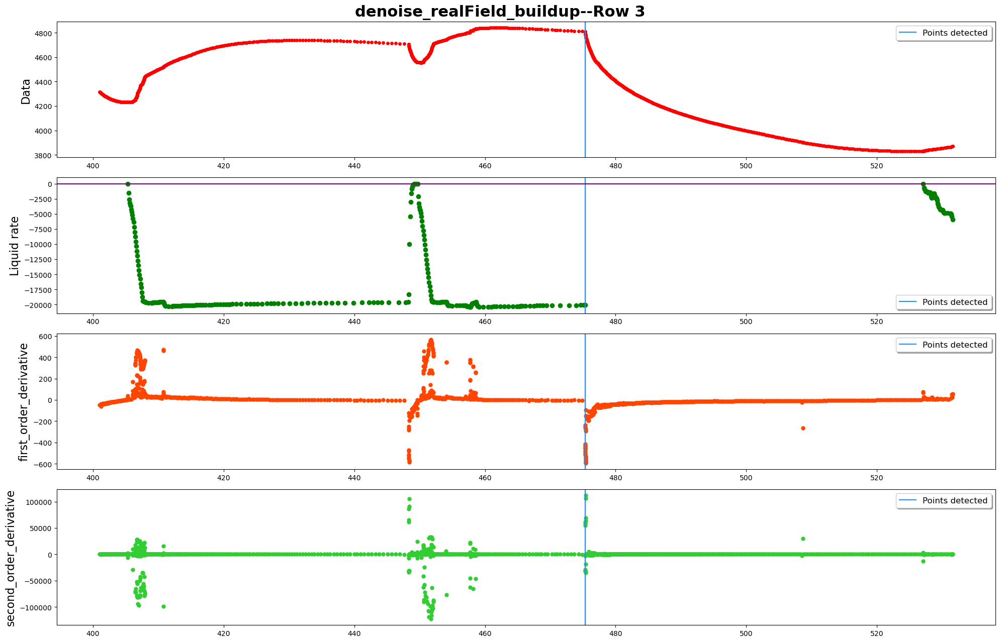

------row 4-----detected points:[4750, 4751, 4752, 4753]


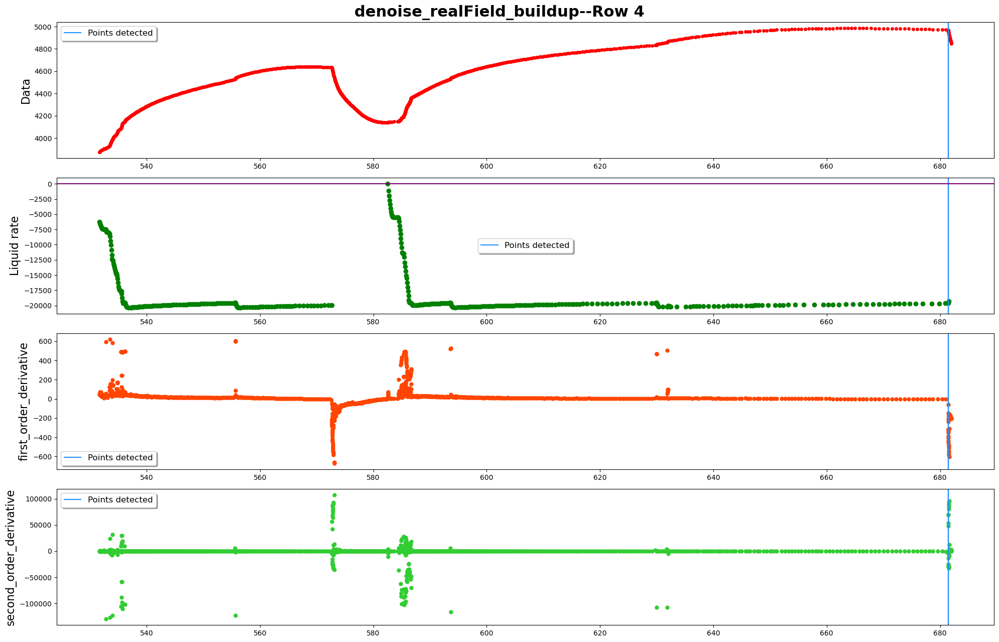

------row 5-----detected points:[]


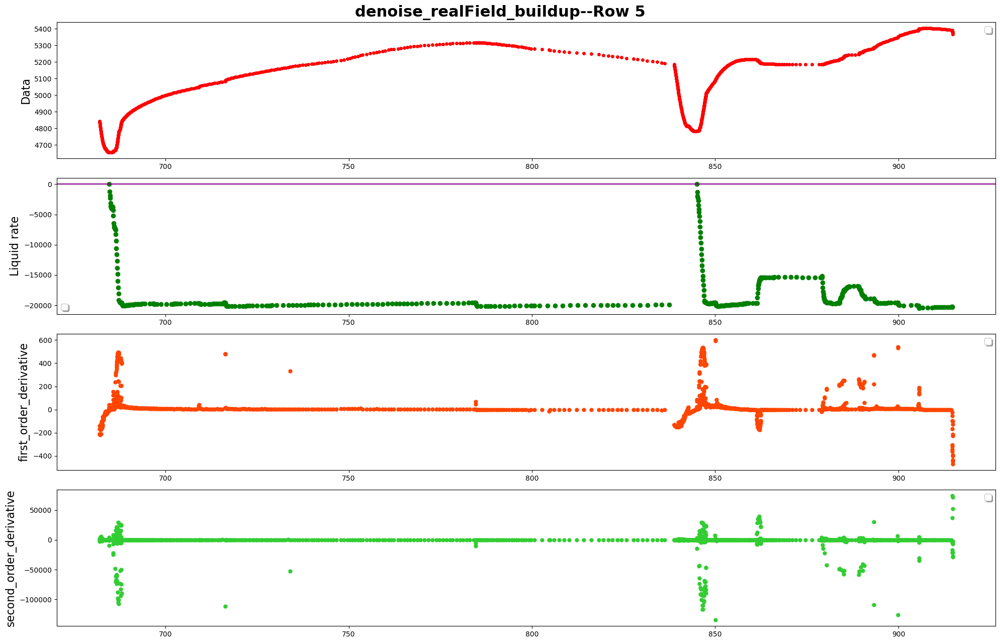

------row 6-----detected points:[]


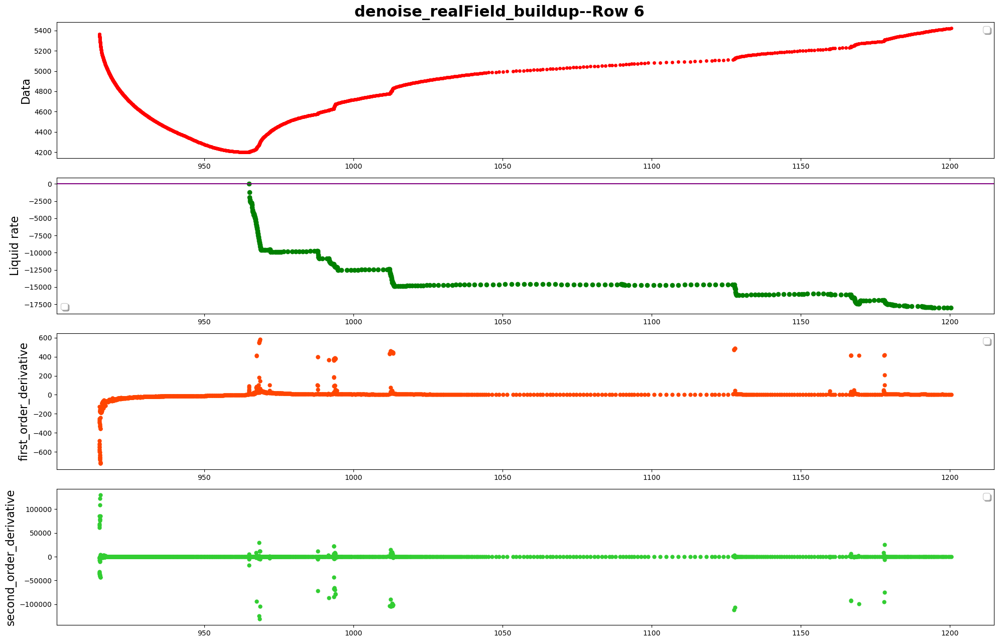

------row 7-----detected points:[7247, 7248]


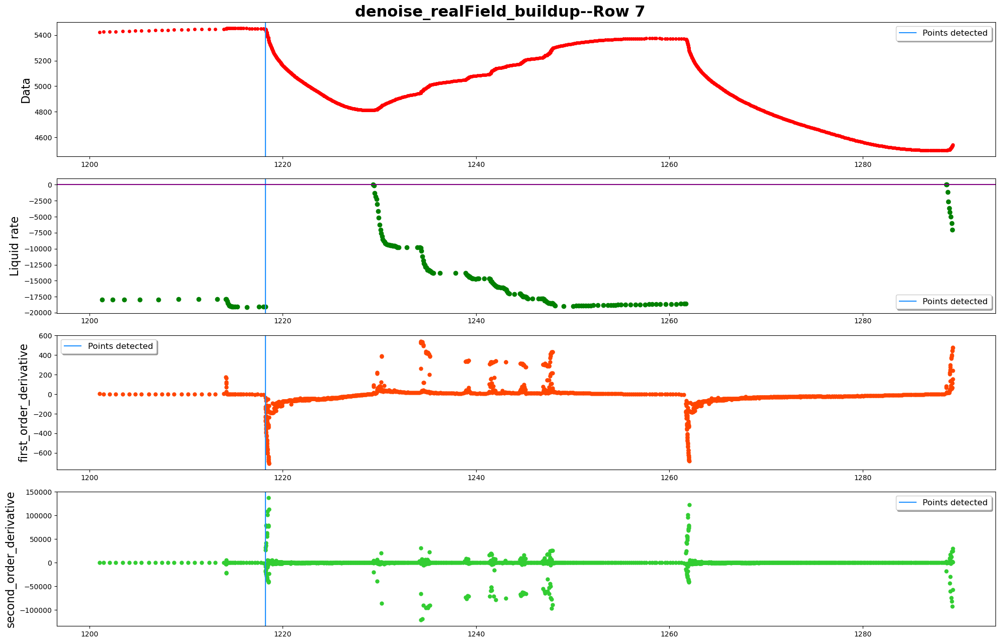

------row 8-----detected points:[]


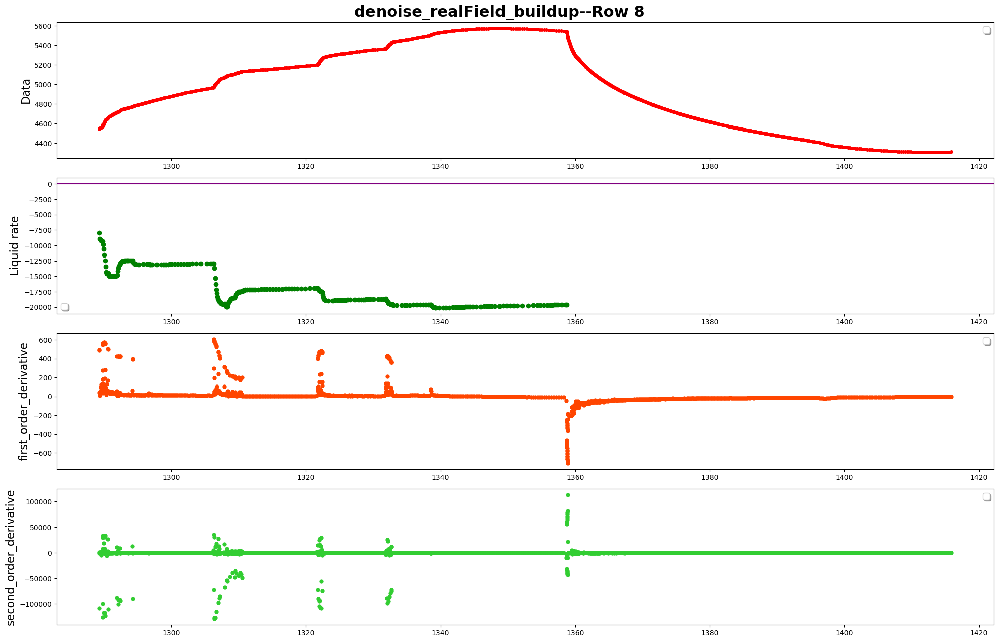

------row 9-----detected points:[]


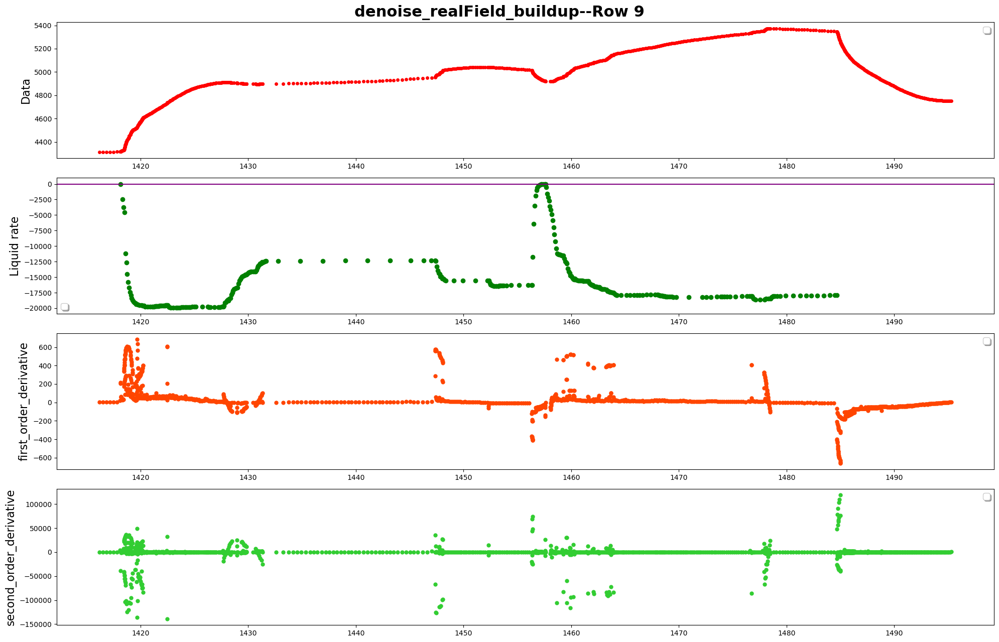

------row 10-----detected points:[11340, 11341]


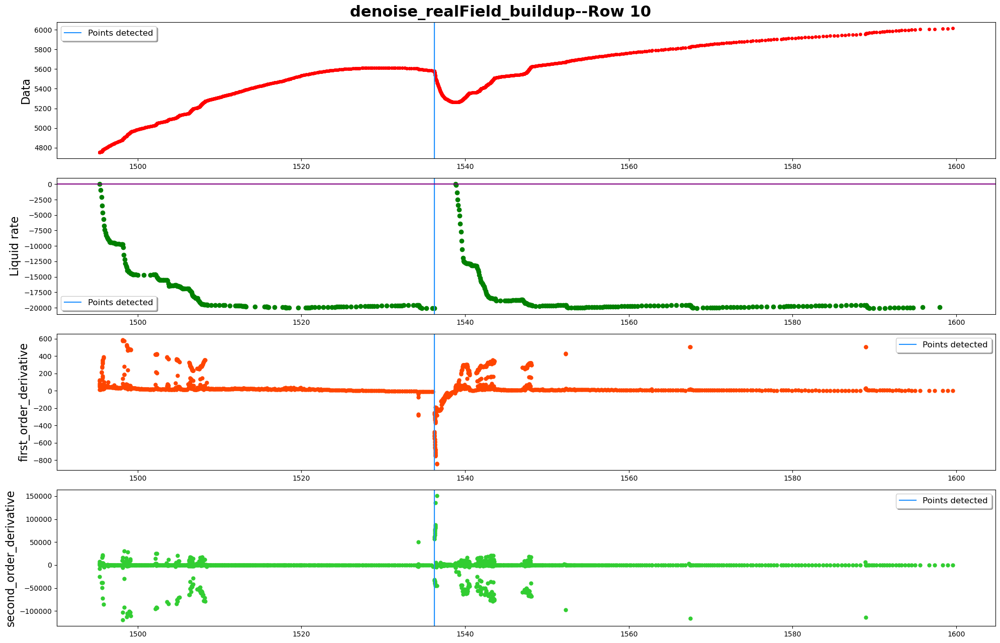

------row 11-----detected points:[12338, 12339]


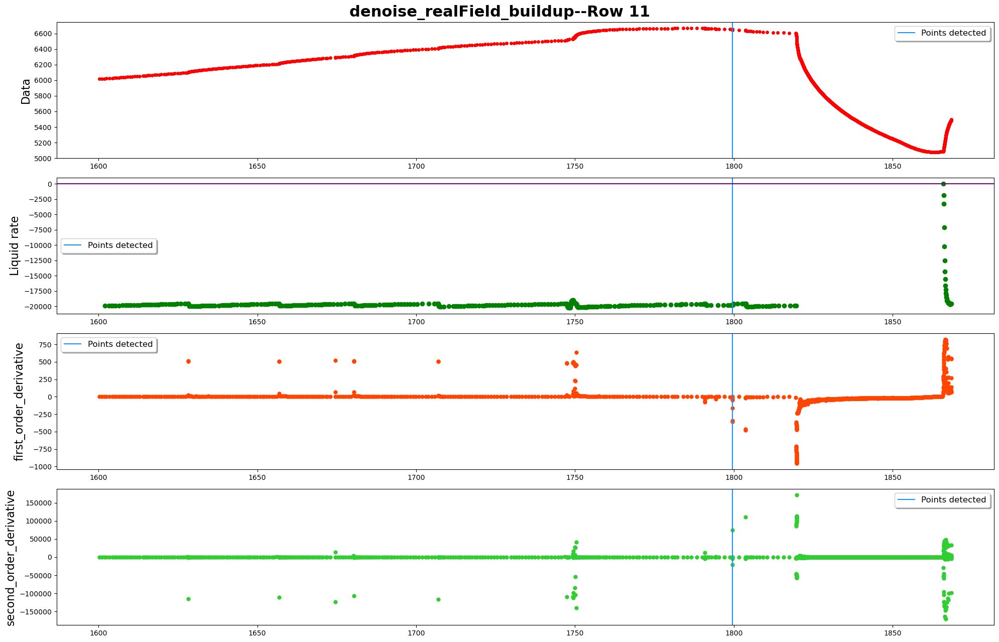

------row 12-----detected points:[]


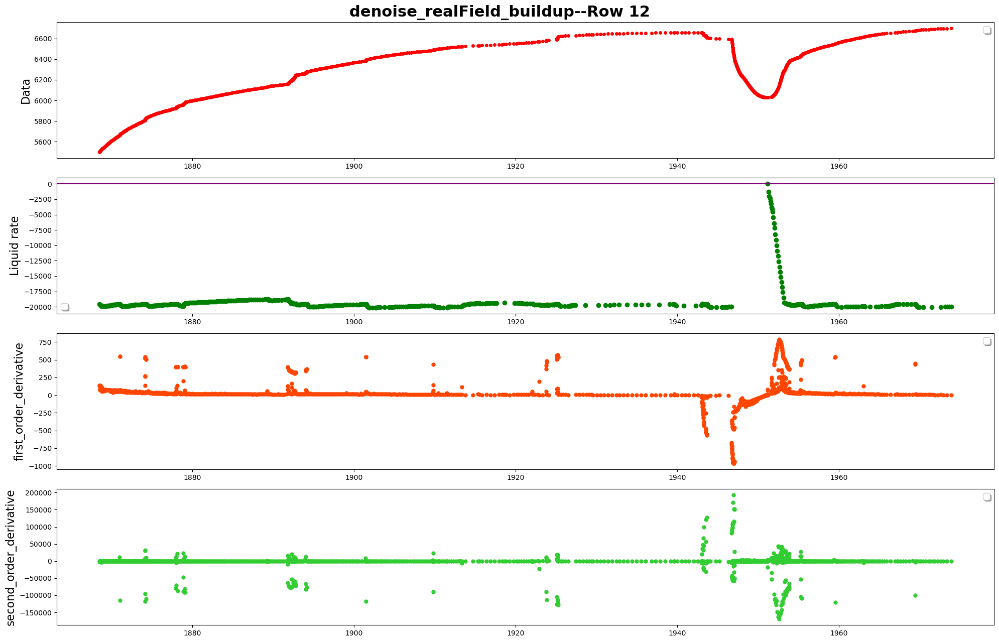

------row 13-----detected points:[]


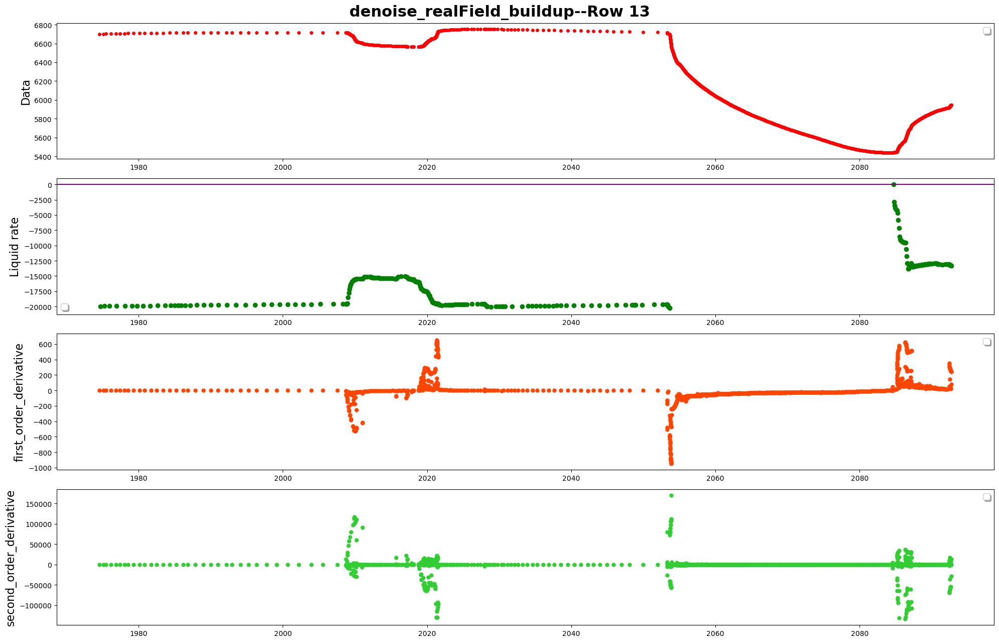

------row 14-----detected points:[]


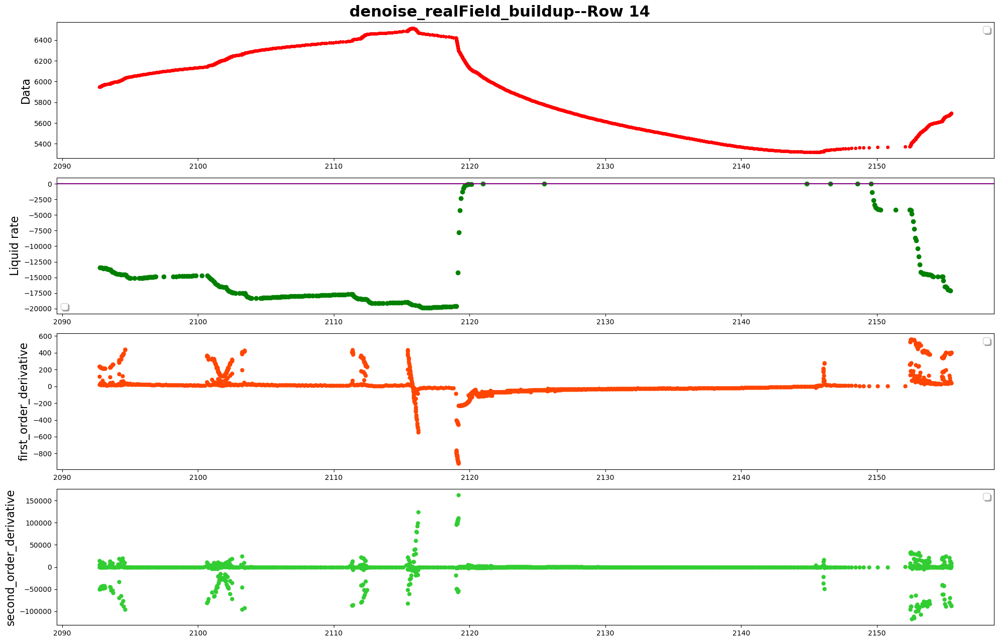

------row 15-----detected points:[17591]


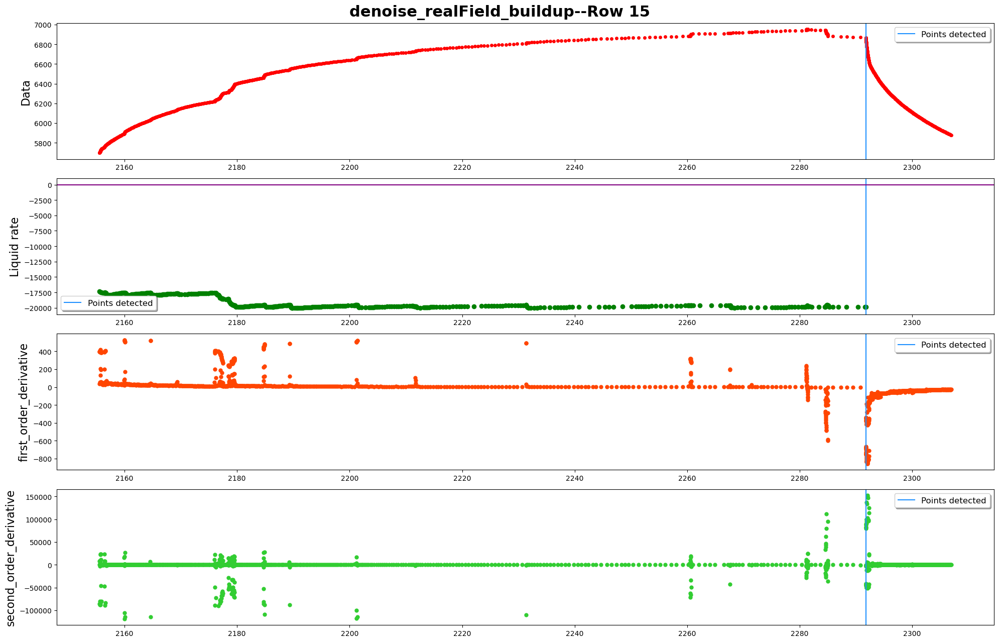

------row 16-----detected points:[]


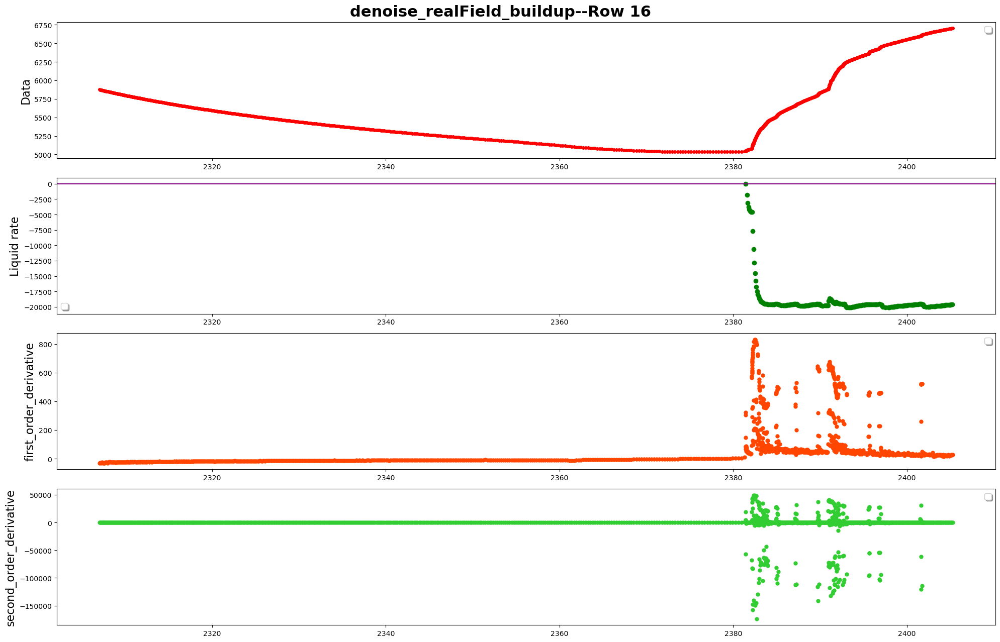

------row 17-----detected points:[]


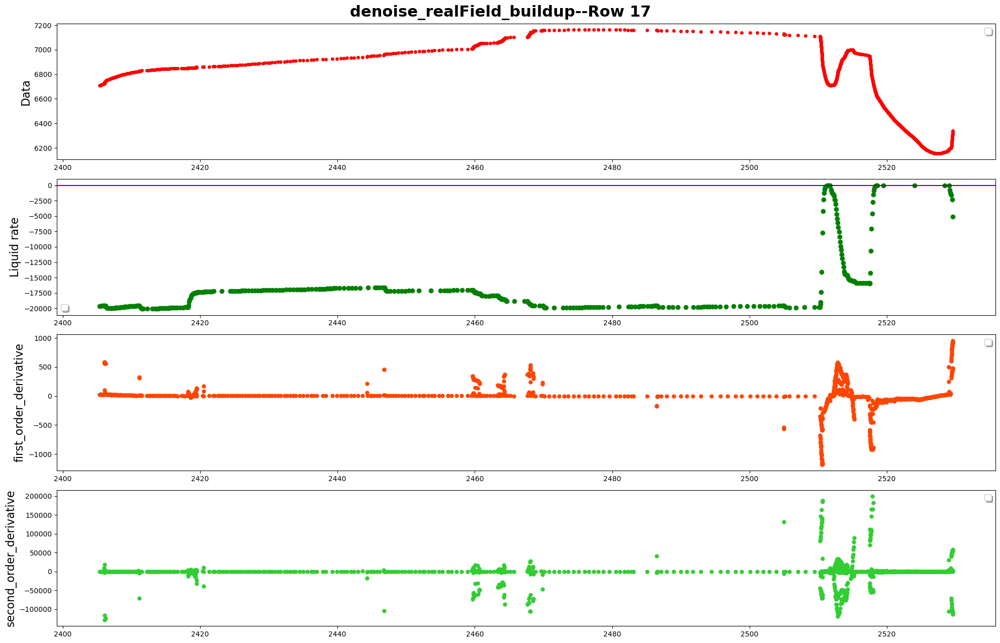

------row 18-----detected points:[]


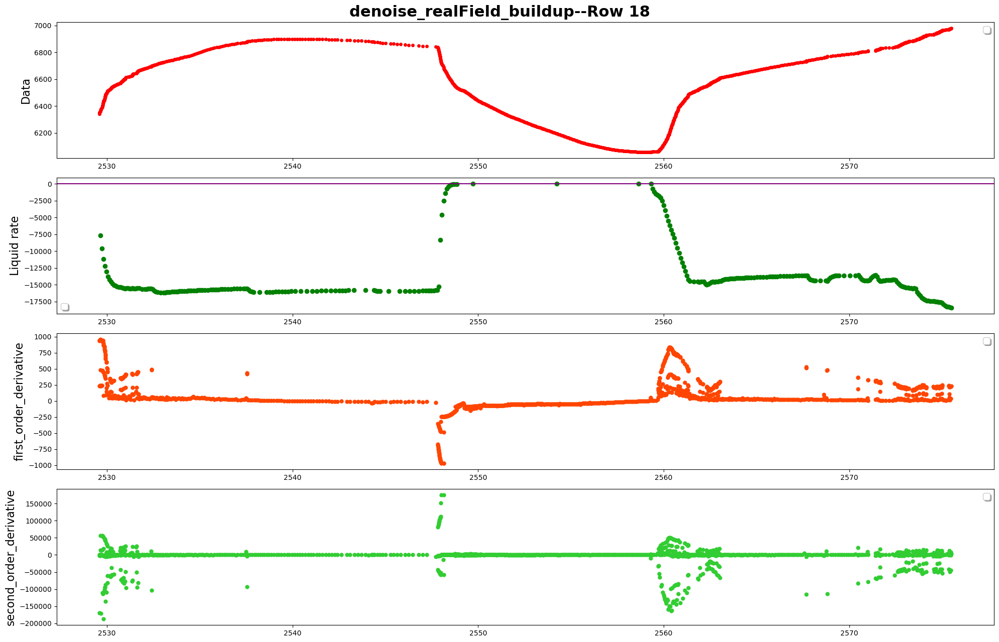

------row 19-----detected points:[]


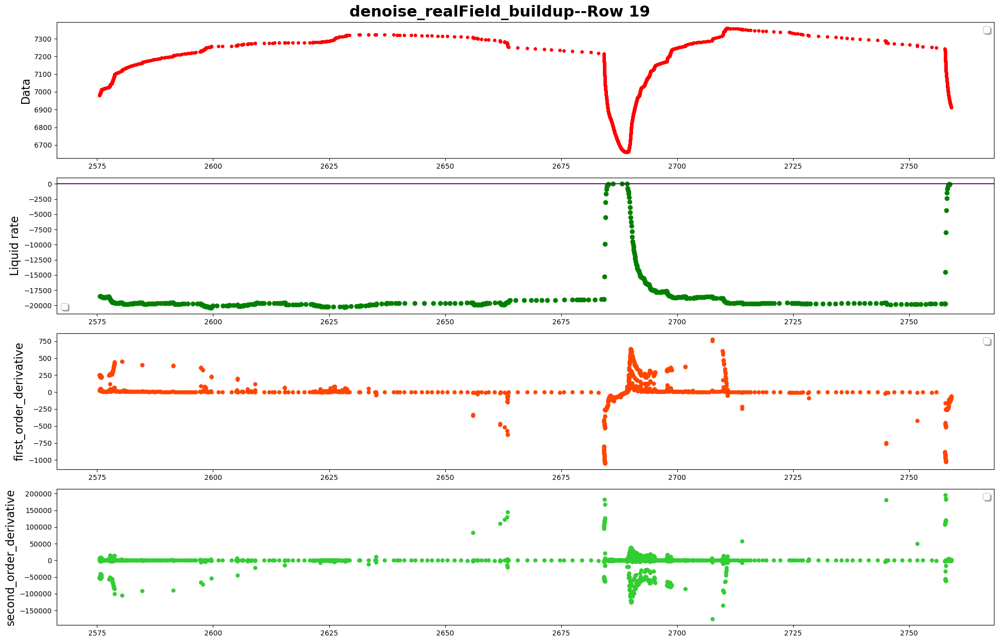

------row 20-----detected points:[]


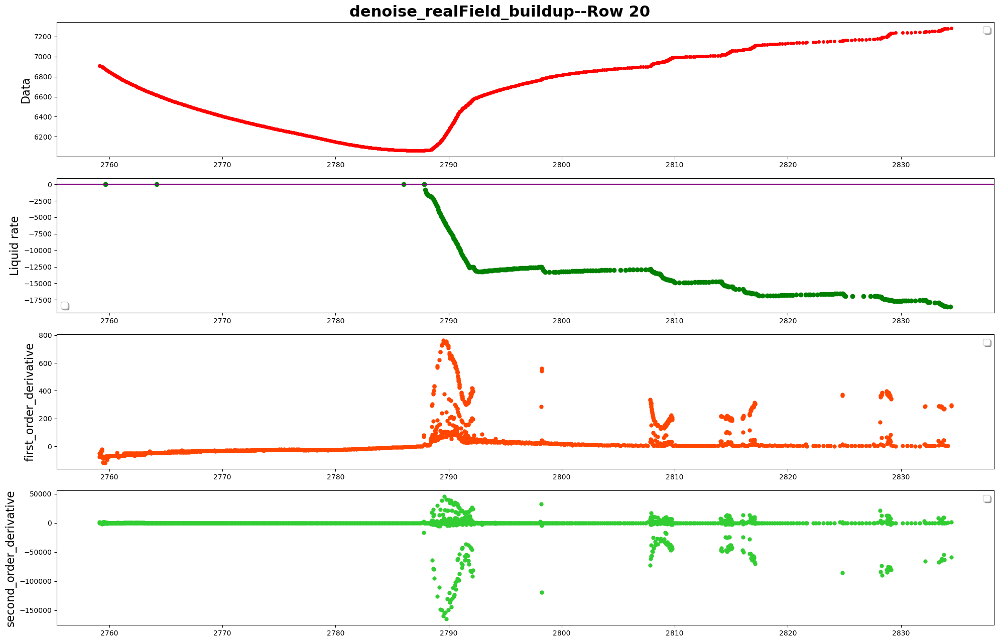

------row 21-----detected points:[24216, 24217, 24218]


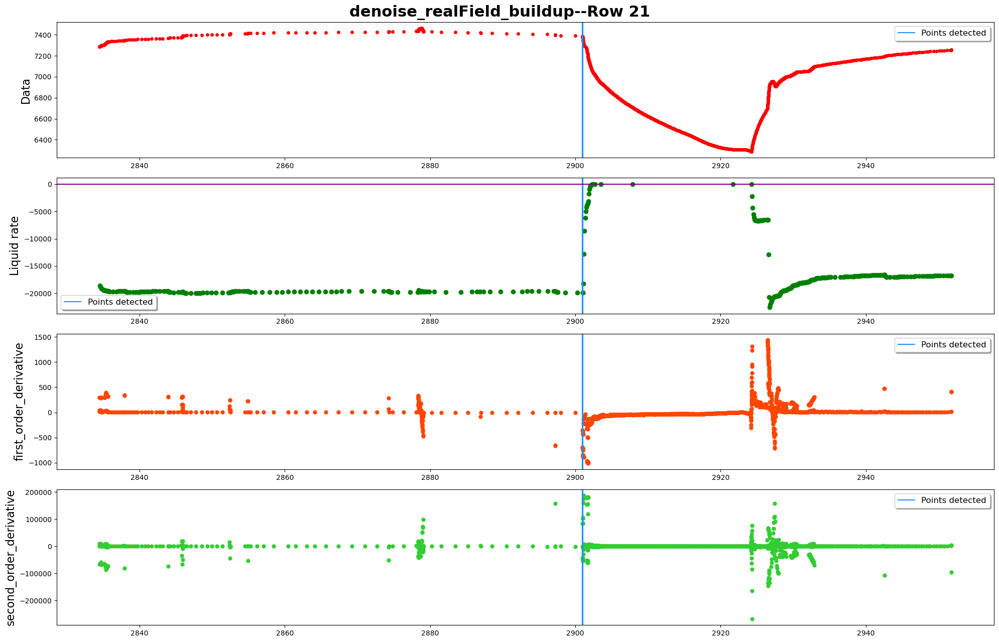

------row 22-----detected points:[]


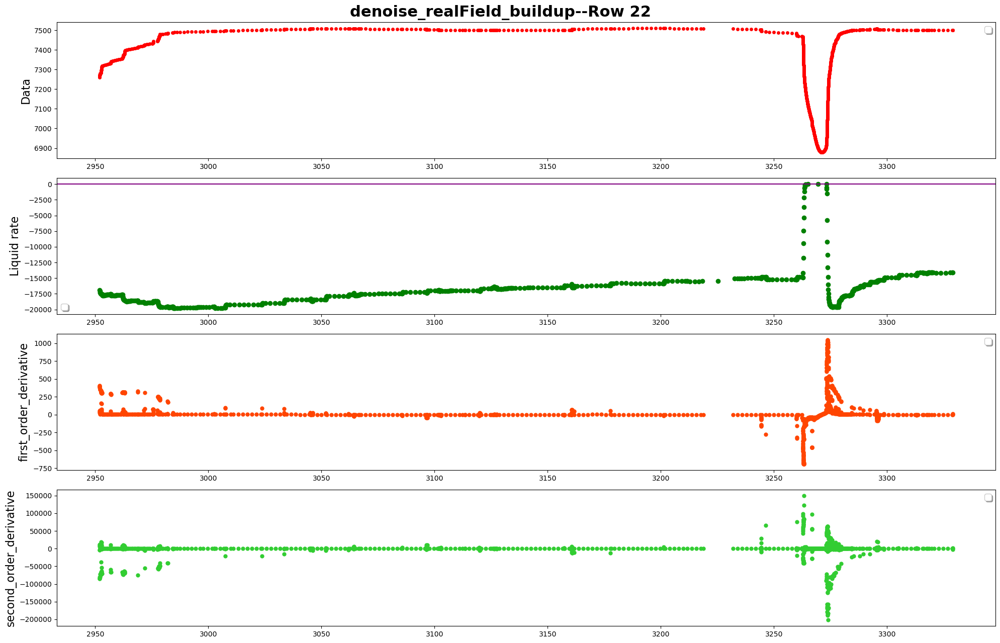

------row 23-----detected points:[27024]


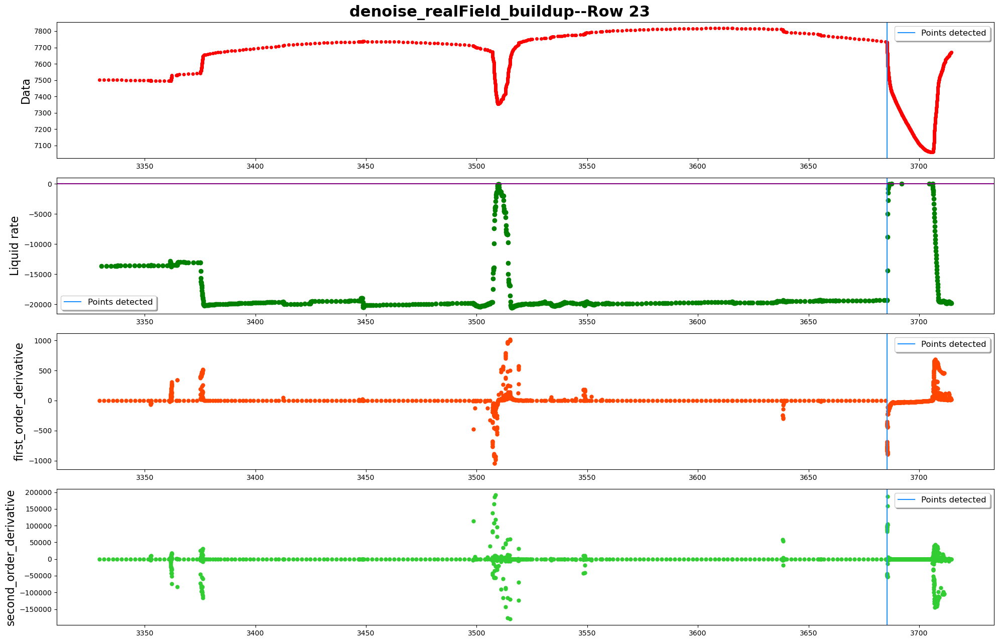

------row 24-----detected points:[28292]


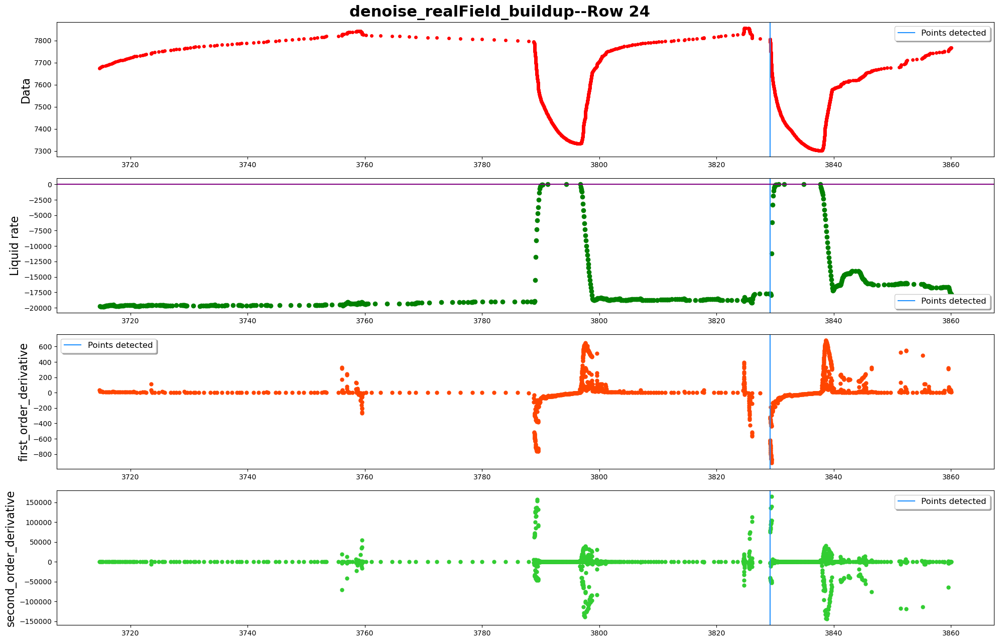

------row 25-----detected points:[]


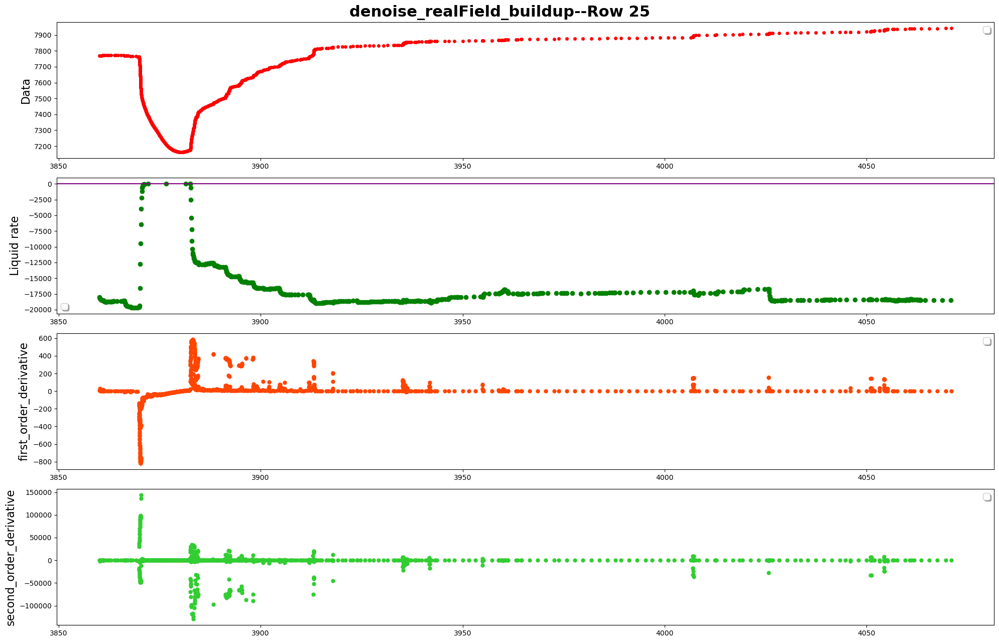

In [13]:
pressure_df=processed_data_denoised.pressure_df
rate_df=processed_data_denoised.rate_df
data_inOneRow=1200
filename_toSave=""
plot_name="denoise_realField_buildup"
plot_whole=True
plot_details=True
plot_statistics=False
PlotNSave(pressure_df,
          rate_df,
          drawdown,
          [],
          data_inOneRow,
          plot_name,
          filename_toSave,
          plot_statistics,
          plot_whole,
          plot_details,
          colum_names)

### percentile_tuning

In [3]:
#experiment setup
ground_truth_synthetic=[107, 164, 243, 328, 375, 446, 644, 713, 771, 820, 887, 953, 1036, 1101, 1179, 1254, 1319, 1396, 1456, 1513, 1598, 1648, 1719, 1784, 1875, 1938, 2017, 2073, 2185, 2247, 2315, 2369, 2433, 2487, 2552, 2610, 2835, 2916, 2965, 3044, 3101, 3240, 3284, 3368, 3411]
print(len(ground_truth_synthetic))
# colum_names ={"pressure":{"Date","Pressure (psia)","first_order_derivative","second_order_derivative"},
#                     "rate":{"Time@end","Liquid rate (STB/D)"}}

colum_names={"pressure":{"time":"Date",
                        "measure":"Pressure (psia)",
                        "first_order_derivative":"first_order_derivative",
                        "second_order_derivative":"second_order_derivative"},
             "rate":{"time":"Time@end",
                     "measure":"Liquid rate (STB/D)"}}
data_inOneRow=400
pressure_filePath="../data_input/Synthetic_Data.xlsx"
rate_filePath="../data_input/Synthetic_Data.xlsx"

processed_data=LoadNPreprocessData(pressure_filePath=pressure_filePath, 
                 rate_filePath=rate_filePath, 
                 colum_names=colum_names, 
                 use_SG_smoothing=False)
pressure_df=processed_data.pressure_df
rate_df=processed_data.rate_df

print(len(pressure_df))
print(len(rate_df))

pressure_measure_synthetic=list(pressure_df[colum_names["pressure"]["measure"]])
pressure_time_synthetic=list(pressure_df[colum_names["pressure"]["time"]])

45
---load data from 'txt' or 'xlsx' files...
---The first & second order derivative has been calculated and appended to pressure dataframe
3519
95


In [7]:
#experiment setup
ground_truth_temp=[2249,  2467,  2805,[2875, 2876],3100,3561,3994,[4228, 4232],4753,4895, 5297,5436,5985,[6543, 6547], 7249,[7544, 7545],7946,[8362, 8364],9025,[9607, 9608],10149,10216, 10528,[10801, 10804],11340,  11479,12363,[13039, 13040],13868, 14086,14774,15341,16098,16619,[17589, 17590],18435,19643,19764,20021,20349,20701,21030,21974,22186,22710,23220,24215,24685,25717,26006,26656, 26759,27023,[27316,27327],27773,[27966,27970],28322,28497,28832,29115]
# ground_truth=[]

colum_names   ={"pressure":{"time":"Elapsed time",
                             "measure":"Data",
                             "first_order_derivative":"first_order_derivative",
                             "second_order_derivative":"second_order_derivative"},
                "rate":{"time":"Elapsed time",
                        "measure":"Liquid rate"}}
data_inOneRow=1000
pressure_filePath="../data_input/EAGE_Shchipanov_2017/Pressure.txt"
rate_filePath="../data_input/EAGE_Shchipanov_2017/Rate.txt"
ground_truth=[]
for point in ground_truth_temp: 
    if "list" in str(type(point)):
        ground_truth.append(math.ceil(sum(point)/len(point)))
    else:
        ground_truth.append(point)
                     
print("len(ground_truth):",len(ground_truth))
# print(ground_truth)

processed_data_denoised=LoadNPreprocessData(pressure_filePath=pressure_filePath, 
                 rate_filePath=rate_filePath, 
                 colum_names=colum_names, 
                 use_SG_smoothing=True)
pressure_df_denoised=processed_data_denoised.pressure_df
pressure_df=pressure_df_denoised
pressure_measure_denoised=list(pressure_df[colum_names["pressure"]["measure"]])
print("len(pressure_measure_denoised)",len(pressure_measure_denoised))
pressure_time_denoised=list(pressure_df[colum_names["pressure"]["time"]])
# ground truth adapted for denoise data
denoised_ground_truth=[2248, 2467, 2804, 2884, 3095, 3560, 3987, 4246, 4750, 4899, 5297, 5436, 5983, 6543, 7249, 7545, 7946, 8361, 9024, 9619, 10149, 10224, 10527, 10800, 11340,11490, 12362, 13040, 13867, 14089, 14766, 15348, 16097, 16619, 17589, 18434, 19642, 19777, 20014, 20358, 20700, 21025, 21974, 22183, 22709, 23219, 24215, 24683, 25698, 26011, 26656, 26753, 27022, 27315, 27760, 27969, 28322, 28494, 28831, 29115]
print("len(denoised_ground_truth)",len(denoised_ground_truth))
denoised_ground_truth.remove(9024)
denoised_ground_truth.remove(10800)
denoised_ground_truth.remove(2467)
denoised_ground_truth.remove(10224)
denoised_ground_truth.remove(21025)
denoised_ground_truth.remove(26753)
print("len(denoised_ground_truth)",len(denoised_ground_truth))

len(ground_truth): 60
---load data from 'txt' or 'xlsx' files...
check the time type
---denoising data using S-G smoothing...
---The first & second order derivative has been calculated and appended to pressure dataframe
len(pressure_measure_denoised) 29813
len(denoised_ground_truth) 60
len(denoised_ground_truth) 54


In [20]:
def point_dt_to_pressure(point_index:int,
                               pressure_df, 
                               delta_t:float=1/12,
                               colum_names:Dict={"pressure":{"time":"Date",
                                "measure":"Pressure (psia)",
                                "first_order_derivative":"first_order_derivative",
                                "second_order_derivative":"second_order_derivative"},
                                 "rate":{"time":"Time@end",
                                         "measure":"Liquid rate (STB/D)"}})->List[float]:
    """
    Args:
        delta_t:hour
    """
    pressure_time=pressure_df[colum_names["pressure"]["time"]]
    start_time=pressure_time.iloc[point_index]
    end_time=start_time+delta_t
    if end_time>start_time:   
        sub_pressure_df=pressure_df.loc[(pressure_time >= start_time) & (pressure_time <= end_time)]
        return sub_pressure_df[colum_names["pressure"]["measure"]]
    
    sub_pressure_df=pressure_df.loc[(pressure_time >= end_time) & (pressure_time <= start_time)]
    display(sub_pressure_df)
    return sub_pressure_df[colum_names["pressure"]["measure"]]

point_index=8361
delta_t=0.5
point_dt_to_pressure(point_index,
                               pressure_df_denoised, 
                               delta_t,
                               colum_names)



8361    4498.175881
8362    4498.464207
8363    4498.802596
8364    4499.190357
8365    4499.626454
8366    4500.112398
8367    4500.645766
8368    4501.227239
8369    4501.857689
8370    4502.537497
8371    4503.262750
8372    4504.035232
8373    4504.853392
8374    4505.719969
8375    4506.632765
8376    4507.592124
8377    4508.597022
8378    4509.647123
8379    4510.742289
8380    4511.907289
8381    4513.148196
8382    4514.465905
8383    4515.841779
Name: Data, dtype: float64

In [27]:
point_index=8361
delta_t=-0.5
sub=point_dt_to_pressure(point_index,
                               pressure_df_denoised, 
                               delta_t,
                               colum_names)


,Elapsed time,Data,first_order_derivative,second_order_derivative
8359,1288.281293,4497.746079,1.139615,1.195083
8360,1288.447960,4497.936015,1.338795,378.720163
8361,1288.627126,4498.175881,69.192572,2883.209224


In [30]:
np.asarray(sub)-4498.17588149

array([-4.29802755e-01, -2.39866625e-01, -2.35922926e-09])

In [23]:
data_plotPoint["pressure_measure_left"]

8360    [-0.429803, -0.239867, 0.0]
Name: pressure_measure_left, dtype: object

In [22]:
point_index=8361
data_plotPoint=identfication_UsePattern.data_forPredict.loc[identfication_UsePattern.data_forPredict['point_index'] == point_index]
data_plotPoint

,point_index,pressure_time_left,pressure_measure_left,pressure_time_right,pressure_measure_right,buildUp,drawDown
8360,8361,"[-0.345833, -0.179166, 0.0]","[-0.429803, -0.239867, 0.0]","[0.1375, 0.104167, 0.075, 0.054167, 0.008334, ...","[2.469884, 1.936517, 1.450572, 1.014476, 0.626...","{'left_top': [0.2723984887189634, 1.1928494842...","{'left_top': [3.3443872111413917, 2.4640970169..."


detect_breakpoint.....
---------------calculate_Parameters_allCurve linear
--------------self.buildUp_or_drawDown 
point '28322' is going to be classified as buildup,
however the ground truth should be drawdown,
there must be a bump in window thus should not be included into breakpoints for learning
------In the input ground truth: 25 points are detected as buildup, 28 points are detected as drawDown
start to learn 'buildUp' pattern...
---------------calculate_Parameters_allCurve polynomial


C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:320: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:320: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:320: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:320: RankWarning: Polyfit may be poor

--------------self.buildUp_or_drawDown buildUp
start to learn 'drawDown' pattern...
---------------calculate_Parameters_allCurve polynomial


C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:320: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:320: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:320: RankWarning: Polyfit may be poorly conditioned
  curveLeft_parameters.append(self.fit_curve(xdata,ydata,color,fitting_type,plot_title))
C:\Users\junec\OneDrive\Documents\cs\master_project\source_codes\venv\Scripts\transients_detection\source_code\pattern_recognition3.py:320: RankWarning: Polyfit may be poor

--------------self.buildUp_or_drawDown drawDown
-----start to calculate'buildUp' pattern parameter, there are 25 for calculation
-----start to calculate'drawDown' pattern parameter, there are 28 for calculation


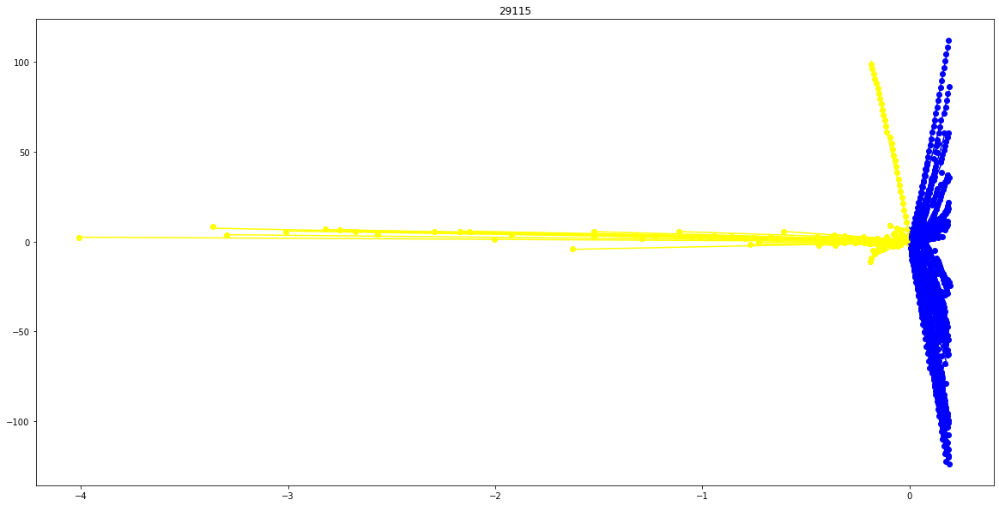

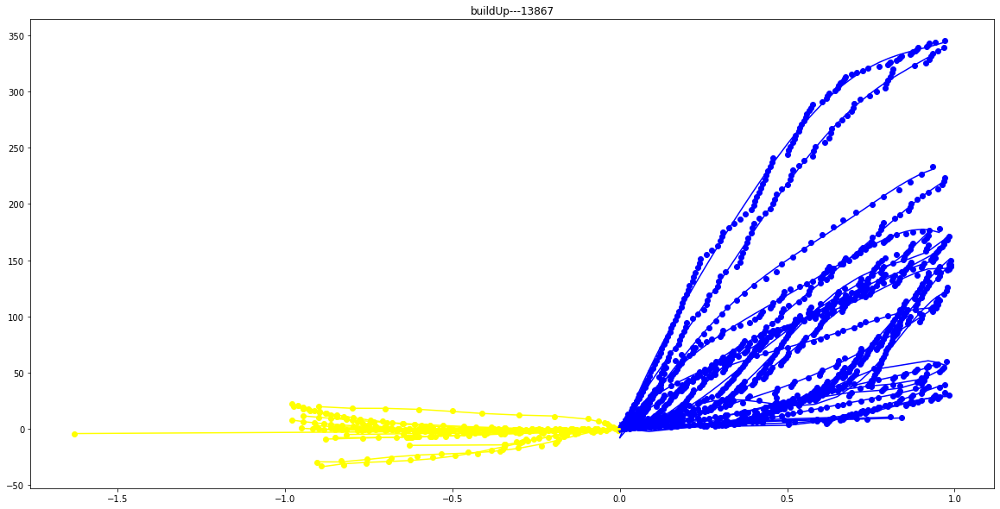

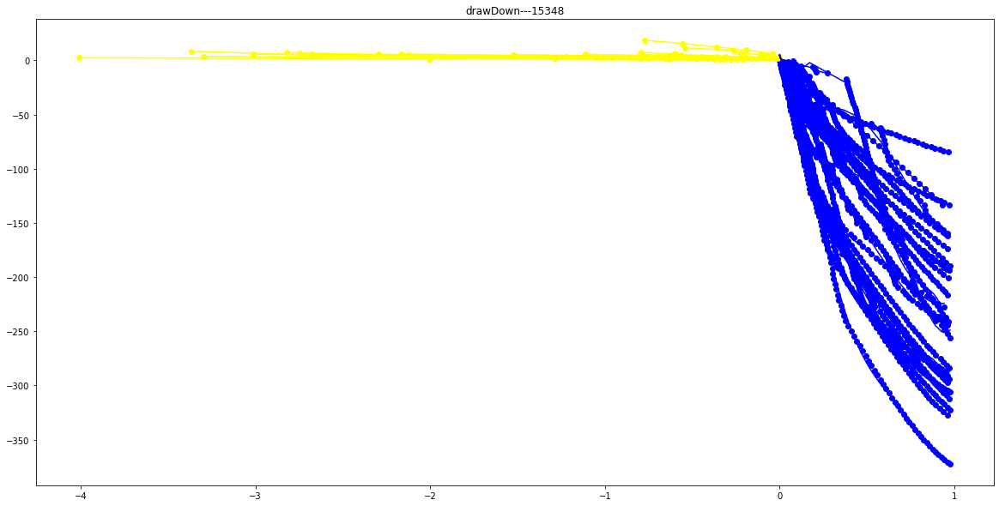

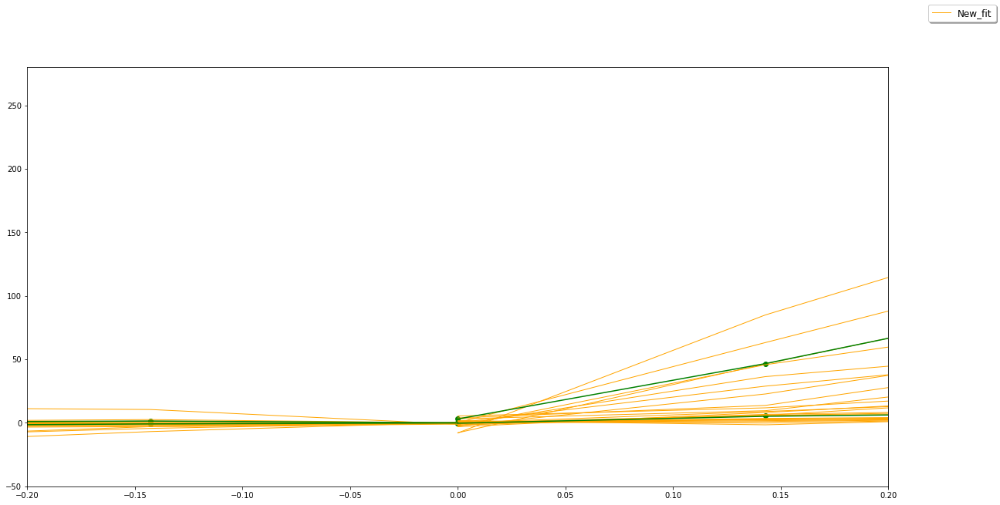

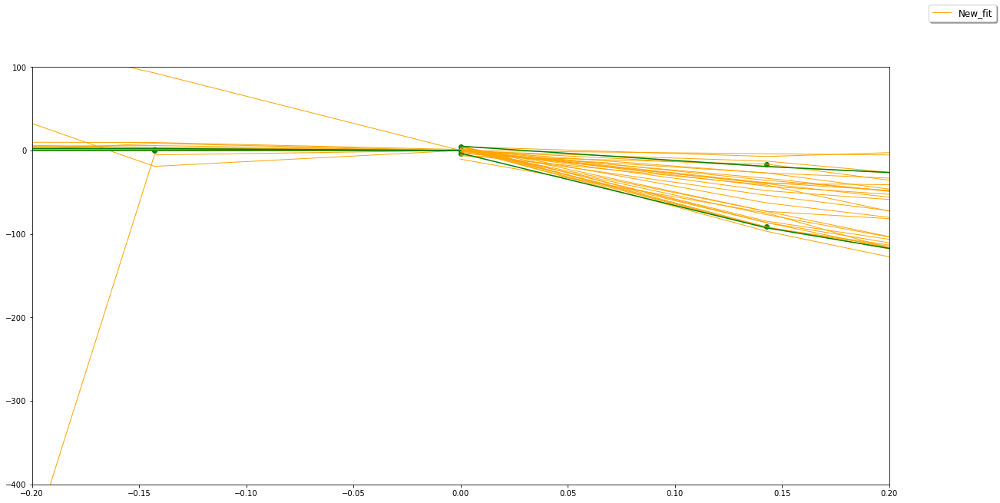

In [4]:
percentile_tuning={
                                    "buildUp":{"left":[90,30],
                                              "right":[90,35]},
                                   "drawDown":{"left":[80,10],
                                              "right":[90,10]}
                                   }

fine_tuning={
                                    "buildUp":{"left":[1,1],
                                              "right":[1,1]},
                                   "drawDown":{"left":[1,1],
                                              "right":[1,1]}
                                   }

# fine_tuning={
#                                     "buildUp":{"left":[6.21832,40.28088],
#                                               "right":[1.79206,0.99429]},
#                                    "drawDown":{"left":[53.57961,0.54649],
#                                               "right":[0.99082,1.13197]}
#                                    }

identfication_UsePattern=PatternRecognition(time_halfWindow=0.2,time_halfWindow_forLearn=1,percentile_tuning=percentile_tuning,fine_tuning=fine_tuning)
identfication_UsePattern.learn(pressure_measure_denoised,pressure_time_denoised,denoised_ground_truth,fitting_type="polynomial")
# identfication_UsePattern.learn(pressure_measure_synthetic,pressure_time_synthetic,ground_truth_synthetic,fitting_type="polynomial")
identfication_UsePattern.get_pattern(fitting_type="polynomial")

In [14]:
buildup,drawdown=identfication_UsePattern.predict(pressure_measure_denoised,pressure_time_denoised)
print(len(buildup),len(drawdown))
# buildup,drawdown

683 1780


In [11]:
identfication_UsePattern.tuning()

----self.for_tuning {'buildUp': {'left_top': [6.21832, 5.75415, 5.38266, 4.63753, 3.58288, 2.65509, 2.06792, 1.20817, 6.21832, 5.75415, 5.38266, 4.63753, 3.58288, 2.65509, 2.06792, 1.20817], 'left_bottom': [1.69076, 5.09444, 5.06388, 4.98659, 6.18525, 13.83601, -3268.79426, 2.80461, 16.04556, 2.1509, 8.02727, -0.01588, 2.42831, 1.94626, -12.74317, 1.52417, 3.96161, 40.28088, 1.24974, 15.06992, 14.54237, 2.72074, 8.14738, 6.8534, 6.13238, 6.36623, 10.36493, 4.00482, 10.29865, 19.62321, 1.69076, 5.09444, 5.06388, 4.98659, 6.18525, 13.83601, -3268.79426, 2.80461, 16.04556, 2.1509, 8.02727, -0.01588, 2.42831, 1.94626, -12.74317, 1.52417, 3.96161, 40.28088, 1.24974, 15.06992, 14.54237, 2.72074, 8.14738, 6.8534, 6.13238, 6.36623, 10.36493, 4.00482, 10.29865, 19.62321], 'right_top': [1.04494, 1.02948, 1.01233, 1.03565, 1.0161, 1.0218, 1.00121, 1.01075, 1.00275, 1.02291, 1.78394, 1.7656, 1.79206, 1.77332, 1.75395, 1.78428, 1.7644, 1.74364, 1.77843, 1.75695, 1.73455, 1.77463, 1.75102, 1.72608, 

In [12]:
identfication_UsePattern.data_forPredict

,point_index,pressure_time_left,pressure_measure_left,pressure_time_right,pressure_measure_right,buildUp,drawDown
0,1,[],[],"[0.133333, 0.104167, 0.070833, 0.05, 0.020833,...","[13.308089, 10.736486, 8.120259, 5.459024, 2.7...","{'left_top': [], 'left_bottom': [], 'right_top...","{'left_top': [], 'left_bottom': [], 'right_top..."
1,2,"[-0.516667, -0.020833, 0.0]","[-5.550955, -2.752399, 0.0]","[0.145833, 0.1125, 0.083333, 0.05, 0.029167, 0.0]","[13.083052, 10.55569, 7.984087, 5.36786, 2.706...","{'left_top': [1.5481141538937635, 0.6078262064...","{'left_top': [4.741598213266408, 0.47863053941..."
2,3,"[-0.05, -0.029167, 0.0]","[-5.459024, -2.706625, 0.0]","[0.116667, 0.083333, 0.054167, 0.020833, 0.0]","[10.376427, 7.849065, 5.277462, 2.661235, 0.0]","{'left_top': [1.1284442228545464, 0.7860282427...","{'left_top': [1.0804068106401226, 0.6666797066..."
3,4,"[-0.05, -0.020833, 0.0]","[-5.36786, -2.661235, 0.0]","[0.129167, 0.095833, 0.0625, 0.033333, 0.0]","[10.198695, 7.715192, 5.18783, 2.616227, 0.0]","{'left_top': [1.1284442228545464, 0.6078262064...","{'left_top': [1.0804068106401226, 0.4786305394..."
4,5,"[-0.083333, -0.054167, -0.033333, 0.0]","[-7.984087, -5.277462, -2.616227, 0.0]","[0.095833, 0.0625, 0.029167, 0.0]","[7.582468, 5.098965, 2.571603, 0.0]","{'left_top': [1.4201096172895458, 1.1808535394...","{'left_top': [1.6000255041692808, 1.1542955050..."
...,...,...,...,...,...,...,...
29806,29807,"[-1.2, -0.633333, 0.0]","[-0.949224, -0.471846, 0.0]","[3.720833, 1.716667, 0.0]","[0.926722, 0.46622, 0.0]","{'left_top': [59.39634235441829, 4.05036060089...","{'left_top': [15.135519903248545, 5.9534948487..."
29807,29808,"[-2.35, -1.716667, 0.0]","[-0.938066, -0.46622, 0.0]","[4.008333, 2.004166, 0.0]","[0.915192, 0.460502, 0.0]","{'left_top': [4147.703700588001, 548.959545989...","{'left_top': [1516.3065371438695, 161.15558821..."
29808,29809,"[-3.720833, -2.004166, 0.0]","[-0.926722, -0.460502, 0.0]","[4.008334, 2.004167, 0.0]","[0.903476, 0.45469, 0.0]","{'left_top': [66389.9561163838, 1503.135860077...","{'left_top': [27673.4204561548, 501.2301440856..."
29809,29810,"[-4.008333, -2.004167, 0.0]","[-0.915192, -0.45469, 0.0]","[3.445833, 2.004167, 0.0]","[0.891573, 0.448785, 0.0]","{'left_top': [102015.53887549878, 1503.1407022...","{'left_top': [43004.604599713224, 501.23193291..."


In [13]:
def tuning(identfication_UsePattern):
    groundTruth_buildUp,groundTruth_drawDown=identfication_UsePattern.breakpoints_forLearn.values()
    detected_buildUp,detected_drawDown=identfication_UsePattern.detectedpoints.values()
    buildUp_notDetected=[buildUp for buildUp in groundTruth_buildUp if buildUp not in detected_buildUp]
    drawDown_notDetected=[drawDown for drawDown in groundTruth_drawDown if drawDown not in detected_drawDown]

    for point_index in buildUp_notDetected:
        identfication_UsePattern.calculate_tuningParameters(point_index,"buildUp")

    for point_index in drawDown_notDetected:
        identfication_UsePattern.calculate_tuningParameters(point_index,"drawDown")
    print("----self.for_tuning",identfication_UsePattern.for_tuning)
    for pattern_name, border_tuning_parameters in identfication_UsePattern.for_tuning.items():
        for border_name, tuning_parameters in border_tuning_parameters.items():
            identfication_UsePattern.tuning_max[pattern_name][border_name]=max(tuning_parameters)

    print("----self.tuning_max",identfication_UsePattern.tuning_max)
    
tuning(identfication_UsePattern)

IndexError: list index out of range

In [7]:

buildup1=[1,
 319,
 341,
 428,
 464,
 493,
 673,
 679,
 754,
 759,
 820,
 830,
 963,
 979,
 1074,
 1093,
 1191,
 1195,
 1235,
 1273,
 1276,
 1348,
 1373,
 1428,
 1503,
 1544,
 1549,
 1555,
 1637,
 1640,
 1663,
 1727,
 1811,
 1838,
 1859,
 1873,
 1880,
 1884,
 1888,
 1896,
 1902,
 1905,
 1915,
 1923,
 1928,
 1931,
 1940,
 1946,
 4246,
 4643,
 4888,
 4889,
 4890,
 4911,
 5827,
 5833,
 5862,
 5875,
 5889,
 6771,
 6865,
 7111,
 7220,
 10020,
 11477,
 11478,
 11971,
 12039,
 12334,
 13767,
 13818,
 14089,
 14382,
 14556,
 14557,
 14558,
 17341,
 17487,
 17495,
 17584,
 19339,
 19365,
 19555,
 19589,
 19611,
 19638,
 21762,
 21778,
 21782,
 21808,
 21825,
 21900,
 21910,
 21917,
 22180,
 22189,
 22683,
 22700,
 22706,
 23638,
 23771,
 23845,
 23908,
 23923,
 23975,
 24046,
 24062,
 24068,
 24120,
 24199,
 24213,
 25214,
 25272,
 25316,
 25326,
 25391,
 25404,
 25410,
 25429,
 25448,
 25455,
 25458,
 25465,
 25470,
 25475,
 25478,
 25489,
 25505,
 25512,
 25517,
 25522,
 25523,
 25526,
 25534,
 25546,
 25550,
 25553,
 25564,
 25567,
 25585,
 25635,
 25646,
 25660,
 25708,
 26276,
 26282,
 26375,
 26376,
 26377,
 26385,
 26400,
 26420,
 26423,
 26498,
 26614,
 26648,
 26889,
 26901,
 26908,
 26932,
 26995,
 27006,
 27632,
 27667,
 27680,
 27689,
 27962,
 27969,
 28219,
 28735,
 28746,
 28784,
 28806,
 29466,
 29515,
 29675,
 29688,
 29692,
 29737,
 29741,
 29757,
 29776,
 29781,
 29784,
 29799,
 29803,
 29807]

In [21]:
# identfication_UsePattern.breakpoints_forLearn_multipleLearn[0]

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


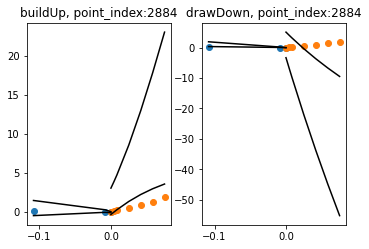

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


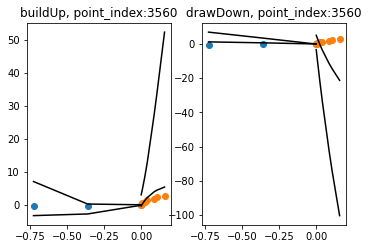

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


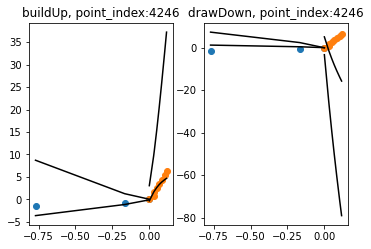

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


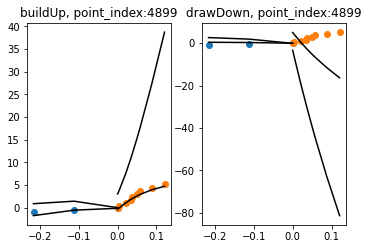

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


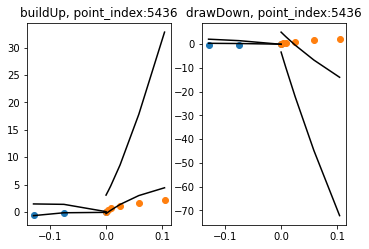

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


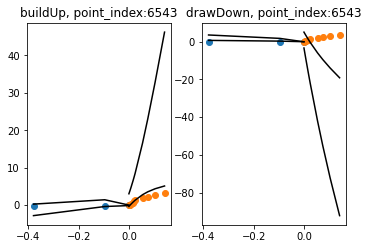

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


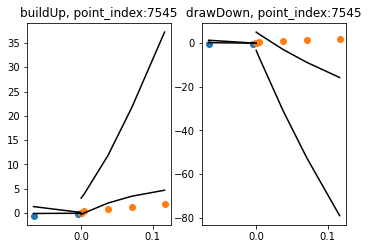

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


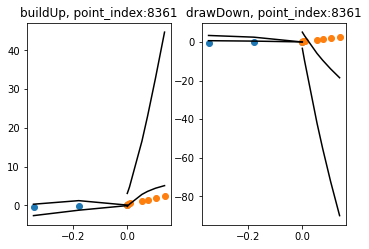

buildUp
5 5 5 5
drawDown
5 5 5 5


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


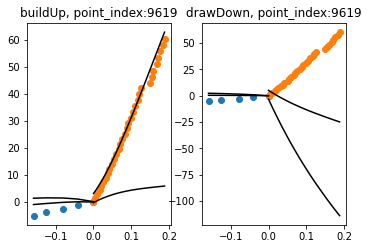

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


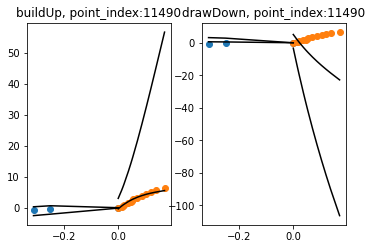

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


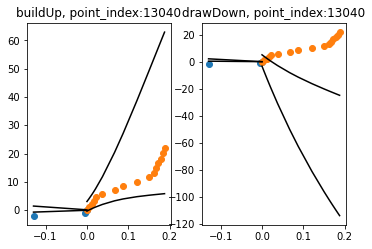

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


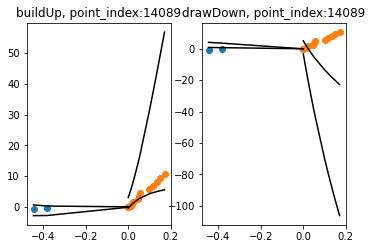

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


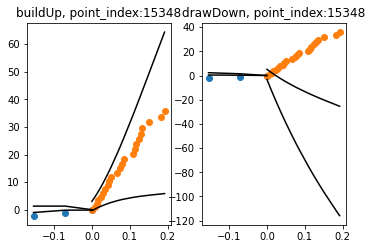

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


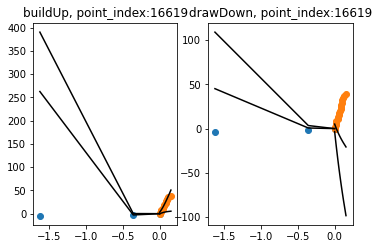

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


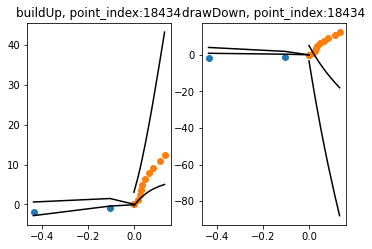

buildUp
6 6 6 6
drawDown
6 6 6 6


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


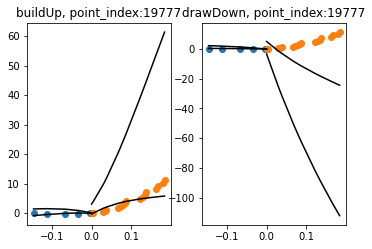

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


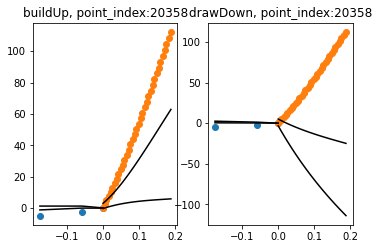

buildUp
6 6 6 6
drawDown
6 6 6 6


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


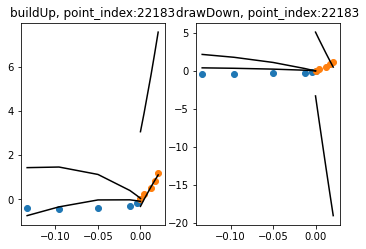

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


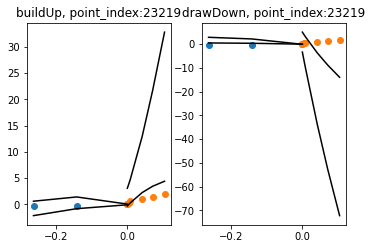

buildUp
11 11 11 11
drawDown
11 11 11 11


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


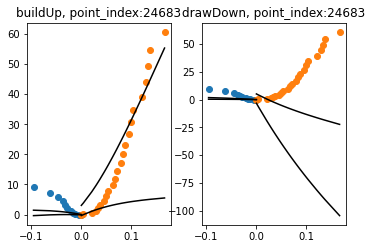

buildUp
6 6 6 6
drawDown
6 6 6 6


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


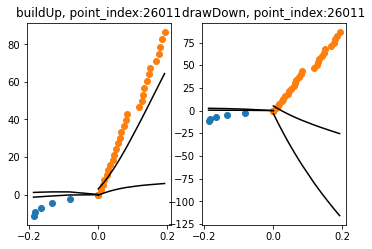

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


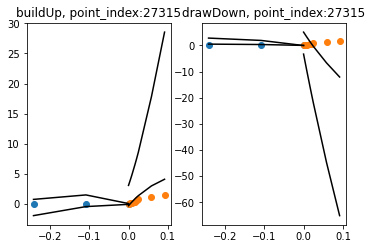

buildUp
7 7 7 7
drawDown
7 7 7 7


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


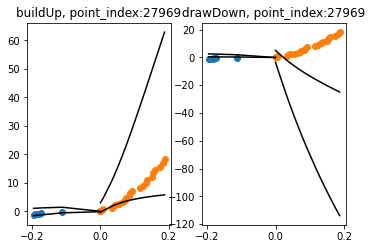

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


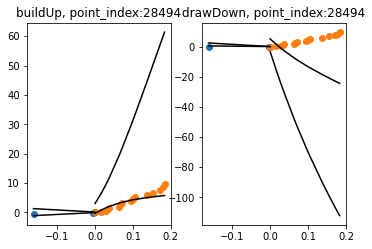

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


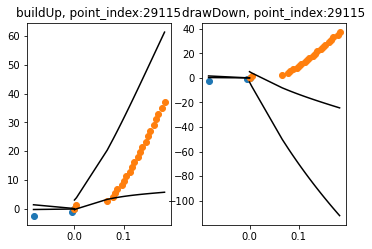

In [15]:
def plot_data_forPredict(data_forPredict,point_index):
    data_plotPoint=data_forPredict.loc[identfication_UsePattern.data_forPredict['point_index'] == point_index]
#     print(data_plotPoint)
    axs = (plt.figure(constrained_layout=True).subplots(1, 2, sharex=True))
    
    pattern_names=["buildUp","drawDown"]
    x_axis=[data_plotPoint["pressure_time_left"].values[0],
            data_plotPoint["pressure_time_right"].values[0]]
    y_axis=[data_plotPoint["pressure_measure_left"].values[0],
            data_plotPoint["pressure_measure_right"].values[0]]

    for ax, pattern_name in zip(axs, pattern_names):
        ax.set(title=f"{pattern_name}, point_index:{point_index}")
        
        #left
        y_borders_left=[data_plotPoint[pattern_name].values[0]['left_top'],
                        data_plotPoint[pattern_name].values[0]['left_bottom']]
        ax.plot(x_axis[0], y_borders_left[0],"k")
        ax.plot(x_axis[0], y_borders_left[1], "k")
        ax.scatter(x_axis[0],y_axis[0])
        print(pattern_name)
        print(len(x_axis[0]),len(y_axis[0]),len(y_borders_left[0]),len(y_borders_left[1]))
    
        #right
        y_borders_right=[data_plotPoint[pattern_name].values[0]['right_top'],
                         data_plotPoint[pattern_name].values[0]['right_bottom']]
        ax.plot(x_axis[1], y_borders_right[0], "k")
        ax.plot(x_axis[1], y_borders_right[1], "k")
        ax.scatter(x_axis[1],y_axis[1])

    plt.show()

buildUp_notDetected=[buildUp for buildUp in identfication_UsePattern.breakpoints_forLearn_multipleLearn[0]['buildUp'] if buildUp not in buildup]
for point_index in buildUp_notDetected:
    plot_data_forPredict(identfication_UsePattern.data_forPredict,point_index)

buildUp
3 3 3 3
drawDown
3 3 3 3


c:\users\junec\appdata\local\programs\python\python38-32\lib\site-packages\IPython\core\pylabtools.py:134: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  fig.canvas.print_figure(bytes_io, **kw)


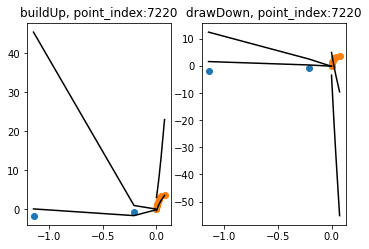

In [16]:
point_index=7220
plot_data_forPredict(identfication_UsePattern.data_forPredict,point_index)

In [ ]:
identfication_UsePattern.extract_singlePoint_inPointWindow()

NameError: name 'plot_data_forPredict' is not defined

In [11]:
false=[25214, 25272, 25316, 25326, 25391, 25404, 25410, 25429, 25448, 25455, 25458, 25465, 25470, 25475, 25478, 25489, 25505, 25512, 25517, 25522, 25523, 25526, 25534, 25546, 25550, 25553, 25564, 25567, 25585, 25635, 25646, 25660, 25708, 26276, 26282, 26375, 26376, 26377, 26385]
for point_index in false:
    plot_data_forPredict(identfication_UsePattern.data_forPredict,point_index)

NameError: name 'identfication_UsePattern' is not defined

buildUp
3 3 3 3
drawDown
3 3 3 3


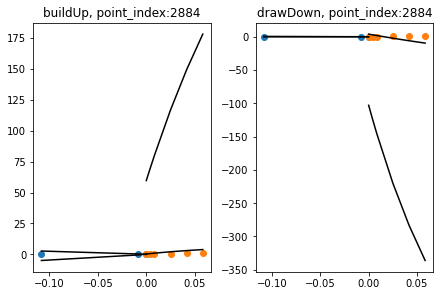

buildUp
3 3 3 3
drawDown
3 3 3 3


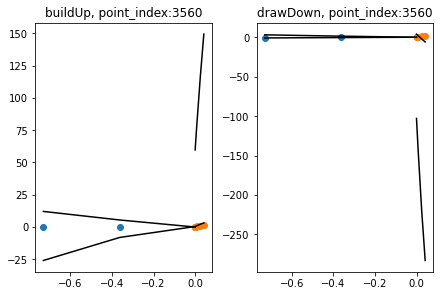

buildUp
3 3 3 3
drawDown
3 3 3 3


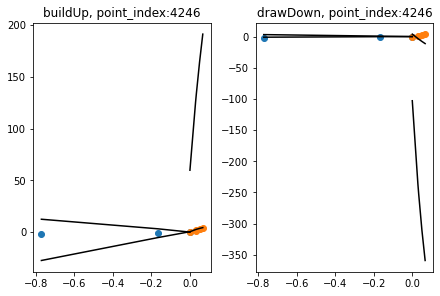

buildUp
3 3 3 3
drawDown
3 3 3 3


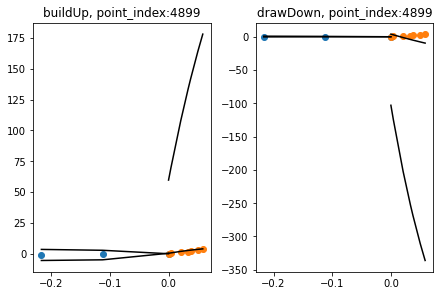

buildUp
3 3 3 3
drawDown
3 3 3 3


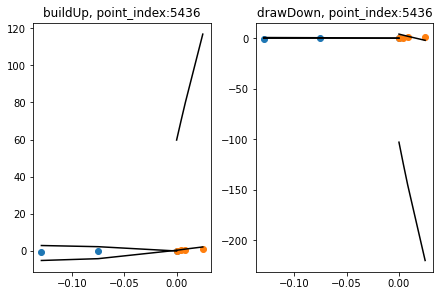

buildUp
3 3 3 3
drawDown
3 3 3 3


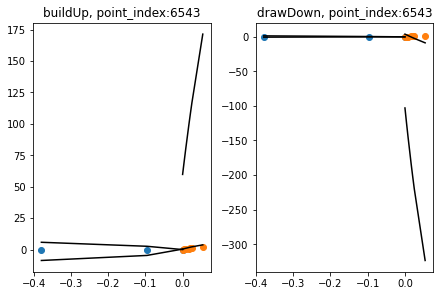

buildUp
3 3 3 3
drawDown
3 3 3 3


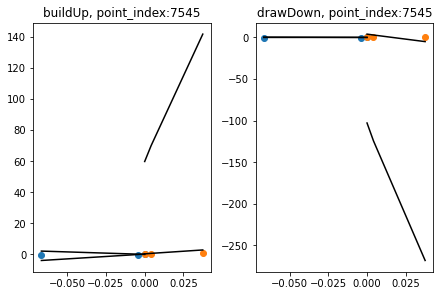

buildUp
3 3 3 3
drawDown
3 3 3 3


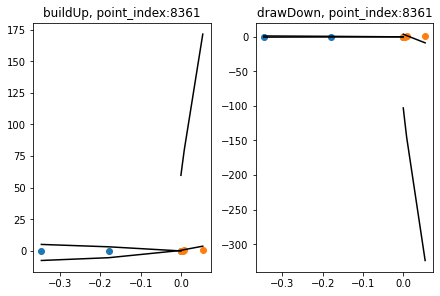

buildUp
3 3 3 3
drawDown
3 3 3 3


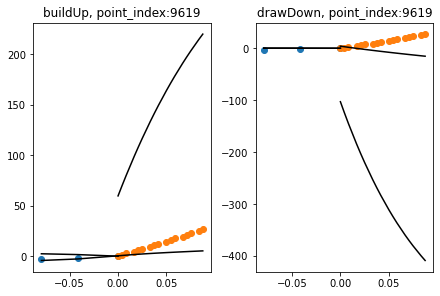

buildUp
3 3 3 3
drawDown
3 3 3 3


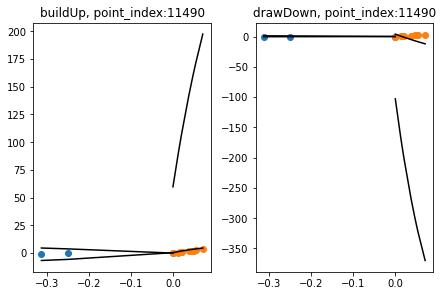

buildUp
3 3 3 3
drawDown
3 3 3 3


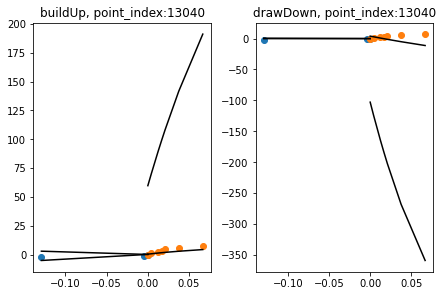

buildUp
3 3 3 3
drawDown
3 3 3 3


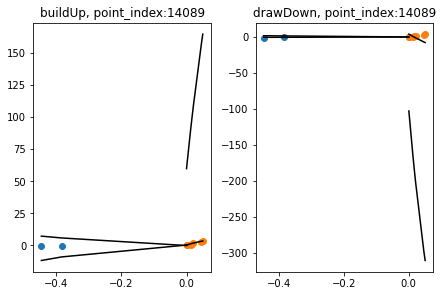

buildUp
3 3 3 3
drawDown
3 3 3 3


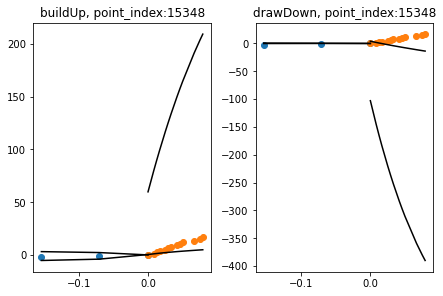

buildUp
3 3 3 3
drawDown
3 3 3 3


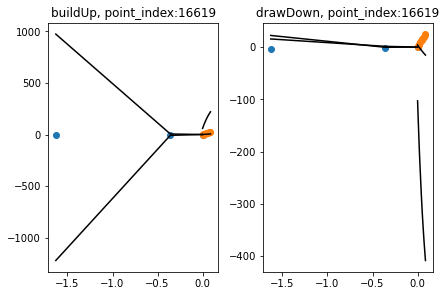

buildUp
3 3 3 3
drawDown
3 3 3 3


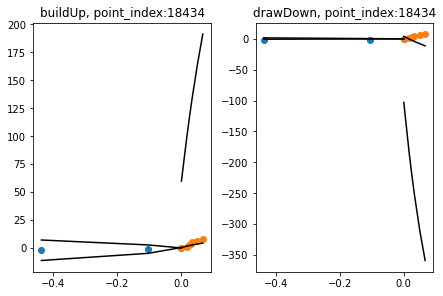

buildUp
3 3 3 3
drawDown
3 3 3 3


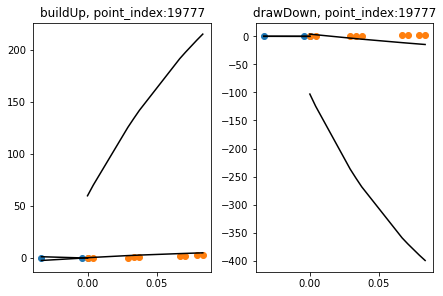

buildUp
3 3 3 3
drawDown
3 3 3 3


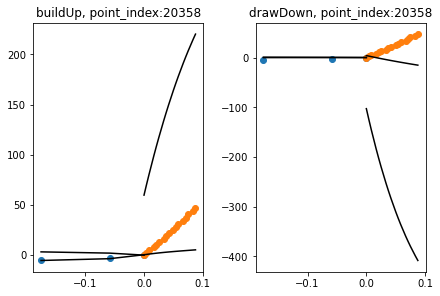

buildUp
4 4 4 4
drawDown
4 4 4 4


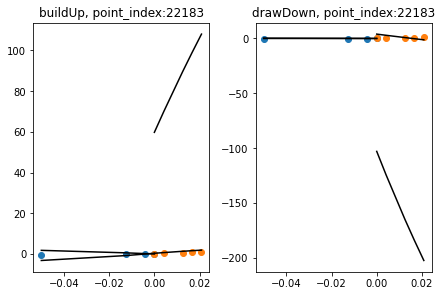

buildUp
3 3 3 3
drawDown
3 3 3 3


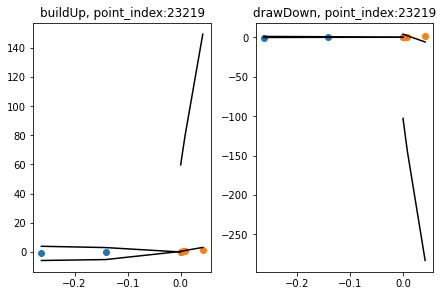

buildUp
10 10 10 10
drawDown
10 10 10 10


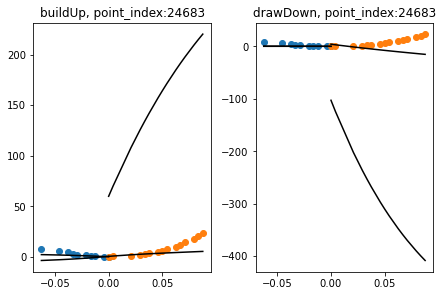

buildUp
3 3 3 3
drawDown
3 3 3 3


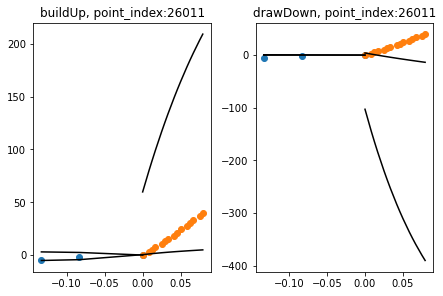

buildUp
3 3 3 3
drawDown
3 3 3 3


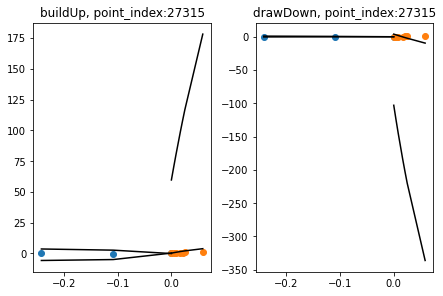

buildUp
3 3 3 3
drawDown
3 3 3 3


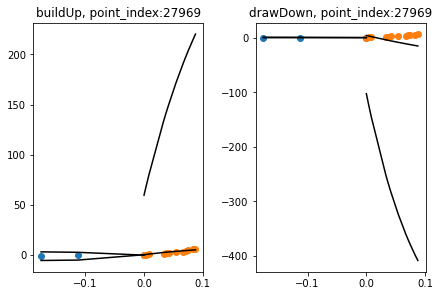

buildUp
3 3 3 3
drawDown
3 3 3 3


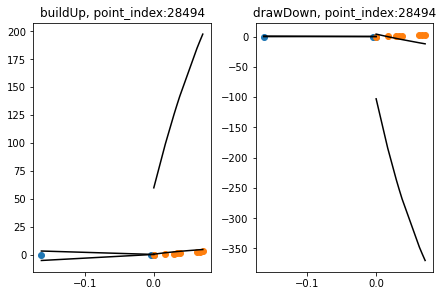

buildUp
3 3 3 3
drawDown
3 3 3 3


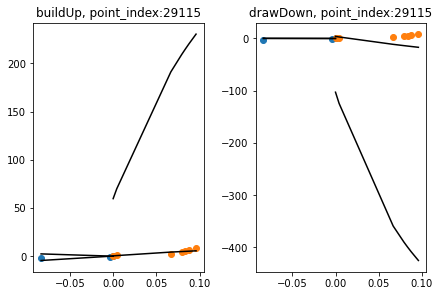

In [15]:
gt_buildUp=identfication_UsePattern.breakpoints_forLearn_multipleLearn[0]['buildUp']
for point_index in gt_buildUp:
    plot_data_forPredict(identfication_UsePattern.data_forPredict,point_index)

In [ ]:
gt_drawDown=identfication_UsePattern.breakpoints_forLearn_multipleLearn[0]['drawDown']
for point_index in gt_drawDown:
    plot_data_forPredict(identfication_UsePattern.data_forPredict,point_index)

In [27]:
point_index=3
data_plotPoint=identfication_UsePattern.data_forPredict.loc[identfication_UsePattern.data_forPredict['point_index'] == point_index]
a=[data_plotPoint["buildUp"].values[0]['left_top'],data_plotPoint["buildUp"].values[0]['left_bottom']]
type(a)

list

In [12]:
identfication_UsePattern.data_forPredict

,point_index,pressure_time_left,pressure_measure_left,pressure_time_right,pressure_measure_right,buildUp,drawDown
0,1,[],[],"[0.05, 0.020833, 0.0]","[5.459024, 2.752399, 0.0]","{'left_top': [], 'left_bottom': [], 'right_top...","{'left_top': [], 'left_bottom': [], 'right_top..."
1,2,"[-0.516667, -0.020833, 0.0]","[-5.550955, -2.752399, 0.0]","[0.05, 0.029167, 0.0]","[5.36786, 2.706625, 0.0]","{'left_top': [8.915618686324716, 0.84909225092...","{'left_top': [2.0786060421611574, 0.1219548296..."
2,3,"[-0.05, -0.029167, 0.0]","[-5.459024, -2.706625, 0.0]","[0.054167, 0.020833, 0.0]","[5.277462, 2.661235, 0.0]","{'left_top': [1.7491473861822984, 1.1447244866...","{'left_top': [0.27538442409085395, 0.168766984..."
3,4,"[-0.05, -0.020833, 0.0]","[-5.36786, -2.661235, 0.0]","[0.0625, 0.033333, 0.0]","[5.18783, 2.616227, 0.0]","{'left_top': [1.7491473861822984, 0.8490922509...","{'left_top': [0.27538442409085395, 0.121954829..."
4,5,"[-0.054167, -0.033333, 0.0]","[-5.277462, -2.616227, 0.0]","[0.0625, 0.029167, 0.0]","[5.098965, 2.571603, 0.0]","{'left_top': [1.8496926704169314, 1.2802703088...","{'left_top': [0.2951066417089483, 0.1912299577..."
...,...,...,...,...,...,...,...
29806,29807,"[-1.2, -0.633333, 0.0]","[-0.949224, -0.471846, 0.0]","[3.720833, 1.716667, 0.0]","[0.926722, 0.46622, 0.0]","{'left_top': [87.15159084940464, 11.0769757765...","{'left_top': [3.2997992934867053, 2.6453227394..."
29807,29808,"[-2.35, -1.716667, 0.0]","[-0.938066, -0.46622, 0.0]","[4.008333, 2.004166, 0.0]","[0.915192, 0.460502, 0.0]","{'left_top': [11888.670844102046, 1425.5100296...","{'left_top': [287.0088163351692, 24.0909842069..."
29808,29809,"[-3.720833, -2.004166, 0.0]","[-0.926722, -0.460502, 0.0]","[4.008334, 2.004167, 0.0]","[0.903476, 0.45469, 0.0]","{'left_top': [190139.0652654323, 4187.94607092...","{'left_top': [5941.160724665119, 86.0381240736..."
29809,29810,"[-4.008333, -2.004167, 0.0]","[-0.915192, -0.45469, 0.0]","[3.445833, 2.004167, 0.0]","[0.891573, 0.448785, 0.0]","{'left_top': [291131.4447207364, 4187.96015795...","{'left_top': [9323.374218186393, 86.0384637466..."


---initializing...
---plotting...


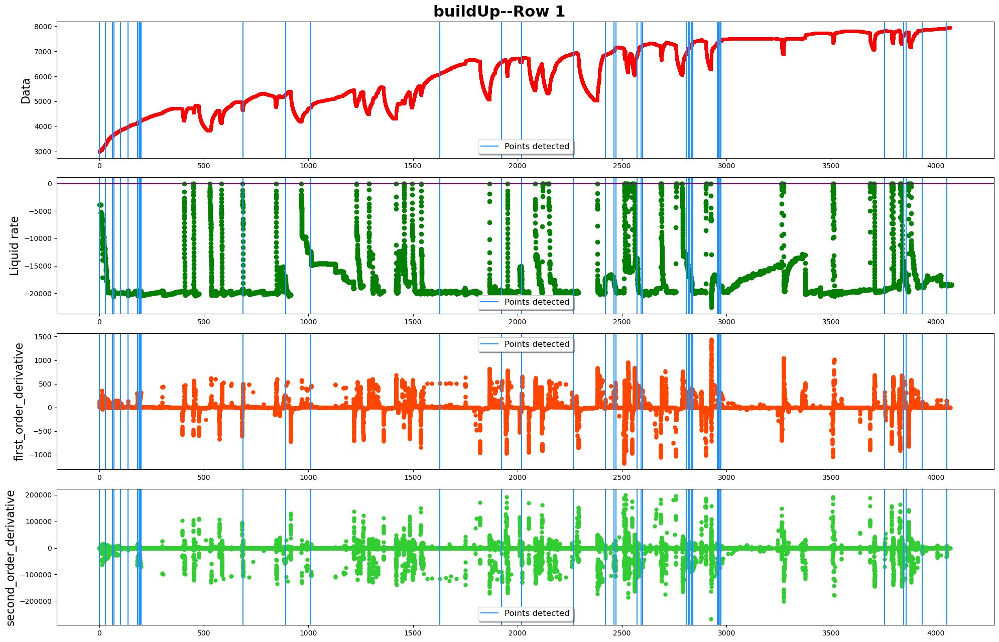

detected 47 points as breakpoints
The plot is devided into 25 rows
------row 1-----detected points:[1, 493]


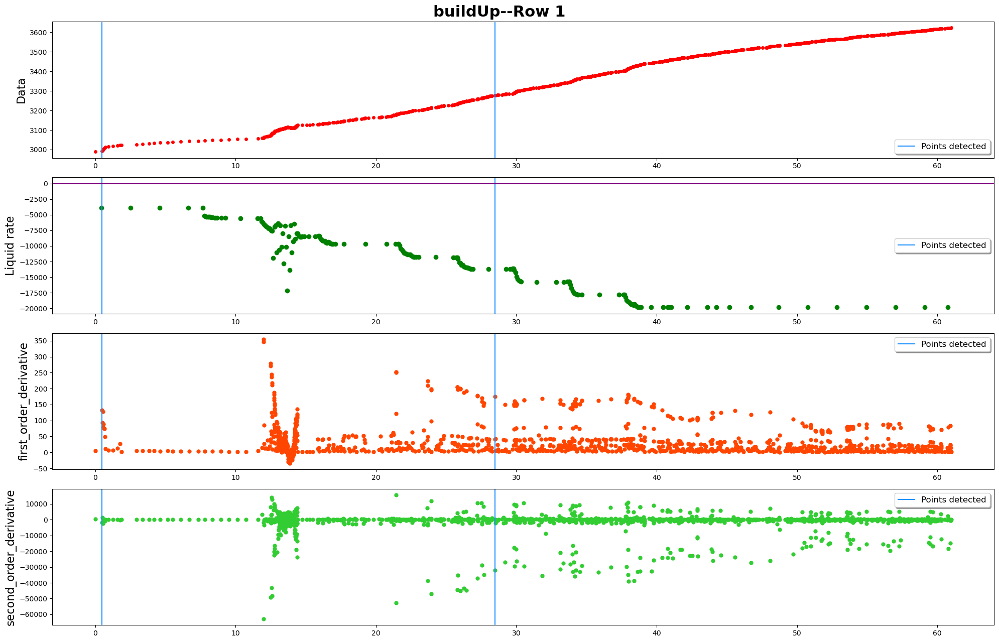

------row 2-----detected points:[1235, 1373, 1640, 1727, 1838, 1859, 1873, 1880, 1888, 1902, 1905, 1915, 1923, 1928, 1931, 1940, 1946, 1949]


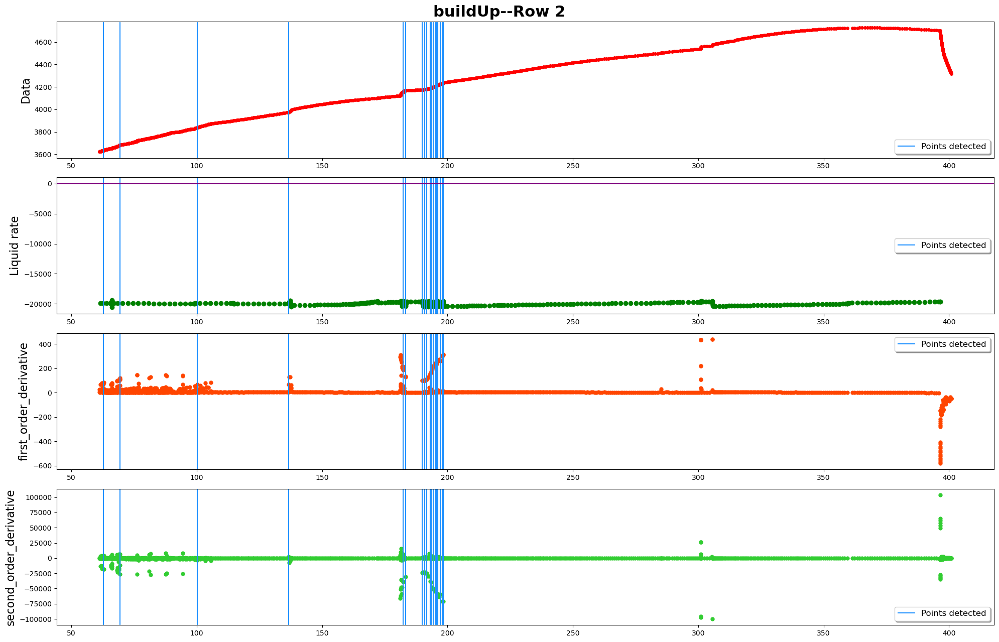

------row 3-----detected points:[]


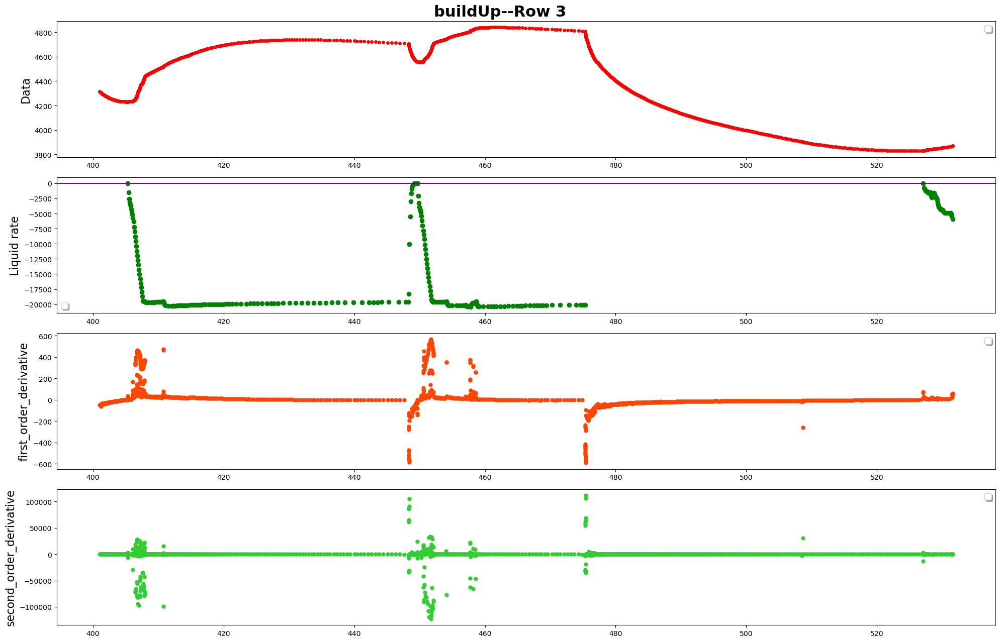

------row 4-----detected points:[]


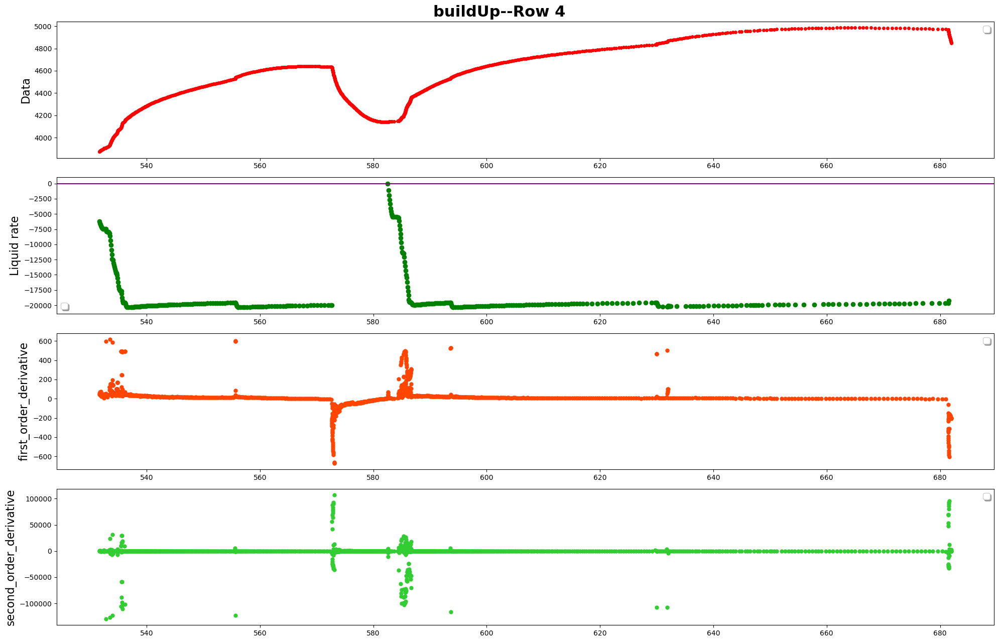

------row 5-----detected points:[4911, 5875]


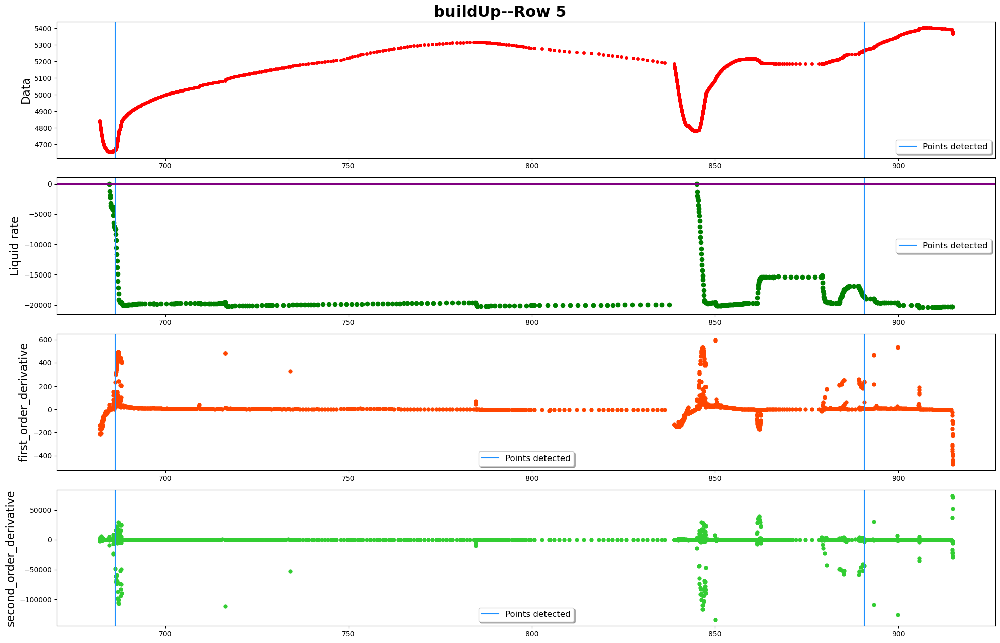

------row 6-----detected points:[6865]


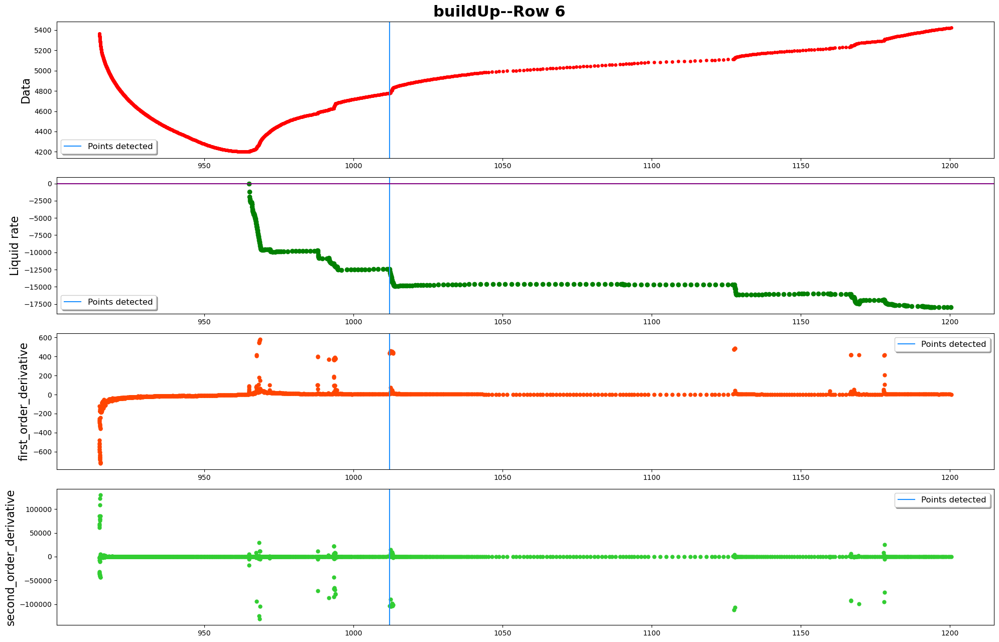

------row 7-----detected points:[]


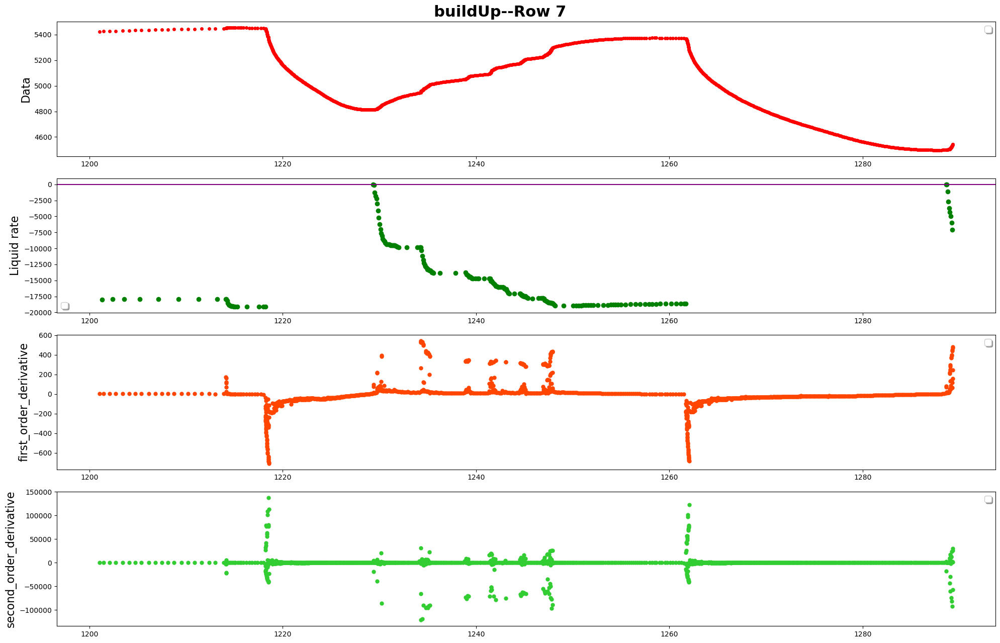

------row 8-----detected points:[]


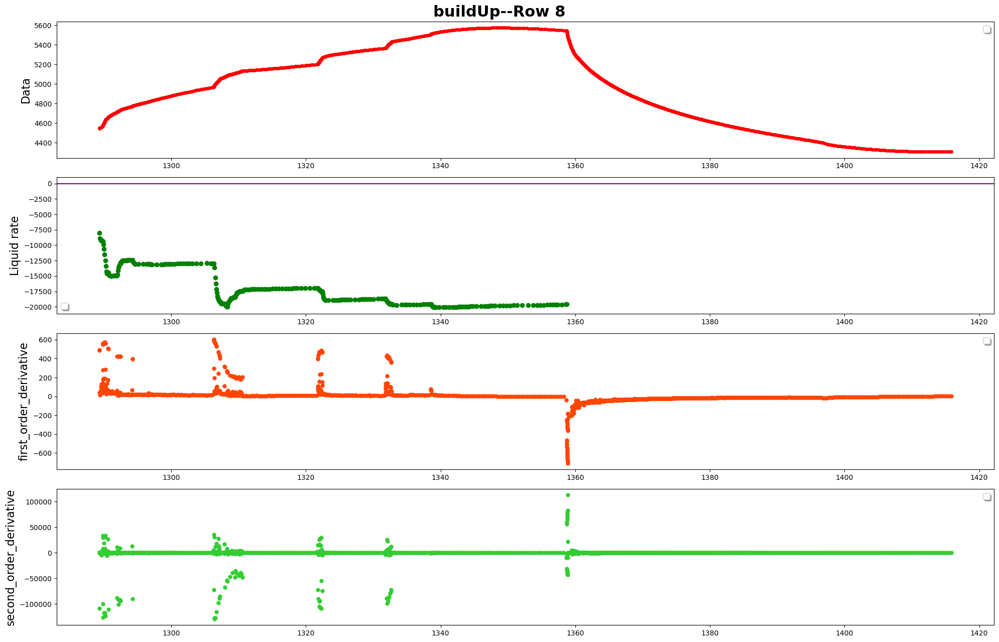

------row 9-----detected points:[]


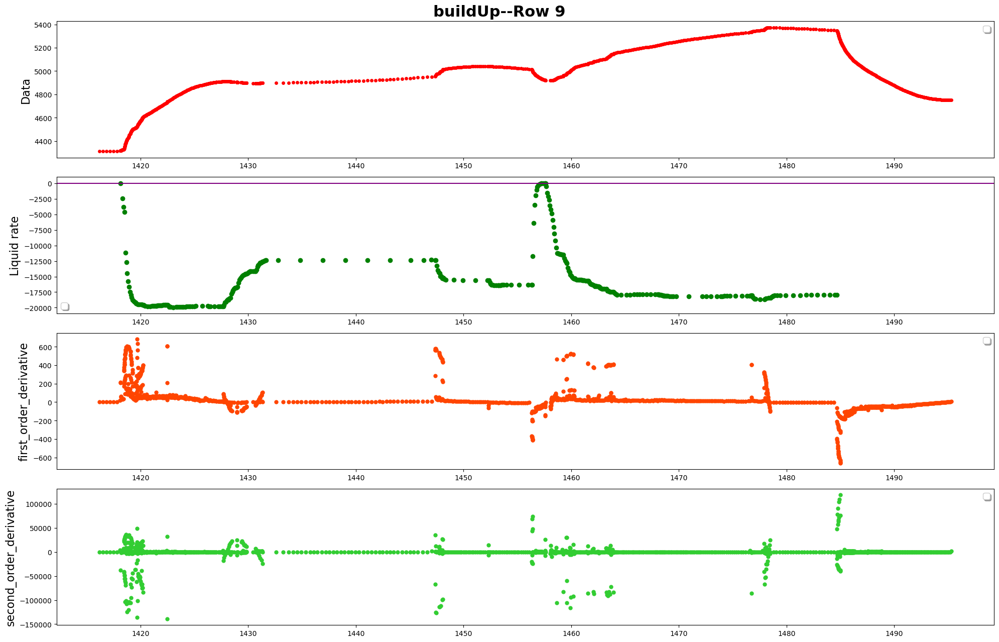

------row 10-----detected points:[]


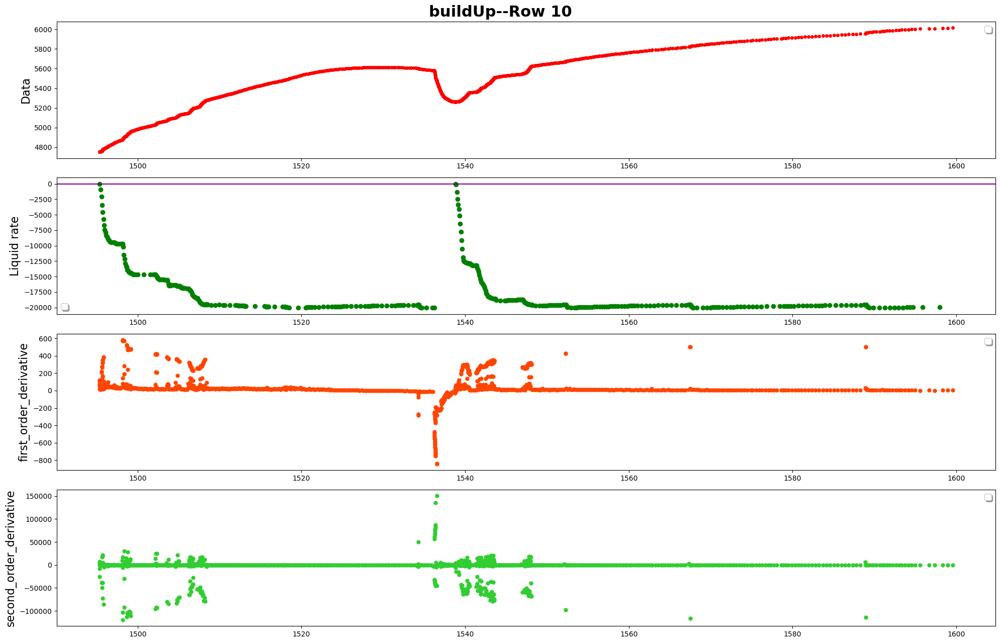

------row 11-----detected points:[12039]


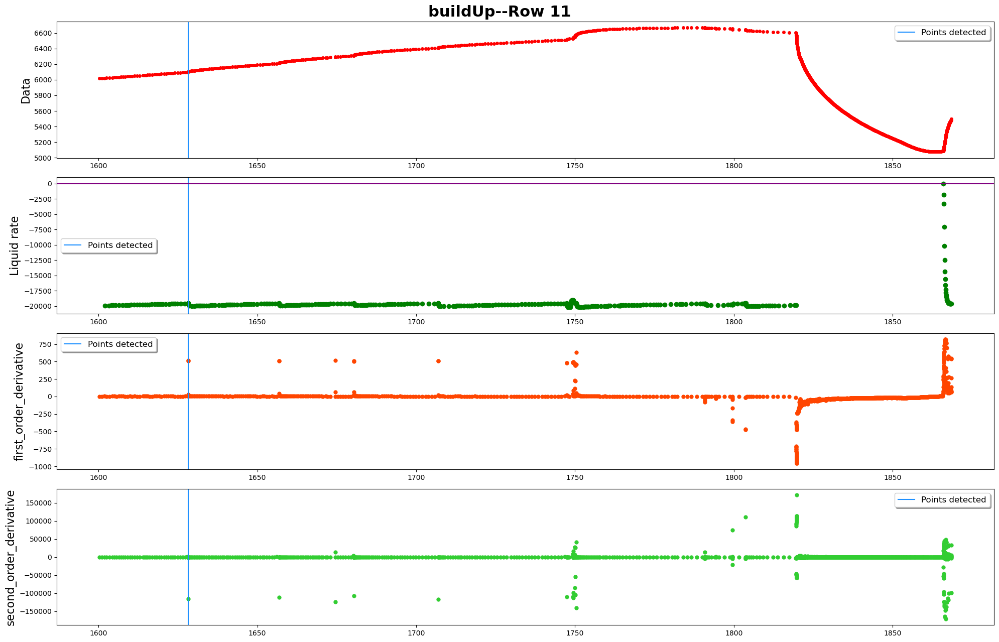

------row 12-----detected points:[13767]


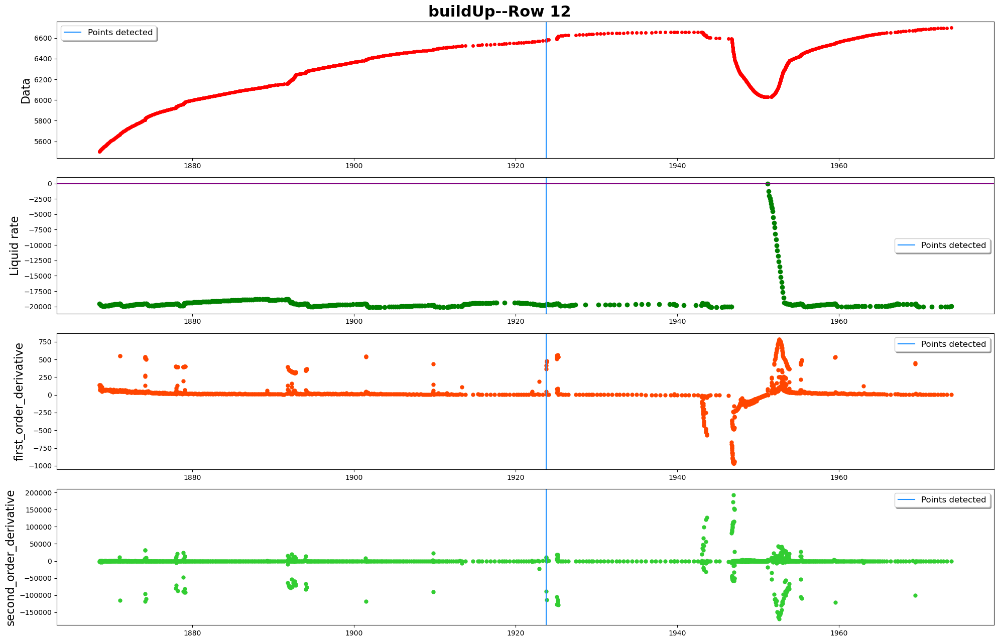

------row 13-----detected points:[14586]


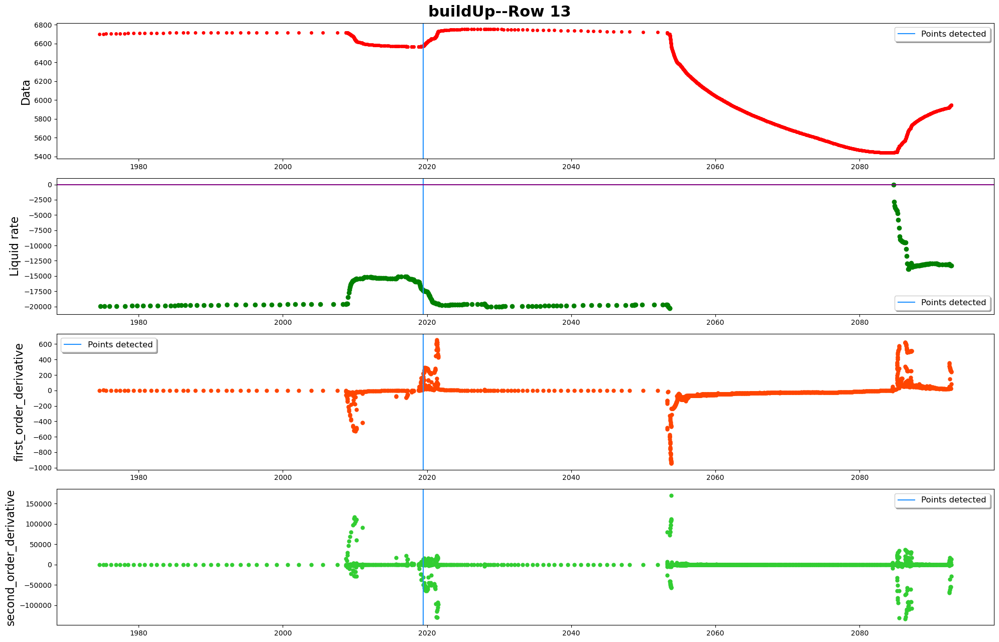

------row 14-----detected points:[]


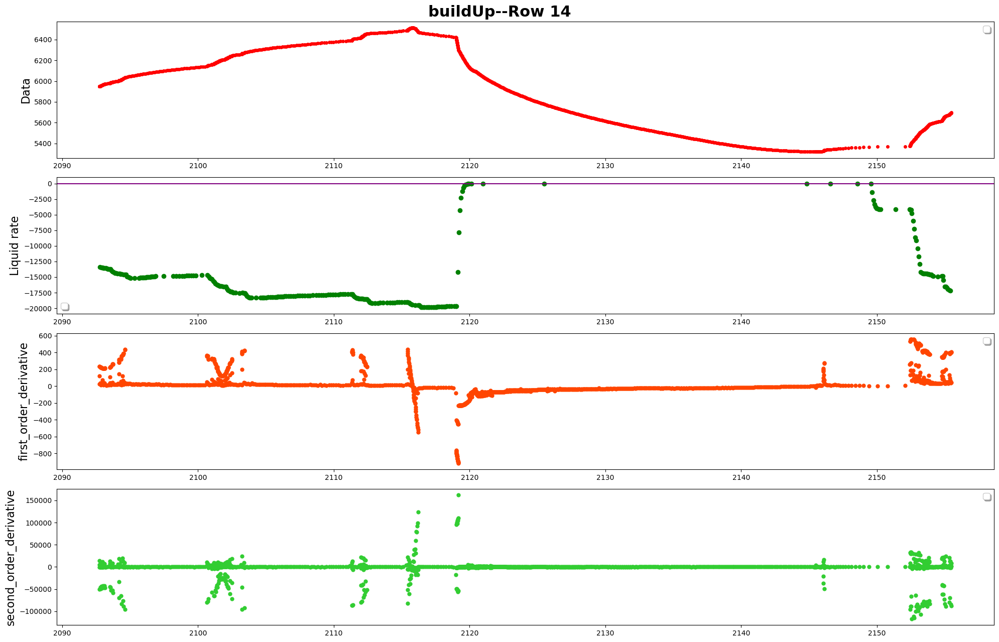

------row 15-----detected points:[17487]


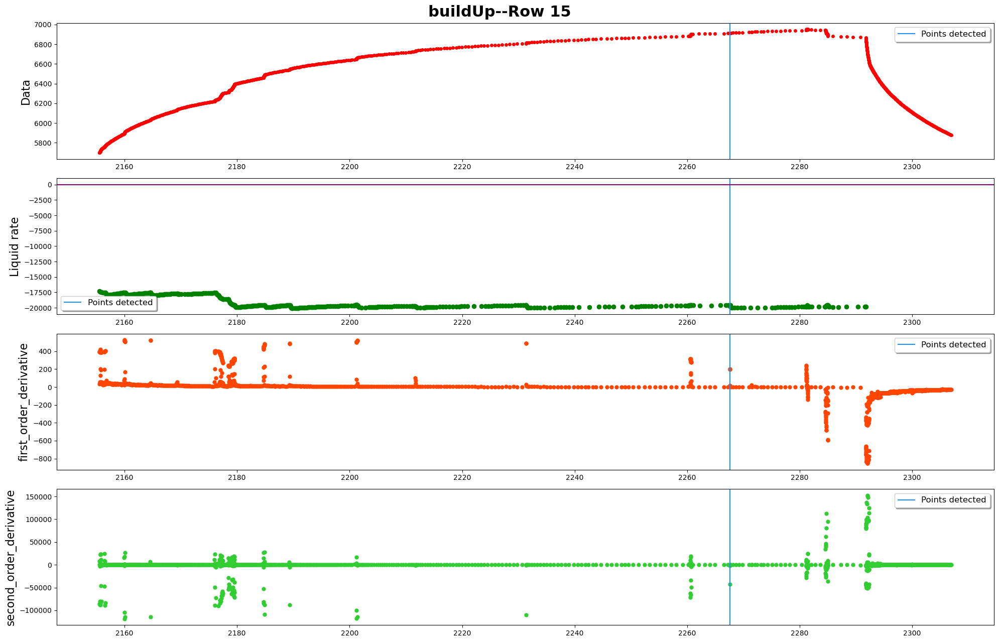

------row 16-----detected points:[]


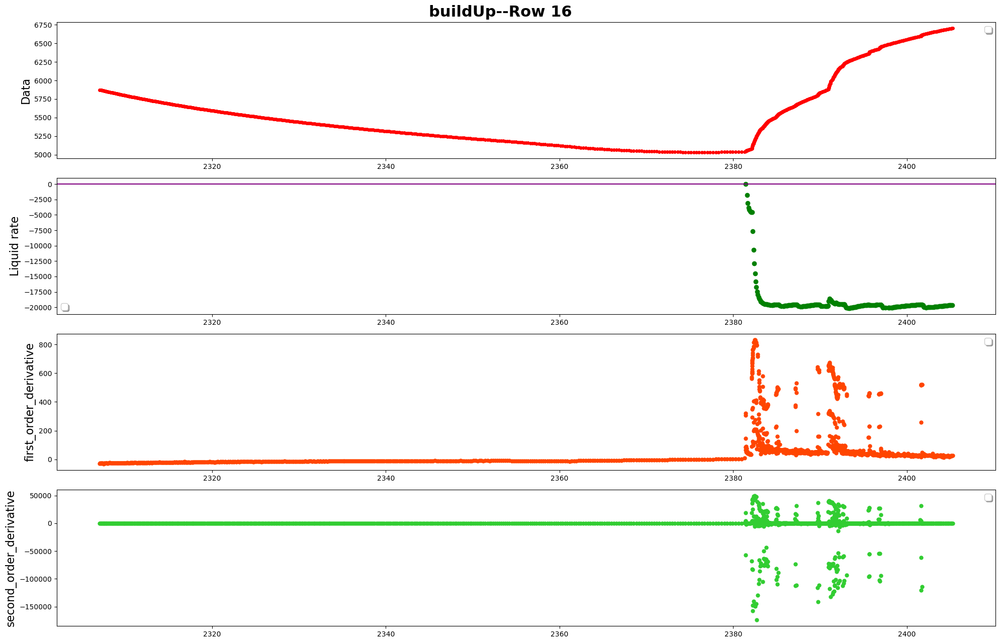

------row 17-----detected points:[19365, 19481, 19589]


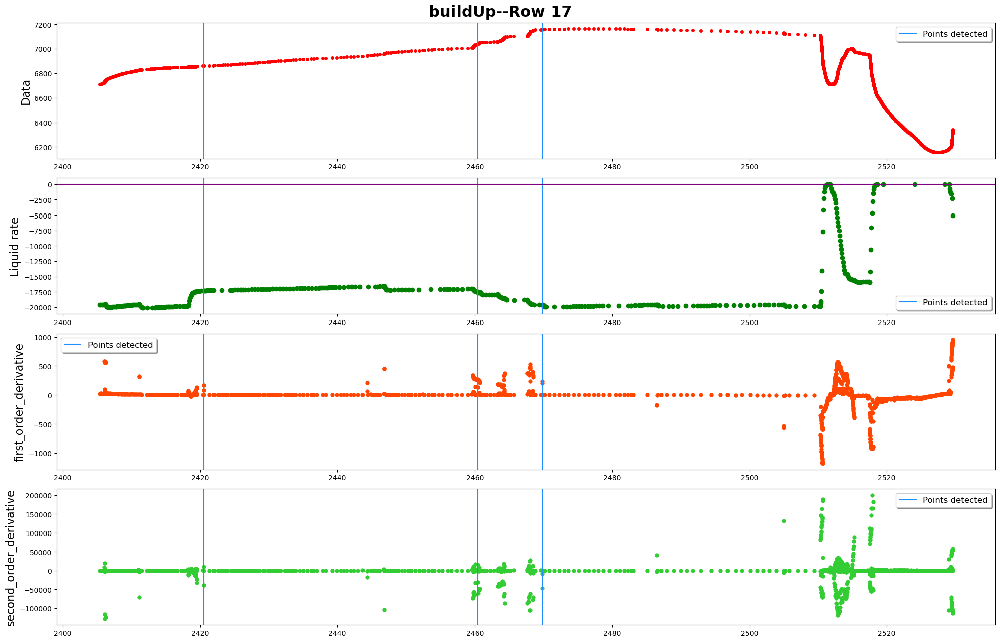

------row 18-----detected points:[21420]


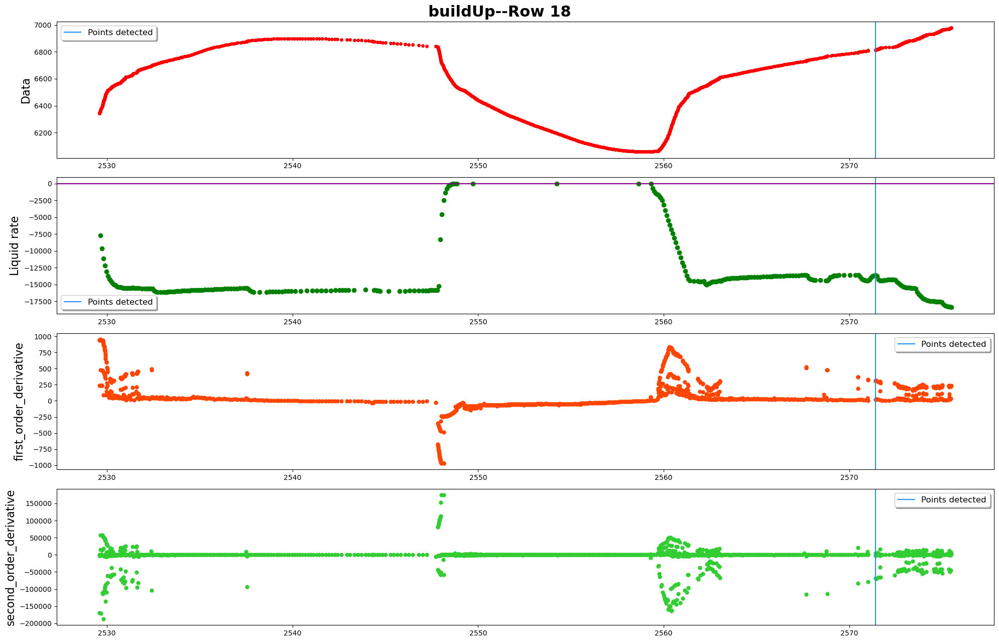

------row 19-----detected points:[21762, 21778]


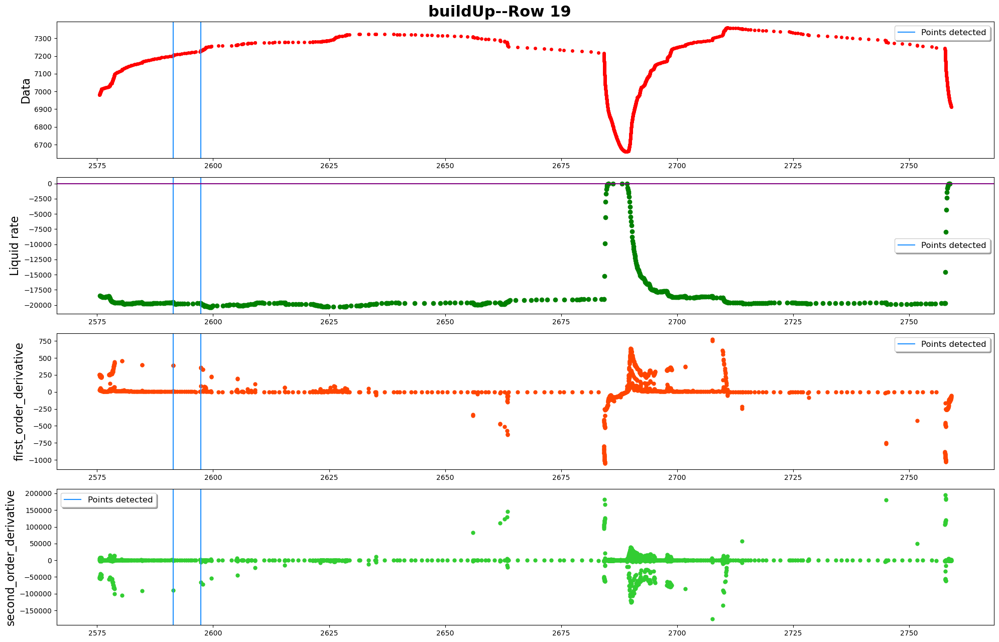

------row 20-----detected points:[23638, 23845, 23908, 23998]


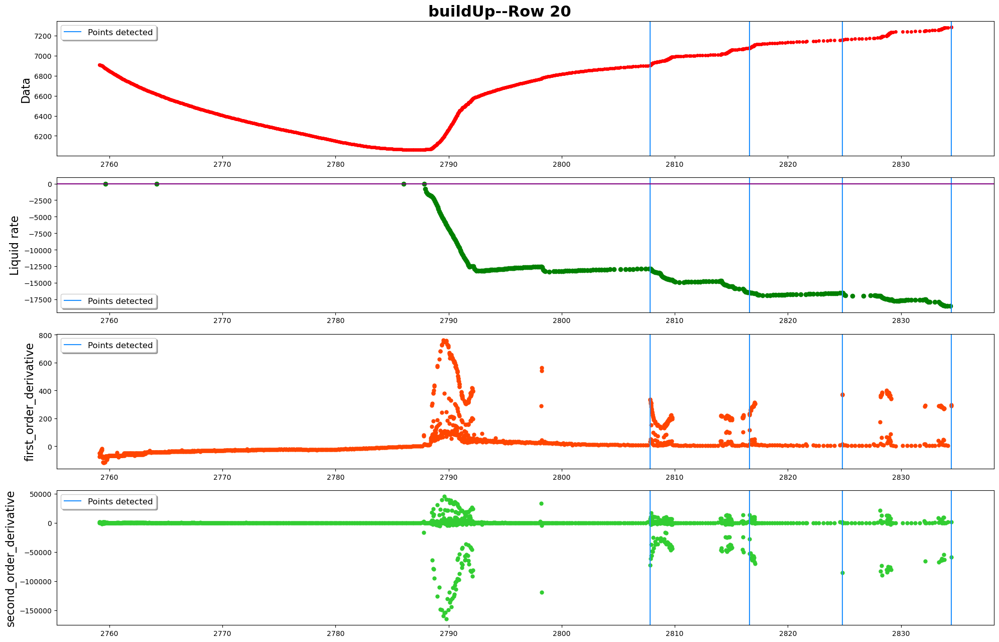

------row 21-----detected points:[24046]


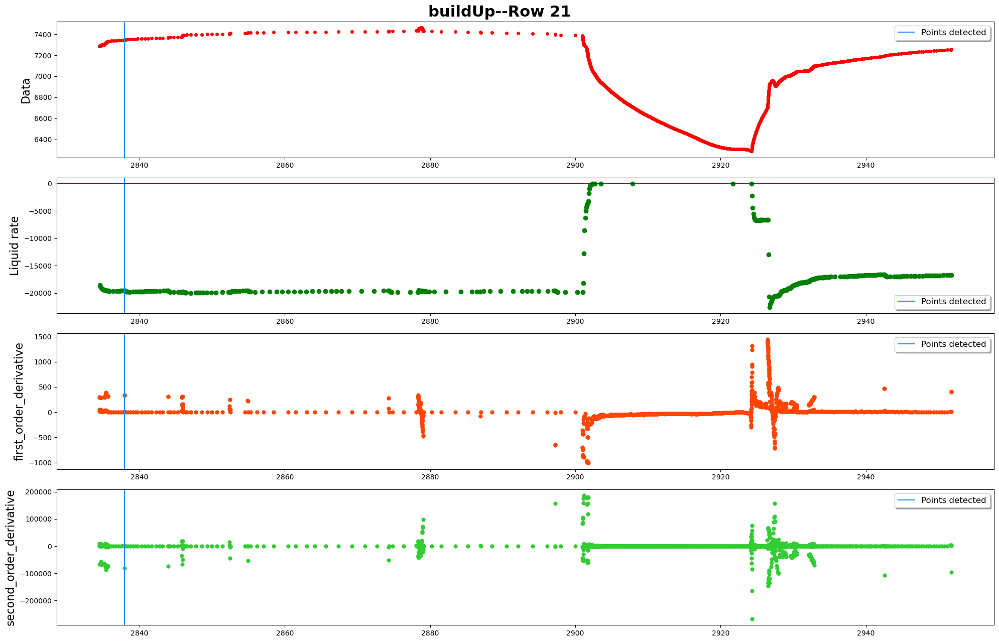

------row 22-----detected points:[25252, 25272, 25316, 25326]


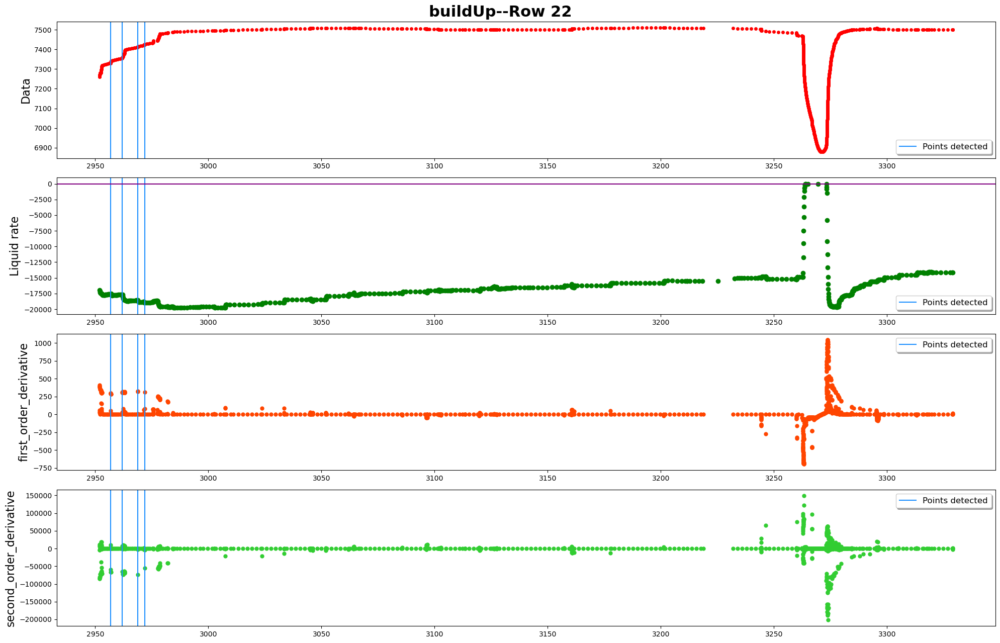

------row 23-----detected points:[]


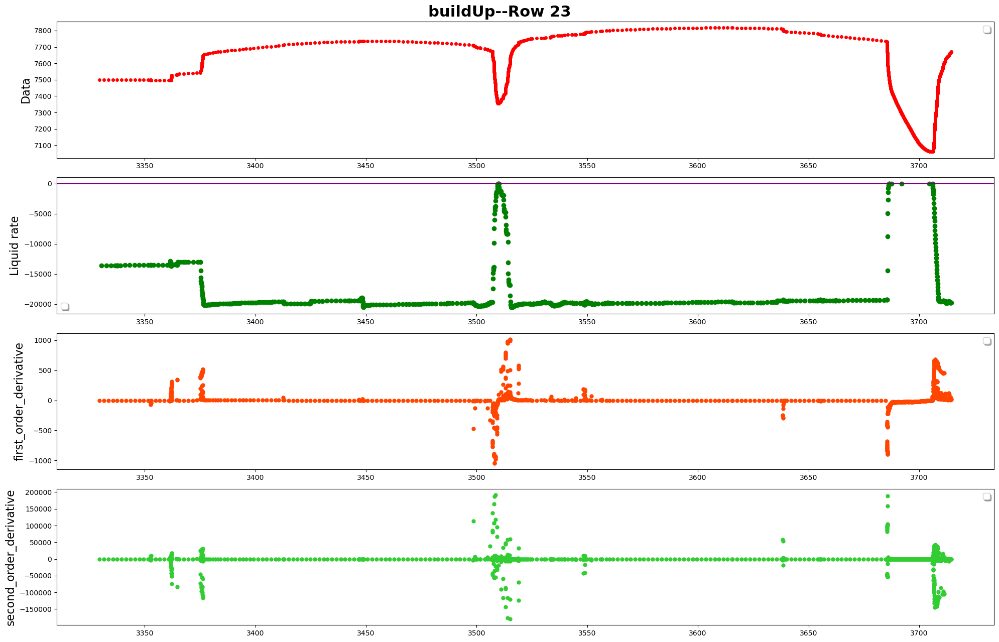

------row 24-----detected points:[27689, 28735, 28784]


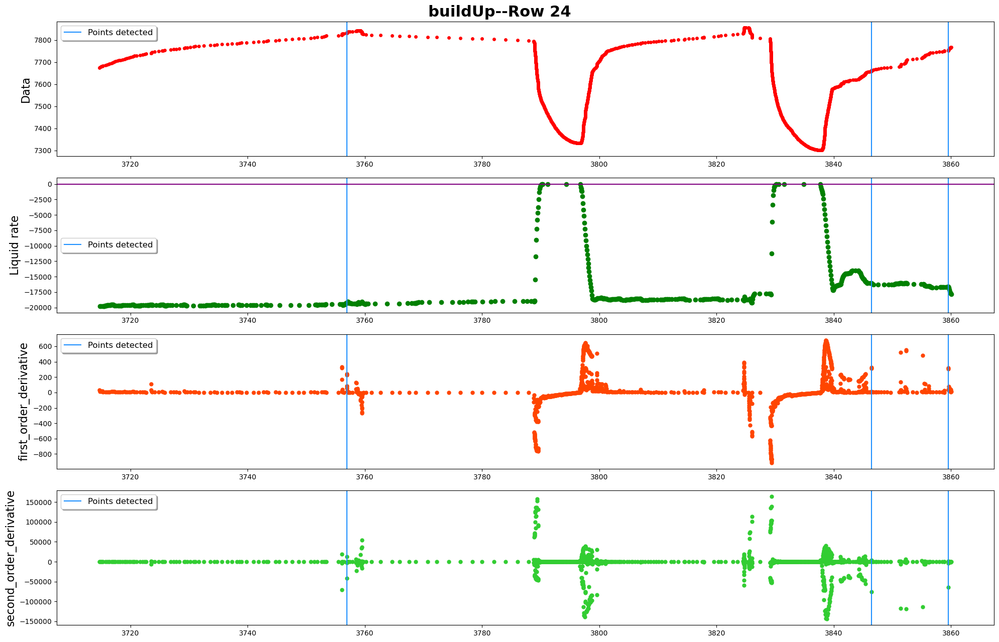

------row 25-----detected points:[29540, 29784]


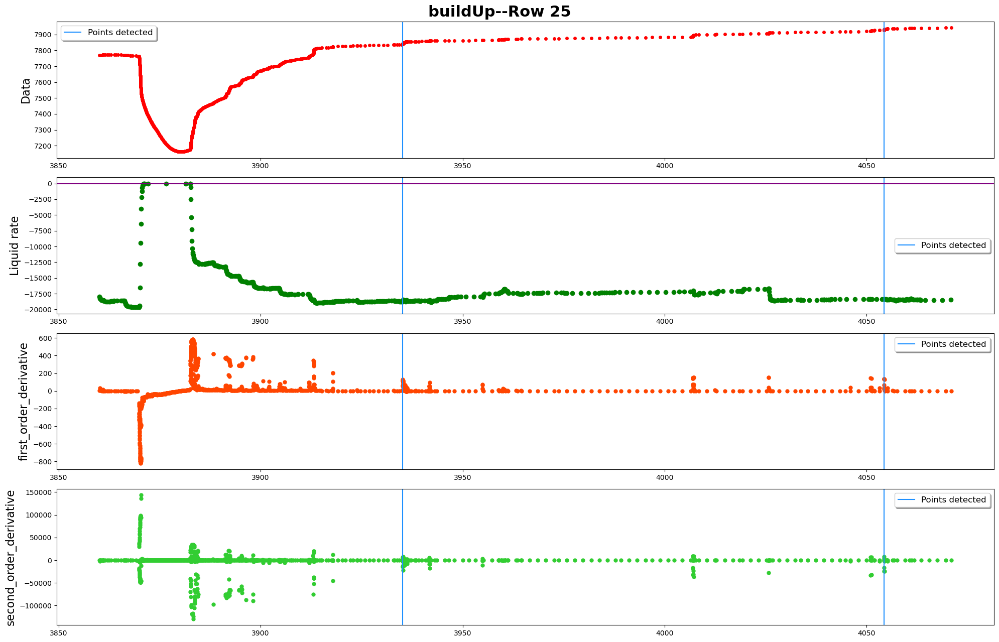

In [12]:
pressure_df=processed_data_denoised.pressure_df
rate_df=processed_data_denoised.rate_df
data_inOneRow=1200
filename_toSave=""
plot_name="buildUp"
plot_whole=True
plot_details=True
plot_statistics=False
PlotNSave(pressure_df,
          rate_df,
          buildup,
          [],
          data_inOneRow,
          plot_name,
          filename_toSave,
          plot_statistics,
          plot_whole,
          plot_details,
          colum_names)

In [50]:
len(identfication_UsePattern.breakpoints_forLearn['buildUp']),len(identfication_UsePattern.breakpoints_forLearn['drawDown'])

(29, 28)

In [33]:
pressure_df=processed_data_denoised.pressure_df
rate_df=processed_data_denoised.rate_df
data_inOneRow=1200
filename_toSave=""
plot_name="drawDown"
plot_whole=False
plot_details=True
plot_statistics=False
PlotNSave(pressure_df,
          rate_df,
          drawdown,
          [],
          data_inOneRow,
          plot_name,
          filename_toSave,
          plot_statistics,
          plot_whole,
          plot_details,
          colum_names)

---initializing...
---plotting...
detected 15 points as breakpoints
The plot is devided into 25 rows
------row 1-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 2-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 3-----detected points:[2804]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 4-----detected points:[4750]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 5-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 6-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 7-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 8-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 9-----detected points:[9974]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 10-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 11-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 12-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 13-----detected points:[14535, 14558]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 14-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 15-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 16-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 17-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 18-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 19-----detected points:[22664]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 20-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 21-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 22-----detected points:[25448, 25470, 25509, 25517, 25523, 25550, 25564, 26375]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 23-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 24-----detected points:[]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

------row 25-----detected points:[28831]


MemoryError: In RendererAgg: Out of memory

<Figure size 2000x1300 with 4 Axes>

In [ ]:
pressure_df=pressure_df_denoised
pressure_measure=list(pressure_df[colum_names["pressure"]["measure"]])
pressure_time=list(pressure_df[colum_names["pressure"]["time"]])
identfication_UsePattern=PatternRecognition()
identfication_UsePattern.learn(pressure_measure,pressure_time,ground_truth,fitting_type="polynomial")
# identfication_UsePattern.parameters_twoPatterns
buildup,drawdown=identfication_UsePattern.predict(pressure_measure,pressure_time)
print(len(buildup),len(drawdown))
# buildup,drawdown

In [ ]:
denoised_breakpoints=
[2248, 2481, 2806, 2884, 3095, 3560, 3973, 4229, 4750, 4891, 5297, 5436, 5985, 6545, 7234, 7538, 7933, 8356, 9023, 9689, 10149, 10224, 10526, 10795, 11323, 11478, 12362, 13023, 13867, 14081, 14774, 15329, 16096, 16619, 17589, 18417, 19642, 19760, 20013, 20358, 20700, 21035, 21974, 22189, 22709, 23219, 24215, 24683, 25697, 26005, 26640, 26753, 27022, 27315, 27757, 27968, 28322, 28494, 28831, 29093]

In [10]:
a=np.asarray([1,2,3,4])
a*3

array([ 3,  6,  9, 12])

In [30]:
type(identfication_UsePattern.curveData.iloc[0]["pressure_time_left"])
a=identfication_UsePattern.curveData.iloc[0]["pressure_time_left"]
b=np.asarray(a)
b,b*3.0

(array([-0.05    , -0.029167,  0.      ]),
 array([-0.15    , -0.087501,  0.      ]))

In [9]:
detectedpoints=defaultdict(list)
len(detectedpoints)

0

In [12]:
int(16.5)

16